In [9]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import visual_behavior.data_access.loading as loading
import visual_behavior.data_access.utilities as utilities

import visual_behavior.visualization.utils as utils

experience_level_colors = utils.get_experience_level_colors()
cre_line_colors = utils.get_cre_line_colors()

experience_levels = utils.get_new_experience_levels()
cell_types = utils.get_cell_types()

import seaborn as sns
sns.set_context('notebook', font_scale=1.5, rc={'lines.markeredgewidth': 1})

In [402]:
import jupyterlab
jupyterlab.__version__

'3.5.0'

In [10]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [11]:
from visual_behavior.dimensionality_reduction.clustering import plotting
from visual_behavior.dimensionality_reduction.clustering import processing

import visual_behavior.visualization.ophys.platform_paper_figures as ppf

In [12]:
!python -m pip install git+https://github.com/nirum/jetplot


  Running command git clone --quiet https://github.com/nirum/jetplot 'C:\Users\marinag\AppData\Local\Temp\pip-req-build-d8sic2cp'



  Cloning https://github.com/nirum/jetplot to c:\users\marinag\appdata\local\temp\pip-req-build-d8sic2cp
  Resolved https://github.com/nirum/jetplot to commit 7e2fc15049870523acb3318a38ffeec73c0dfb67
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'


In [13]:
import jetplot
import matplotlib.colors


## get experiment and cell metadata

In [14]:
# load experiments table
experiments_table = loading.get_platform_paper_experiment_table(limit_to_closest_active=True)
# limit to closest familiar and novel active
experiments_table = utilities.limit_to_last_familiar_second_novel_active(experiments_table)
experiments_table = utilities.limit_to_containers_with_all_experience_levels(experiments_table)

# load matched cells table
cells_table = loading.get_cell_table()
cells_table = loading.get_matched_cells_table(cells_table)
matched_cells = cells_table.cell_specimen_id.unique()
matched_experiments = cells_table.ophys_experiment_id.unique()

# get cre_lines and cell types for plot labels
cre_lines = np.sort(cells_table.cre_line.unique())
cell_types = utilities.get_cell_types_dict(cre_lines, experiments_table)

C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


removing 1 problematic experiments


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)
C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To s

removing 1 problematic experiments
3921 cells in matched cells table


In [15]:
base_dir = r'\\allen\programs\braintv\workgroups\nc-ophys\visual_behavior\platform_paper_plots\figure_4'

save_dir = os.path.join(base_dir, 'all_cre_clustering_113023')
folder = 'figs'

## load GLM results

### get GLM results (not across session normalized)

In [16]:
import visual_behavior_glm.GLM_fit_dev as gfd
import visual_behavior_glm.GLM_analysis_tools as gat

In [17]:
glm_version = '24_events_all_L2_optimize_by_session'

run_params, all_results, all_results_pivoted, weights_df = gfd.load_analysis_dfs(glm_version)

loading run_params
loading results df
loading results_pivoted df
loading weights_df


### get across session normalized dropout scores

In [18]:
import visual_behavior_glm.GLM_across_session as gas

glm_version = '24_events_all_L2_optimize_by_session'

# get across session normalized dropout scores
across_results, failed_cells = gas.load_cells(glm_version, clean_df=True)
across_results = across_results.set_index('identifier')

Loading list of matched cells


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)
C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To s

removing 1 problematic experiments
Loading across session normalized dropout scores


100%|██████████| 3921/3921 [02:33<00:00, 25.53it/s]


0 cells could not be loaded


In [19]:
# cell_list = gas.get_cell_list(glm_version)

In [20]:
# only use across session values
across = across_results[[key for key in across_results.keys() if '_across' in key] + ['cell_specimen_id', 'ophys_experiment_id', 'experience_level']]
results_pivoted = across.copy()
# rename across session columns 
results_pivoted = results_pivoted.rename(
    columns={'omissions_across': 'omissions', 'all-images_across': 'all-images',
             'behavioral_across': 'behavioral', 'task_across': 'task'})
print(len(results_pivoted), 'len(results_pivoted)')

11763 len(results_pivoted)


#### limit GLM results to matched cells and reformat

In [21]:
len(results_pivoted)

11763

In [22]:
# limit to matched cells 
results_pivoted = results_pivoted[results_pivoted.ophys_experiment_id.isin(matched_experiments)]
results_pivoted = results_pivoted[results_pivoted.cell_specimen_id.isin(matched_cells)]

# drop duplicates
results_pivoted = results_pivoted.drop_duplicates(subset=['cell_specimen_id', 'experience_level'])
print(len(results_pivoted), 'len(results_pivoted) after dropping duplicates')
        
print(len(results_pivoted.cell_specimen_id.unique()),
      'cells in results_pivoted after limiting to strictly matched cells')

11763 len(results_pivoted) after dropping duplicates
3921 cells in results_pivoted after limiting to strictly matched cells


In [156]:
results_pivoted.head()

,all-images,omissions,task,behavioral,cell_specimen_id,experience_level
identifier,,,,,,
794381992_1086551315,0.000000,0.0,0.000000,0.0,1086551315,Familiar
795076128_1086551315,0.295018,0.0,0.094833,0.0,1086551315,Novel
796105304_1086551315,0.258126,0.0,0.430496,0.0,1086551315,Novel +
794381992_1086550804,0.000000,0.0,0.000000,0.0,1086550804,Familiar
795076128_1086550804,0.000000,0.0,0.000000,0.0,1086550804,Novel


In [24]:
# limit to features used for clustering
features = processing.get_features_for_clustering()
features = ['all-images', 'omissions', 'task', 'behavioral']
features = [*features, 'ophys_experiment_id']
results_pivoted = processing.limit_results_pivoted_to_features_for_clustering(results_pivoted, features)

# flip sign so coding scores are positive
results_pivoted = processing.flip_sign_of_dropouts(results_pivoted, processing.get_features_for_clustering(), use_signed_weights=False)

# now drop ophys_experiment_id
results_pivoted = results_pivoted.drop(columns=['ophys_experiment_id'])

In [25]:
len(results_pivoted)

11763

In [26]:
results_pivoted.head()

,all-images,omissions,task,behavioral,cell_specimen_id,experience_level
identifier,,,,,,
794381992_1086551315,0.000000,0.0,0.000000,0.0,1086551315,Familiar
795076128_1086551315,0.295018,0.0,0.094833,0.0,1086551315,Novel 1
796105304_1086551315,0.258126,0.0,0.430496,0.0,1086551315,Novel >1
794381992_1086550804,0.000000,0.0,0.000000,0.0,1086550804,Familiar
795076128_1086550804,0.000000,0.0,0.000000,0.0,1086550804,Novel 1


### replace old experience level with new one (Novel+)

In [27]:
cells_table['experience_level'] = [utils.convert_experience_level(experience_level) for experience_level in cells_table.experience_level.values]

In [28]:
results_pivoted['experience_level'] = [utils.convert_experience_level(experience_level) for experience_level in results_pivoted.experience_level.values]


## load or generate clustering results


In [ ]:
feature_matrix = processing.get_feature_matrix_for_clustering(results_pivoted, glm_version, save_dir=save_dir)

In [36]:
cell_metadata = processing.get_cell_metadata_for_feature_matrix(feature_matrix, cells_table)

3921 cells in cell_metadata for feature_matrix


array(['Familiar', 'Novel'], dtype=object)

In [ ]:
n_clusters = 14 # empirically determined, then validated based on within vs. across cluster variance

cluster_meta = processing.run_all_cre_clustering(feature_matrix, cells_table, n_clusters, save_dir, folder)


In [37]:
# n_clusters = 14 # arbitrary choice that happens to pull out similar clusters to within cre clustering

# cluster_meta_save_path = os.path.join(save_dir, 'cluster_meta_n_'+str(n_clusters)+'_clusters.h5')

# # if clustering output exists, load it
# if os.path.exists(cluster_meta_save_path):
#     cluster_meta = pd.read_hdf(cluster_meta_save_path, key='df')
#     if 0 in cluster_meta.cluster_id.unique():
#         # add one to cluster ID so it starts at 1
#         cluster_meta['cluster_id'] = cluster_meta['cluster_id']+1
#     # merge in cell metadata
#     cell_metadata = processing.get_cell_metadata_for_feature_matrix(feature_matrix, cells_table)
#     cell_metadata = cell_metadata.drop(columns=['ophys_experiment_id', 'cre_line'])
#     cluster_meta = cluster_meta.merge(cell_metadata.reset_index(), on='cell_specimen_id')
#     cluster_meta = cluster_meta.set_index('cell_specimen_id')
# # otherwise run it and save it
# else: 
#     # run spectral clustering and get co-clustering matrix
#     from sklearn.cluster import SpectralClustering
#     sc = SpectralClustering()
#     X = feature_matrix.values
#     m = processing.get_coClust_matrix(X=X, n_clusters=n_clusters, model=sc, nboot=np.arange(100))
#     # make co-clustering matrix a dataframe with cell_specimen_ids as indices and columns
#     coclustering_df = pd.DataFrame(data=m, index=feature_matrix.index, columns=feature_matrix.index)

#     # save co-clustering matrix
#     coclust_save_path = os.path.join(save_dir, 'coclustering_matrix_n_'+str(n_clusters)+'_clusters.h5')
#     coclustering_df.to_hdf(coclust_save_path, key='df', format='table')

#     # run agglomerative clustering on co-clustering matrix to identify cluster labels
#     from sklearn.cluster import AgglomerativeClustering
#     X = coclustering_df.values
#     cluster = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean',
#                                     linkage='average')
#     labels = cluster.fit_predict(X)
#     cell_specimen_ids = coclustering_df.index.values
#     # make dictionary with labels for each cell specimen ID in this cre line
#     labels_dict = {'labels': labels, 'cell_specimen_id': cell_specimen_ids}
#     # turn it into a dataframe
#     labels_df = pd.DataFrame(data=labels_dict, columns=['labels', 'cell_specimen_id'])
#     # get new cluster_ids based on size of clusters and add to labels_df
#     cluster_size_order = labels_df['labels'].value_counts().index.values
#     # translate between original labels and new IDS based on cluster size
#     labels_df['cluster_id'] = [np.where(cluster_size_order == label)[0][0] for label in labels_df.labels.values]
#     # concatenate with df for all cre lines
#     cluster_labels = labels_df

#     # add metadata to cluster labels
#     cell_metadata = processing.get_cell_metadata_for_feature_matrix(feature_matrix, cells_table)

#     cluster_meta = cluster_labels[['cell_specimen_id', 'cluster_id', 'labels']].merge(cell_metadata, on='cell_specimen_id')
#     cluster_meta = cluster_meta.set_index('cell_specimen_id')
#     # annotate & clean cluster metadata
#     cluster_meta = processing.clean_cluster_meta(cluster_meta)  # drop cluster IDs with fewer than 5 cells in them
#     cluster_meta['original_cluster_id'] = cluster_meta.cluster_id
#     # increment cluster ID if needed
#     if 0 in cluster_meta.cluster_id.unique():
#         # add one to cluster ID so it starts at 1
#         cluster_meta['cluster_id'] = cluster_meta['cluster_id']+1

#     # plot coclustering matrix - need to hack it since it assumes cre lines
#     coclustering_dict = {}
#     coclustering_dict['all'] = coclustering_df
#     cluster_meta_tmp = cluster_meta.copy()
#     cluster_meta_tmp['cre_line'] = 'all'
#     plotting.plot_coclustering_matrix_sorted_by_cluster_size(coclustering_dict, cluster_meta_tmp, cre_line='all',
#                                                     save_dir=save_dir, folder=folder, ax=None)

#     # add within cluster correlation
#     cluster_meta = processing.add_within_cluster_corr_to_cluster_meta(feature_matrix, cluster_meta, use_spearmanr=False)

#     # plot within cluster correlations distribution
#     plotting.plot_within_cluster_correlations(cluster_meta, sort_order=None, spearman=False, suffix='_'+str(n_clusters)+'_clusters',
#                                                     save_dir=save_dir, folder=folder, ax=None)

#     # save clustering results
#     cluster_meta_save_path = os.path.join(save_dir, 'cluster_meta_n_'+str(n_clusters)+'_clusters.h5')
#     cluster_data = cluster_meta.reset_index()[['cell_specimen_id', 'ophys_experiment_id', 'cre_line', 'cluster_id', 'labels', 'within_cluster_correlation_p']]
#     cluster_data.to_hdf(cluster_meta_save_path, key='df', format='table')



3921 cells in cell_metadata for feature_matrix


In [38]:
cluster_meta.experience_level.unique()

array(['Familiar', 'Novel'], dtype=object)

<AxesSubplot:title={'center':'within cluster correlation'}, xlabel='cluster #', ylabel='correlation'>

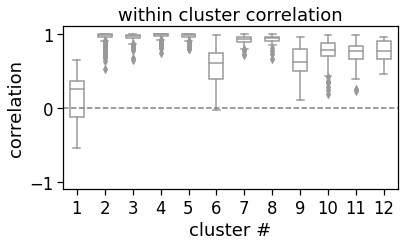

In [39]:
# plot within cluster correlations distribution
plotting.plot_within_cluster_correlations(cluster_meta, sort_order=None, spearman=False, suffix='_'+str(n_clusters)+'_clusters',
                                                save_dir=save_dir, folder=folder, ax=None)

## load multi session response dataframes

In [ ]:
data_type = 'events'

interpolate = True
output_sampling_rate = 30

# set inclusion criteria
# options: ['active_only', 'closest_familiar_and_novel', 'containers_with_all_levels']


inclusion_criteria = 'platform_experiment_table'

In [ ]:
# params for stim response df creation
event_type = 'all'

# params for mean response df creation
conditions = ['cell_specimen_id', 'is_change']


change_suffix = '_'+utils.get_conditions_string(data_type, conditions)+'_'+inclusion_criteria

multi_session_df = loading.get_multi_session_df_for_conditions(data_type, event_type, conditions, inclusion_criteria, 
                                                        interpolate=interpolate, output_sampling_rate=output_sampling_rate, 
                                                         epoch_duration_mins=None)

# limit to changes, convert experience level and merge with cluster IDs
change_mdf = multi_session_df[multi_session_df.is_change==True]
change_mdf['experience_level'] = [utils.convert_experience_level(experience_level) for experience_level in change_mdf.experience_level.values]
change_mdf = change_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')

# limit to non-changes, convert experience level and merge with cluster IDs
image_mdf = multi_session_df[(multi_session_df.is_change==False)]
image_mdf['experience_level'] = [utils.convert_experience_level(experience_level) for experience_level in image_mdf.experience_level.values]
image_mdf = image_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')

In [ ]:
# params for stim response df creation
event_type = 'all'

# params for mean response df creation
conditions = ['cell_specimen_id', 'omitted']


change_suffix = '_'+utils.get_conditions_string(data_type, conditions)+'_'+inclusion_criteria

omission_mdf = loading.get_multi_session_df_for_conditions(data_type, event_type, conditions, inclusion_criteria, 
                                                        interpolate=interpolate, output_sampling_rate=output_sampling_rate, 
                                                         epoch_duration_mins=None)

omission_mdf = omission_mdf[omission_mdf.omitted==True]
omission_mdf['experience_level'] = [utils.convert_experience_level(experience_level) for experience_level in omission_mdf.experience_level.values]
omission_mdf = omission_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')

In [168]:
image_mdf.head()

,cell_specimen_id,is_change,mean_response,sem_response,mean_trace,sem_trace,trace_timestamps,mean_responses,mean_baseline,sem_baseline,...,area_layer,date,first_novel,n_relative_to_first_novel,last_familiar,last_familiar_active,second_novel,second_novel_active,experience_exposure,cluster_id
0,1086512525,False,0.000378,0.000085,"[0.0002609137937950352, 0.00025595230420912896...","[0.00020663754053138245, 0.0002051420987133595...","[-2.0, -1.9666666666665331, -1.933333333333310...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.000489,0.000096,...,VISp_upper,20190521,False,-1.0,True,True,False,False,Familiar 2,1
1,1086512525,False,0.010691,0.001032,"[0.020750895303695963, 0.020026680218746575, 0...","[0.002318892182453525, 0.0022168451789626536, ...","[-2.0, -1.9666666666665262, -1.933333333333319...","[0.0, 0.08849171995997765, 0.0, 0.0, 0.6038463...",0.008674,0.000848,...,VISp_upper,20190522,True,0.0,False,False,False,False,Novel 0,1
2,1086512525,False,0.000587,0.000127,"[0.0008702936768878897, 0.0007953335862437194,...","[0.00039898978045473115, 0.0003733288775475275...","[-2.0, -1.96666666666654, -1.9333333333333014,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.000595,0.000152,...,VISp_upper,20190528,False,1.0,False,False,True,True,Novel 1,1
3,1086512796,False,0.003072,0.000401,"[0.001845323171697168, 0.002069146081047714, 0...","[0.0005718234452260299, 0.0005687246814664766,...","[-2.0, -1.9666666666665331, -1.933333333333310...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.003487,0.000409,...,VISp_upper,20190521,False,-1.0,True,True,False,False,Familiar 2,11
4,1086512796,False,0.030150,0.001722,"[0.04402635985928799, 0.04195337910549092, 0.0...","[0.003310211459690617, 0.0031458509072864282, ...","[-2.0, -1.9666666666665262, -1.933333333333319...","[0.7791366072731403, 0.8461768667893224, 0.773...",0.022582,0.001334,...,VISp_upper,20190522,True,0.0,False,False,False,False,Novel 0,11


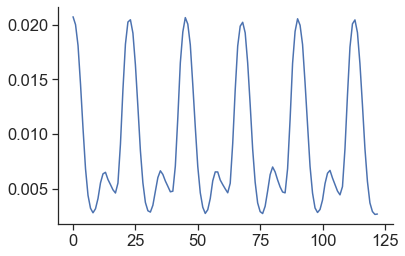

In [169]:
plt.plot(image_mdf.iloc[1].mean_trace)

In [155]:
image_mdf.experience_level.unique()

array(['Familiar', 'Novel', 'Novel +'], dtype=object)

## main cluster plots

### heatmaps

In [40]:
def remap_coding_scores_to_session_colors(coding_scores):
    """
    coding_scores is an array where rows are cells (or cluster ids) and columns are experience level / coding feature combinations
    """
    coding_scores_remapped = coding_scores.copy()
    
    colors = experience_level_colors.copy()
    # colors = c_vals # Kyle's colors
    coding_score_cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ["white", colors[0], "white", colors[1], "white", colors[2]])

    # familiar sessions are in scale of 0-1 already
    # add 2 to novel sessions to make them in the scale of colors[1]
    coding_scores_remapped.loc[:, (slice(None), "Novel")] += 2
    coding_scores_remapped.loc[:, (slice(None), "Novel +")] += 4

    # return max value for plotting
    vmax = 5

    return coding_scores_remapped, coding_score_cmap, vmax

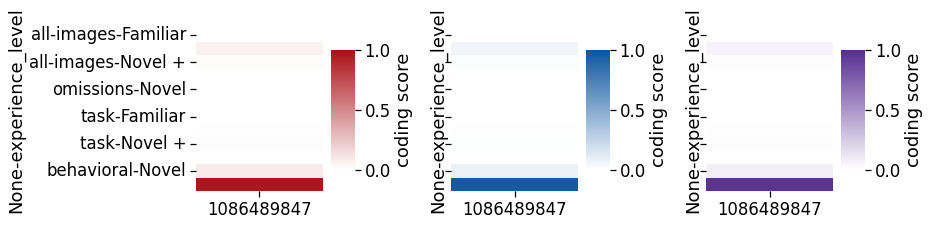

In [41]:
figsize= (12,3)
fig, ax = plt.subplots(1, 3, figsize=figsize, sharey=True)
colors = experience_level_colors.copy()
for i in range (0,3): 
    cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ["white", colors[i]])
    ax[i] = sns.heatmap(pd.DataFrame(feature_matrix.iloc[0]), vmin=0, vmax=1,
                        cmap=cmap, cbar_kws={'aspect':5, 'label':'coding score'}, ax=ax[i])
plt.subplots_adjust(wspace=0.6)

In [42]:
def get_cluster_means(feature_matrix, cluster_meta):
    """
    adds cluster_id column to feature_matrix then groups by the cluster ID to compute the mean of each cluster
    """
    cluster_means = feature_matrix.merge(cluster_meta[['cluster_id']], on='cell_specimen_id').groupby('cluster_id').mean()
    # reset column values so they arent tuples
    columns = pd.MultiIndex.from_tuples(cluster_means.columns)
    cluster_means.columns = columns
    return cluster_means

In [43]:
def get_cre_line_means(feature_matrix, cluster_meta):
    """
    adds cluster_id column to feature_matrix then groups by the cre line to compute the mean of each cre line
    """
    cre_line_means = feature_matrix.merge(cluster_meta[['cre_line']], on='cell_specimen_id').groupby('cre_line').mean()
    # reset column values so they arent tuples
    columns = pd.MultiIndex.from_tuples(cre_line_means.columns)
    cre_line_means.columns = columns
    return cre_line_means

In [44]:
def get_clean_labels_for_coding_scores_df(coding_scores, columns=False): 
    """
    coding_scores should be a data frame with cells or clusters as colums (or indices) and 
    (coding score category - experience level) as multi-index columms (or indices)
    specify axis to transform by setting columns to True or False
    """
    if columns:
        experience_level_labels = coding_scores.columns.get_level_values(1)
    else:
        experience_level_labels = coding_scores.index.get_level_values(1)
    exp_level_abbreviations = [exp_level.split(' ')[0][0] if len(exp_level.split(' ')) == 1 else exp_level.split(' ')[0][0] + exp_level.split(' ')[1][:2] for exp_level in experience_level_labels]
    # manually label feature categories
    # feature_labels = ['', 'images', '', '', 'omissions', '', '', 'behavioral', '', '', 'task', '']
    # new_labels = pd.MultiIndex.from_arrays((feature_labels, exp_level_abbreviations))
    new_labels = exp_level_abbreviations
    return new_labels

In [45]:
def color_yaxis_labels_by_experience(ax):
    """
    iterates through y-axis tick labels and sets them to experience level colors in an alternating way,
    assuming that the labels are in [F, N, N+] order for the 4 feature categories (images, omission, behvaioral, task)
    """
    c_vals = utils.get_experience_level_colors()
    [t.set_color(i) for (i,t) in zip([
            c_vals[0], c_vals[1], c_vals[2], c_vals[0], c_vals[1], c_vals[2],
            c_vals[0], c_vals[1], c_vals[2], c_vals[0], c_vals[1], c_vals[2]
        ], ax.yaxis.get_ticklabels())]


In [46]:
def plot_cre_line_means_heatmap(cre_line_means, cmap, vmax, colorbar=False, 
                                save_dir=None, folder=None, ax=None):
    """
    plots a heatmap of mean coding score values for each cre line with a given colormap and vmax
    cre_line_means: dataframe with cre lines as columns and feature-experience combinations as rows 
    """
    if ax is None: 
        figsize = (8,5)
        fig, ax = plt.subplots(figsize=figsize)
    ax = sns.heatmap(cre_line_means, cmap=cmap, vmin=0, vmax=vmax, square=True, cbar=colorbar, ax=ax)
    sns.despine(ax=ax, top=False, right=False, left=False, bottom=False, offset=None, trim=False)
    ax.set_ylabel('')
    ax.set_xticklabels([utils.get_abbreviated_cell_type(cre_line) for cre_line in cre_line_means.columns.values])
    ax.set_xlabel('')
    ax.set_title('avg.\ncoding')
    # dotted gray lines in between feature categories
    for y in [3, 6, 9]:
        ax.axhline(y=y, xmin=0, xmax=cre_line_means.shape[0], color='gray', linestyle='--', linewidth=1)

    # # label feature categories on right
    # fontsize = 12
    # rotation = -90
    # ax.text(s='images', x=3.25, y=1.5, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='left')
    # ax.text(s='omissions', x=3.28, y=4.4, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='left')
    # ax.text(s='behavioral', x=3.25, y=7.5, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='left')
    # ax.text(s='task', x=3.28, y=10.5, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='left')

    # colorize y axis labels
    color_yaxis_labels_by_experience(ax)
    # rotate labels
    ax.set_yticklabels(cre_line_means.index, rotation=0)

    if save_dir:
        utils.save_figure(fig, figsize, save_dir, folder, 'cre_line_means')

    return ax


In [47]:
def plot_cre_line_means_remapped(feature_matrix, cluster_meta, save_dir=None, folder=None):
    """
    Get the average coding score values for each cre line, remap the colormap to use session colors, 
    Translate the dataframe so that cre lines are columns and rows are feature-experience combos, 
    abbreviate the labels for aesthetics, then plot
    """
    cre_line_means = get_cre_line_means(feature_matrix, cluster_meta)

    cre_line_means_remapped, coding_score_cmap, vmax = remap_coding_scores_to_session_colors(cre_line_means)
    cre_line_means_remapped = cre_line_means_remapped.T.copy()

    # relabel dataframe indices to be abbreviated
    new_labels = get_clean_labels_for_coding_scores_df(cre_line_means_remapped, columns=False)
    cre_line_means_remapped.index = new_labels

    plot_cre_line_means_heatmap(cre_line_means_remapped, coding_score_cmap, vmax, colorbar=False, 
                                save_dir=save_dir, folder=folder, ax=None)

In [48]:
def plot_cluster_means_heatmap(cluster_means, cmap, vmax, colorbar=False, ax=None):
    """
    plots a heatmap of cluster mean value with a given colormap and vmax
    cluster_means: dataframe with clusters as columns and feature-experience combinations as rows 
    """
    if ax is None: 
        figsize = (8,5)
        fig, ax = plt.subplots(figsize=figsize)
    ax = sns.heatmap(cluster_means, cmap=cmap, vmin=0, vmax=vmax, square=True, cbar=colorbar, ax=ax)
    sns.despine(ax=ax, top=False, right=False, left=False, bottom=False, offset=None, trim=False)
    ax.set_ylabel('')
    ax.set_xlabel('cluster ID')
    ax.set_title('cluster averages')
    # dotted gray lines in between feature categories
    for y in [3, 6, 9]:
        ax.axhline(y=y, xmin=0, xmax=cluster_means.shape[0], color='gray', linestyle='--', linewidth=1)

    # dotted gray lines every 3rd cluster
    for x in [3, 6, 9]:
        ax.axvline(x=x, ymin=0, ymax=cluster_means.shape[0], color='gray', linestyle='--', linewidth=1)

    # label feature categories on right
    fontsize = 12
    rotation = -90
    ax.text(s='images', x=12.25, y=1.5, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='left')
    ax.text(s='omissions', x=12.28, y=4.4, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='left')
    ax.text(s='task', x=12.25, y=7.5, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='left')
    ax.text(s='behavioral', x=12.28, y=10.5, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='left')

    # colorize y axis labels
    color_yaxis_labels_by_experience(ax)

    return ax


In [49]:
def plot_cluster_means_remapped(feature_matrix, cluster_meta, save_dir=None, folder=None, ax=None): 
    """
    Get the average coding score values for each cluster, remap the colormap to use session colors, 
    Translate the dataframe so that clusters are columns and rows are feature-experience combos, 
    abbreviate the labels for aesthetics, then plot
    """
    # compute cluster means
    cluster_means = get_cluster_means(feature_matrix, cluster_meta)
    # remap to session colors
    cluster_means_remapped, coding_score_cmap, vmax = remap_coding_scores_to_session_colors(cluster_means)
    # translate the df so clusters are cols and feature-exp are rows
    cluster_means_remapped = cluster_means_remapped.T.copy()
    # relabel dataframe indices to be abbreviated
    new_labels = get_clean_labels_for_coding_scores_df(cluster_means_remapped, columns=False)
    cluster_means_remapped.index = new_labels
    # make the plot
    if ax is None:
        figsize = (8,5)
        fig, ax = plt.subplots(figsize=figsize)
    ax = plot_cluster_means_heatmap(cluster_means_remapped, coding_score_cmap, vmax, colorbar=False, ax=ax)    
    ax.set_yticklabels(new_labels, rotation=0)
    # save
    if save_dir:
        utils.save_figure(fig, figsize, save_dir, folder, 'cluster_means_remapped')
    return ax




c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\pandas\core\frame.py:9203: FutureWarning: merging between different levels is deprecated and will be removed in a future version. (2 levels on the left,1 on the right)
  validate=validate,


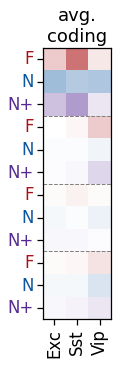

In [50]:
plotting.plot_cre_line_means_remapped(feature_matrix, cluster_meta, save_dir, folder)

In [51]:
processing.get_features_for_clustering()

['all-images', 'omissions', 'task', 'behavioral']

<AxesSubplot:title={'center':'cluster averages'}, xlabel='cluster ID'>

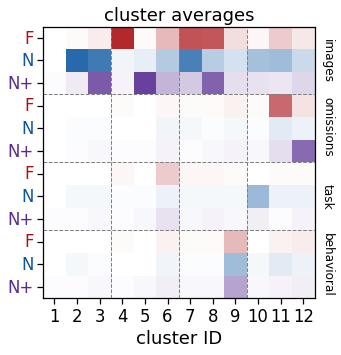

In [52]:
plotting.plot_cluster_means_remapped(feature_matrix, cluster_meta, save_dir=save_dir, folder=folder, ax=None)

In [53]:
# plot_cluster_means_remapped(feature_matrix, cluster_meta, orient='horiz', save_dir=save_dir, folder=folder, ax=None)

In [54]:
def plot_coding_score_heatmap_remapped(cluster_meta, feature_matrix, sort_by='cluster_id', session_colors=True,
                                    save_dir=None, folder=None, ax=None):
    """
    Plot heatmap of all cells coding scores, sorted by cluster_id (or some other column of cluster_meta)
    with lines between clusters. 
    cluster_meta: dataframe of cell metadata, indexed by cell_specimen_id, with the cluster_id for each cell_specimen_id
    feature_matrix: dataframe of coding score values, indexed by cell_specimen_id
    sort_by: column in cluster_meta to sort the cells by, should be 'cluster_id' or similar identifier for what cluster / group a cell belongs to
    orient: 'horiz' or 'vert'; whether to orient the plot vertically (cells on y axis, coding socres on x) or horizontally (cells on x axis, coding scores on y)
    session_colors: if True, will plot the coding score values using the color of the experience level for that coding score
                    if False, default colormap will be used ("Blues_r")
    """

    if sort_by is not None: 
        sorted_cluster_meta = cluster_meta.sort_values(by=sort_by)
        label_values = sorted_cluster_meta[sort_by].values
        n_clusters = len(sorted_cluster_meta[sort_by].unique())
    else: 
        sorted_cluster_meta = cluster_meta.copy()
    cell_order = sorted_cluster_meta.index.values

    # get data from feature matrix for this set of cells
    coding_scores_sorted = feature_matrix.loc[cell_order].copy()

    # Kyle's colors
    # c_vals = ['#e53e3e', '#3182ce', '#805ad5',] #v6

    # remap coding scores to experience level colors
    if session_colors:
        coding_scores_remapped, coding_score_cmap, vmax = remap_coding_scores_to_session_colors(coding_scores_sorted)
        cbar = False
    else:
        vmax = 1
        coding_score_cmap = 'Blues'
        cbar = True

    # translate so rows are feature-exp combos and columns are cells
    coding_scores_remapped = coding_scores_remapped.T.copy()

    # relabel dataframe indices to be abbreviated experience labels (without feature categories)
    new_labels = get_clean_labels_for_coding_scores_df(coding_scores_remapped, columns=False)
    coding_scores_remapped.index = new_labels

    figsize = (12,5)
    fig, ax = plt.subplots(figsize=figsize)

    ax = sns.heatmap(coding_scores_remapped, cmap=coding_score_cmap, ax=ax, vmin=0, vmax=vmax, 
                        robust=True, cbar=cbar, cbar_kws={"drawedges": False, "shrink": 0.7, "label": 'coding score'})

    # dotted gray lines in between feature categories
    for y in [3, 6, 9]:
        ax.axhline(y=y, xmin=0, xmax=coding_scores_remapped.shape[0], color='gray', linestyle='--', linewidth=1)

    # y-axis formtting
    # ax.set_ylim(ax.get_ylim()[::-1])  # flip y axes so larger clusters are on top
    ax.set_ylabel('')
    ax.set_ylim(0, coding_scores_remapped.shape[0])
    # set y ticks to F, N, N+ with correct colors
    # ax.set_yticks(np.arange(n_clusters)+0.5)
    ax.set_yticklabels(new_labels, rotation=0)
    ax.set_ylim(ax.get_ylim()[::-1])  # flip y axes so image clusters are on top

    if session_colors: # colorize y axis labels
        color_yaxis_labels_by_experience(ax)

    # x-axis formatting
    # iterate through clusters, get size of cluster, set tick location for middle of cluster
    if sort_by is not None:
        cell_count = 0
        cluster_ticks = []
        for cluster_id in range(n_clusters):
            n_cells_in_cluster = len(cluster_meta[cluster_meta[sort_by]==cluster_id])
            cluster_ticks.append(cell_count + n_cells_in_cluster/2)
            cell_count += n_cells_in_cluster
        # plot bottom x labels for cluster IDS
        ax.set_xlabel('cluster ID')
        ax.set_xticks(cluster_ticks)
        ax.set_xticklabels(np.sort(cluster_meta.cluster_id.unique()), rotation=0)
        ax.set_xlim(0, coding_scores_remapped.shape[1])

        # top x labels for cells
        ax2 = ax.twiny()
        # ax2.set_xlabel('cells')
        ax2.text(s='cells', x=coding_scores_remapped.shape[1]/2, y=-0.5, ha='center')
        # ax.set_xlim(ax.get_xlim())
        ax2.set_xlim(0, coding_scores_remapped.shape[1])
        ax2.set_xticks([0, coding_scores_remapped.shape[1]])
        ax2.set_xticklabels((0, coding_scores_remapped.shape[1]), rotation=0)
    else: 
        ax.set_xlim(0, coding_scores_remapped.shape[1])
        ax.set_xticks([0, coding_scores_remapped.shape[1]])
        ax.set_xticklabels((0, coding_scores_remapped.shape[1]), rotation=0)
        ax.set_xlabel('cells')

    # plot a line at the division point between clusters
    if sort_by is not None:
        cluster_divisions = np.where(np.diff(label_values) == 1)[0]
        for x in cluster_divisions:
            ax.vlines(x, ymin=0, ymax=coding_scores_remapped.shape[1], color='k')

    # label feature categories on left
    rotation = 0
    fontsize = 16
    ax.text(s='images', x=-300.25, y=1.5, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='right')
    ax.text(s='omissions', x=-300.28, y=4.4, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='right')
    ax.text(s='task', x=-300.25, y=7.5, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='right')
    ax.text(s='behavioral', x=-300.28, y=10.5, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='right')

    sns.despine(ax=ax, top=False, right=False, left=False, bottom=False, offset=None, trim=False)

    if save_dir:
        fig.subplots_adjust(wspace=0.7)
        n_clusters = len(cluster_meta.cluster_id.unique())
        if sort_by is None: 
            sort_by = ''
        utils.save_figure(fig, figsize, save_dir, folder, 'feature_matrix_n_clusters_'+str(n_clusters)+'_remapped_'+sort_by+'_sort')

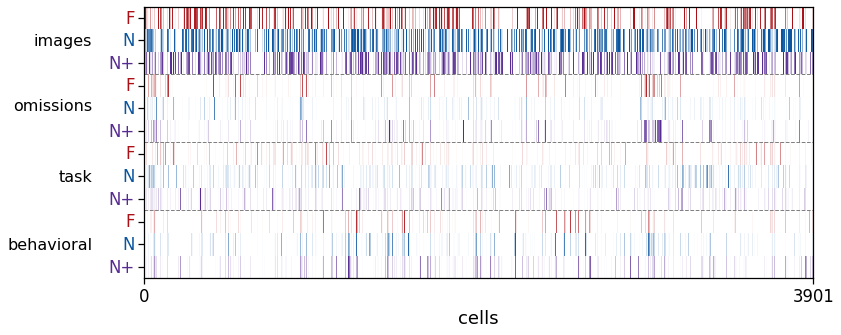

In [55]:
cluster_meta_tmp = cluster_meta.copy()
cluster_meta_tmp['cell_index'] = cluster_meta_tmp.index.values
plotting.plot_coding_score_heatmap_remapped(cluster_meta_tmp, feature_matrix, sort_by=None, session_colors=True,
                                    save_dir=save_dir, folder=folder, ax=None)

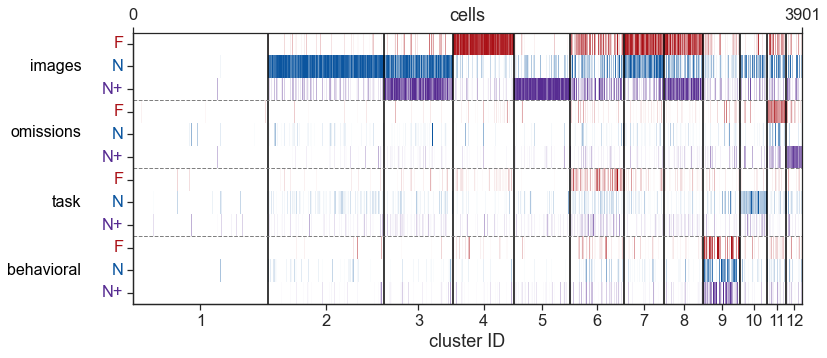

In [163]:
plotting.plot_coding_score_heatmap_remapped(cluster_meta, feature_matrix, sort_by='cluster_id', session_colors=True,
                                    save_dir=save_dir, folder=folder, ax=None)

<AxesSubplot:title={'center':'cluster averages'}, xlabel='cluster ID'>

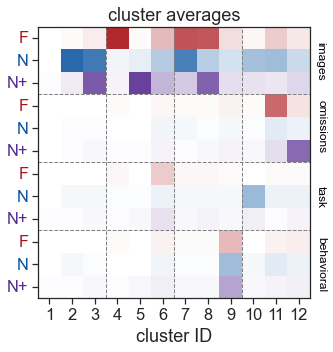

In [164]:
plotting.plot_cluster_means_remapped(feature_matrix, cluster_meta, save_dir=save_dir, folder=folder, ax=None)

In [58]:
# cluster_meta_tmp = cluster_meta.copy()
# cluster_meta_tmp['cell_index'] = cluster_meta_tmp.index.values
# plot_coding_score_heatmap_remapped(cluster_meta_tmp, feature_matrix, sort_by=None, session_colors=True, orient='horiz',
#                                     save_dir=save_dir, folder=folder, ax=None)

### fraction cells per cluster per cre

In [59]:
def get_fraction_cells_per_cluster_per_group(cluster_meta, col_to_group='mouse_id'):
    """
    counts the number of cells a given condition, and the number of cells in each cluster for that given condition,
    then computes the proportion of cells in each cluster for the given condition
    col_to_group: can be 'cre_line', 'mouse_id', etc
    """
    # get number of cells in each group defined by col_to_group
    n_cells_group = cluster_meta.groupby([col_to_group]).count()[['cluster_id']].reset_index().rename(columns={'cluster_id':'n_cells_group'})
    # get number of cells in each cluster for each group
    n_cells_per_cluster = cluster_meta.groupby([col_to_group, 'cluster_id']).count()[['ophys_experiment_id']].reset_index().rename(columns={'ophys_experiment_id':'n_cells_cluster'})
    # add n cells per cluster per group to total number of cells per group and compute the fraction per cluster in each group
    n_cells_per_cluster = n_cells_per_cluster.merge(n_cells_group, on=col_to_group)
    n_cells_per_cluster['fraction_per_cluster'] = n_cells_per_cluster.n_cells_cluster/n_cells_per_cluster.n_cells_group
    
    return n_cells_per_cluster

In [60]:
# sorted within cre
col_to_group = 'cre_line'

def plot_fraction_cells_per_cluster_per_cre(cluster_meta, col_to_group='cre_line'):
    '''   
    plots the fraction of cells in each cre line belonging to each cluster as a barplot
    with one axis / row per cre line
    '''
    n_cells_per_cluster = get_fraction_cells_per_cluster_per_group(cluster_meta, col_to_group)

    figsize = (5,5)
    fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=True, sharex=True)
    for i, cre_line in enumerate(cre_lines):
        cre_data = n_cells_per_cluster[n_cells_per_cluster.cre_line==cre_line]
        order = np.sort(cluster_meta.cluster_id.unique())
        # order = cre_data.sort_values(by='fraction_per_cluster')['cluster_id'][::-1]
        ax[i] = sns.barplot(data=cre_data,  x='cluster_id', order=order, y='fraction_per_cluster', 
                    color='gray', width=0.5, ax=ax[i])
        ax[i].set_ylabel('')
        ax[i].set_xlabel('')
        # ax[i].set_ylim(0, 0.3)
        ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
        # dotted gray lines every 3rd cluster
        for x in [2.5, 5.5, 8.5]:
            ax[i].axvline(x=x, ymin=0, color='gray', linestyle='--', linewidth=1)

    ax[1].set_ylabel('fraction cells in each cluster')
    ax[i].set_xlabel('cluster ID')
    sns.despine(fig=fig, top=True, right=True, left=False, bottom=False, offset=None, trim=False)

    plt.subplots_adjust(hspace=0.5)
    
    if save_dir:
        utils.save_figure(fig, figsize, save_dir, folder, 'fraction_cells_per_cluster_per_cre')

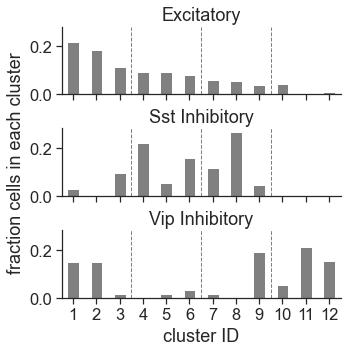

In [324]:
plotting.plot_fraction_cells_per_cluster_per_cre(cluster_meta, col_to_group='cre_line', 
                                                    save_dir=save_dir, folder=folder)

In [62]:
cell_counts = cluster_meta.groupby(['cell_type']).count().rename(columns={'cre_line':'n_cells'})[['n_cells']]
cell_counts

,n_cells
cell_type,
Excitatory,3298
Sst Inhibitory,194
Vip Inhibitory,409


In [63]:
cell_counts = cluster_meta.reset_index().drop_duplicates(subset='cell_specimen_id').copy()
cell_counts = cell_counts.groupby(['cell_type']).count()
cell_counts

,cell_specimen_id,ophys_experiment_id,cre_line,cluster_id,labels,within_cluster_correlation_p,equipment_name,full_genotype,mouse_id,reporter_line,...,layer,area_layer,date,first_novel,n_relative_to_first_novel,last_familiar,last_familiar_active,second_novel,second_novel_active,experience_exposure
cell_type,,,,,,,,,,,,,,,,,,,,,
Excitatory,3298,3298,3298,3298,3298,2673,3298,3298,3298,3298,...,3298,3298,3298,3298,3298,3298,3298,3298,3298,3298
Sst Inhibitory,194,194,194,194,194,190,194,194,194,194,...,194,194,194,194,194,194,194,194,194,194
Vip Inhibitory,409,409,409,409,409,364,409,409,409,409,...,409,409,409,409,409,409,409,409,409,409


## single cell plots

In [64]:
import visual_behavior.dimensionality_reduction.clustering.single_cell_plots as scp

#### single cell coding heatmap for schematic

In [65]:
def plot_single_cell_coding_heatmap(cluster_id, cell_specimen_id, feature_matrix, save_dir=None, folder=None, ax=None):
    cell_data = feature_matrix.loc[cell_specimen_id]
    cell_data = pd.DataFrame(cell_data).reset_index().rename(columns={cell_specimen_id:'coding_score', 'level_0':'feature'})

    # get experience level labels
    new_labels = get_clean_labels_for_coding_scores_df(feature_matrix, columns=True, superscript=False)
    features = cell_data.feature.unique()
    # get abbreviated cre line 
    cre_line = cells_table[cells_table.cell_specimen_id==cell_specimen_id].cre_line.values[0]
    cell_type = utils.get_abbreviated_cell_type(cre_line)

    # get data to plot
    cell_data = cell_data.set_index(['feature', 'experience_level']).T
    cell_data, cmap, vmax = remap_coding_scores_to_session_colors(cell_data)
    cell_data = cell_data.melt()
    cell_data = cell_data.set_index(['feature', 'experience_level'])

    figsize = (5,2)
    fig, ax = plt.subplots(figsize=figsize)
    ax = sns.heatmap(cell_data.T, cmap=cmap, vmin=0, vmax=vmax, square=True, linewidths=1, linecolor='black', ax=ax, cbar=False)
    for _, spine in ax.spines.items():
        spine.set_visible(True)
    ax.set_xticklabels(new_labels, rotation=0)
    ax.set_xlabel('')
    ax.set_ylabel('')

    # colorize y axis labels
    color_yaxis_labels_by_experience(ax, yaxis=False)

    x_start=-0.8
    rotation=0
    fontsize=14
    ax.text(s='images', y=x_start+0.25, x=1.47, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='center')
    ax.text(s='omissions', y=x_start+0.25, x=4.45, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='center')
    ax.text(s='task', y=x_start+0.25, x=7.5, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='center')
    ax.text(s='behavior', y=x_start+0.25, x=10.5, rotation=rotation, color='black', fontsize=fontsize, va='center', ha='center')

    plt.suptitle(str(cell_specimen_id)+' '+cell_type+' cluster '+str(cluster_id+1), x=0.5, y=0.9, fontsize=14)
    if save_dir: 
        utils.save_figure(fig, figsize, os.path.join(save_dir, folder), 'cell_examples', 'cluster_'+str(cluster_id+1)+'_'+str(cell_specimen_id)+'_coding_scores_heatmap')
    return ax


<AxesSubplot:>

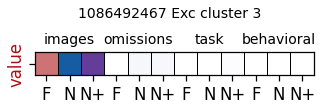

In [66]:
 # get coding scores for this cell

cell_specimen_id = 1086492467 # excitatory cluster 3 cell 
cluster_id = 2
# cell_specimen_id = 1086509065 # Vip cluster 11 cell 

scp.plot_single_cell_coding_heatmap(cluster_id, cell_specimen_id, feature_matrix, cells_table, save_dir=None, folder=None, ax=None)


In [67]:
# for cluster_id in np.sort(cluster_meta.cluster_id.unique()):
#     this_cluster = cluster_meta[cluster_meta.cluster_id==cluster_id]
#     csids = this_cluster.index.unique()
#     cell_roi_ids = cells_table[cells_table.cell_specimen_id.isin(csids)].index.values

#     max_cluster_exp_var = all_results[all_results.cell_roi_id.isin(cell_roi_ids)].sort_values(by='adj_variance_explained_full', ascending=False)
#     max_roi_ids = max_cluster_exp_var.cell_roi_id.values[:50]
#     max_csids = cells_table.loc[max_roi_ids].cell_specimen_id.unique()

#     for cell_specimen_id in max_csids: 
#         plot_single_cell_coding_heatmap(cluster_id, cell_specimen_id, feature_matrix, save_dir=save_dir, folder=folder, ax=None)


### single cell examples from each cluster

In [68]:
def plot_coding_scores_example_cell(cluster_id, cell_specimen_id, feature_matrix, single_axis=True, save_dir=None, folder=None, ax=None):
    '''
    plot barplot of coding scores for each feature category across experience levels
    cell_specimen_id provided must be a cell that is in all 3 experience levels and is in the feature_matrix dataframe
    '''
    # get coding scores for this cell
    cell_data = feature_matrix.loc[cell_specimen_id]
    cell_data = pd.DataFrame(cell_data).reset_index().rename(columns={cell_specimen_id:'coding_score', 'level_0':'feature'})

    # get experience level labels
    new_labels = get_clean_labels_for_coding_scores_df(feature_matrix, columns=True, superscript=False)
    new_labels = new_labels[:3]
    features = cell_data.feature.unique()
    # get abbreviated cre line 
    cre_line = cells_table[cells_table.cell_specimen_id==cell_specimen_id].cre_line.values[0]
    cell_type = utils.get_abbreviated_cell_type(cre_line)

    if single_axis: 
        suffix = '_single_axis_v'
        features = ['images', 'omissions', 'task', 'behavior']
        
        # horizontal
        # if ax is None: 
        #     figsize = (2,5)
        #     fig, ax = plt.subplots(figsize=figsize)
        # ax = sns.barplot(data=cell_data, y='feature', x='coding_score', hue='experience_level', palette=experience_level_colors, orient='h', width=0.5, ax=ax)
        # ax.legend(fontsize='xx-small')
        # ax.set_yticklabels(features, rotation=0, va='center')
        # ax.set_ylabel('')
        # ax.set_xlim(0,1)
        # ax.set_ylabel('coding score')
        # plt.suptitle('csid: '+str(cell_specimen_id), x=0.5, y=1.05, fontsize=14)

        # vertical
        if ax is None: 
            figsize = (5, 2)
            fig, ax = plt.subplots(figsize=figsize)
        ax = sns.barplot(data=cell_data, x='feature', y='coding_score', hue='experience_level', palette=experience_level_colors, orient='v', width=0.5, ax=ax)
        ax.legend(fontsize='xx-small')
        ax.set_xticklabels(features, rotation=0)
        ax.set_xlabel('')
        ax.set_ylim(0,1)
        ax.set_ylabel('coding score')

        ax.set_title('cluster '+str(cluster_id+1)+'\n'+cell_type+' cell')

        plt.suptitle('csid: '+str(cell_specimen_id), x=0.5, y=1.3, fontsize=14)

    else: 
        suffix = ''
        if ax is None: 
            figsize = (9, 2)
            fig, ax = plt.subplots(1, 4, figsize=figsize, sharex=True, sharey=True)
            add_suptitle = True
        else: 
            add_suptitle = False
        for i, feature in enumerate(features): 
            feature_data = cell_data[cell_data.feature==feature] 
            ax[i] = sns.barplot(data=feature_data, x='experience_level', y='coding_score', 
                                palette=experience_level_colors, width=0.5, alpha=0.9, ax=ax[i])
            ax[i].set_title(feature)
            ax[i].set_xticklabels(new_labels)
            ax[i].set_ylabel('')
            ax[i].set_xlabel('')
            ax[i].set_ylim(0, 1)
        ax[0].set_ylabel('coding score')

        if add_suptitle: 
            plt.suptitle(str(cell_specimen_id)+' '+cell_type+' cluster '+str(cluster_id+1), x=0.5, y=1.3, fontsize=14)
    if save_dir: 
        utils.save_figure(fig, figsize, os.path.join(save_dir, folder), 'cell_examples', 'cluster_'+str(cluster_id+1)+'_'+str(cell_specimen_id)+'_coding_scores'+suffix)
    return ax

<AxesSubplot:title={'center':'cluster 11\nExc cell'}, ylabel='coding score'>

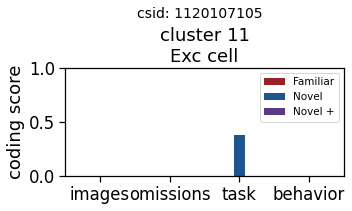

In [69]:
cluster_id = 10
this_cluster = cluster_meta[cluster_meta.cluster_id==cluster_id]
csids = this_cluster.index.unique()
cell_roi_ids = cells_table[cells_table.cell_specimen_id.isin(csids)].index.values

max_cluster_exp_var = all_results[all_results.cell_roi_id.isin(cell_roi_ids)].sort_values(by='adj_variance_explained_full', ascending=False)
max_roi_ids = max_cluster_exp_var.cell_roi_id.values[:50]
max_csids = cells_table.loc[max_roi_ids].cell_specimen_id.unique()

cell_specimen_id = max_csids[0]

scp.plot_coding_scores_example_cell(cluster_id, cell_specimen_id, feature_matrix, cells_table, single_axis=True, save_dir=save_dir, folder=folder, ax=None)

In [70]:
# for cluster_id in np.sort(cluster_meta.cluster_id.unique()):
#     this_cluster = cluster_meta[cluster_meta.cluster_id==cluster_id]
#     csids = this_cluster.index.unique()
#     cell_roi_ids = cells_table[cells_table.cell_specimen_id.isin(csids)].index.values

#     max_cluster_exp_var = all_results[all_results.cell_roi_id.isin(cell_roi_ids)].sort_values(by='adj_variance_explained_full', ascending=False)
#     max_roi_ids = max_cluster_exp_var.cell_roi_id.values[:50]
#     max_csids = cells_table.loc[max_roi_ids].cell_specimen_id.unique()

#     for cell_specimen_id in max_csids: 
#         plot_coding_scores_example_cell(cluster_id, cell_specimen_id, feature_matrix, single_axis=True, save_dir=save_dir, folder=folder, ax=None)

### mean response examples

In [71]:
# data_type = 'events'

# interpolate = True
# output_sampling_rate = 30

# inclusion_criteria = 'platform_experiment_table'

# # params for stim response df creation
# event_type = 'all'

# # params for mean response df creation
# conditions = ['cell_specimen_id', 'is_change']


# change_suffix = '_'+utils.get_conditions_string(data_type, conditions)+'_'+inclusion_criteria

# image_mdf = loading.get_multi_session_df_for_conditions(data_type, event_type, conditions, inclusion_criteria, 
#                                                         interpolate=interpolate, output_sampling_rate=output_sampling_rate, 
#                                                          epoch_duration_mins=None)

# change_mdf = image_mdf[image_mdf.is_change==True]
# image_mdf = image_mdf[image_mdf.is_change==False]



C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


loading files from \\allen\programs\braintv\workgroups\nc-ophys\visual_behavior\platform_paper_cache\multi_session_mean_response_dfs\interpolate_30Hz


  6%|▌         | 1/18 [00:31<09:03, 31.99s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_1_images_B
no multi_session_df for VisualBehaviorMultiscope OPHYS_1_images_G


 22%|██▏       | 4/18 [01:01<03:15, 13.93s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_2_images_B_passive
no multi_session_df for VisualBehaviorMultiscope OPHYS_2_images_G_passive


 39%|███▉      | 7/18 [01:34<02:16, 12.43s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_3_images_B
no multi_session_df for VisualBehaviorMultiscope OPHYS_3_images_G
no multi_session_df for VisualBehaviorMultiscope OPHYS_4_images_A


 61%|██████    | 11/18 [02:13<01:17, 11.01s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_4_images_H
no multi_session_df for VisualBehaviorMultiscope OPHYS_5_images_A_passive


 78%|███████▊  | 14/18 [02:40<00:41, 10.41s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_5_images_H_passive
no multi_session_df for VisualBehaviorMultiscope OPHYS_6_images_A


100%|██████████| 18/18 [03:02<00:00, 10.15s/it]


no multi_session_df for VisualBehaviorMultiscope OPHYS_6_images_H


  0%|          | 0/18 [00:00<?, ?it/s]

no multi_session_df for VisualBehaviorTask1B OPHYS_1_images_A


 11%|█         | 2/18 [00:09<01:17,  4.86s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_1_images_G
no multi_session_df for VisualBehaviorTask1B OPHYS_2_images_A_passive


 28%|██▊       | 5/18 [00:19<00:49,  3.80s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_2_images_G_passive
no multi_session_df for VisualBehaviorTask1B OPHYS_3_images_A


 44%|████▍     | 8/18 [00:31<00:38,  3.89s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_3_images_G


 56%|█████▌    | 10/18 [00:44<00:37,  4.73s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_4_images_B
no multi_session_df for VisualBehaviorTask1B OPHYS_4_images_H


 72%|███████▏  | 13/18 [00:54<00:20,  4.15s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_5_images_B_passive
no multi_session_df for VisualBehaviorTask1B OPHYS_5_images_H_passive


100%|██████████| 18/18 [01:05<00:00,  3.61s/it]


no multi_session_df for VisualBehaviorTask1B OPHYS_6_images_B
no multi_session_df for VisualBehaviorTask1B OPHYS_6_images_H


  6%|▌         | 1/18 [00:14<03:58, 14.06s/it]

no multi_session_df for VisualBehavior OPHYS_1_images_B
no multi_session_df for VisualBehavior OPHYS_1_images_G


 22%|██▏       | 4/18 [00:26<01:22,  5.89s/it]

no multi_session_df for VisualBehavior OPHYS_2_images_B_passive
no multi_session_df for VisualBehavior OPHYS_2_images_G_passive


 39%|███▉      | 7/18 [00:37<00:52,  4.78s/it]

no multi_session_df for VisualBehavior OPHYS_3_images_B
no multi_session_df for VisualBehavior OPHYS_3_images_G
no multi_session_df for VisualBehavior OPHYS_4_images_A


 61%|██████    | 11/18 [00:50<00:27,  3.95s/it]

no multi_session_df for VisualBehavior OPHYS_4_images_H
no multi_session_df for VisualBehavior OPHYS_5_images_A_passive


 78%|███████▊  | 14/18 [01:00<00:15,  3.83s/it]

no multi_session_df for VisualBehavior OPHYS_5_images_H_passive
no multi_session_df for VisualBehavior OPHYS_6_images_A


100%|██████████| 18/18 [01:12<00:00,  4.01s/it]


no multi_session_df for VisualBehavior OPHYS_6_images_H


  0%|          | 0/18 [00:00<?, ?it/s]

no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_1_images_A
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_1_images_B


 17%|█▋        | 3/18 [00:00<00:01, 11.19it/s]

no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_2_images_A_passive
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_2_images_B_passive


 33%|███▎      | 6/18 [00:00<00:01, 11.42it/s]

no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_3_images_A
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_3_images_B


 50%|█████     | 9/18 [00:00<00:00, 11.63it/s]

no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_4_images_A
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_4_images_B


 67%|██████▋   | 12/18 [00:01<00:00, 11.60it/s]

no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_5_images_A_passive
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_5_images_B_passive


 83%|████████▎ | 15/18 [00:01<00:00, 11.48it/s]

no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_6_images_A
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_6_images_B


100%|██████████| 18/18 [00:01<00:00, 11.52it/s]
C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


there are 1249 experiments in the full multi_session_df
removing 1 problematic experiments
there are 402 experiments in the multi_session_df after limiting to platform experiments
there are 402 experiments after filtering for inclusion criteria -  platform_experiment_table


In [72]:

# # params for stim response df creation
# event_type = 'all'

# # params for mean response df creation
# conditions = ['cell_specimen_id', 'omitted']


# omission_suffix = '_'+utils.get_conditions_string(data_type, conditions)+'_'+inclusion_criteria

# omission_mdf = loading.get_multi_session_df_for_conditions(data_type, event_type, conditions, inclusion_criteria, 
#                                                         interpolate=interpolate, output_sampling_rate=output_sampling_rate, 
#                                                          epoch_duration_mins=None)

# omission_mdf = omission_mdf[omission_mdf.omitted==True]

C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


loading files from \\allen\programs\braintv\workgroups\nc-ophys\visual_behavior\platform_paper_cache\multi_session_mean_response_dfs\interpolate_30Hz


  6%|▌         | 1/18 [00:31<09:03, 32.00s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_1_images_B
no multi_session_df for VisualBehaviorMultiscope OPHYS_1_images_G


 22%|██▏       | 4/18 [01:00<03:14, 13.89s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_2_images_B_passive
no multi_session_df for VisualBehaviorMultiscope OPHYS_2_images_G_passive


 39%|███▉      | 7/18 [01:34<02:16, 12.44s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_3_images_B
no multi_session_df for VisualBehaviorMultiscope OPHYS_3_images_G
no multi_session_df for VisualBehaviorMultiscope OPHYS_4_images_A


 61%|██████    | 11/18 [02:12<01:17, 11.00s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_4_images_H
no multi_session_df for VisualBehaviorMultiscope OPHYS_5_images_A_passive


 78%|███████▊  | 14/18 [02:41<00:41, 10.44s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_5_images_H_passive
no multi_session_df for VisualBehaviorMultiscope OPHYS_6_images_A


100%|██████████| 18/18 [03:03<00:00, 10.18s/it]


no multi_session_df for VisualBehaviorMultiscope OPHYS_6_images_H


  0%|          | 0/18 [00:00<?, ?it/s]

no multi_session_df for VisualBehaviorTask1B OPHYS_1_images_A


 11%|█         | 2/18 [00:09<01:18,  4.89s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_1_images_G
no multi_session_df for VisualBehaviorTask1B OPHYS_2_images_A_passive


 28%|██▊       | 5/18 [00:19<00:49,  3.84s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_2_images_G_passive
no multi_session_df for VisualBehaviorTask1B OPHYS_3_images_A


 44%|████▍     | 8/18 [00:31<00:39,  3.94s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_3_images_G


 56%|█████▌    | 10/18 [00:45<00:38,  4.78s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_4_images_B
no multi_session_df for VisualBehaviorTask1B OPHYS_4_images_H


 72%|███████▏  | 13/18 [00:55<00:20,  4.18s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_5_images_B_passive
no multi_session_df for VisualBehaviorTask1B OPHYS_5_images_H_passive


100%|██████████| 18/18 [01:05<00:00,  3.64s/it]


no multi_session_df for VisualBehaviorTask1B OPHYS_6_images_B
no multi_session_df for VisualBehaviorTask1B OPHYS_6_images_H


  6%|▌         | 1/18 [00:14<03:58, 14.03s/it]

no multi_session_df for VisualBehavior OPHYS_1_images_B
no multi_session_df for VisualBehavior OPHYS_1_images_G


 22%|██▏       | 4/18 [00:25<01:21,  5.85s/it]

no multi_session_df for VisualBehavior OPHYS_2_images_B_passive
no multi_session_df for VisualBehavior OPHYS_2_images_G_passive


 39%|███▉      | 7/18 [00:37<00:52,  4.76s/it]

no multi_session_df for VisualBehavior OPHYS_3_images_B
no multi_session_df for VisualBehavior OPHYS_3_images_G
no multi_session_df for VisualBehavior OPHYS_4_images_A


 61%|██████    | 11/18 [00:49<00:27,  3.96s/it]

no multi_session_df for VisualBehavior OPHYS_4_images_H
no multi_session_df for VisualBehavior OPHYS_5_images_A_passive


 78%|███████▊  | 14/18 [01:00<00:15,  3.83s/it]

no multi_session_df for VisualBehavior OPHYS_5_images_H_passive
no multi_session_df for VisualBehavior OPHYS_6_images_A


100%|██████████| 18/18 [01:12<00:00,  4.02s/it]


no multi_session_df for VisualBehavior OPHYS_6_images_H


  0%|          | 0/18 [00:00<?, ?it/s]

no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_1_images_A
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_1_images_B


 17%|█▋        | 3/18 [00:00<00:01,  9.37it/s]

no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_2_images_A_passive
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_2_images_B_passive


 33%|███▎      | 6/18 [00:00<00:01,  9.60it/s]

no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_3_images_A
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_3_images_B


 50%|█████     | 9/18 [00:00<00:00, 10.25it/s]

no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_4_images_A
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_4_images_B


 67%|██████▋   | 12/18 [00:01<00:00,  9.80it/s]

no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_5_images_A_passive
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_5_images_B_passive


 83%|████████▎ | 15/18 [00:01<00:00,  9.92it/s]

no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_6_images_A
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_6_images_B


100%|██████████| 18/18 [00:01<00:00, 10.06it/s]
C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


there are 1249 experiments in the full multi_session_df
removing 1 problematic experiments
there are 402 experiments in the multi_session_df after limiting to platform experiments
there are 402 experiments after filtering for inclusion criteria -  platform_experiment_table


In [73]:
def plot_matched_cell_traces(cluster_id, cell_specimen_id, image_mdf, omission_mdf, change_mdf, cells_table, save_dir=None, folder=None, ax=None): 
    """
    plot the average image, change, and omission traces for a matched cell

    """
    ylabel = 'response'
    experience_levels = np.sort(omission_mdf.experience_level.unique())
    experience_level_colors = utils.get_experience_level_colors()

    if ax is None: 
        figsize = (9, 2)
        fig, ax = plt.subplots(1, 3, figsize=figsize, sharey=True)
        add_suptitle = True
    else: 
        add_suptitle = False

    i = 0
    for e, experience_level in enumerate(experience_levels): 
        color = experience_level_colors[e]
        cell_data = image_mdf[(image_mdf.cell_specimen_id==cell_specimen_id) & (image_mdf.experience_level==experience_level)]
        ax[i] = utils.plot_mean_trace_from_mean_df(cell_data,  ylabel=ylabel, legend_label=None, 
                                                    color=color, interval_sec=0.5, xlabel = 'time (s)',
                                                        xlims=[-0.5, 0.75], plot_sem=True, ax=ax[i])
        ax[i] = utils.plot_flashes_on_trace(ax[i], cell_data.trace_timestamps.values[0], change=False, omitted=False)
        ax[i].set_title('images')

    i = 1
    for e, experience_level in enumerate(experience_levels): 
        color = experience_level_colors[e]
        cell_data = omission_mdf[(omission_mdf.cell_specimen_id==cell_specimen_id) & (omission_mdf.experience_level==experience_level)]
        ax[i] = utils.plot_mean_trace_from_mean_df(cell_data,  ylabel=ylabel, legend_label=None, 
                                                    color=color, interval_sec=1, xlabel = 'time (s)',
                                                        xlims=[-1, 1.5], plot_sem=True, ax=ax[i])
        ax[i] = utils.plot_flashes_on_trace(ax[i], cell_data.trace_timestamps.values[0], change=False, omitted=True)
        ax[i].set_ylabel('')
        ax[i].set_title('omissions')

    i = 2
    for e, experience_level in enumerate(experience_levels): 
        color = experience_level_colors[e]
        cell_data = change_mdf[(change_mdf.cell_specimen_id==cell_specimen_id) & (change_mdf.experience_level==experience_level)]
        ax[i] = utils.plot_mean_trace_from_mean_df(cell_data,  ylabel=ylabel, legend_label=None, 
                                                    color=color, interval_sec=0.5, xlabel = 'time (s)',
                                                        xlims=[-1, 0.75], plot_sem=True, ax=ax[i])
        ax[i] = utils.plot_flashes_on_trace(ax[i], cell_data.trace_timestamps.values[0], change=True, omitted=False)
        ax[i].set_ylabel('')
        ax[i].set_title('changes')

    ax[0].set_ylabel(ylabel)

    if add_suptitle: 
        plt.subplots_adjust(wspace=0.2)
        # get abbreviated cre line 
        cre_line = cells_table[cells_table.cell_specimen_id==cell_specimen_id].cre_line.values[0]
        cell_type = utils.get_abbreviated_cell_type(cre_line)
        plt.suptitle(str(cell_specimen_id)+' '+cell_type+' cluster '+str(cluster_id+1), x=0.5, y=1.3, fontsize=14)
    if save_dir: 
        utils.save_figure(fig, figsize, os.path.join(save_dir, folder), 'cell_examples', 'cluster_'+str(cluster_id+1)+'_'+str(cell_specimen_id)+'_traces')
    return ax

In [74]:
# omission_responses = omission_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
# omission_responses = omission_responses[omission_responses.omitted==True]
# image_responses = image_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
# image_responses = image_responses[image_responses.is_change==False]
# change_responses = change_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
# change_responses = change_responses[change_responses.is_change==True]

In [ ]:
image_responses = image_mdf.copy()
change_responses = change_mdf.copy()
omission_responses = omission_mdf.copy()

array([<AxesSubplot:title={'center':'images'}, xlabel='time (s)', ylabel='response'>,
       <AxesSubplot:title={'center':'omissions'}, xlabel='time (s)'>,
       <AxesSubplot:title={'center':'changes'}, xlabel='time (s)'>],
      dtype=object)

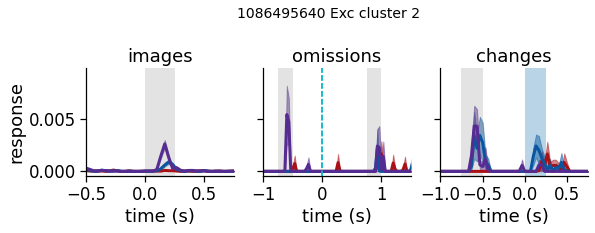

In [75]:
cluster_id = 1

this_cluster = cluster_meta[cluster_meta.cluster_id==cluster_id]
csids = this_cluster.index.unique()
cell_roi_ids = cells_table[cells_table.cell_specimen_id.isin(csids)].index.values

max_cluster_exp_var = all_results[all_results.cell_roi_id.isin(cell_roi_ids)].sort_values(by='adj_variance_explained_full', ascending=True)
max_roi_ids = max_cluster_exp_var.cell_roi_id.values[50:100]
max_csids = cells_table.loc[max_roi_ids].cell_specimen_id.unique()

cell_specimen_id = max_csids[0]
    
scp.plot_matched_cell_traces(cluster_id, cell_specimen_id, image_responses, omission_responses, change_responses, cells_table, save_dir=save_dir, folder=folder, ax=None)

In [76]:
# cluster_id = 10

# this_cluster = cluster_meta[cluster_meta.cluster_id==cluster_id]
# csids = this_cluster.index.unique()
# cell_roi_ids = cells_table[cells_table.cell_specimen_id.isin(csids)].index.values

# max_cluster_exp_var = all_results[all_results.cell_roi_id.isin(cell_roi_ids)].sort_values(by='adj_variance_explained_full', ascending=True)
# max_roi_ids = max_cluster_exp_var.cell_roi_id.values[50:100]
# max_csids = cells_table.loc[max_roi_ids].cell_specimen_id.unique()

# for cell_specimen_id in max_csids:
    
#     plot_matched_cell_traces(cluster_id, cell_specimen_id, image_responses, omission_responses, change_responses, cells_table, save_dir=save_dir, folder=folder, ax=None)

In [77]:
# omission_responses = omission_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
# omission_responses = omission_responses[omission_responses.omitted==True]
# image_responses = image_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
# image_responses = image_responses[image_responses.is_change==False]
# change_responses = change_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
# change_responses = change_responses[change_responses.is_change==True]


# for cluster_id in np.sort(cluster_meta.cluster_id.unique()):
#     this_cluster = cluster_meta[cluster_meta.cluster_id==cluster_id]
#     csids = this_cluster.index.unique()
#     cell_roi_ids = cells_table[cells_table.cell_specimen_id.isin(csids)].index.values

#     max_cluster_exp_var = all_results[all_results.cell_roi_id.isin(cell_roi_ids)].sort_values(by='adj_variance_explained_full', ascending=False)
#     max_roi_ids = max_cluster_exp_var.cell_roi_id.values[:50]
#     max_csids = cells_table.loc[max_roi_ids].cell_specimen_id.unique()
#     for cell_specimen_id in max_csids:
        
#         plot_matched_cell_traces(cluster_id, cell_specimen_id, image_responses, omission_responses, change_responses, cells_table, save_dir=save_dir, folder=folder, ax=None)

### matched ROIs

In [78]:

def plot_matched_cell_rois(cluster_id, cell_specimen_id, cells_table, save_dir=None, folder=None, ax=None): 
    """
    plot the cell mask and max projection image for the 3 experience levels the cell is matched in, 

    """
    import visual_behavior.visualization.ophys.summary_figures as sf

    experience_levels = np.sort(cells_table.experience_level.unique())

    if ax is None: 
        figsize = (9, 2)
        fig, ax = plt.subplots(1, 3, figsize=figsize, )
        add_suptitle = True
    else: 
        add_suptitle = False
    experience_levels = cells_table.experience_level.unique()
    experience_level_colors = utils.get_experience_level_colors()
    for i, experience_level in enumerate(experience_levels): 
        color = experience_level_colors[i]
        # get experiment dataset for this experience level 
        this_cell_metadata = cells_table[(cells_table.cell_specimen_id==cell_specimen_id)& (cells_table.experience_level==experience_level)]
        ophys_experiment_id = this_cell_metadata.ophys_experiment_id.values[0]
        cell_roi_id = this_cell_metadata.index.values[0]
        dataset = loading.get_ophys_dataset(ophys_experiment_id, get_extended_stimulus_presentations=False)
        ax[i] = sf.plot_cell_zoom(dataset.roi_masks, dataset.max_projection, cell_roi_id,
                                    spacex=50, spacey=50, show_mask=True, ax=ax[i])
        ax[i].set_title(experience_level, color=color)
    
    if add_suptitle: 
        plt.subplots_adjust(wspace=0.5)
        # get abbreviated cre line 
        cre_line = cells_table[cells_table.cell_specimen_id==cell_specimen_id].cre_line.values[0]
        cell_type = utils.get_abbreviated_cell_type(cre_line)
        plt.suptitle(str(cell_specimen_id)+' '+cell_type+' cluster '+str(cluster_id+1), x=0.5, y=1.3, fontsize=14)
    if save_dir: 
        utils.save_figure(fig, figsize, os.path.join(save_dir, folder), 'cell_examples', 'cluster_'+str(cluster_id+1)+'_'+str(cell_specimen_id)+'_rois')
    return ax

Note, this function is very slow because it has to load each dataset from NWb

In [79]:
# cluster_id = 1

# this_cluster = cluster_meta[cluster_meta.cluster_id==cluster_id]
# csids = this_cluster.index.unique()
# cell_roi_ids = cells_table[cells_table.cell_specimen_id.isin(csids)].index.values

# max_cluster_exp_var = all_results[all_results.cell_roi_id.isin(cell_roi_ids)].sort_values(by='adj_variance_explained_full', ascending=False)
# max_roi_ids = max_cluster_exp_var.cell_roi_id.values[:50]
# max_csids = cells_table.loc[max_roi_ids].cell_specimen_id.unique()

# cell_specimen_id = max_csids[0]

# scp.plot_matched_cell_rois(cluster_id, cell_specimen_id, cells_table, save_dir=save_dir, folder=folder, ax=None)

In [80]:

# for cluster_id in np.sort(cluster_meta.cluster_id.unique()):
#     this_cluster = cluster_meta[cluster_meta.cluster_id==cluster_id]
#     csids = this_cluster.index.unique()
#     cell_roi_ids = cells_table[cells_table.cell_specimen_id.isin(csids)].index.values

#     max_cluster_exp_var = results[results.cell_roi_id.isin(cell_roi_ids)].sort_values(by='adj_variance_explained_full', ascending=False)
#     max_roi_ids = max_cluster_exp_var.cell_roi_id.values[:50]
#     max_csids = cells_table.loc[max_roi_ids].cell_specimen_id.unique()
#     for cell_specimen_id in max_csids:
        
#         plot_matched_cell_rois(cluster_id, cell_specimen_id, cells_table, save_dir=save_dir, folder=folder, ax=None)

## cluster properties

### area / depth proportions for cre lines (this should actually be in figure 2)

In [81]:
cre_stats = processing.get_cre_line_stats_for_locations(cluster_meta, location='layer')
cre_stats

n_cells_location  n_cells_total  \
cre_line          layer                                    
Slc17a7-IRES2-Cre lower              1863           3298   
                  upper              1435           3298   
Sst-IRES-Cre      lower               119            194   
                  upper                75            194   
Vip-IRES-Cre      lower                24            409   
                  upper               385            409   

                         fraction_cells_location  
cre_line          layer                           
Slc17a7-IRES2-Cre lower                 0.564888  
                  upper                 0.435112  
Sst-IRES-Cre      lower                 0.613402  
                  upper                 0.386598  
Vip-IRES-Cre      lower                 0.058680  
                  upper                 0.941320

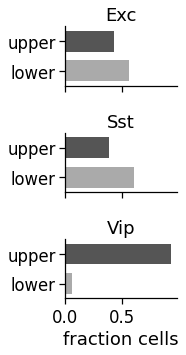

In [82]:
location = 'layer'
order = ['upper', 'lower']
cre_stats = processing.get_cre_line_stats_for_locations(cluster_meta, location)

metric = 'fraction_cells_location'
xlabel = 'fraction cells'

plotting.plot_location_distribution_for_cre_lines(cre_stats, location=location, order=order,
                                            metric=metric, xlabel=xlabel,
                                            sharex=True, ax=None, save_dir=save_dir, folder=folder);


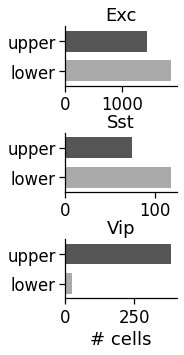

In [83]:
location = 'layer'
order = ['upper', 'lower']
cre_stats = processing.get_cre_line_stats_for_locations(cluster_meta, location)

metric = 'n_cells_location'
xlabel = '# cells'

plotting.plot_location_distribution_for_cre_lines(cre_stats, location=location, order=order,
                                            metric=metric, xlabel=xlabel,
                                            sharex=False, ax=None, save_dir=save_dir, folder=folder);


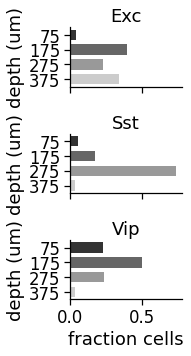

In [84]:
location = 'binned_depth'
order = None
ylabel = 'depth (um)'
cre_stats = processing.get_cre_line_stats_for_locations(cluster_meta, location)

metric = 'fraction_cells_location'
xlabel = 'fraction cells'


plotting.plot_location_distribution_for_cre_lines(cre_stats, location=location, order=order,
                                            metric=metric, xlabel=xlabel, ylabel=ylabel,
                                            sharex=True, ax=None, save_dir=save_dir, folder=folder);


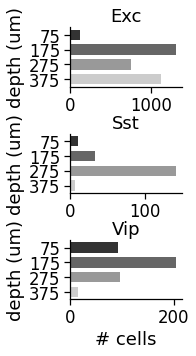

In [85]:
location = 'binned_depth'
order = None
ylabel = 'depth (um)'
cre_stats = processing.get_cre_line_stats_for_locations(cluster_meta, location)

metric = 'n_cells_location'
xlabel = '# cells'


plotting.plot_location_distribution_for_cre_lines(cre_stats, location=location, order=order,
                                            metric=metric, xlabel=xlabel, ylabel=ylabel,
                                            sharex=False, ax=None, save_dir=save_dir, folder=folder);


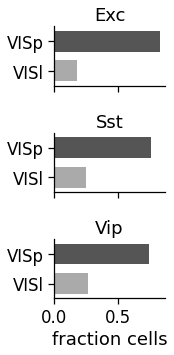

In [86]:
location = 'targeted_structure'
order = ['VISp', 'VISl']
cre_stats = processing.get_cre_line_stats_for_locations(cluster_meta, location)

metric = 'fraction_cells_location'
xlabel = 'fraction cells'

plotting.plot_location_distribution_for_cre_lines(cre_stats, location=location, order=order,
                                            metric=metric, xlabel=xlabel,
                                            sharex=True, ax=None, save_dir=save_dir, folder=folder);


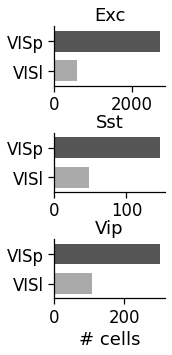

In [87]:
location = 'targeted_structure'
order = ['VISp', 'VISl']
cre_stats = processing.get_cre_line_stats_for_locations(cluster_meta, location)

metric = 'n_cells_location'
xlabel = '# cells'

plotting.plot_location_distribution_for_cre_lines(cre_stats, location=location, order=order,
                                            metric=metric, xlabel=xlabel,
                                            sharex=False, ax=None, save_dir=save_dir, folder=folder);


### population average response per cluster

#### load multi-session data if needed (should be loaded in top of notebook)

In [88]:
# data_type = 'events'

# interpolate = True
# output_sampling_rate = 30

# # set inclusion criteria
# # options: ['active_only', 'closest_familiar_and_novel', 'containers_with_all_levels']


# inclusion_criteria = 'platform_experiment_table'

In [160]:
# # params for stim response df creation
# event_type = 'all'

# # params for mean response df creation
# conditions = ['cell_specimen_id', 'is_change']


# change_suffix = '_'+utils.get_conditions_string(data_type, conditions)+'_'+inclusion_criteria

# multi_session_df = loading.get_multi_session_df_for_conditions(data_type, event_type, conditions, inclusion_criteria, 
#                                                         interpolate=interpolate, output_sampling_rate=output_sampling_rate, 
#                                                          epoch_duration_mins=None)

# change_mdf = multi_session_df[multi_session_df.is_change==True]
# change_mdf = change_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')

# image_mdf = multi_session_df[(multi_session_df.is_change==False)]
# image_mdf = image_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')

In [159]:
# # params for stim response df creation
# event_type = 'all'

# # params for mean response df creation
# conditions = ['cell_specimen_id', 'omitted']


# change_suffix = '_'+utils.get_conditions_string(data_type, conditions)+'_'+inclusion_criteria

# omission_mdf = loading.get_multi_session_df_for_conditions(data_type, event_type, conditions, inclusion_criteria, 
#                                                         interpolate=interpolate, output_sampling_rate=output_sampling_rate, 
#                                                          epoch_duration_mins=None)

# omission_mdf = omission_mdf[omission_mdf.omitted==True]
# omission_mdf = omission_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')


#### all cell types together

In [92]:

def plot_population_averages_for_clusters(multi_session_df, event_type, axes_column, hue_column, 
                                            xlim_seconds=None, interval_sec=1, 
                                            sharey=False, sharex=False, 
                                            ylabel='response', xlabel='time (s)', suptitle=None,
                                            save_dir=None, folder=None, suffix='', ax=None):
    
    palette = utils.get_experience_level_colors()

    sdf = multi_session_df.copy()
    timestamps = sdf.trace_timestamps.values[0]

    if xlim_seconds is None:
        xlim_seconds = [timestamps[0], timestamps[-1]]
    if event_type == 'omissions':
        omitted = True
        change = False
    elif event_type == 'changes':
        omitted = False
        change = True
    else:
        omitted = False
        change = False

    axes_conditions = np.sort(sdf[axes_column].unique())
    hue_conditions = np.sort(sdf[hue_column].unique())
    n_axes_conditions = len(axes_conditions)

    if sharey == True: 
        wspace = 0.2
        fig_width = 2
    else:
        wspace = 0.5
        fig_width = 3.5

    figsize = (fig_width * n_axes_conditions, 1.5)
    fig, ax = plt.subplots(1, n_axes_conditions, figsize=figsize, sharey=sharey, sharex=sharex)
    ax = ax.ravel()
    i = 0
    for a, axis in enumerate(axes_conditions):
        try:
            for c, hue in enumerate(hue_conditions):
                cdf = sdf[(sdf[axes_column] == axis) & (sdf[hue_column] == hue)]
                traces = cdf.mean_trace.values
                ax[i] = utils.plot_mean_trace(np.asarray(traces), timestamps, ylabel=ylabel,
                                            legend_label=hue, color=palette[c], interval_sec=interval_sec,
                                            xlim_seconds=xlim_seconds, ax=ax[i])
            ax[i] = utils.plot_flashes_on_trace(ax[i], timestamps, change=change, omitted=omitted, alpha=0.25)
            if omitted:
                omission_color = sns.color_palette()[9]
                ax[i].axvline(x=0, ymin=0, ymax=1, linestyle='--', color=omission_color)
            ax[i].set_xlim(xlim_seconds)
            ax[i].set_xlabel(xlabel)
            ax[i].set_ylabel('')
            ax[i].set_title('cluster '+str(axis))
        except:
            print('no data for', axis, hue)
        i+=1
    ax[0].set_ylabel('response')  
    if suptitle is not None:
        plt.suptitle(suptitle, x=0.52, y=1.04, fontsize=18)
    fig.subplots_adjust(wspace=wspace, hspace=0.75)
    if save_dir:
        fig_title = 'population_average_' + axes_column + '_' + hue_column + suffix
        utils.save_figure(fig, figsize, save_dir, folder, fig_title)

    return ax

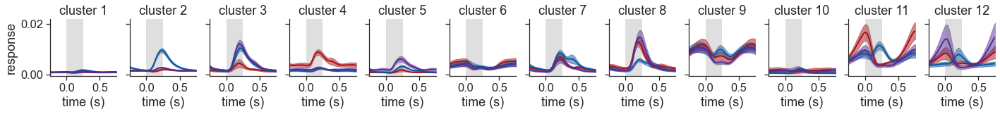

In [166]:
# tmp = image_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
tmp = image_mdf.copy()
tmp = tmp[(tmp.mean_baseline<np.percentile(tmp.mean_baseline.values, 99.9)) &  (tmp.mean_response<np.percentile(tmp.mean_response.values, 99.8))]

xlim_seconds = [-0.25, 0.75]
timestamps = tmp.trace_timestamps.values[0]

axes_column = 'cluster_id'
hue_column = 'experience_level'

plotting.plot_population_averages_for_clusters(tmp, event_type, axes_column, hue_column, 
                                            xlim_seconds=xlim_seconds, interval_sec=0.5, 
                                            sharey=True, sharex=False, 
                                            ylabel='response', xlabel='time (s)', suptitle=None,
                                            save_dir=save_dir, folder=folder, suffix='_sharey', ax=None);

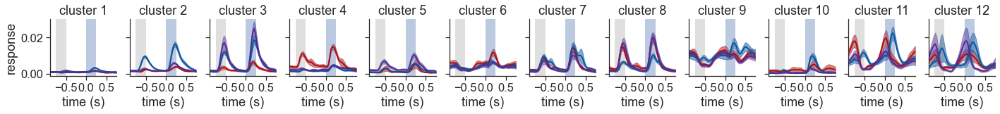

In [165]:
# tmp = change_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
tmp = change_mdf.copy()
tmp = tmp[(tmp.mean_baseline<np.percentile(tmp.mean_baseline.values, 99.9)) &  (tmp.mean_response<np.percentile(tmp.mean_response.values, 99.8))]

xlim_seconds = [-0.9, 0.75]
timestamps = tmp.trace_timestamps.values[0]

axes_column = 'cluster_id'
hue_column = 'experience_level'

plotting.plot_population_averages_for_clusters(tmp, 'changes', axes_column, hue_column, 
                                            xlim_seconds=xlim_seconds, interval_sec=0.5, 
                                            sharey=True, sharex=False, 
                                            ylabel='response', xlabel='time (s)', suptitle=None,
                                            save_dir=save_dir, folder=folder, suffix='_sharey', ax=None);

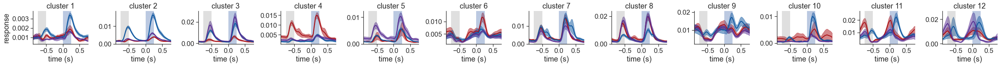

In [95]:
# # tmp = change_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
# tmp = change_mdf.copy()
# tmp = tmp[(tmp.mean_baseline<np.percentile(tmp.mean_baseline.values, 99.9)) &  (tmp.mean_response<np.percentile(tmp.mean_response.values, 99.8))]

# xlim_seconds = [-0.9, 0.75]
# timestamps = tmp.trace_timestamps.values[0]

# axes_column = 'cluster_id'
# hue_column = 'experience_level'

# plotting.plot_population_averages_for_clusters(tmp, 'changes', axes_column, hue_column, 
#                                             xlim_seconds=xlim_seconds, interval_sec=0.5, 
#                                             sharey=False, sharex=False, 
#                                             ylabel='response', xlabel='time (s)', suptitle=None,
#                                             save_dir=save_dir, folder=folder, suffix='_sharey', ax=None);

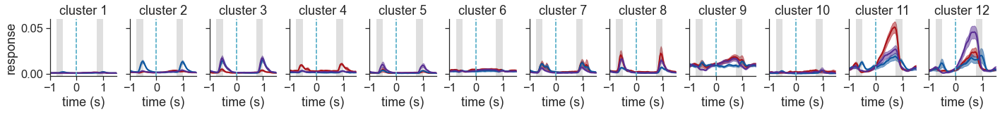

In [96]:
# tmp = omission_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
tmp = omission_mdf.copy()
tmp = tmp[(tmp.mean_baseline<np.percentile(tmp.mean_baseline.values, 99.9)) &  (tmp.mean_response<np.percentile(tmp.mean_response.values, 99.8))]

xlim_seconds = [-1, 1.5]
timestamps = tmp.trace_timestamps.values[0]

axes_column = 'cluster_id'
hue_column = 'experience_level'

plot_population_averages_for_clusters(tmp, 'omissions', axes_column, hue_column, 
                                            xlim_seconds=xlim_seconds, interval_sec=1, 
                                            sharey=True, sharex=False, 
                                            ylabel='response', xlabel='time (s)', suptitle=None,
                                            save_dir=save_dir, folder=folder, suffix='_sharey', ax=None);

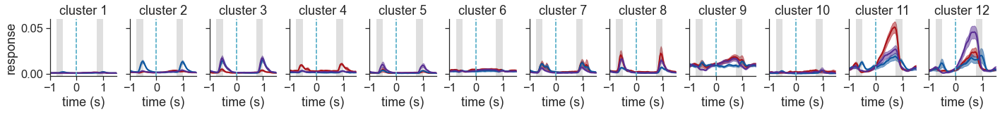

In [97]:
# tmp = omission_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
tmp = omission_mdf.copy()
tmp = tmp[(tmp.mean_baseline<np.percentile(tmp.mean_baseline.values, 99.9)) &  (tmp.mean_response<np.percentile(tmp.mean_response.values, 99.8))]

xlim_seconds = [-1, 1.5]
timestamps = tmp.trace_timestamps.values[0]

axes_column = 'cluster_id'
hue_column = 'experience_level'

plot_population_averages_for_clusters(tmp, 'omissions', axes_column, hue_column, 
                                            xlim_seconds=xlim_seconds, interval_sec=1, 
                                            sharey=True, sharex=False, 
                                            ylabel='response', xlabel='time (s)', suptitle=None,
                                            save_dir=save_dir, folder=folder, suffix='_sharey', ax=None);

#### each cre line seprately

In [98]:
# tmp = multi_session_df.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')

# tmp = tmp[tmp.is_change==False]

# for cre_line in tmp.cre_line.unique():
#     df = tmp[tmp.cre_line==cre_line]

#     axes_column = 'cluster_id'
#     hue_column = 'experience_level'
#     palette = utils.get_experience_level_colors()
#     # xlim_seconds=[-1., 1.5]
#     xlim_seconds=[-0.25, 0.75]

#     suffix = '_cluster_image_response'

#     ax = ppf.plot_population_averages_for_conditions(df, data_type, 'all',
#                                                             axes_column, hue_column, horizontal=True,
#                                                             xlim_seconds=xlim_seconds, interval_sec=0.5,
#                                                             palette=palette, ax=None, title=None, suptitle=cre_line,
#                                                             save_dir=None, folder=folder, suffix=suffix)


In [99]:
def plot_population_averages_for_conditions_multi_row(multi_session_df, data_type, event_type, axes_column, hue_column, row_column,
                                            timestamps=None,  xlim_seconds=None, interval_sec=1, sharey=False, sharex=False, palette=None,
                                            ylabel='response', xlabel='time (s)', title=None, suptitle=None,
                                            save_dir=None, folder=None, suffix='', ax=None):
    
    sns.set_context('notebook', font_scale=1.25, rc={'lines.markeredgewidth': 1})
    if palette is None:
        palette = utils.get_experience_level_colors()

    sdf = multi_session_df.copy()
    if 'trace_timestamps' in sdf.keys():
        timestamps = sdf.trace_timestamps.values[0]
    elif timestamps is not None:
        timestamps = timestamps
    else:
        print('provide timestamps or provide a multi_session_df with a trace_timestamps column')

    if xlim_seconds is None:
        xlim_seconds = [timestamps[0], timestamps[-1]]
    if event_type == 'omissions':
        omitted = True
        change = False
        xlabel = 'time after omission (s)'
    elif event_type == 'changes':
        omitted = False
        change = True
        xlabel = 'time after change (s)'
    else:
        omitted = False
        change = False
        xlabel = 'time (s)'

    row_conditions = np.sort(sdf[row_column].unique())
    axes_conditions = np.sort(sdf[axes_column].unique())
    hue_conditions = np.sort(sdf[hue_column].unique())
    # if there is only one axis condition, set n conditions for plotting to 2 so it can still iterate
    if len(axes_conditions) == 1:
        n_axes_conditions = 2
    else:
        n_axes_conditions = len(axes_conditions)
    n_row_conditions = len(row_conditions)


    if sharey == True: 
        wspace = 0.2
        fig_width = 2
    else:
        wspace = 0.6
        fig_width = 3

    figsize = (fig_width * n_axes_conditions, 3 * n_row_conditions)
    fig, ax = plt.subplots(n_row_conditions, n_axes_conditions, figsize=figsize, sharey=sharey, sharex=sharex)
    ax = ax.ravel()
    i = 0
    for r, row in enumerate(row_conditions):
        for a, axis in enumerate(axes_conditions):
            try:
                for c, hue in enumerate(hue_conditions):
                    cdf = sdf[(sdf[axes_column] == axis) & (sdf[hue_column] == hue) & (sdf[row_column]==row)]
                    traces = cdf.mean_trace.values
                    ax[i] = utils.plot_mean_trace(np.asarray(traces), timestamps, ylabel=ylabel,
                                                legend_label=hue, color=palette[c], interval_sec=interval_sec,
                                                xlim_seconds=xlim_seconds, ax=ax[i])
                ax[i] = utils.plot_flashes_on_trace(ax[i], timestamps, change=change, omitted=omitted, alpha=0.25)
                if omitted:
                    omission_color = sns.color_palette()[9]
                    ax[i].axvline(x=0, ymin=0, ymax=1, linestyle='--', color=omission_color)
                if title == 'metadata':
                    metadata_string = utils.get_container_metadata_string(utils.get_metadata_for_row_of_multi_session_df(cdf))
                    ax[i].set_title(metadata_string)
                else:
                    if axes_column == 'experience_level':
                        title_colors = utilities.get_experience_level_colors()
                        ax[i].set_title(axis, color=title_colors[i], fontsize=20)
                    else:
                        ax[i].set_title(axis)
                if title:  # overwrite title if one is provided
                    ax[i].set_title(title)
                ax[i].set_xlim(xlim_seconds)
                ax[i].set_xlabel(xlabel)
                if sharey:
                    ax[i].set_ylabel('')
                else: 
                    ax[i].set_ylabel(ylabel)
                if sharex:
                    ax[i].set_xlabel('')
                else: 
                    ax[i].set_xlabel(xlabel)


                # ### specific to cluster plots, comment for all else
                # n_cre = len(sdf[(sdf[axes_column] == axis)].cell_specimen_id.unique())
                # n_cluster = len(cdf.cell_specimen_id.unique())
                # fraction = str(int(n_cluster/float(n_cre)* 100))
                # if axes_column == 'cluster_id':
                #     ax[i].set_title('cluster '+str(row+1)+' ('+fraction+'%)')
                # if row_column == 'cluster_id':
                #     ax[i].set_title('cluster '+str(row+1)+' ('+fraction+'%)')
                
                if axes_column == 'cluster_id':
                    ax[i].set_title('cluster '+str(row+1))
                if row_column == 'cluster_id':
                    ax[i].set_title('cluster '+str(row+1))
            except:
                print('no data for', axis, hue)
            i+=1
                
        if axes_column == 'cre_line':
            # ax[0].set_title('Excitatory\ncluster 1'+' ('+fraction+'%)')
            # ax[1].set_title('Sst\ncluster 1'+' ('+fraction+'%)')
            # ax[2].set_title('Vip\ncluster 1'+' ('+fraction+'%)')

            ax[0].set_title('Excitatory\ncluster 1')
            ax[1].set_title('Sst\ncluster 1')
            ax[2].set_title('Vip\ncluster 1')
                
        if sharey:
            for x in np.arange(0, i)[::n_axes_conditions]:
                ax[x].set_ylabel(ylabel)
        if sharex: 
             for x in np.arange(n_row_conditions, n_row_conditions+n_axes_conditions+1):
                ax[x].set_ylabel(xlabel)
        # ax[0].legend(loc='upper right', fontsize='x-small') # title='passive', title_fontsize='xx-small')

    if suptitle is not None:
        plt.suptitle(suptitle, x=0.52, y=1.04, fontsize=18)
    fig.subplots_adjust(wspace=wspace, hspace=0.75)
    if save_dir:
        fig_title = 'population_average_' + axes_column + '_' + row_column + '_' + hue_column + suffix
        utils.save_figure(fig, figsize, save_dir, folder, fig_title)

    return ax

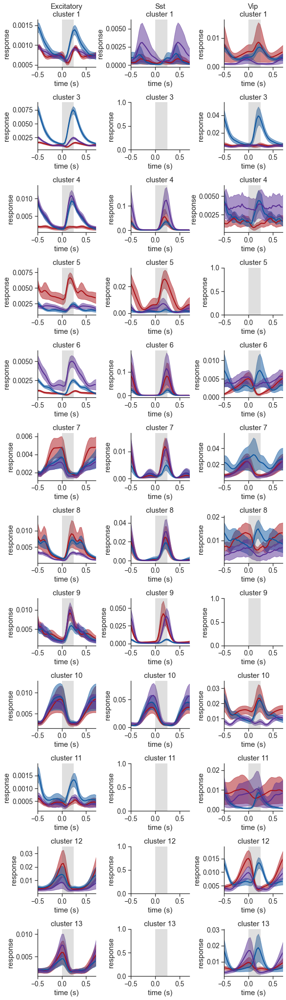

In [100]:
# tmp = image_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
tmp = image_mdf.copy()
tmp = tmp[(tmp.mean_baseline<np.percentile(tmp.mean_baseline.values, 99.9)) &  (tmp.mean_response<np.percentile(tmp.mean_response.values, 99.9))]

xlim_seconds = [-0.5, 0.7]
timestamps = tmp.trace_timestamps.values[0]

plotting.plot_population_averages_for_conditions_multi_row(tmp, data_type, 'all', axes_column='cre_line', hue_column='experience_level', row_column='cluster_id',
                                            timestamps=None, xlim_seconds=xlim_seconds, interval_sec=0.5, sharey=False, sharex=False, palette=None, 
                                            ylabel='response', xlabel='time (s)', title=None, suptitle=None,
                                            save_dir=save_dir, folder=folder, suffix='_images_clusters', ax=None);

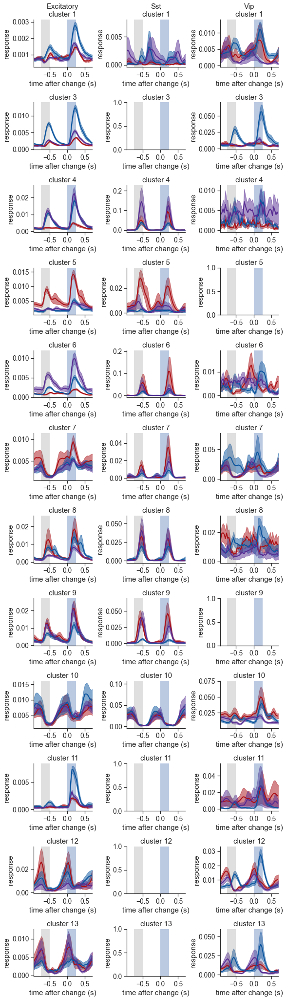

In [101]:
# tmp = change_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
tmp = change_mdf.copy()
tmp = tmp[(tmp.mean_baseline<np.percentile(tmp.mean_baseline.values, 99.9)) &  (tmp.mean_response<np.percentile(tmp.mean_response.values, 99.9))]

xlim_seconds = [-0.95, 0.7]
timestamps = tmp.trace_timestamps.values[0]

plotting.plot_population_averages_for_conditions_multi_row(tmp, data_type, 'changes', axes_column='cre_line', hue_column='experience_level', row_column='cluster_id',
                                            timestamps=None, xlim_seconds=xlim_seconds, interval_sec=0.5, sharey=False, sharex=False, palette=None, 
                                            ylabel='response', xlabel='time (s)', title=None, suptitle=None,
                                            save_dir=save_dir, folder=folder, suffix='_changes_clusters_per_cre', ax=None);

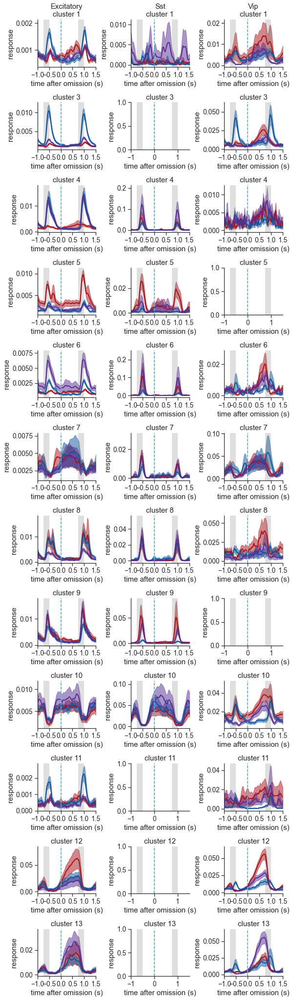

In [102]:
# tmp = omission_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
tmp = omission_mdf.copy()
tmp = tmp[(tmp.mean_baseline<np.percentile(tmp.mean_baseline.values, 99.9)) &  (tmp.mean_response<np.percentile(tmp.mean_response.values, 99.9))]

xlim_seconds = [-1, 1.5]
timestamps = tmp.trace_timestamps.values[0]

plotting.plot_population_averages_for_conditions_multi_row(tmp, data_type, 'omissions', axes_column='cre_line', hue_column='experience_level', row_column='cluster_id',
                                            timestamps=None, xlim_seconds=xlim_seconds, interval_sec=0.5, sharey=False, sharex=False, palette=None, 
                                            ylabel='response', xlabel='time (s)', title=None, suptitle=None,
                                            save_dir=save_dir, folder=folder, suffix='_omissions_clusters_per_cre', ax=None);

In [103]:
# tmp = image_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
# tmp = tmp[(tmp.mean_baseline<np.percentile(tmp.mean_baseline.values, 99.9)) &  (tmp.mean_response<np.percentile(tmp.mean_response.values, 99.9))]

# xlim_seconds = [-0.5, 0.7]
# timestamps = tmp.trace_timestamps.values[0]

# plot_population_averages_for_conditions_multi_row(tmp, data_type, 'all', axes_column='cluster_id', hue_column='experience_level', 
#                                                   row_column='cre_line',
#                                             timestamps=None, xlim_seconds=xlim_seconds, 
#                                             interval_sec=0.5, sharey=False, sharex=False, palette=None, 
#                                             ylabel='response', xlabel='time (s)', title=None, suptitle=None,
#                                             save_dir=save_dir, folder=folder, suffix='_images_clusters_per_cre', ax=None);

no data for 1 Novel >1
no data for 2 Novel >1
no data for 3 Novel >1
no data for 4 Novel >1
no data for 5 Novel >1
no data for 6 Novel >1
no data for 7 Novel >1
no data for 8 Novel >1
no data for 9 Novel >1
no data for 10 Novel >1
no data for 11 Novel >1
no data for 12 Novel >1
no data for 1 Novel >1
no data for 2 Novel >1
no data for 3 Novel >1
no data for 4 Novel >1
no data for 5 Novel >1
no data for 6 Novel >1
no data for 7 Novel >1
no data for 8 Novel >1
no data for 9 Novel >1
no data for 10 Novel >1
no data for 11 Novel >1
no data for 12 Novel >1
no data for 1 Novel >1
no data for 2 Novel >1
no data for 3 Novel >1
no data for 4 Novel >1
no data for 5 Novel >1
no data for 6 Novel >1
no data for 7 Novel >1
no data for 8 Novel >1
no data for 9 Novel >1
no data for 10 Novel >1
no data for 11 Novel >1
no data for 12 Novel >1


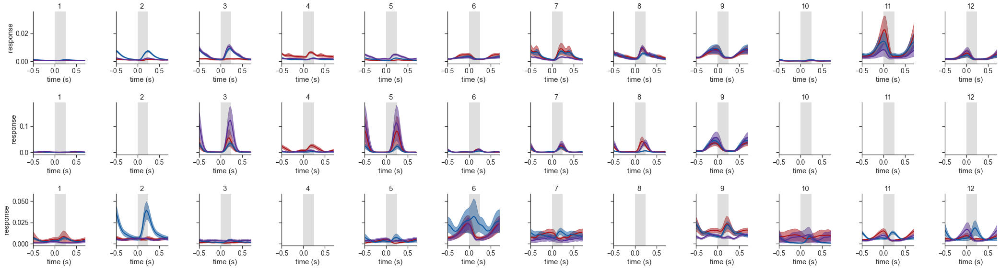

In [104]:
# tmp = image_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
tmp = image_mdf.copy()
tmp = tmp[(tmp.mean_baseline<np.percentile(tmp.mean_baseline.values, 99.9)) &  (tmp.mean_response<np.percentile(tmp.mean_response.values, 99.9))]

xlim_seconds = [-0.5, 0.7]
timestamps = tmp.trace_timestamps.values[0]

plotting.plot_population_averages_for_conditions_multi_row(tmp, data_type, 'all', axes_column='cluster_id', hue_column='experience_level', row_column='cre_line',
                                            timestamps=timestamps, palette=None, title=None, suptitle=None,
                                            xlim_seconds=xlim_seconds, interval_sec=0.5, sharey='row', sharex=False,
                                            save_dir=save_dir, folder=folder, suffix='_images_clusters_', ax=None);

#### population averages in a 4x3 grid

In [105]:
def plot_population_averages_for_clusters_grid(multi_session_df, event_type, axes_column, hue_column, 
                                            xlim_seconds=None, interval_sec=1, 
                                            sharey=False, sharex=False, 
                                            ylabel='response', xlabel='time (s)', suptitle=None,
                                            save_dir=None, folder=None, suffix='', ax=None):
    
    palette = utils.get_experience_level_colors()

    sdf = multi_session_df.copy()
    timestamps = sdf.trace_timestamps.values[0]

    if xlim_seconds is None:
        xlim_seconds = [timestamps[0], timestamps[-1]]
    if event_type == 'omissions':
        omitted = True
        change = False
    elif event_type == 'changes':
        omitted = False
        change = True
    else:
        omitted = False
        change = False

    axes_conditions = np.sort(sdf[axes_column].unique())
    hue_conditions = np.sort(sdf[hue_column].unique())
    n_axes_conditions = len(axes_conditions)

    figsize = (10,8)
    fig, ax = plt.subplots(3, 4, figsize=figsize, sharey=sharey, sharex=sharex)
    ax = ax.ravel()
    i = 0
    for a, axis in enumerate(axes_conditions):
        try:
            for c, hue in enumerate(hue_conditions):
                cdf = sdf[(sdf[axes_column] == axis) & (sdf[hue_column] == hue)]
                traces = cdf.mean_trace.values
                ax[i] = utils.plot_mean_trace(np.asarray(traces), timestamps, ylabel=ylabel,
                                            legend_label=hue, color=palette[c], interval_sec=interval_sec,
                                            xlim_seconds=xlim_seconds, ax=ax[i])
            ax[i] = utils.plot_flashes_on_trace(ax[i], timestamps, change=change, omitted=omitted, alpha=0.25)
            if omitted:
                omission_color = sns.color_palette()[9]
                ax[i].axvline(x=0, ymin=0, ymax=1, linestyle='--', color=omission_color)
            ax[i].set_xlim(xlim_seconds)
            ax[i].set_xlabel('')
            ax[i].set_ylabel('')
            ax[i].set_title('cluster '+str(axis))
        except:
            print('no data for', axis, hue)
        i+=1
    for x in range(0,12,4):
        ax[x].set_ylabel('response') 
    for x in range(8,12):
        ax[x].set_xlabel('time (sec)')  
    if suptitle is not None:
        plt.suptitle(suptitle, x=0.52, y=1.04)
    fig.subplots_adjust(wspace=0.2, hspace=0.4)
    if save_dir:
        fig_title = 'population_average_grid_' + axes_column + '_' + hue_column + suffix
        utils.save_figure(fig, figsize, save_dir, folder, fig_title)

    return ax

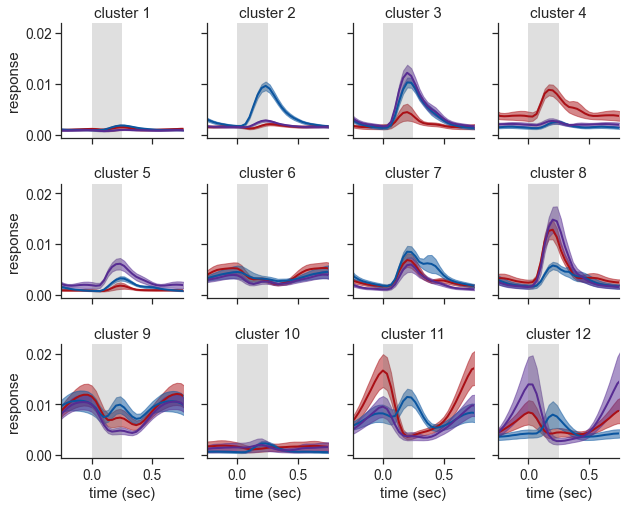

In [106]:
# tmp = image_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')
tmp = image_mdf.copy()
tmp = tmp[(tmp.mean_baseline<np.percentile(tmp.mean_baseline.values, 99.9)) &  (tmp.mean_response<np.percentile(tmp.mean_response.values, 99.8))]

xlim_seconds = [-0.25, 0.75]
timestamps = tmp.trace_timestamps.values[0]

axes_column = 'cluster_id'
hue_column = 'experience_level'

plotting.plot_population_averages_for_clusters_grid(tmp, event_type, axes_column, hue_column, 
                                            xlim_seconds=xlim_seconds, interval_sec=0.5, 
                                            sharey=True, sharex=True, 
                                            ylabel='response', xlabel='time (s)', suptitle=None,
                                            save_dir=save_dir, folder=folder, suffix='_sharey', ax=None);

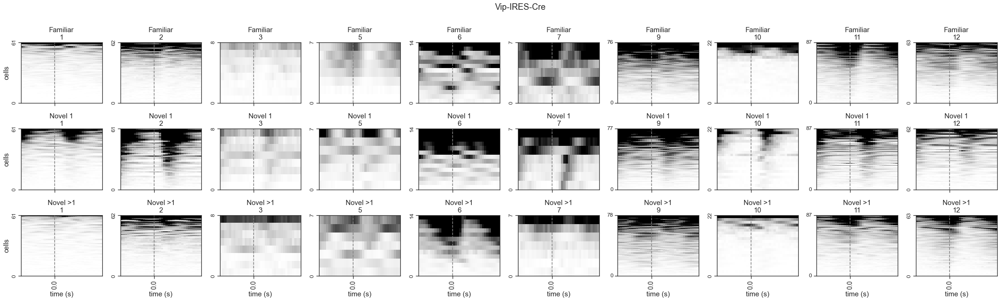

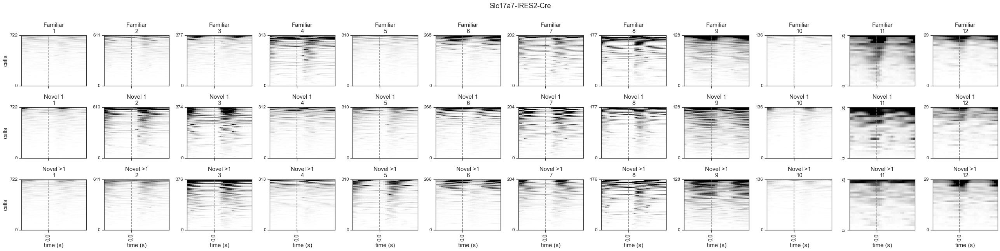

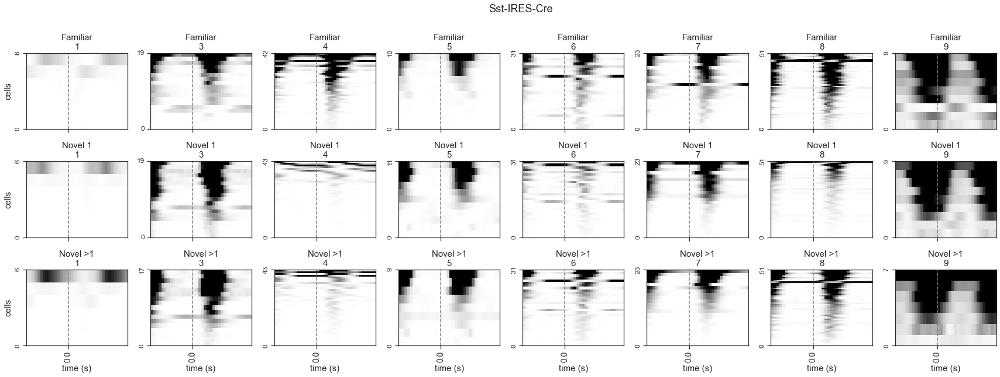

In [107]:
tmp = image_mdf.copy()
df = tmp[tmp.is_change==False]

xlim_seconds = [-0.5, 0.7]

event_type = 'all'

timestamps = tmp.trace_timestamps.values[0]
row_condition = 'experience_level'
col_condition = 'cluster_id'
cols_to_sort_by = ['mean_response']

for cre_line in tmp.cre_line.unique():
    df = tmp[tmp.cre_line==cre_line]


    ppf.plot_response_heatmaps_for_conditions(df, timestamps, data_type, event_type,
                                          row_condition, col_condition, cols_to_sort_by=cols_to_sort_by, suptitle=cre_line,
                                          microscope=None, vmax=None, xlim_seconds=xlim_seconds, match_cells=False, cbar=False,
                                          save_dir=None, folder=folder, suffix='', ax=None)


# ppf.plot_response_heatmaps_for_conditions(df, timestamps, data_type, event_type,
#                                           row_condition, col_condition, cols_to_sort_by=cols_to_sort_by, suptitle='',
#                                           microscope=None, vmax=None, xlim_seconds=[-2, 2], match_cells=False, cbar=True,
#                                           save_dir=save_dir, folder=folder, suffix='_cbar', ax=None)

#### heatmaps

In [ ]:
#### heatmap of image responses

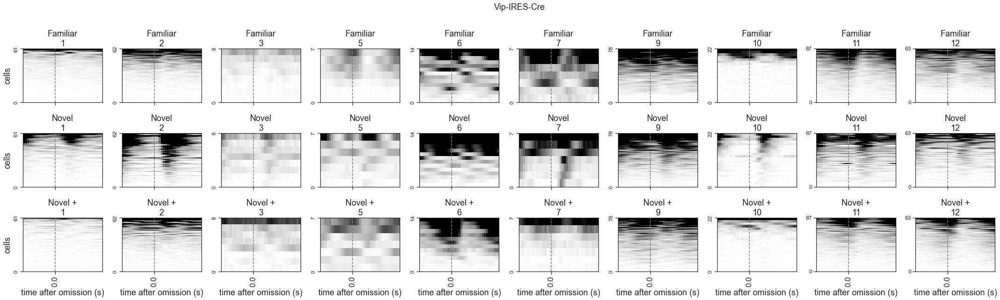

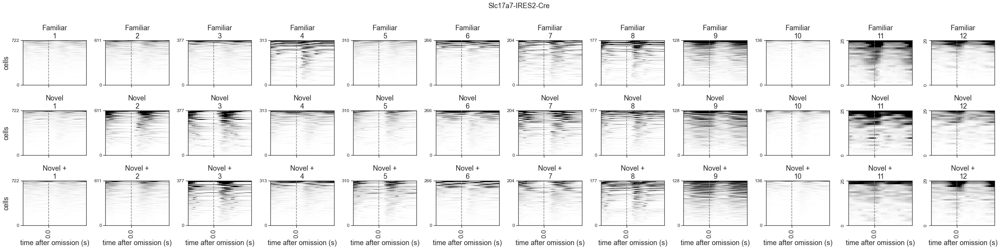

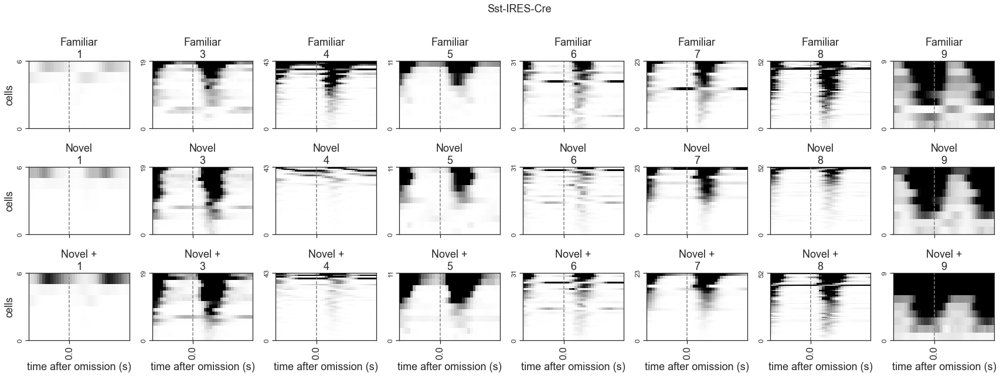

In [325]:
tmp = image_mdf.copy() #merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')

xlim_seconds=[-0.5, 0.75]

event_type = 'all'

timestamps = tmp.trace_timestamps.values[0]
row_condition = 'experience_level'
col_condition = 'cluster_id'
cols_to_sort_by = ['mean_response']

for cre_line in tmp.cre_line.unique():
    df = tmp[tmp.cre_line==cre_line]


    ppf.plot_response_heatmaps_for_conditions(df, timestamps, data_type, 'all',
                                          row_condition, col_condition, cols_to_sort_by=cols_to_sort_by, suptitle=cre_line,
                                          microscope=None, vmax=None, xlim_seconds=xlim_seconds, match_cells=False, cbar=False,
                                          save_dir=None, folder=folder, suffix='', ax=None)


# ppf.plot_response_heatmaps_for_conditions(df, timestamps, data_type, event_type,
#                                           row_condition, col_condition, cols_to_sort_by=cols_to_sort_by, suptitle='',
#                                           microscope=None, vmax=None, xlim_seconds=[-2, 2], match_cells=False, cbar=True,
#                                           save_dir=save_dir, folder=folder, suffix='_cbar', ax=None)

#### heatmap of omission responses

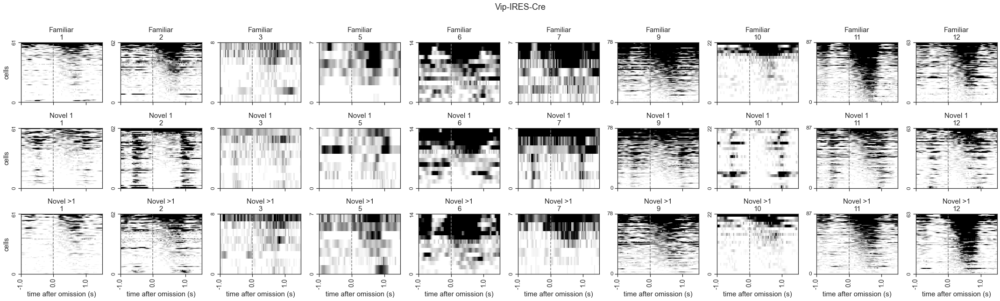

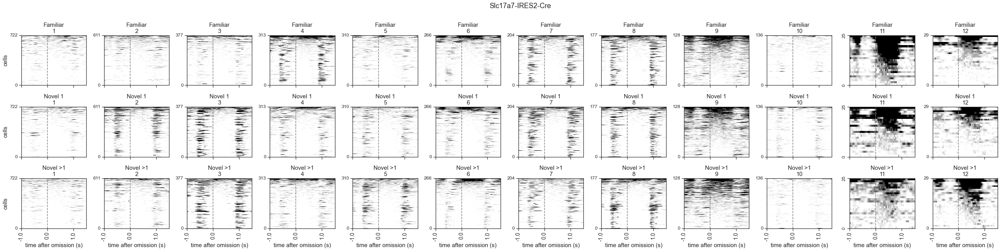

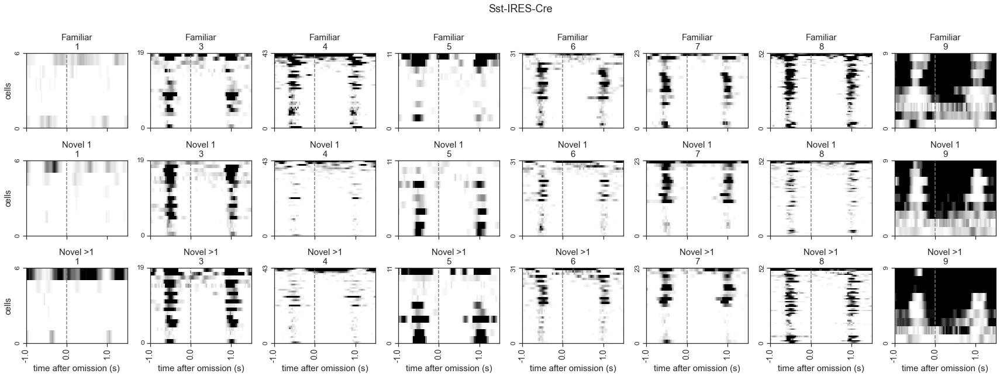

In [108]:
tmp = omission_mdf.copy() #merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')

xlim_seconds=[-1, 1.5]

event_type = 'all'

timestamps = tmp.trace_timestamps.values[0]
row_condition = 'experience_level'
col_condition = 'cluster_id'
cols_to_sort_by = ['mean_response']

for cre_line in tmp.cre_line.unique():
    df = tmp[tmp.cre_line==cre_line]


    ppf.plot_response_heatmaps_for_conditions(df, timestamps, data_type, 'omissions',
                                          row_condition, col_condition, cols_to_sort_by=cols_to_sort_by, suptitle=cre_line,
                                          microscope=None, vmax=None, xlim_seconds=xlim_seconds, match_cells=False, cbar=False,
                                          save_dir=None, folder=folder, suffix='', ax=None)


# ppf.plot_response_heatmaps_for_conditions(df, timestamps, data_type, event_type,
#                                           row_condition, col_condition, cols_to_sort_by=cols_to_sort_by, suptitle='',
#                                           microscope=None, vmax=None, xlim_seconds=[-2, 2], match_cells=False, cbar=True,
#                                           save_dir=save_dir, folder=folder, suffix='_cbar', ax=None)

### compare various functions for area depth proportions

In [109]:
import visual_behavior_glm.GLM_clustering as glm_clust

In [110]:
locations = np.sort(cluster_meta.layer.unique())
df = cluster_meta.copy().reset_index()
df['location'] = df.layer

stats_table = glm_clust.stats(df, cre_lines[0], locations, test='chi_squared_')
stats_table.head()

location,lower,upper,lower_chance_count,upper_chance_count,chi_squared_pvalue,significant,imq,bh_significant
cluster_id,,,,,,,,
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,243.0,479.0,407.848999,314.151001,3.580637e-35,True,0.004167,True
2,309.0,302.0,345.146452,265.853548,3.181840e-03,True,0.029167,True
3,206.0,171.0,212.962705,164.037295,4.694883e-01,False,0.041667,False
4,223.0,90.0,176.809885,136.190115,1.392968e-07,True,0.012500,True


In [111]:
# this gets the number of cells in different locations compared to the total
n_cells = processing.get_n_cells_per_location_for_clusters(cluster_meta, location='layer')
n_cells.head()

n_cells_lower  n_cells_upper  n_cells_cluster  \
cre_line          cluster_id                                                  
Slc17a7-IRES2-Cre 1                   243.0          479.0              722   
                  2                   309.0          302.0              611   
                  3                   206.0          171.0              377   
                  4                   223.0           90.0              313   
                  5                   178.0          132.0              310   

                              n_cells_total_lower  n_cells_total_upper  
cre_line          cluster_id                                            
Slc17a7-IRES2-Cre 1                          1863                 1435  
                  2                          1863                 1435  
                  3                          1863                 1435  
                  4                          1863                 1435  
                  5                          1863                 1435

In [112]:
# this gets the fraction of cells in different locations relative to the total
fraction_cells = processing.get_fraction_cells_relative_to_cluster_size(cluster_meta, location='layer')
fraction_cells.head()

fraction_cells_lower  fraction_cells_upper  \
cre_line          cluster_id                                               
Slc17a7-IRES2-Cre 1                       0.130435              0.333798   
                  2                       0.165862              0.210453   
                  3                       0.110574              0.119164   
                  4                       0.119699              0.062718   
                  5                       0.095545              0.091986   

                              fraction_cells_cluster  average_of_locations  \
cre_line          cluster_id                                                 
Slc17a7-IRES2-Cre 1                         0.218921              0.232116   
                  2                         0.185264              0.188157   
                  3                         0.114312              0.114869   
                  4                         0.094906              0.091209   
                  5                         0.093996              0.093765   

                              fraction_of_cluster_size_lower  \
cre_line          cluster_id                                   
Slc17a7-IRES2-Cre 1                                 0.595809   
                  2                                 0.895272   
                  3                                 0.967306   
                  4                                 1.261242   
                  5                                 1.016474   

                              fraction_of_cluster_size_upper  
cre_line          cluster_id                                  
Slc17a7-IRES2-Cre 1                                 1.524744  
                  2                                 1.135964  
                  3                                 1.042446  
                  4                                 0.660841  
                  5                                 0.978613

In [113]:
# this gets all the stats, including n cells, fraction cells, and significance across location comparisons
n_cells_table = processing.get_cluster_proportion_stats_for_locations(cluster_meta, location='layer')

n_cells_table.head()

n_cells_location  n_cells_location_total  \
cre_line          cluster_id layer                                             
Slc17a7-IRES2-Cre 1          lower               243                    1863   
                             upper               479                    1435   
                  2          lower               309                    1863   
                             upper               302                    1435   
                  3          lower               206                    1863   

                                    fraction_cells_location  n_cells_cluster  \
cre_line          cluster_id layer                                             
Slc17a7-IRES2-Cre 1          lower                 0.130435              722   
                             upper                 0.333798              722   
                  2          lower                 0.165862              611   
                             upper                 0.210453              611   
                  3          lower                 0.110574              377   

                                    n_cells_cre  fraction_cells_cluster  \
cre_line          cluster_id layer                                        
Slc17a7-IRES2-Cre 1          lower         3298                0.218921   
                             upper         3298                0.218921   
                  2          lower         3298                0.185264   
                             upper         3298                0.185264   
                  3          lower         3298                0.114312   

                                    fraction_of_cluster_size  \
cre_line          cluster_id layer                             
Slc17a7-IRES2-Cre 1          lower                  0.595809   
                             upper                  1.524744   
                  2          lower                  0.895272   
                             upper                  1.135964   
                  3          lower                  0.967306   

                                    n_cells_chance_location        pvalue  \
cre_line          cluster_id layer                                          
Slc17a7-IRES2-Cre 1          lower               407.848999  3.580637e-35   
                             upper               314.151001  3.580637e-35   
                  2          lower               345.146452  3.181840e-03   
                             upper               265.853548  3.181840e-03   
                  3          lower               212.962705  4.694883e-01   

                                   significant       imq bh_significant  
cre_line          cluster_id layer                                       
Slc17a7-IRES2-Cre 1          lower        True  0.000000           True  
                             upper        True  0.000000           True  
                  2          lower        True  0.008333           True  
                             upper        True  0.008333           True  
                  3          lower       False  0.016667          False

In [114]:
# compare with Alex's code numbers

locations = np.sort(cluster_meta.layer.unique())
df = cluster_meta.copy().reset_index()
df['location'] = df.layer

stats_table = glm_clust.stats(df, cre_lines[0], locations, test='chi_squared_')
stats_table.head()

location,lower,upper,lower_chance_count,upper_chance_count,chi_squared_pvalue,significant,imq,bh_significant
cluster_id,,,,,,,,
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,243.0,479.0,407.848999,314.151001,3.580637e-35,True,0.004167,True
2,309.0,302.0,345.146452,265.853548,3.181840e-03,True,0.029167,True
3,206.0,171.0,212.962705,164.037295,4.694883e-01,False,0.041667,False
4,223.0,90.0,176.809885,136.190115,1.392968e-07,True,0.012500,True


conclusion: `processing.get_cluster_proportion_stats_for_locations()` provides the same results as `glm_clust.stats()`, but in an easier to parse format with additional information that is helpful for plotting

### area / depth distributions across clusters

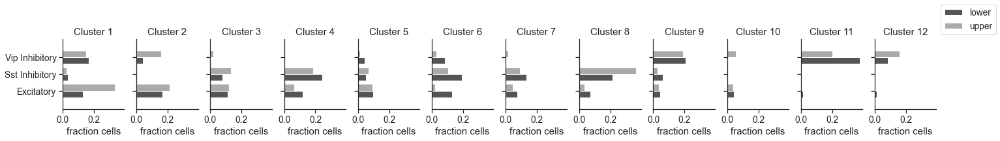

In [115]:
location = 'layer'
n_cells_table = processing.get_cluster_proportion_stats_for_locations(cluster_meta, location=location)
x = 'fraction_cells_location'

data = n_cells_table.copy().reset_index()

cre_lines = np.sort(cluster_meta.cre_line.unique())
cell_types = [utils.convert_cre_line_to_cell_type(cre_line) for cre_line in cre_lines]
cluster_ids = np.sort(cluster_meta.cluster_id.unique())

axes_conditions = np.sort(cluster_meta['cluster_id'].unique())
hue_conditions = np.sort(cluster_meta[location].unique())
n_axes_conditions = len(axes_conditions)

sharey = True 

if sharey == True: 
    wspace = 0.2
    fig_width = 2
else:
    wspace = 0.5
    fig_width = 3.5
    
figsize = (fig_width * n_axes_conditions, 2)
fig, ax = plt.subplots(1, n_axes_conditions, figsize=figsize, sharey=sharey, sharex=True)
ax = ax.ravel()
for i, cluster_id in enumerate(cluster_ids):
    cluster_data = data[data.cluster_id==cluster_id]
    # order = cre_data.sort_values(by='fraction_per_cluster')['cluster_id'][::-1]
    ax[i] = sns.barplot(data=cluster_data, x='fraction_cells_location', y='cre_line', order=cre_lines,
                            hue=location, orient='h', palette='gray', width=0.8, ax=ax[i])
    ax[i].set_ylabel('')
    ax[i].set_xlabel('fraction cells')
    ax[i].set_title('Cluster '+str(cluster_id))
    ax[i].get_legend().remove()
    ax[i].set_ylim(-1.1, len(cre_lines)+0.1)
ax[0].set_yticklabels(cell_types)
ax[i].legend( bbox_to_anchor=(1,1))
# ax[1].set_ylabel('fraction cells in each cluster')
# ax[i].set_xlabel('cluster ID')
sns.despine(fig=fig, top=True, right=True, left=False, bottom=False, offset=None, trim=False)

suptitle = ''
if suptitle is not None:
    plt.suptitle(suptitle, x=0.52, y=1.04, fontsize=18)
fig.subplots_adjust(wspace=wspace, hspace=0.75)
if save_dir:
    fig_title = 'fraction_cells_' + location + '_' + x + '_horiz'
    utils.save_figure(fig, figsize, save_dir, folder, fig_title)

#### by layer

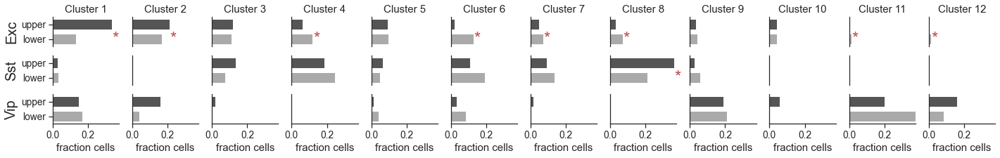

In [116]:
location = 'layer'
order = ['upper', 'lower']
n_cells_table = processing.get_cluster_proportion_stats_for_locations(cluster_meta, location=location)

metric = 'fraction_cells_location'
xlabel = 'fraction cells'
significance_col = 'bh_significant'

plotting.plot_location_distribution_across_clusters_for_cre_lines(n_cells_table, location=location, order=order,
                                                             metric=metric, xlabel=xlabel,
                                                             significance_col=significance_col,
                                                             ax=None, save_dir=save_dir, folder=folder);

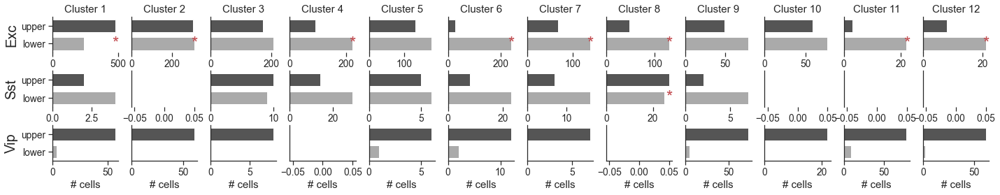

In [117]:
location = 'layer'
order = ['upper', 'lower']
n_cells_table = processing.get_cluster_proportion_stats_for_locations(cluster_meta, location=location)

metric = 'n_cells_location'
xlabel = '# cells'
significance_col = 'bh_significant'

plotting.plot_location_distribution_across_clusters_for_cre_lines(n_cells_table, location=location, order=order,
                                                             metric=metric, xlabel=xlabel,
                                                             significance_col=significance_col, sharex=False,
                                                             ax=None, save_dir=save_dir, folder=folder);

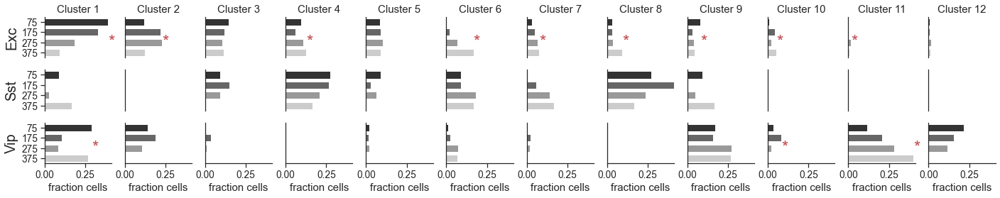

In [118]:
location = 'binned_depth'
# order = ['upper', 'lower']
n_cells_table_depth = processing.get_cluster_proportion_stats_for_locations(cluster_meta, location=location)

metric = 'fraction_cells_location'
xlabel = 'fraction cells'
significance_col = 'bh_significant'

plotting.plot_location_distribution_across_clusters_for_cre_lines(n_cells_table_depth, location=location, order=None,
                                                             metric=metric, xlabel=xlabel,
                                                             significance_col=significance_col,
                                                             ax=None, save_dir=save_dir, folder=folder);

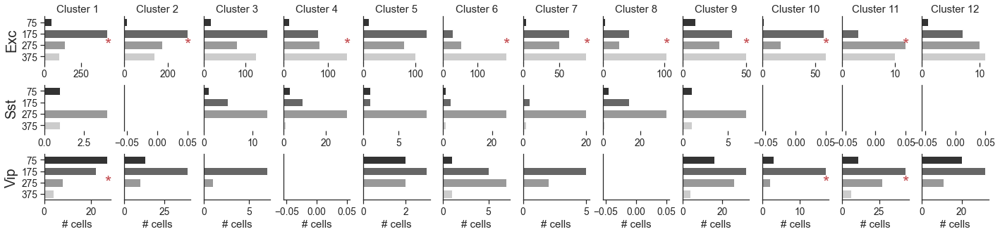

In [119]:
location = 'binned_depth'
# order = ['upper', 'lower']
n_cells_table_depth = processing.get_cluster_proportion_stats_for_locations(cluster_meta, location=location)

metric = 'n_cells_location'
xlabel = '# cells'
significance_col = 'bh_significant'

plotting.plot_location_distribution_across_clusters_for_cre_lines(n_cells_table_depth, location=location, order=None,
                                                             metric=metric, xlabel=xlabel,
                                                             significance_col=significance_col,
                                                             sharex=False, 
                                                             ax=None, save_dir=save_dir, folder=folder);

#### by area

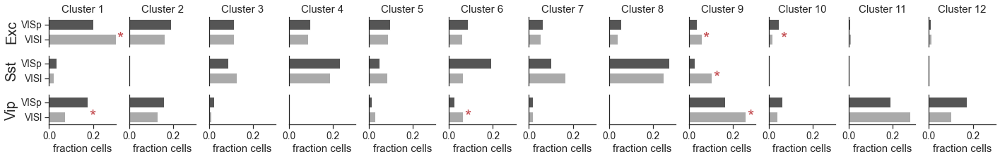

In [120]:
location = 'targeted_structure'
order = ['VISp', 'VISl']
n_cells_table_depth = processing.get_cluster_proportion_stats_for_locations(cluster_meta, location=location)

metric = 'fraction_cells_location'
xlabel = 'fraction cells'
significance_col = 'bh_significant'

plotting.plot_location_distribution_across_clusters_for_cre_lines(n_cells_table_depth, location=location, order=order,
                                                             metric=metric, xlabel=xlabel,
                                                             significance_col=significance_col,
                                                             sharex=True, 
                                                             ax=None, save_dir=save_dir, folder=folder);

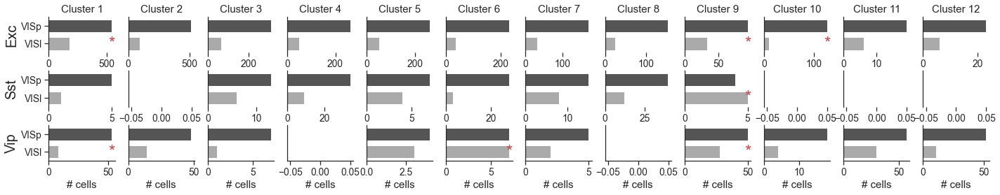

In [121]:
location = 'targeted_structure'
order = ['VISp', 'VISl']
n_cells_table_depth = processing.get_cluster_proportion_stats_for_locations(cluster_meta, location=location)

metric = 'n_cells_location'
xlabel = '# cells'
significance_col = 'bh_significant'

plotting.plot_location_distribution_across_clusters_for_cre_lines(n_cells_table_depth, location=location, order=order,
                                                             metric=metric, xlabel=xlabel,
                                                             significance_col=significance_col,
                                                             sharex=False, 
                                                             ax=None, save_dir=save_dir, folder=folder);

In [122]:
stats_table = glm_clust.stats(df, cre_lines[0], locations, test='chi_squared_')
stats_table.head()

location,lower,upper,lower_chance_count,upper_chance_count,chi_squared_pvalue,significant,imq,bh_significant
cluster_id,,,,,,,,
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,243.0,479.0,407.848999,314.151001,3.580637e-35,True,0.004167,True
2,309.0,302.0,345.146452,265.853548,3.181840e-03,True,0.029167,True
3,206.0,171.0,212.962705,164.037295,4.694883e-01,False,0.041667,False
4,223.0,90.0,176.809885,136.190115,1.392968e-07,True,0.012500,True


In [123]:
# cluster proportions for all cre lines
# this code uses glm_clust.final() to count how many cells per location per cluster per cre, 
# divide it by the total number of cells in each location in each cre
# then subtracts the average proportion across locations for each cluster
# does this make sense??
proportions, stats_final = processing.get_proportion_cells_rel_cluster_average(cluster_meta, cre_lines,
                                                                         columns_to_groupby=['layer'])
proportions.head()

,location,cluster_id,proportion_cells,cre_line
0,lower,1,-0.101682,Slc17a7-IRES2-Cre
1,lower,2,-0.022296,Slc17a7-IRES2-Cre
2,lower,3,-0.004295,Slc17a7-IRES2-Cre
3,lower,4,0.028491,Slc17a7-IRES2-Cre
4,lower,5,0.001779,Slc17a7-IRES2-Cre


In [124]:
stats = processing.compute_cluster_proportion_stats(cluster_meta.reset_index(), cre_lines[0], location='layer')
stats

layer,lower,upper,lower_chance_count,upper_chance_count,pvalue,significant,imq,bh_significant
cluster_id,,,,,,,,
1,243,479,432.432753,333.086957,8.242002e-34,True,0.000000,True
2,309,302,350.536934,270.005636,3.159309e-03,True,0.025000,True
3,206,171,214.001045,164.837091,4.667918e-01,False,0.037500,False
4,223,90,169.921603,130.884326,6.038135e-08,True,0.008333,True
5,178,132,174.685017,134.553408,7.385966e-01,False,0.041667,False
6,238,28,137.175610,105.661299,2.253013e-30,True,0.004167,True
7,137,67,111.991638,86.263017,1.665367e-03,True,0.020833,True
8,130,47,95.509059,73.567096,2.656768e-06,True,0.012500,True
9,79,49,71.307317,54.925389,2.254835e-01,False,0.033333,False


In [125]:
# # computing stats on proportions directly rather than counts - probably wrong

# from scipy.stats import chisquare

# location = 'layer'
# locations = np.sort(cluster_meta[location].unique())
# fraction_per_location_cols = []
# for loc in locations: 
#     fraction_per_location_cols.append('fraction_cells_'+loc)

# # # compute estimated frequency of cells based on average fraction for each cluster
# # for loc in locations:
# #     fraction_cells[loc + '_chance_count'] = fraction_cells['fraction_cells_'+loc].sum() * fraction_cells['mean']
    
# # perform chi-squared test
# for index in fraction_cells.index.values:
#     f = fraction_cells.loc[index][fraction_per_location_cols].values
#     # chance is just the overall size of the cluster
#     f_expected = np.repeat(fraction_cells.loc[index]['fraction_cells_per_cluster'], len(locations))
#     out = chisquare(f, f_expected)
#     fraction_cells.at[index, 'pvalue'] = out.pvalue
#     fraction_cells.at[index, 'significant'] = out.pvalue < 0.05

# # Use Benjamini Hochberg Correction for multiple comparisons
# fraction_cells = processing.add_hochberg_correction(fraction_cells)

# fraction_cells.head()

In [126]:
# cluster proportions for all cre lines
proportions, stats = processing.get_proportion_cells_rel_cluster_average(cluster_meta, cre_lines,
                                                                         columns_to_groupby=['layer'])

In [127]:
proportions.head()

,location,cluster_id,proportion_cells,cre_line
0,lower,1,-0.101682,Slc17a7-IRES2-Cre
1,lower,2,-0.022296,Slc17a7-IRES2-Cre
2,lower,3,-0.004295,Slc17a7-IRES2-Cre
3,lower,4,0.028491,Slc17a7-IRES2-Cre
4,lower,5,0.001779,Slc17a7-IRES2-Cre


### cell size by cluster

In [128]:
cell_info = loading.get_cell_table_from_lims(ophys_experiment_ids=experiments_table.index.values, valid_rois_only=True, platform_paper_only=True)

In [129]:
experiments_table.keys()

Index(['equipment_name', 'full_genotype', 'mouse_id', 'reporter_line',
       'driver_line', 'sex', 'age_in_days', 'cre_line', 'indicator',
       'session_number', 'prior_exposures_to_session_type',
       'prior_exposures_to_image_set', 'prior_exposures_to_omissions',
       'ophys_session_id', 'behavior_session_id', 'ophys_container_id',
       'project_code', 'imaging_depth', 'targeted_structure',
       'date_of_acquisition', 'session_type', 'experience_level', 'passive',
       'image_set', 'file_id', 'cell_type', 'depth', 'binned_depth',
       'area_depth', 'area_binned_depth', 'layer', 'area_layer', 'date',
       'first_novel', 'n_relative_to_first_novel', 'last_familiar',
       'last_familiar_active', 'second_novel', 'second_novel_active',
       'experience_exposure'],
      dtype='object')

C:\Users\marinag\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:9: UserWarning: 
The palette list has fewer values (10) than needed (12) and will cycle, which may produce an uninterpretable plot.
  if __name__ == "__main__":


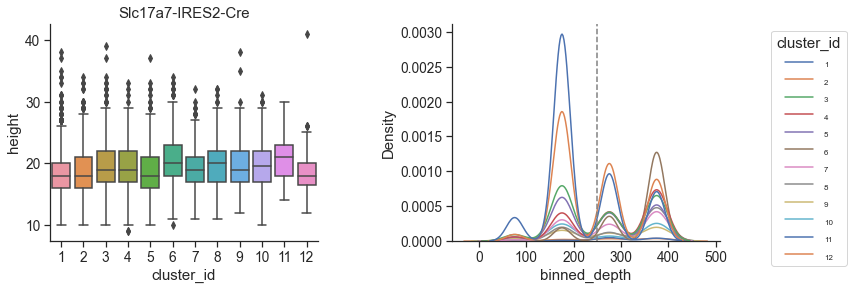

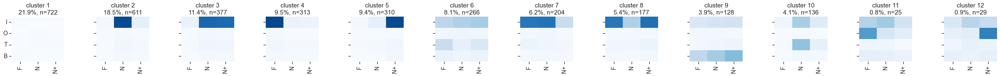

In [130]:
cre_line = cre_lines[0]
csids = cluster_meta[(cluster_meta.cre_line==cre_line)].index.unique()
cluster_data = cell_info[cell_info.cell_specimen_id.isin(csids)]
cluster_data = cluster_data.merge(cluster_meta['cluster_id'], on='cell_specimen_id')
cluster_data = cluster_data.merge(experiments_table['binned_depth'], on='ophys_experiment_id')

fig, ax = plt.subplots(1,2, figsize=(12,4))
ax[0] = sns.boxplot(data=cluster_data, x='cluster_id', y='height', ax=ax[0])
ax[1] = sns.kdeplot(data=cluster_data, x='binned_depth', hue='cluster_id', palette=sns.color_palette(), ax=ax[1])
ax[1].axvline(x=250, ymin=0, ymax=1, color='gray', linestyle='--')
sns.move_legend(ax[1], 'upper right', bbox_to_anchor=(1.5,1))
plt.setp(ax[1].get_legend().get_texts(), fontsize='8')  
ax[0].set_title(cre_line)

fig.subplots_adjust(wspace=0.5)
plotting.plot_clusters_row(cluster_meta, feature_matrix, cre_line)


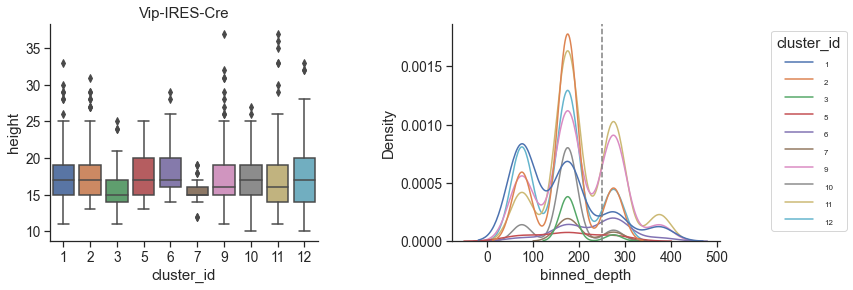

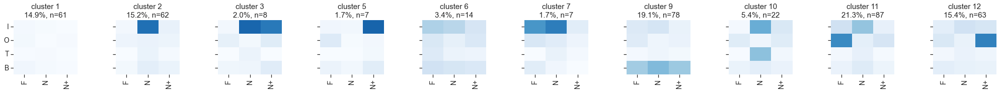

In [131]:
cre_line = cre_lines[2]
csids = cluster_meta[(cluster_meta.cre_line==cre_line)].index.unique()
cluster_data = cell_info[cell_info.cell_specimen_id.isin(csids)]
cluster_data = cluster_data.merge(cluster_meta['cluster_id'], on='cell_specimen_id')
cluster_data = cluster_data.merge(experiments_table['binned_depth'], on='ophys_experiment_id')

fig, ax = plt.subplots(1,2, figsize=(12,4))
ax[0] = sns.boxplot(data=cluster_data, x='cluster_id', y='height', ax=ax[0])
ax[1] = sns.kdeplot(data=cluster_data, x='binned_depth', hue='cluster_id', palette=sns.color_palette(), ax=ax[1])
ax[1].axvline(x=250, ymin=0, ymax=1, color='gray', linestyle='--')

sns.move_legend(ax[1], 'upper right', bbox_to_anchor=(1.5,1))
plt.setp(ax[1].get_legend().get_texts(), fontsize='8')  
ax[0].set_title(cre_line)

fig.subplots_adjust(wspace=0.5)
plotting.plot_clusters_row(cluster_meta, feature_matrix, cre_line)


C:\Users\marinag\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:9: UserWarning: The palette list has more values (10) than needed (8), which may not be intended.
  if __name__ == "__main__":


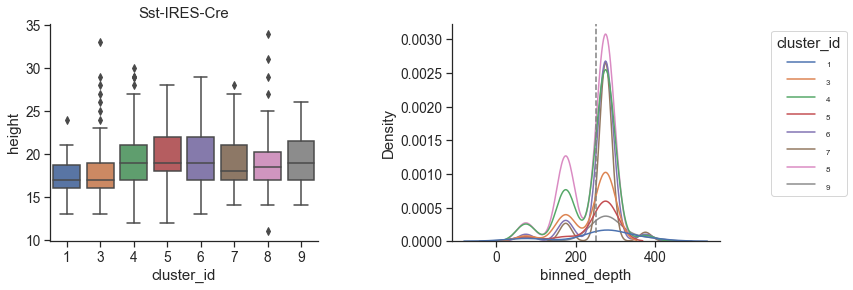

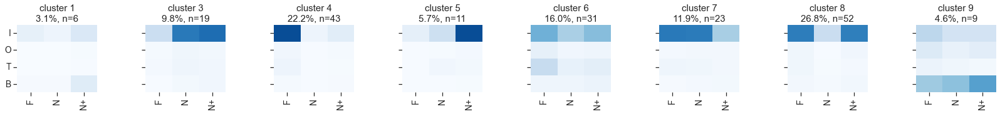

In [132]:
cre_line = cre_lines[1]
csids = cluster_meta[(cluster_meta.cre_line==cre_line)].index.unique()
cluster_data = cell_info[cell_info.cell_specimen_id.isin(csids)]
cluster_data = cluster_data.merge(cluster_meta['cluster_id'], on='cell_specimen_id')
cluster_data = cluster_data.merge(experiments_table['binned_depth'], on='ophys_experiment_id')

fig, ax = plt.subplots(1,2, figsize=(12,4))
ax[0] = sns.boxplot(data=cluster_data, x='cluster_id', y='height', ax=ax[0])
ax[1] = sns.kdeplot(data=cluster_data, x='binned_depth', hue='cluster_id', palette=sns.color_palette(), ax=ax[1])
ax[1].axvline(x=250, ymin=0, ymax=1, color='gray', linestyle='--')

sns.move_legend(ax[1], 'upper right', bbox_to_anchor=(1.5,1))
plt.setp(ax[1].get_legend().get_texts(), fontsize='8')  
ax[0].set_title(cre_line)

fig.subplots_adjust(wspace=0.5)
plotting.plot_clusters_row(cluster_meta, feature_matrix, cre_line)


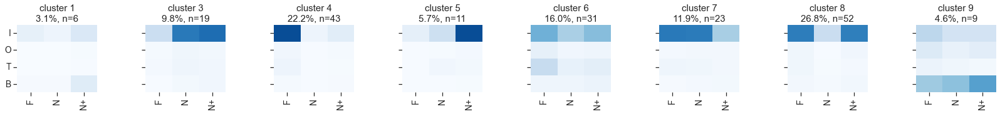

In [133]:
plotting.plot_clusters_row(cluster_meta, feature_matrix, cre_line)

In [134]:
cre_line

'Sst-IRES-Cre'

### image tuning curves per cluster

#### load data

In [135]:
data_type = 'events'

interpolate = True
output_sampling_rate = 30

# set inclusion criteria
# options: ['active_only', 'closest_familiar_and_novel', 'containers_with_all_levels']

inclusion_criteria = 'platform_experiment_table'

In [326]:
# params for stim response df creation
event_type = 'all'

# params for mean response df creation
conditions = ['cell_specimen_id', 'is_change', 'image_name']

suffix = '_'+utils.get_conditions_string(data_type, conditions)+'_'+inclusion_criteria

# load from single file - takes about 4 mins
save_path = os.path.join(loading.get_multi_session_df_dir(), '113023'+suffix+'.pkl')
each_image_mdf = pd.read_pickle(save_path)


# # load from multi session dfs

# each_image_mdf = loading.get_multi_session_df_for_conditions(data_type, event_type, conditions, inclusion_criteria, 
#                                                         interpolate=interpolate, output_sampling_rate=output_sampling_rate, 
#                                                          epoch_duration_mins=None)

# # replace exp level with new one
# each_image_mdf['experience_level'] = [utils.convert_experience_level(experience_level) for experience_level in each_image_mdf.experience_level.values]

# # save to pickle 
# save_path = os.path.join(loading.get_multi_session_df_dir(), '113023'+suffix+'.pkl')
# each_image_mdf.to_pickle(save_path)

# save the original as its own variable so you dont have to load it again if you make a mistake
original_each_image_mdf = each_image_mdf.copy()

# remove changes
each_image_mdf = each_image_mdf[each_image_mdf.is_change==False]
# merge with cluster meta 
each_image_mdf = each_image_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')

In [329]:
len(each_image_mdf.cell_specimen_id.unique())

3901

In [330]:
# limit to matched cells
print(len(each_image_mdf.cell_specimen_id.unique()))
each_image_mdf = each_image_mdf[each_image_mdf.cell_specimen_id.isin(matched_cells)]
print(len(each_image_mdf.cell_specimen_id.unique()))

3901
3901


#### add image index

 There are different image sets in each experience level so you cant just use the image_name to plot tuning curves beause not all cells have all images. Instead use a generic ID. Also it will be helpful to sort the indices by the mean response, but that can be done during the plotting i think

In [ ]:
def add_image_index_column(df): 
    '''
    for a dataframe with image_name as a column, create a new column 'image_index' based on sorted order of image names
    
    currently only works for dfs with image_names from image sets A and B
    '''
    # make lookup table 
    image_names_A = list(df[df.image_set=='A'].image_name.unique())
    image_indices_A = list(np.argsort(image_names_A))
    image_names_B = list(df[df.image_set=='B'].image_name.unique())
    image_indices_B = list(np.argsort(image_names_B))

    image_names = image_names_A + image_names_B
    image_indices = image_indices_A + image_indices_B

    image_dict = dict(zip(image_names, image_indices))

    # add image_index column using lookup table
    df['image_index'] = [image_dict[image_name] for image_name in df.image_name.values]

    return df

{'im061': 0,
 'im062': 1,
 'im063': 2,
 'im065': 3,
 'im066': 4,
 'im069': 5,
 'im077': 6,
 'im085': 7,
 'omitted': 8,
 'im000': 0,
 'im031': 1,
 'im035': 2,
 'im045': 3,
 'im054': 4,
 'im073': 5,
 'im075': 6,
 'im106': 7}

In [332]:
each_image_mdf = plotting.add_image_index_column(each_image_mdf)

In [333]:
each_image_mdf.image_index.unique()

array([0, 1, 2, 3, 4, 5, 6, 7, 8], dtype=int64)

#### plot tuning curve heatmaps per cluster

In [ ]:
def get_cell_list_ordered_by_pref_image_index(df):
    '''
    take a dataframe containing mean image responses for cells and return list of cell_specimen_ids
    in order of preferred image and mean response within each preferred image
    df: multi_session_df with 'image_index' and 'mean_response' as columns
    '''
    # remove omissions
    df = df[df.image_name!='omitted']
    image_indices = np.sort(df['image_index'].unique())
    cell_list = []
    for image_index in image_indices:
        # get cells with pref stim for this image index 
        tmp = df[(df['image_index'] == image_index) & (df.pref_stim == True)]
        # sort cells by mean response value
        order = np.argsort(tmp.mean_response.values)[::-1]
        # add to list of IDs
        cell_ids = list(tmp.cell_specimen_id.values[order])
        cell_list = cell_list + cell_ids
    return cell_list

In [ ]:
def plot_tuning_curve_heatmap_for_cluster(df, cell_list=None, vmax=0.3, cmap='magma', sup_title=None, title=None, 
                                          ax=None, save_dir=None, folder=None, 
                                          label='response', colorbar=True):
    '''
    plot a heatmap where x axis is image_name and y axis is cell_specimen_ids, 
    sorted by the preferred image then mean response within each pref image
    use cell_list for sorting if provided
    '''
    # make sure image_index column exists
    if 'image_index' not in df.columns:
        print('adding image index')
        df = add_image_index_column(df)
    # remove omissions
    # df = df[df.image_name!='omitted']
    image_indices = np.sort(df['image_index'].unique())
    if cell_list is None:
        cell_list = get_cell_list_ordered_by_pref_image_index(df)
    response_matrix = np.empty((len(cell_list), len(image_indices)))
    for i, csid in enumerate(cell_list):
        responses = []
        for image_index in image_indices:
            response = df[(df.cell_specimen_id == csid) & (df['image_index'] == image_index)].mean_response.values[0]
            responses.append(response)
        response_matrix[i, :] = np.asarray(responses)
    if ax is None:
        figsize = (5, 8)
        fig, ax = plt.subplots(figsize=figsize)
        fig.tight_layout()

    ax = sns.heatmap(response_matrix, cmap=cmap, linewidths=0, linecolor='white', square=False,
                     vmin=0, vmax=vmax, robust=True, cbar=colorbar,
                     cbar_kws={"drawedges": False, "shrink": 0.5, "label": label}, ax=ax)
    
    # import matplotlib.cm
    # cmap = matplotlib.cm.ScalarMappable(norm=None, cmap='magma')
    # cmap.set_clim(vmin=0, vmax=0.2)

    # fig, ax = plt.subplots()
    # cbar = fig.colorbar(cmap, ax=ax)
    # cbar_labels = cbar.ax.get_yticklabels()
    # cbar.ax.set_yticklabels(cbar_labels, fontsize=10)

    ax.set_title(title, va='bottom', ha='center')
    ax.set_xticks(np.arange(0.5, len(image_indices)+0.5))
    if len(image_indices) > 8: # if omissions are included
        ax.set_xticklabels(list(image_indices[:8]+1)+[0], rotation=0, fontsize=14)
    else: 
        ax.set_xticklabels(list(image_indices+1), rotation=0, fontsize=14)
    ax.set_ylabel('cells')
    ax.set_yticks((0, response_matrix.shape[0]))
    ax.set_yticklabels((0, response_matrix.shape[0]), fontsize=14)
    if save_dir:
        plt.suptitle(sup_title, x=0.46, y=0.99, fontsize=18)
        fig.tight_layout()
        plt.gcf().subplots_adjust(top=0.9)
        utils.save_figure(fig, figsize, save_dir, folder, 'tuning_curve_heatmap_' + sup_title + '_' + title)
    return ax


In [334]:
# import matplotlib.cm

# cmap = matplotlib.cm.ScalarMappable(norm=None, cmap='magma')
# cmap.set_clim(vmin=0, vmax=0.2)

# fig, ax = plt.subplots()
# cbar = fig.colorbar(cmap, ax=ax)

In [ ]:
# get preferred experience level for cluster
# go through image IDs and get cell pref stim order
# generate tuning curve plot for each experience level, using same cell order

In [362]:
# get cluster metrics 
cluster_metrics = processing.get_cluster_metrics(cluster_meta, feature_matrix, results_pivoted)

C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1899: RuntimeWarning: invalid value encountered in double_scalars
  exp_mod_persistence = row['Novel +'] / row['Novel'] # make it an index
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1899: RuntimeWarning: divide by zero encountered in double_scalars
  exp_mod_persistence = row['Novel +'] / row['Novel'] # make it an index
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1876: RuntimeWarning: invalid value encountered in double_scalars
  feature_selectivity = (values[0] - (np.mean(values[1:]))) / (values[0] + (np.mean(values[1:])))
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1880: RuntimeWarning: invalid value encountered in double_scalars

In [341]:
cluster_metrics = cluster_metrics.reset_index()
# get preferred experience level for cluster
cluster_id = 1
# get cells in this cluster 
csids = cluster_meta[cluster_meta.cluster_id==cluster_id].index.values
# get preferred experience level
pref_exp_level = cluster_metrics[cluster_metrics.cluster_id==cluster_id].dominant_experience_level.values[0]



In [342]:
cre_line = cre_lines[0]

# get image responses for cells in this cluster for pref experience level for a given cre line
df = each_image_mdf[(each_image_mdf.cell_specimen_id.isin(csids)) &
               (each_image_mdf.experience_level==pref_exp_level) & 
               (each_image_mdf.cre_line==cre_line)]
print(len(df.cell_specimen_id.unique()))

722


In [343]:
cell_list = plotting.get_cell_list_ordered_by_pref_image_index(df)
len(cell_list)

722

<AxesSubplot:ylabel='cells'>

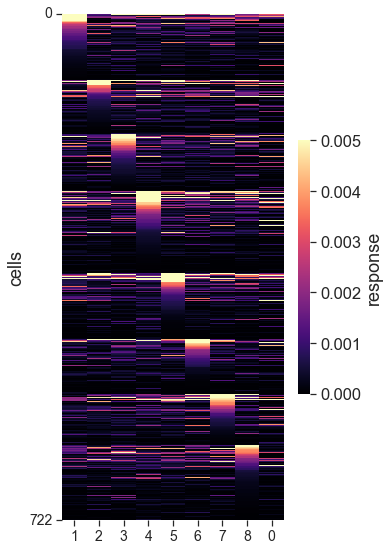

In [347]:
plotting.plot_tuning_curve_heatmap_for_cluster(df, cell_list=cell_list, vmax=0.005, sup_title=None, title=None, 
                                          ax=None, save_dir=None, folder=None, 
                                          label='response', colorbar=True)

##### all experience levels together

In [384]:

def plot_image_tuning_curves_across_experience_for_cluster(each_image_mdf, cluster_metrics, cluster_id, 
                                                           vmax = 0.02, cmap='viridis', sort_by_pref_exp_level=True,
                                                           save_dir=None, folder=None):

    '''
    plots heatmap of imaging tuning curves across cells in each cre line in each cluster
    x axis is image index, y axis is cell ID

    if sort_by_pref_exp_level is True, cells are sorted by the max image responses for the preferred experience level for that cluster 
    if False, cells are sorted within each experience level

    each_image_mdf is a multi_session_dataframe using conditions = ['cell_specimen_id', 'is_change', 'image_name'], event_type = 'all'
    each_image_mdf must have column 'cluster_id' 
    cluster_metrics is obtained using the function processing.get_cluster_metrics()
    '''


    # sort_by_pref_exp_level = True
    # vmax = 0.02
    # cmap='viridis'
    # label = 'response'

    if 'cluster_id' not in cluster_metrics.columns: 
        cluster_metrics = cluster_metrics.reset_index()

    figsize = (8, 8)
    fig, ax = plt.subplots(3, 4, figsize=figsize, sharey=False, sharex=False)
    ax = ax.ravel()

    for c, cre_line in enumerate(utils.get_cre_lines()):

        # get image responses for cells in this cluster for a given cre line
        cluster_df = each_image_mdf[(each_image_mdf.cluster_id==cluster_id) & (each_image_mdf.cre_line==cre_line)].copy()
        print(cre_line, len(cluster_df.cell_specimen_id.unique()))

        if len(cluster_df)>0: # only plot if there are actually cells in this cluster for this cre line
            # get preferred experience level for cluster
            pref_exp_level = cluster_metrics[(cluster_metrics.cluster_id==cluster_id)].dominant_experience_level.values[0]

            if sort_by_pref_exp_level: 
                # get order of cells based on tuning in pref experience level
                cell_list = plotting.get_cell_list_ordered_by_pref_image_index(cluster_df[cluster_df.experience_level==pref_exp_level])
                prefix = 'sort_by_pref_exp_level'
            else: 
                cell_list = None
                prefix = 'sort_within_exp_level'

            for i, experience_level in enumerate(utils.get_new_experience_levels()):
                df = cluster_df[cluster_df.experience_level==experience_level].copy()
                ax[(c*4)+i] = plotting.plot_tuning_curve_heatmap_for_cluster(df, cell_list=cell_list, 
                                                    vmax=vmax, cmap='magma', sup_title=None, title=None, 
                                                    ax=ax[(c*4)+i], save_dir=None, folder=None, label='', colorbar=False)
                ax[(c*4)+i].set_ylabel('')
                ax[(c*4)+i].set_yticklabels([])
                if c == 0: 
                    ax[(c*4)+i].set_title(experience_level)
            # ax[0].set_ylabel('cells')
            ax[(c*4)+0].set_ylabel(utils.convert_cre_line_to_cell_type(cre_line))
            ax[(c*4)+0].set_yticks((0, len(cell_list)))
            ax[(c*4)+0].set_yticklabels((0, len(cell_list)), fontsize=14)
            ax[(c*4)+3].set_yticklabels([])
            # add custom colorbar on its own axis
            # import matplotlib.cm
            cmap = matplotlib.cm.ScalarMappable(norm=None, cmap='magma')
            cmap.set_clim(vmin=0, vmax=vmax)
            cbar = fig.colorbar(cmap, ax=ax[(c*4)+3], label='response')
            # cbar_labels = cbar.ax.get_yticklabels()
            # cbar.ax.set_yticklabels(cbar_labels, fontsize=10)
            # ax[3].axis('off')

            fig.subplots_adjust(wspace=0.3, hspace=0.3)
            fig.suptitle('cluster '+str(cluster_id), x=0.42, y=0.97)

    if save_dir: 
        utils.save_figure(fig, figsize, os.path.join(save_dir, folder), 'tuning_curves', prefix+'_cluster_'+str(cluster_id)+'_tuning_curves')


Slc17a7-IRES2-Cre 722
Sst-IRES-Cre 6
Vip-IRES-Cre 61


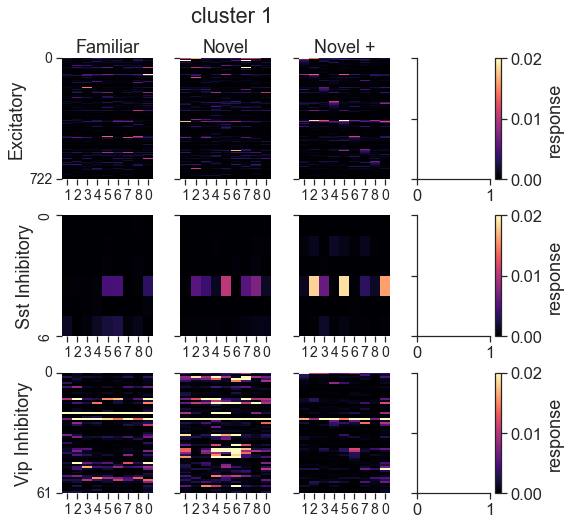

In [386]:
plot_image_tuning_curves_across_experience_for_cluster(each_image_mdf, cluster_metrics, cluster_id=1, 
                                                           vmax = 0.02, cmap='viridis', sort_by_pref_exp_level=True,
                                                           save_dir=None, folder=None)

##### for all clusters

Slc17a7-IRES2-Cre 722
Sst-IRES-Cre 6
Vip-IRES-Cre 61
Slc17a7-IRES2-Cre 611
Sst-IRES-Cre 0
Vip-IRES-Cre 62
Slc17a7-IRES2-Cre 377
Sst-IRES-Cre 19
Vip-IRES-Cre 8
Slc17a7-IRES2-Cre 313
Sst-IRES-Cre 43
Vip-IRES-Cre 0
Slc17a7-IRES2-Cre 310
Sst-IRES-Cre 11
Vip-IRES-Cre 7
Slc17a7-IRES2-Cre 266
Sst-IRES-Cre 31
Vip-IRES-Cre 14
Slc17a7-IRES2-Cre 204
Sst-IRES-Cre 23
Vip-IRES-Cre 7
Slc17a7-IRES2-Cre 177
Sst-IRES-Cre 52
Vip-IRES-Cre 0
Slc17a7-IRES2-Cre 128
Sst-IRES-Cre 9
Vip-IRES-Cre 78
Slc17a7-IRES2-Cre 136
Sst-IRES-Cre 0
Vip-IRES-Cre 22
Slc17a7-IRES2-Cre 25
Sst-IRES-Cre 0
Vip-IRES-Cre 87
Slc17a7-IRES2-Cre 29
Sst-IRES-Cre 0
Vip-IRES-Cre 63


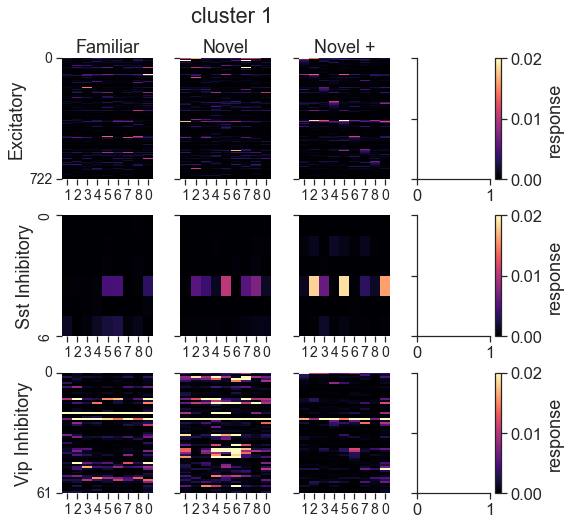

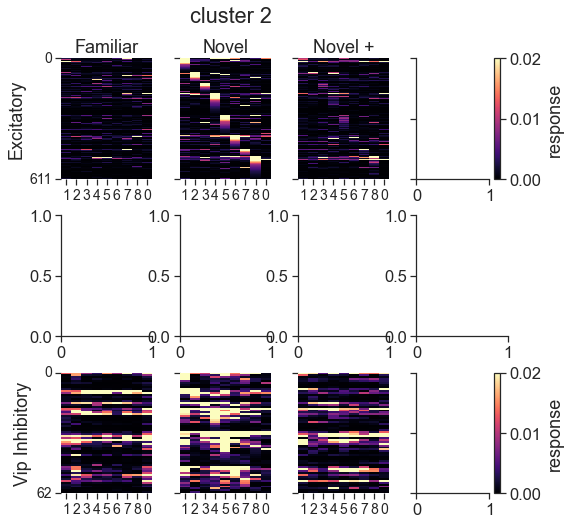

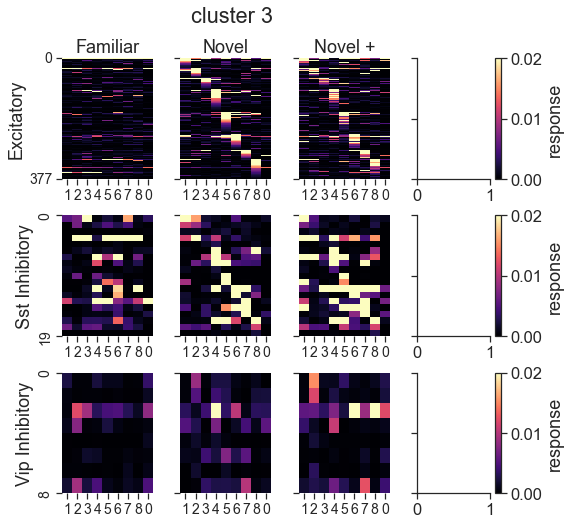

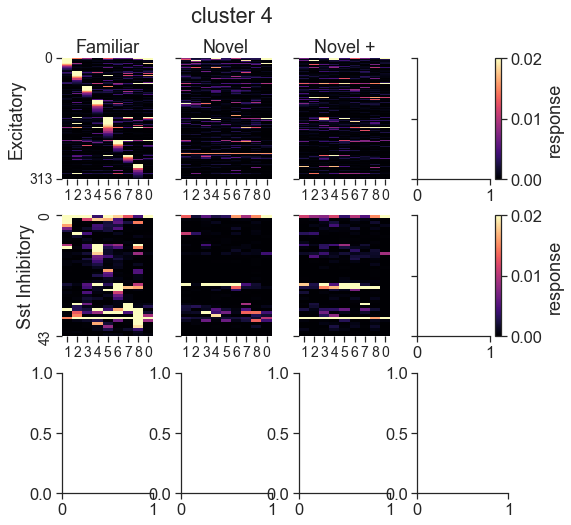

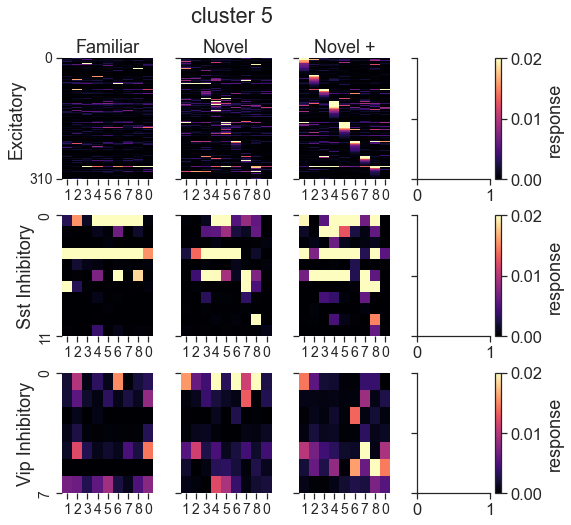

...

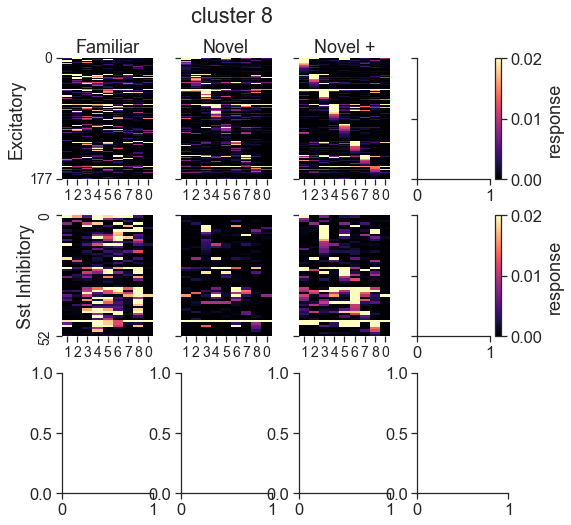

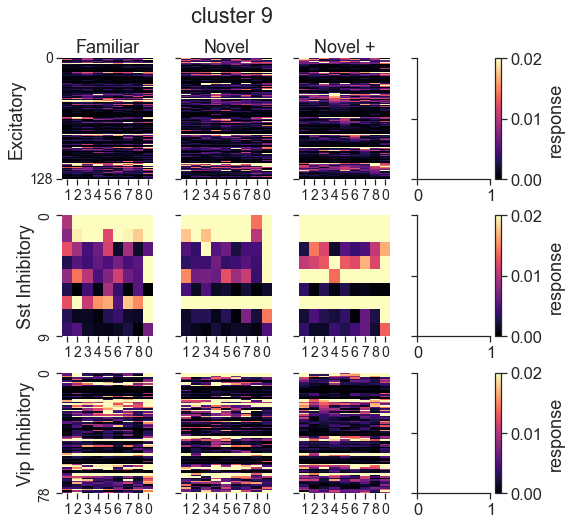

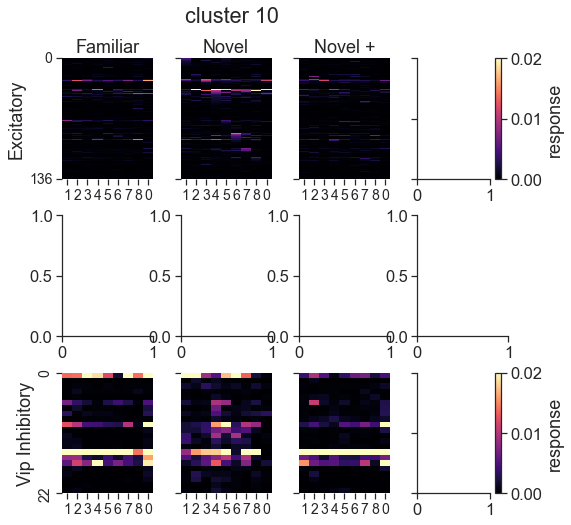

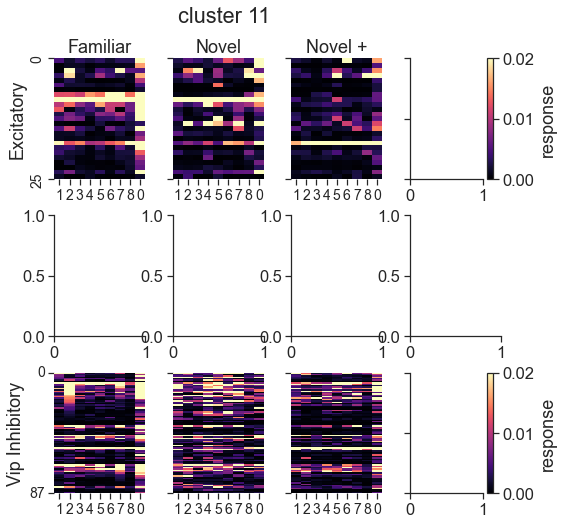

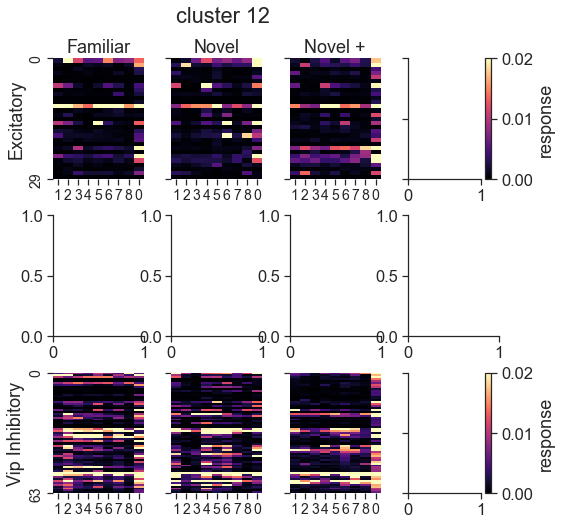

In [388]:
# cluster_id = 1
for cluster_id in np.sort(cluster_meta.cluster_id.unique()):

    plotting.plot_image_tuning_curves_across_experience_for_cluster(each_image_mdf, cluster_metrics, cluster_id, 
                                                           vmax = 0.02, cmap='magma', sort_by_pref_exp_level=True,
                                                           save_dir=save_dir, folder=folder)
    
    # figsize = (8, 8)
    # fig, ax = plt.subplots(3, 4, figsize=figsize, sharey=False, sharex=False)
    # ax = ax.ravel()

    # for c, cre_line in enumerate(cre_lines):

    #     # get image responses for cells in this cluster for a given cre line
    #     cluster_df = each_image_mdf[(each_image_mdf.cluster_id==cluster_id) & (each_image_mdf.cre_line==cre_line)].copy()
    #     print(cre_line, len(cluster_df.cell_specimen_id.unique()))

    #     # get preferred experience level for cluster
    #     pref_exp_level = cluster_metrics[cluster_metrics.cluster_id==cluster_id].dominant_experience_level.values[0]

    #     # get order of cells based on tuning in pref experience level
    #     cell_list = plotting.get_cell_list_ordered_by_pref_image_index(cluster_df[cluster_df.experience_level==pref_exp_level])

    #     vmax = 0.02
    # #     for i, experience_level in enumerate(experience_levels):
    #         df = cluster_df[cluster_df.experience_level==experience_level].copy()
    #         ax[(c*4)+i] = plotting.plot_tuning_curve_heatmap_for_cluster(df, cell_list=None, vmax=vmax, cmap='viridis', sup_title=None, title=None, 
    #                                             ax=ax[(c*4)+i], save_dir=None, folder=None, label='response', colorbar=False)
    #         ax[(c*4)+i].set_ylabel('')
    #         ax[(c*4)+i].set_yticklabels([])
    #         if c == 0: 
    #             ax[(c*4)+i].set_title(experience_level)
    #     # ax[0].set_ylabel('cells')
    #     ax[(c*4)+0].set_ylabel(utils.convert_cre_line_to_cell_type(cre_line)+'\ncells (rows not matched)')
    #     ax[(c*4)+0].set_yticks((0, len(cell_list)))
    #     ax[(c*4)+0].set_yticklabels((0, len(cell_list)), fontsize=14)
    #     ax[(c*4)+3].set_yticklabels([])
    #     # add custom colorbar on its own axis
    #     # import matplotlib.cm
    #     cmap = matplotlib.cm.ScalarMappable(norm=None, cmap='viridis')
    #     cmap.set_clim(vmin=0, vmax=vmax)
    #     cbar = fig.colorbar(cmap, ax=ax[(c*4)+3], label='response')
    #     # cbar_labels = cbar.ax.get_yticklabels()
    #     # cbar.ax.set_yticklabels(cbar_labels, fontsize=10)
    #     # ax[3].axis('off')

    #     fig.subplots_adjust(wspace=0.3, hspace=0.3)
    #     fig.suptitle('cluster '+str(cluster_id), x=0.42, y=0.97)

    # utils.save_figure(fig, figsize, os.path.join(save_dir, folder), 'tuning_curves', 'within_exp_sort_cluster_'+str(cluster_id)+'_tuning_curves')


### plot cluster average tuning curve sorted by pref image

In [349]:
# get mean response per image per cell & exp level
image_tcs = each_image_mdf[each_image_mdf.image_name!='omission'].groupby(['cell_specimen_id', 'experience_level', 'image_index']).mean()[['mean_response']]
# sort values by mean responses
sort_tcs = image_tcs.reset_index().sort_values(by=['cell_specimen_id', 'experience_level', 'mean_response'], ascending=False).set_index(['cell_specimen_id', 'experience_level'])
# add sorted image index column
sort_tcs['sorted_image_index'] = np.nan
for index in sort_tcs.index.unique():
    sorted_image_index = np.argsort(sort_tcs.loc[index].mean_response.values)
    sort_tcs.loc[index, 'sorted_image_index'] = sorted_image_index
sort_tcs['sorted_image_index'] = [int(sorted_image_index) for sorted_image_index in sort_tcs.sorted_image_index.values]

# pivot so mean response are columns 
image_tc_pivot = sort_tcs.pivot_table(index=['cell_specimen_id', 'experience_level'] , columns=['sorted_image_index'], values=['mean_response'])
image_tc_pivot.columns = image_tc_pivot.columns.droplevel(0)
# add cluster ID
image_tcs_final = image_tc_pivot.reset_index().merge(cluster_meta[['cluster_id']], on='cell_specimen_id')

C:\Users\marinag\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:8: PerformanceWarning: indexing past lexsort depth may impact performance.
  
C:\Users\marinag\AppData\Roaming\Python\Python37\site-packages\IPython\core\interactiveshell.py:2976: PerformanceWarning: indexing past lexsort depth may impact performance.
  raw_cell, store_history, silent, shell_futures, cell_id
C:\Users\marinag\AppData\Roaming\Python\Python37\site-packages\IPython\core\async_helpers.py:78: PerformanceWarning: indexing past lexsort depth may impact performance.
  coro.send(None)


Text(0, 0.5, 'mean response')

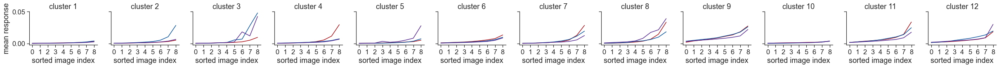

In [350]:

# plot mean TC for each exp level in each cluster
n_clusters = len(cluster_meta.cluster_id.unique())
figsize = (3.5 * 12, 1.5)
fig, ax = plt.subplots(1, 12, figsize=figsize, sharey=True, sharex=True)
ax = ax.ravel()
i = 0
for i, cluster_id in enumerate(np.sort(cluster_meta.cluster_id.unique())):
    for e,experience_level in enumerate(experience_levels):
        cluster_tc = image_tcs_final[(image_tcs_final.experience_level==experience_level) & 
                                     (image_tcs_final.cluster_id==cluster_id)].set_index(['cell_specimen_id', 'experience_level', 'cluster_id']).mean()
        cluster_tc = cluster_tc[::-1] # reverse since its not descending
        ax[i].plot(cluster_tc, color=experience_level_colors[e])
        ax[i].set_title('cluster '+str(cluster_id))
        ax[i].set_xticks(np.arange(0, len(cluster_tc)))
        ax[i].set_xlabel('sorted image index')
        ax[i].set_ylabel('')
ax[0].set_ylabel('mean response')


### plot single cell tuning curves with lifetime sparsness for clusters 

In [391]:
# first get response metrics to get lifetime sparseness values

import visual_behavior.ophys.response_analysis.cell_metrics as cm

data_type = 'events'

condition = 'images'
stimuli = 'all_images'
session_subset = 'full_session'

# set inclusion criteria
# options: ['active_only', 'closest_familiar_and_novel', 'containers_with_all_levels', 'platform_experiment_table']
inclusion_criteria = 'platform_experiment_table'
    
response_metrics = cm.get_cell_metrics_for_conditions(data_type, condition, stimuli, session_subset, inclusion_criteria)

# convert experience level
response_metrics['experience_level'] = [utils.convert_experience_level(experience_level) for experience_level in response_metrics.experience_level.values]

# limit to matched cells
response_metrics = response_metrics[response_metrics.cell_specimen_id.isin(matched_cells)]
len(response_metrics)

C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


removing 1 problematic experiments
there are 402 experiments after filtering for inclusion criteria -  platform_experiment_table


100%|██████████| 402/402 [01:33<00:00,  4.32it/s]
c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\pandas\core\generic.py:2718: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed,key->block1_values] [items->Index(['condition', 'data_type', 'exception', 'filter_events', 'interpolate',
       'ophys_experiment_id', 'session_subset', 'stimuli', 'use_events'],
      dtype='object')]

  encoding=encoding,


there are 402 experiments in the returned cell_metrics table


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)
C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To s

removing 1 problematic experiments


11763

In [ ]:
def plot_single_cell_tuning_curve_across_experience_levels(cell_specimen_id, image_mdf, response_metrics, 
                                                           save_dir=None, folder=None):
    ''' 
    plots mean image response for each experience level for a single cell, sorted by the magnitude of the mean response
    includes lifetime sparseness value in title 
    image_mdf: multi_session_df with one row per image per cell_specimen_id, including columns 'mean_response' and 'image_index'
    response_metrics: table of metric values for single cells, obtained using cell_metrics.get_cell_metrics_for_conditions()
    '''
    figsize = (10,2)
    fig, ax = plt.subplots(1, 3, figsize=figsize, sharey=True)

    for i, experience_level in enumerate(experience_levels): 
        cdf = image_mdf[(image_mdf.cell_specimen_id==cell_specimen_id)&(image_mdf.experience_level==experience_level)]

        tmp = cdf[cdf.image_name!='omitted'].sort_values(by='mean_response', ascending=False)
        image_ids = list(tmp.image_index.values+1)
        tuning_curve = list(tmp.mean_response.values) + [cdf[cdf.image_name=='omitted'].mean_response.values]
        sparseness = response_metrics[(response_metrics.cell_specimen_id==cell_specimen_id) & 
                                    (response_metrics.experience_level==experience_level)].lifetime_sparseness.values[0]
        sparseness = np.round(sparseness, 2)

        ax[i].plot(tuning_curve)
        ax[i].set_ylabel('')
        ax[i].set_xticks(np.arange(0, len(image_ids)+1))
        ax[i].set_xticklabels(image_ids+[0]);
        ax[i].set_xlabel('sorted image index')
        ax[i].set_title(experience_level+'\nsparseness: '+str(sparseness))
    ax[0].set_ylabel('response')

    cluster_id = cdf.cluster_id.unique()[0]
    cre_line = cdf.cre_line.unique()[0]
    title = 'cluster '+str(cluster_id)+' - '+utils.convert_cre_line_to_cell_type(cre_line)+', csid: '+str(cell_specimen_id)
    plt.suptitle(title, x=0.5, y=1.35, fontsize=18)

    fig.subplots_adjust(wspace=0.4)

    if save_dir: 
        filename = utils.convert_cre_line_to_cell_type(cre_line)+'_'+'cluster_'+str(cluster_id)+'_csid_'+str(cell_specimen_id)
        utils.save_figure(fig, figsize, os.path.join(save_dir, folder, 'tuning_curves'), 'single_cell_plots', filename)
        plt.close()

c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\numpy\core\shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ary = asanyarray(ary)
c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\numpy\core\shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ary = asanyarray(ary)
c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\numpy\core\shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or

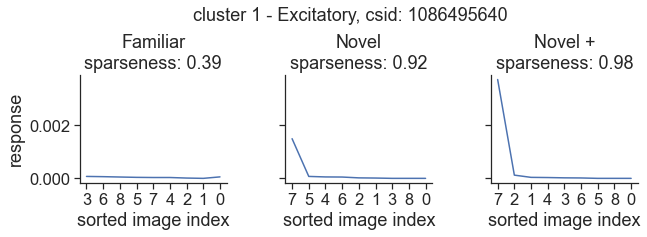

In [392]:
plotting.plot_single_cell_tuning_curve_across_experience_levels(cell_specimen_id, each_image_mdf, response_metrics, 
                                                           save_dir=None, folder=None)

#### plot for all cells

In [ ]:
# # cluster_id = 1
# import random
# for cell_type in cell_types: 
#     print(cell_type)
#     for cluster_id in np.sort(cluster_meta.cluster_id.unique()):
#         cell_specimen_ids = cluster_meta[(cluster_meta.cluster_id==cluster_id) & 
#                                         (cluster_meta.cell_type==cell_type)].index.values
#         # randomize so they arent in experiment order
#         random.shuffle(cell_specimen_ids)
#         # only plot 25 cells 
#         if len(cell_specimen_ids) > 25:
#             cell_specimen_ids = cell_specimen_ids[:25]
#         for cell_specimen_id in cell_specimen_ids: 
#             scp.plot_single_cell_tuning_curve_across_experience_levels(cell_specimen_id, each_image_mdf, response_metrics, 
#                                                             save_dir=save_dir, folder=folder)


Excitatory


c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\numpy\core\shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ary = asanyarray(ary)
c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\numpy\core\shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ary = asanyarray(ary)
c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\numpy\core\shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or

Sst Inhibitory


c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\numpy\core\shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ary = asanyarray(ary)
c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\numpy\core\shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ary = asanyarray(ary)
c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\numpy\core\shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or

Vip Inhibitory


c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\numpy\core\shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ary = asanyarray(ary)
c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\numpy\core\shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ary = asanyarray(ary)
c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\numpy\core\shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or

#### sanity check histograms

In [ ]:
response_metrics = response_metrics.merge(cluster_meta[['cluster_id']], on='cell_specimen_id')

In [ ]:
np.sort(response_metrics.cluster_id.unique())

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12], dtype=int64)

In [ ]:
# response_metrics['cre_line'] = response_metrics.cre_line_x
# response_metrics['experience_level'] = response_metrics.experience_level_x

Text(0.5, 1.0, 'cluster 2 novel vs. cluster 4 familiar')

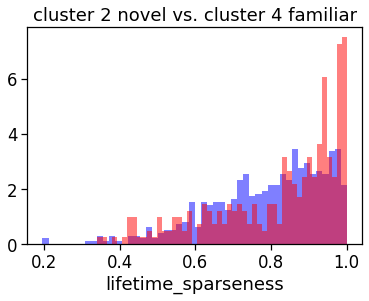

In [ ]:
exc = response_metrics[response_metrics.cre_line=='Slc17a7-IRES2-Cre']

cluster_2_novel = exc[(exc.cluster_id==2)&(exc.experience_level=='Novel')]
cluster_4_familiar = exc[(exc.cluster_id==4)&(exc.experience_level=='Familiar')]

fig, ax = plt.subplots()
ax.hist(cluster_2_novel.lifetime_sparseness.values, bins=50, color='blue', alpha=0.5, label='cluster_2_novel', density=True);
ax.hist(cluster_4_familiar.lifetime_sparseness.values, bins=50, color='red', alpha=0.5, label='cluster_4_familiar', density=True);
ax.set_xlabel('lifetime_sparseness')
ax.set_title('cluster 2 novel vs. cluster 4 familiar')

### within session changes

In [393]:
# params for stim response df creation
event_type = 'changes'

# params for mean response df creation
conditions = ['cell_specimen_id', 'is_change', 'epoch']


suffix = '_'+utils.get_conditions_string(data_type, conditions)+'_'+inclusion_criteria

epoch_mdf = loading.get_multi_session_df_for_conditions(data_type, event_type, conditions, inclusion_criteria, 
                                                        interpolate=interpolate, output_sampling_rate=output_sampling_rate, 
                                                         epoch_duration_mins=None)

# save original so you dont have to reload
original_epoch_mdf = epoch_mdf.copy()
# remove truncated last epoch
epoch_mdf = epoch_mdf[epoch_mdf.epoch!=6]
# add cluster IDs
epoch_mdf = epoch_mdf.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')

### note this is an mdf for changes only ###

C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


loading files from \\allen\programs\braintv\workgroups\nc-ophys\visual_behavior\platform_paper_cache\multi_session_mean_response_dfs\interpolate_30Hz


  6%|▌         | 1/18 [00:26<07:30, 26.51s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_1_images_B
no multi_session_df for VisualBehaviorMultiscope OPHYS_1_images_G


 22%|██▏       | 4/18 [00:51<02:46, 11.90s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_2_images_B_passive
no multi_session_df for VisualBehaviorMultiscope OPHYS_2_images_G_passive


 39%|███▉      | 7/18 [01:19<01:54, 10.42s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_3_images_B
no multi_session_df for VisualBehaviorMultiscope OPHYS_3_images_G
no multi_session_df for VisualBehaviorMultiscope OPHYS_4_images_A


 61%|██████    | 11/18 [01:51<01:04,  9.15s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_4_images_H
no multi_session_df for VisualBehaviorMultiscope OPHYS_5_images_A_passive


 78%|███████▊  | 14/18 [02:10<00:32,  8.19s/it]

no multi_session_df for VisualBehaviorMultiscope OPHYS_5_images_H_passive
no multi_session_df for VisualBehaviorMultiscope OPHYS_6_images_A


100%|██████████| 18/18 [02:31<00:00,  8.42s/it]


no multi_session_df for VisualBehaviorMultiscope OPHYS_6_images_H


  0%|          | 0/18 [00:00<?, ?it/s]

no multi_session_df for VisualBehaviorTask1B OPHYS_1_images_A


 11%|█         | 2/18 [00:08<01:08,  4.26s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_1_images_G
no multi_session_df for VisualBehaviorTask1B OPHYS_2_images_A_passive


 28%|██▊       | 5/18 [00:16<00:42,  3.26s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_2_images_G_passive
no multi_session_df for VisualBehaviorTask1B OPHYS_3_images_A


 44%|████▍     | 8/18 [00:26<00:33,  3.31s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_3_images_G


 56%|█████▌    | 10/18 [00:37<00:31,  3.94s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_4_images_B
no multi_session_df for VisualBehaviorTask1B OPHYS_4_images_H


 72%|███████▏  | 13/18 [00:45<00:17,  3.46s/it]

no multi_session_df for VisualBehaviorTask1B OPHYS_5_images_B_passive
no multi_session_df for VisualBehaviorTask1B OPHYS_5_images_H_passive


100%|██████████| 18/18 [00:54<00:00,  3.03s/it]


no multi_session_df for VisualBehaviorTask1B OPHYS_6_images_B
no multi_session_df for VisualBehaviorTask1B OPHYS_6_images_H


  6%|▌         | 1/18 [00:12<03:28, 12.26s/it]

no multi_session_df for VisualBehavior OPHYS_1_images_B
no multi_session_df for VisualBehavior OPHYS_1_images_G


 22%|██▏       | 4/18 [00:22<01:11,  5.08s/it]

no multi_session_df for VisualBehavior OPHYS_2_images_B_passive
no multi_session_df for VisualBehavior OPHYS_2_images_G_passive


 39%|███▉      | 7/18 [00:31<00:43,  3.97s/it]

no multi_session_df for VisualBehavior OPHYS_3_images_B
no multi_session_df for VisualBehavior OPHYS_3_images_G
no multi_session_df for VisualBehavior OPHYS_4_images_A


 61%|██████    | 11/18 [00:41<00:22,  3.27s/it]

no multi_session_df for VisualBehavior OPHYS_4_images_H
no multi_session_df for VisualBehavior OPHYS_5_images_A_passive


 78%|███████▊  | 14/18 [00:51<00:12,  3.24s/it]

no multi_session_df for VisualBehavior OPHYS_5_images_H_passive
no multi_session_df for VisualBehavior OPHYS_6_images_A


100%|██████████| 18/18 [01:01<00:00,  3.40s/it]


no multi_session_df for VisualBehavior OPHYS_6_images_H


100%|██████████| 18/18 [00:00<00:00, 252.45it/s]


no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_1_images_A
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_1_images_B
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_1_images_G
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_2_images_A_passive
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_2_images_B_passive
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_2_images_G_passive
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_3_images_A
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_3_images_B
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_3_images_G
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_4_images_A
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_4_images_B
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_4_images_H
no multi_session_df for VisualBehaviorMultiscope4areasx2d OPHYS_5_images_A_p

C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


removing 1 problematic experiments
there are 402 experiments in the multi_session_df after limiting to platform experiments
there are 402 experiments after filtering for inclusion criteria -  platform_experiment_table


Vip Inhibitory
Sst Inhibitory
Excitatory


array([<AxesSubplot:title={'center':'Vip Inhibitory'}, xlabel='epoch within session', ylabel='mean response'>,
       <AxesSubplot:title={'center':'Sst Inhibitory'}, xlabel='epoch within session', ylabel='mean response'>,
       <AxesSubplot:title={'center':'Excitatory'}, xlabel='epoch within session', ylabel='mean response'>],
      dtype=object)

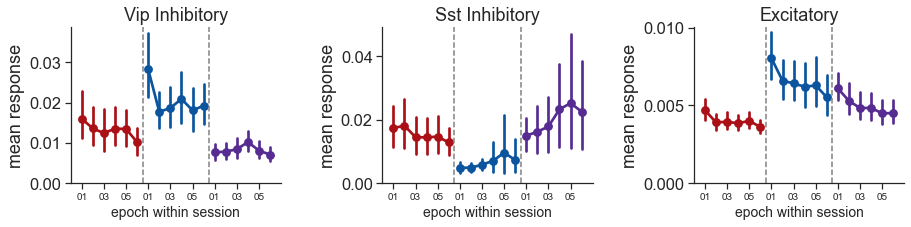

In [399]:
# plot for all cells within each cre line
ppf.plot_mean_response_by_epoch(epoch_mdf, metric='mean_response', horizontal=True, ymin=0, ylabel='mean response', estimator=np.mean,
                                save_dir=None, folder='epochs', max_epoch=6, suptitle=None, suffix='', ax=None)

In [400]:

def plot_mean_response_by_epoch_overlay(df, metric='mean_response',ymin=0, ymax=None, ylabel='mean response', estimator=np.mean, max_epoch=6,
                                        title='', legend=True, save_dir=None, folder=folder, suffix='', ax=None):
    """
    Plots the mean metric value across epochs within a session, colored by experience level
    :param df: dataframe of cell activity with one row per cell_specimen_id / ophys_experiment_id
                must include columns 'cell_type', 'experience_level', 'epoch', and a column for the metric provided (ex: 'mean_response')
    :param metric: metric value to average over epochs; must be a column of df
    :param save_dir: top level directory to save figure to
    :param folder: folder within save_dir to save figure to; will create folder if it doesnt exist
    :param suffix: string to append at end of saved filename
    :return:
    """

    experience_levels = np.sort(df.experience_level.unique())

    df = df[df.epoch <= max_epoch]
    epochs = np.sort(df.epoch.unique())

    palette = utils.get_experience_level_colors()
    if ax is None:
        figsize = (6, 3.5)
        fig, ax = plt.subplots(figsize=figsize)

    ax = sns.pointplot(data=df, x='epoch', y=metric, hue='experience_level', hue_order=experience_levels,
                                  order=epochs, palette=palette, ax=ax, estimator=estimator)
    if ymin is not None:
        ax.set_ylim(ymin=ymin)
    if ymax is not None: 
        ax.set_ylim(ymax=ymax)
    ax.set_title(title)
    ax.set_ylabel(ylabel)
    ax.set_xlim((epochs[0] - 1, epochs[-1] + 1))
    ax.set_xticks(epochs)
    ax.set_xticklabels(epochs+1)
    ax.set_xlabel('epoch within session')
    if not legend: 
        ax.get_legend().remove()

    
    if save_dir:
        fig_title = metric + suffix
        utils.save_figure(fig, figsize, save_dir, folder, fig_title)
    return ax

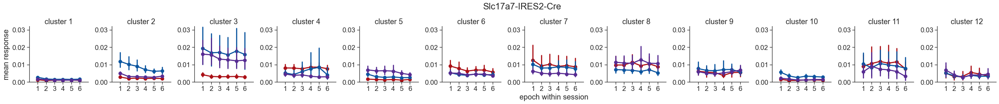

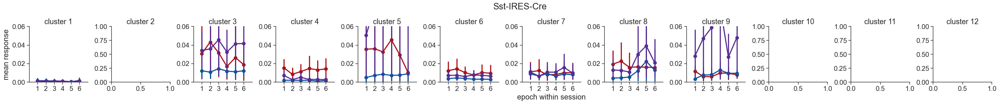

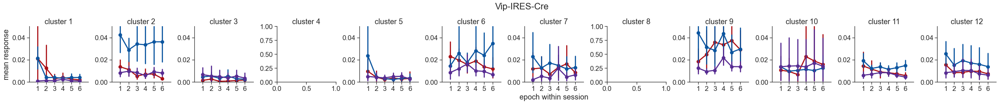

In [401]:
cre_lines = np.sort(epoch_mdf.cre_line.unique())
i = 0
cre_line = cre_lines[i]

cluster_ids = np.sort(epoch_mdf.cluster_id.unique())

for cre_line in cre_lines: 
    if cre_line == 'Slc17a7-IRES2-Cre':
        ymax = 0.032
    elif cre_line == 'Sst-IRES-Cre':
        ymax = 0.06
    elif cre_line == 'Vip-IRES-Cre':
        ymax = 0.05

    figsize=(3.5*len(cluster_ids), 2.5)
    fig, ax = plt.subplots(1, len(cluster_ids), figsize=figsize, sharey=False)
    for i, cluster_id in enumerate(cluster_ids): 
        try: # not all clusters exist in all cre lines
            df = epoch_mdf[(epoch_mdf.cre_line==cre_line) & (epoch_mdf.cluster_id==cluster_id)].copy()

            ax[i] = plot_mean_response_by_epoch_overlay(df, metric='mean_response', ymin=0, ymax=ymax, ylabel='mean response', estimator=np.mean, max_epoch=6,
                                                    title='cluster '+str(cluster_id), legend=False, save_dir=None, folder=folder, suffix='', ax=ax[i])
            ax[i].set_ylabel('')
            ax[i].set_xlabel('')
        except: 
            pass
        ax[i].set_title('cluster '+str(cluster_id))

    ax[0].set_ylabel('mean response')
    ax[int(len(cluster_ids)/2.)].set_xlabel('epoch within session')

    plt.subplots_adjust(wspace=0.4)
    plt.suptitle(cre_line, x=0.52, y=1.2)

### cluster metrics vs. area depth proportion

#### get metrics

In [ ]:
coding_score_metrics = processing.get_cell_metrics(cluster_meta, results_pivoted)
coding_score_metrics.head()

C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1790: RuntimeWarning: invalid value encountered in double_scalars
  exp_mod_persistence = row['Novel >1'] / row['Novel 1'] # make it an index
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1790: RuntimeWarning: divide by zero encountered in double_scalars
  exp_mod_persistence = row['Novel >1'] / row['Novel 1'] # make it an index
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1767: RuntimeWarning: invalid value encountered in double_scalars
  feature_selectivity = (values[0] - (np.mean(values[1:]))) / (values[0] + (np.mean(values[1:])))
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1771: RuntimeWarning: invalid value encountered in double_s

,dominant_feature,dominant_experience_level,next_highest_conditions,max_coding_score,max_image_coding_score,image_coding_Familiar,image_coding_Novel,image_coding_Novel +,feature_selectivity,experience_selectivity,...,layer,area_layer,date,first_novel,n_relative_to_first_novel,last_familiar,last_familiar_active,second_novel,second_novel_active,experience_exposure
cell_specimen_id,,,,,,,,,,,,,,,,,,,,,
1086489847,behavioral,Novel +,"(Novel, all-images)",0.971563,0.017832,0.000000,0.060457,0.017832,0.981199,0.916276,...,upper,VISp_upper,20200129,False,-2.0,False,True,False,False,Familiar > 3
1086489860,all-images,Novel,"(Familiar, omissions)",0.910349,0.910349,0.000000,0.910349,0.000000,0.922958,1.000000,...,upper,VISp_upper,20200129,False,-2.0,False,True,False,False,Familiar > 3
1086489891,behavioral,Novel +,"(Familiar, omissions)",1.000000,0.000000,0.000000,0.279929,0.000000,1.000000,0.837370,...,upper,VISp_upper,20200129,False,-2.0,False,True,False,False,Familiar > 3
1086489976,all-images,Familiar,"(Novel, omissions)",0.817370,0.817370,0.817370,0.000000,0.000000,1.000000,1.000000,...,lower,VISp_lower,20191007,False,-1.0,True,True,False,False,Familiar 3
1086490002,all-images,Familiar,"(Novel, omissions)",0.852927,0.852927,0.852927,0.000000,0.355870,0.983050,0.654784,...,lower,VISp_lower,20191007,False,-1.0,True,True,False,False,Familiar 3


In [ ]:
# cluster_metrics_all_cre = processing.get_cluster_metrics_all_cre(cluster_meta, feature_matrix, results_pivoted)
# cluster_metrics_all_cre.head()

Index(['cluster_id', 'dominant_feature', 'dominant_experience_level',
       'next_highest_conditions', 'max_coding_score', 'max_image_coding_score',
       'image_coding_Familiar', 'image_coding_Novel', 'image_coding_Novel +',
       'feature_selectivity', 'experience_selectivity',
       'experience_modulation', 'exp_mod_direction', 'exp_mod_persistence',
       'feature_sel_within_session', 'feature_sel_across_sessions',
       'fraction_cells', 'F_max', 'N1_max', 'N2_max', 'abs_max'],
      dtype='object')


,cluster_id,dominant_feature,dominant_experience_level,next_highest_conditions,max_coding_score,max_image_coding_score,image_coding_Familiar,image_coding_Novel,image_coding_Novel +,feature_selectivity,...,exp_mod_direction,exp_mod_persistence,feature_sel_within_session,feature_sel_across_sessions,fraction_cells,F_max,N1_max,N2_max,abs_max,n_cells_cluster
0,1,all-images,Familiar,"(Novel +, task)",0.008245,0.008245,0.008245,0.003125,0.003918,0.309183,...,-0.450314,1.253950,0.048044,0.057148,0.202256,0.008245,0.006699,0.007353,0.008245,789
1,2,all-images,Novel,"(Novel +, task)",0.885535,0.885535,0.026374,0.885535,0.090434,0.922669,...,0.942157,0.102123,0.903212,0.948598,0.172520,0.026374,0.885535,0.090434,0.885535,673
2,3,all-images,Novel,"(Novel +, task)",0.787501,0.787501,0.080408,0.787501,0.772291,0.922338,...,0.814709,0.980686,0.893442,0.912121,0.103563,0.080408,0.787501,0.772291,0.787501,404
3,4,all-images,Familiar,"(Novel +, task)",0.912700,0.912700,0.912700,0.063783,0.062232,0.934836,...,-0.869362,0.975686,0.913996,0.950799,0.091259,0.912700,0.063783,0.062232,0.912700,356
4,5,all-images,Novel +,"(Novel, task)",0.899775,0.899775,0.027436,0.098206,0.899775,0.938404,...,0.563265,9.162099,0.920379,0.953239,0.084081,0.027436,0.098206,0.899775,0.899775,328


In [ ]:
# for each cre
cluster_metrics = processing.get_cluster_metrics(cluster_meta, feature_matrix, results_pivoted)
cluster_metrics.head()

C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1790: RuntimeWarning: invalid value encountered in double_scalars
  exp_mod_persistence = row['Novel >1'] / row['Novel 1'] # make it an index
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1790: RuntimeWarning: divide by zero encountered in double_scalars
  exp_mod_persistence = row['Novel >1'] / row['Novel 1'] # make it an index
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1767: RuntimeWarning: invalid value encountered in double_scalars
  feature_selectivity = (values[0] - (np.mean(values[1:]))) / (values[0] + (np.mean(values[1:])))
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1771: RuntimeWarning: invalid value encountered in double_s

dominant_feature dominant_experience_level  \
cre_line          cluster_id                                              
Slc17a7-IRES2-Cre 1                      task                   Novel +   
                  2                all-images                     Novel   
                  3                all-images                     Novel   
                  4                all-images                  Familiar   
                  5                all-images                   Novel +   

                             next_highest_conditions  max_coding_score  \
cre_line          cluster_id                                             
Slc17a7-IRES2-Cre 1               (Novel, omissions)          0.007872   
                  2                  (Novel +, task)          0.899068   
                  3                  (Novel +, task)          0.790757   
                  4                  (Novel +, task)          0.916090   
                  5                    (Novel, task)          0.902526   

                              max_image_coding_score  image_coding_Familiar  \
cre_line          cluster_id                                                  
Slc17a7-IRES2-Cre 1                         0.003056               0.006467   
                  2                         0.899068               0.026190   
                  3                         0.790757               0.074130   
                  4                         0.916090               0.916090   
                  5                         0.902526               0.024844   

                              image_coding_Novel  image_coding_Novel +  \
cre_line          cluster_id                                             
Slc17a7-IRES2-Cre 1                     0.002046              0.003056   
                  2                     0.899068              0.092013   
                  3                     0.790757              0.773776   
                  4                     0.065449              0.055535   
                  5                     0.095617              0.902526   

                              feature_selectivity  experience_selectivity  \
cre_line          cluster_id                                                
Slc17a7-IRES2-Cre 1                      0.453154                0.328261   
                  2                      0.932713                0.876637   
                  3                      0.923915                0.301968   
                  4                      0.936667                0.876115   
                  5                      0.939104                0.874879   

                              ...  exp_mod_direction  exp_mod_persistence  \
cre_line          cluster_id  ...                                           
Slc17a7-IRES2-Cre 1           ...           0.526326             1.295495   
                  2           ...           0.943390             0.102343   
                  3           ...           0.828579             0.978525   
                  4           ...          -0.866640             0.848519   
                  5           ...           0.587523             9.438923   

                              feature_sel_within_session  \
cre_line          cluster_id                               
Slc17a7-IRES2-Cre 1                             0.413906   
                  2                             0.908952   
                  3                             0.895087   
                  4                             0.917703   
                  5                             0.919207   

                              feature_sel_across_sessions  fraction_cre  \
cre_line          cluster_id                                              
Slc17a7-IRES2-Cre 1                              0.081820      0.218921   
                  2                              0.948108      0.185264   
                  3                              0.911192      0.114312   
                  4                

#### link cluster metrics to area depth

In [ ]:
def add_layer_index_to_cluster_metrics(cluster_metrics, n_cells_table): 
    '''
    computes fraction cells upper vs lower over sum from n_cells table then appends that value 
    to the cluster_metrics table as 'layer_index'

    n_cells_table: dataframe with cre line, cluter ID and layer as indices, columns for fraction cells in that layer, etc
    cluster_metrics: dataframe with cre line & cluster ID as indices, columns for various metrics computed on cluster

    '''

    layer_index = n_cells_table[['fraction_cells_location']].unstack()
    layer_index.columns = layer_index.columns.droplevel(0)
    layer_index['layer_index'] = (layer_index.upper-layer_index.lower)/(layer_index.upper+layer_index.lower)
    layer_index = layer_index.merge(n_cells_table[['bh_significant', 'significant']], on=['cre_line', 'cluster_id'])
    layer_index = layer_index.reset_index().drop_duplicates(subset=['cre_line', 'cluster_id']).set_index(['cre_line', 'cluster_id'])
    
    data = cluster_metrics.merge(layer_index, on=['cre_line', 'cluster_id'])
    fraction = n_cells_table[['fraction_cells_cluster']].reset_index().drop_duplicates(subset=['cre_line', 'cluster_id'])
    cluster_metrics = cluster_metrics.merge(fraction, on=['cre_line', 'cluster_id']).set_index(['cre_line', 'cluster_id'])

    return cluster_metrics


lower     upper  layer_index bh_significant  \
cre_line          cluster_id                                                   
Slc17a7-IRES2-Cre 1           0.130435  0.333798     0.438063           True   
                  2           0.165862  0.210453     0.118495           True   
                  3           0.110574  0.119164     0.037388          False   
                  4           0.119699  0.062718    -0.312370           True   
                  5           0.095545  0.091986    -0.018977          False   

                             significant  
cre_line          cluster_id              
Slc17a7-IRES2-Cre 1                 True  
                  2                 True  
                  3                False  
                  4                 True  
                  5                False

In [ ]:

# cluster_metrics = processing.get_cluster_metrics(cluster_meta, feature_matrix, results_pivoted)
# cluster_metrics.head()

location = 'layer'
order = ['upper', 'lower']
n_cells_table = processing.get_cluster_proportion_stats_for_locations(cluster_meta, location=location)

n_cells_table.head()                                                              
cluster_metrics = processing.add_layer_index_to_cluster_metrics(cluster_metrics, n_cells_table)
cluster_metrics.head()

dominant_feature dominant_experience_level  \
cre_line          cluster_id                                              
Slc17a7-IRES2-Cre 1                      task                   Novel +   
                  2                all-images                     Novel   
                  3                all-images                     Novel   
                  4                all-images                  Familiar   
                  5                all-images                   Novel +   

                             next_highest_conditions  max_coding_score  \
cre_line          cluster_id                                             
Slc17a7-IRES2-Cre 1               (Novel, omissions)          0.007872   
                  2                  (Novel +, task)          0.899068   
                  3                  (Novel +, task)          0.790757   
                  4                  (Novel +, task)          0.916090   
                  5                    (Novel, task)          0.902526   

                              max_image_coding_score  image_coding_Familiar  \
cre_line          cluster_id                                                  
Slc17a7-IRES2-Cre 1                         0.003056               0.006467   
                  2                         0.899068               0.026190   
                  3                         0.790757               0.074130   
                  4                         0.916090               0.916090   
                  5                         0.902526               0.024844   

                              image_coding_Novel  image_coding_Novel +  \
cre_line          cluster_id                                             
Slc17a7-IRES2-Cre 1                     0.002046              0.003056   
                  2                     0.899068              0.092013   
                  3                     0.790757              0.773776   
                  4                     0.065449              0.055535   
                  5                     0.095617              0.902526   

                              feature_selectivity  experience_selectivity  \
cre_line          cluster_id                                                
Slc17a7-IRES2-Cre 1                      0.453154                0.328261   
                  2                      0.932713                0.876637   
                  3                      0.923915                0.301968   
                  4                      0.936667                0.876115   
                  5                      0.939104                0.874879   

                              ...    N2_max   abs_max  n_cells_cluster  \
cre_line          cluster_id  ...                                        
Slc17a7-IRES2-Cre 1           ...  0.007872  0.007872              722   
                  2           ...  0.092013  0.899068              611   
                  3           ...  0.773776  0.790757              377   
                  4           ...  0.055535  0.916090              313   
                  5           ...  0.902526  0.902526              310   

                                 lower     upper  layer_index  bh_significant  \
cre_line          cluster_id                                                    
Slc17a7-IRES2-Cre 1           0.130435  0.333798     0.438063            True   
                  2           0.165862  0.210453     0.118495            True   
                  3           0.110574  0.119164     0.037388           False   
                  4           0.119699  0.062718    -0.312370            True   
                  5           0.095545  0.091986    -0.018977           False   

                              significant  layer  fraction_cells_cluster  
cre_line          cluster_id                                              
Slc17a7-IRES2-Cre 1                  True  lower                0.218921  
                  2                  True  lower           

In [ ]:
def plot_cluster_metric_comparison_scatterplot(cluster_metrics, cluster_meta, x='layer_index', y='exp_mod_direction', 
                                                    hue='cre_line', save_dir=None, folder=None): 
    ''' 
        Plot a scatterplot showing comparison of two metric values for each cre line / cluster combination
        x & y must be columns in cluster_metrics table
        cluster_metrics should have one row for each cre line / cluster ID, with cre/clusterID is indices, 
        with columns for various metrics computed at the cluster level
        hue is typically 'cre_line' but could be another categorical variable / metadata value in cluster_metrics
        size will be set to 'fraction_cells_cluster', which should be a column in cluster_metrics
    '''

    if 'layer_index' not in cluster_metrics.columns: 
        # get experience modulation & other metrics computed on average coding scores for each cluster
        # compute area/depth distributions
        location = 'layer'
        n_cells_table = processing.get_cluster_proportion_stats_for_locations(cluster_meta, location=location)
        # add layer index metric (upper-lower/sum)
        cluster_metrics = processing.add_layer_index_to_cluster_metrics(cluster_metrics, n_cells_table)

    cluster_metrics = cluster_metrics.reset_index() # reset so cre & cluster ID can be used in plot
    hue_order = np.sort(cluster_metrics[hue].unique())
    size='fraction_cells_cluster'

    figsize = (3,3)
    fig, ax = plt.subplots(figsize=figsize)
    ax = sns.scatterplot(data=data, x=x, y=y, hue=hue, hue_order=hue_order, palette=cre_line_colors,
                        size=size, sizes=(1,250), alpha=0.8,  linewidth=2, ax=ax)
    ax.set_ylim(-1,1)
    ax.set_xlim(-1,1)
    ax.legend(bbox_to_anchor=(1,1), fontsize='x-small')#labels=[utils.get_abbreviated_cell_type(cre_line) for cre_line in cre_lines])
    if x == 'layer_index':
        ax.set_xlabel('<- Lower --- Upper ->')
    if y == 'exp_mod_direction': 
        ax.set_ylabel('<- Familiar --- Novel ->')

    for index in data.index.values:  
        cluster_id = index[1]
        x_pos = data.loc[index, x]
        y_pos = data.loc[index, y]
        ax.text(x=x_pos, y=y_pos, s=str(cluster_id), fontsize=12, color='gray', ha='left', va='bottom')

    if save_dir: 
        filename = x +'_'+ y +'_scatterplot_for_' + hue
        utils.save_figure(fig, figsize, save_dir, folder, filename)

In [ ]:
layer_index = n_cells_table[['fraction_cells_location']].unstack()
layer_index.columns = layer_index.columns.droplevel(0)
layer_index['layer_index'] = (layer_index.upper - layer_index.lower) / (layer_index.upper + layer_index.lower)
layer_index = layer_index.merge(n_cells_table[['bh_significant', 'significant']], on=['cre_line', 'cluster_id'])
layer_index = layer_index.reset_index().drop_duplicates(subset=['cre_line', 'cluster_id']).set_index(
    ['cre_line', 'cluster_id'])

data = cluster_metrics.merge(layer_index[['layer_index']], on=['cre_line', 'cluster_id'])
fraction = n_cells_table[['fraction_cells_cluster']].reset_index().drop_duplicates(
    subset=['cre_line', 'cluster_id'])
data = data.merge(fraction, on=['cre_line', 'cluster_id']).set_index(
    ['cre_line', 'cluster_id'])
data = data.drop(columns=['layer'])

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


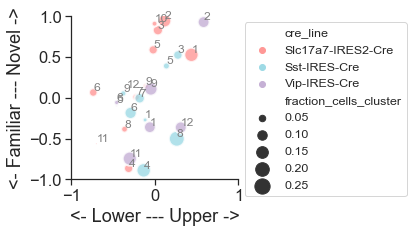

In [ ]:
x = 'layer_index' # upper-lower / sum
y = 'exp_mod_direction' # novel-familiar / sum
hue = 'cre_line'

plotting.plot_cluster_metric_comparison_scatterplot(cluster_metrics, cluster_meta, x=x, y=y, hue=hue, save_dir=save_dir, folder=folder)


#### proportion of cells in each cre line preferring each feature & exp level (should be in fig 3)

In [ ]:
coding_score_metrics.keys()

Index(['dominant_feature', 'dominant_experience_level',
       'next_highest_conditions', 'max_coding_score', 'max_image_coding_score',
       'image_coding_Familiar', 'image_coding_Novel', 'image_coding_Novel +',
       'feature_selectivity', 'experience_selectivity',
       'experience_modulation', 'exp_mod_direction', 'exp_mod_persistence',
       'feature_sel_within_session', 'feature_sel_across_sessions',
       'ophys_experiment_id', 'cre_line', 'cluster_id', 'labels',
       'within_cluster_correlation_p', 'equipment_name', 'full_genotype',
       'mouse_id', 'reporter_line', 'driver_line', 'sex', 'age_in_days',
       'indicator', 'session_number', 'prior_exposures_to_session_type',
       'prior_exposures_to_image_set', 'prior_exposures_to_omissions',
       'ophys_session_id', 'behavior_session_id', 'ophys_container_id',
       'project_code', 'imaging_depth', 'targeted_structure',
       'date_of_acquisition', 'session_type', 'experience_level', 'passive',
       'image_set'

In [ ]:

def get_fraction_cells_for_column(coding_score_metrics, column_to_group = 'dominant_feature'):
    n_cells = coding_score_metrics.reset_index().groupby(['cre_line', column_to_group]).count()[['cell_specimen_id']].rename(columns={'cell_specimen_id': 'n_cells'})
    total_cells = coding_score_metrics.reset_index().groupby(['cre_line']).count()[['cell_specimen_id']].rename(columns={'cell_specimen_id': 'total_cells'})
    fraction_cells = n_cells.reset_index().merge(total_cells, on='cre_line', how='left')
    fraction_cells['fraction'] = fraction_cells.n_cells/fraction_cells.total_cells
    return fraction_cells

In [ ]:
def plot_fraction_cells_distribution(coding_score_metrics, metric, palette=None, title='', legend=False, ax=None):
    '''   
    plot barplot of fraction cells belonging to each category in metric column 
    coding_score_metrics must be dataframe with cells as rows with various metadata columns
    metric must be a column in coding_score_metrics that contains a categorical variable to group cells by
    '''
    fraction_cells = get_fraction_cells_for_column(coding_score_metrics, column_to_group=metric)
    hue_order = fraction_cells[metric].unique()
    if palette is None: 
        palette = sns.color_palette()
    if ax is None:
        figsize = (3,2.5)
        fig, ax = plt.subplots(figsize=figsize)
    ax = sns.histplot(fraction_cells, y='cre_line', hue=metric, hue_order=hue_order, weights='fraction',  
                multiple='stack', palette=palette, shrink=0.8, alpha=0.8)
    ax.set_yticklabels([utils.get_abbreviated_cell_type(cre_line) for cre_line in cre_lines])
    ax.set_ylabel('')
    ax.set_xlabel('fraction of cells')
    ax.set_title(title)
    # ax.legend(hue_order, bbox_to_anchor=(1,1),  title='', fontsize='x-small')
    if legend == False: 
        ax.get_legend().remove()


C:\Users\marinag\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  


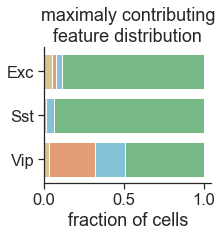

In [ ]:
metric = 'dominant_feature'
c = sns.color_palette()
palette = [c[2], c[9], c[1], c[8]]
title = 'maximaly contributing\nfeature distribution'
plotting.plot_fraction_cells_distribution_stacked_barplot(coding_score_metrics, metric, palette, title, legend=False, ax=None)


C:\Users\marinag\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  


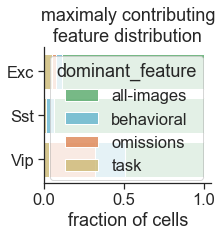

In [ ]:
metric = 'dominant_feature'
c = sns.color_palette()
palette = [c[2], c[9], c[1], c[8]]
title = 'maximaly contributing\nfeature distribution'
plotting.plot_fraction_cells_distribution_stacked_barplot(coding_score_metrics, metric, palette, title, legend=True, ax=None)


In [ ]:
column_to_group = 'dominant_experience_level'
n_cells = coding_score_metrics.reset_index().groupby(['cre_line', column_to_group]).count()[['cell_specimen_id']].rename(columns={'cell_specimen_id': 'n_cells'})
total_cells = coding_score_metrics.reset_index().groupby(['cre_line']).count()[['cell_specimen_id']].rename(columns={'cell_specimen_id': 'total_cells'})
fraction_cells = n_cells.reset_index().merge(total_cells, on='cre_line', how='left')
fraction_cells['fraction'] = fraction_cells.n_cells/fraction_cells.total_cells
fraction_cells

,cre_line,dominant_experience_level,n_cells,total_cells,fraction
0,Slc17a7-IRES2-Cre,Familiar,1294,3298,0.392359
1,Slc17a7-IRES2-Cre,Novel,1216,3298,0.368708
2,Slc17a7-IRES2-Cre,Novel +,788,3298,0.238933
3,Sst-IRES-Cre,Familiar,100,194,0.515464
4,Sst-IRES-Cre,Novel,29,194,0.149485
5,Sst-IRES-Cre,Novel +,65,194,0.335052
6,Vip-IRES-Cre,Familiar,152,409,0.371638
7,Vip-IRES-Cre,Novel,165,409,0.403423
8,Vip-IRES-Cre,Novel +,92,409,0.224939


C:\Users\marinag\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  


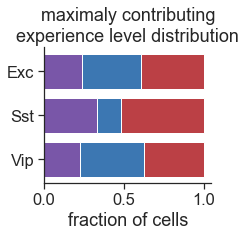

In [ ]:
metric = 'dominant_experience_level'
palette = experience_level_colors
title = 'maximaly contributing\nexperience level distribution'
plotting.plot_fraction_cells_distribution_stacked_barplot(coding_score_metrics, metric, palette, title, legend=False, ax=None)


C:\Users\marinag\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:16: UserWarning: FixedFormatter should only be used together with FixedLocator
  


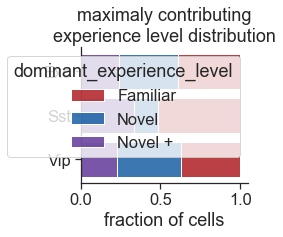

In [ ]:
metric = 'dominant_experience_level'
palette = experience_level_colors
title = 'maximaly contributing\nexperience level distribution'
plotting.plot_fraction_cells_distribution_stacked_barplot(coding_score_metrics, metric, palette, title, legend=True, ax=None)


### split by cre line and plot heatmaps

C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\plotting.py:163: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cluster_meta_cre.cluster_id.values]


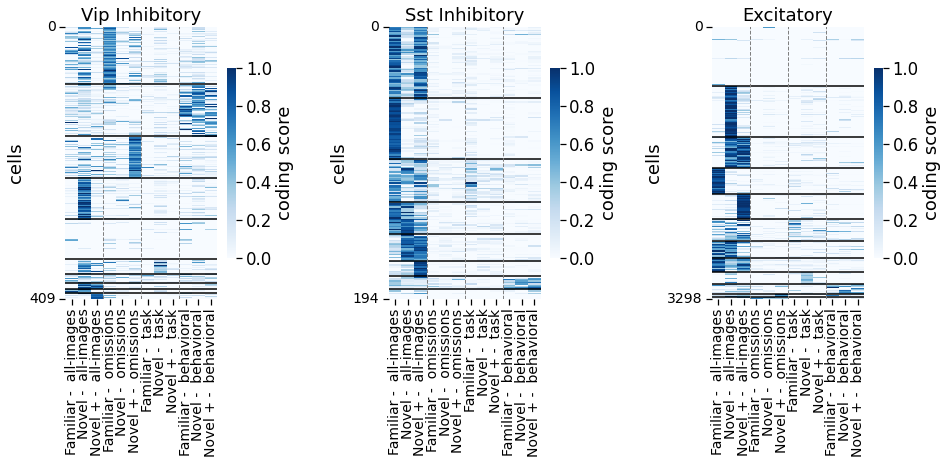

In [ ]:
plotting.plot_feature_matrix_sorted(feature_matrix, cluster_meta, sort_col='cluster_id', resort_by_size=True, save_dir=None, folder=folder)


C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\plotting.py:161: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cluster_size_order = cluster_meta_cre['cluster_id'].value_counts().index.values


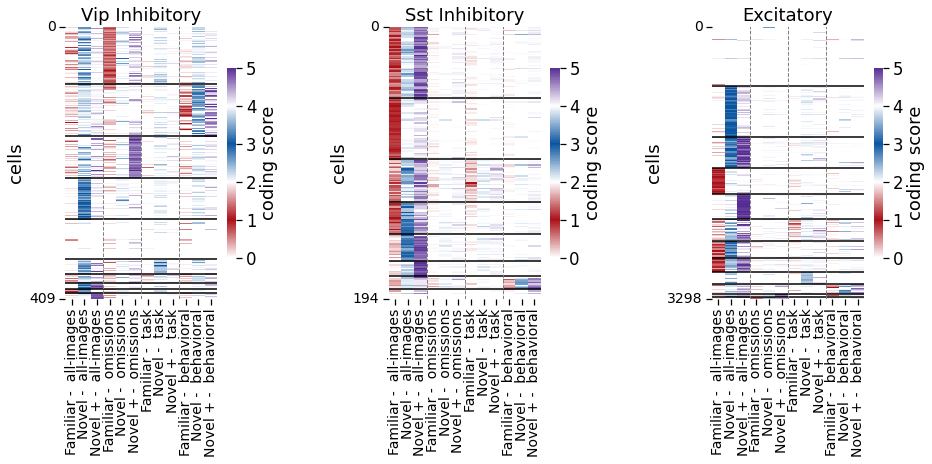

In [ ]:
# plot feature matrix sorted by cluster ID
feature_matrix_remapped, remapped_cmap, vmax = remap_coding_scores_to_session_colors(feature_matrix)

plotting.plot_feature_matrix_sorted(feature_matrix_remapped, cluster_meta, sort_col='cluster_id', resort_by_size=True,
                                    cmap=remapped_cmap, vmax=vmax, save_dir=None, folder=folder)

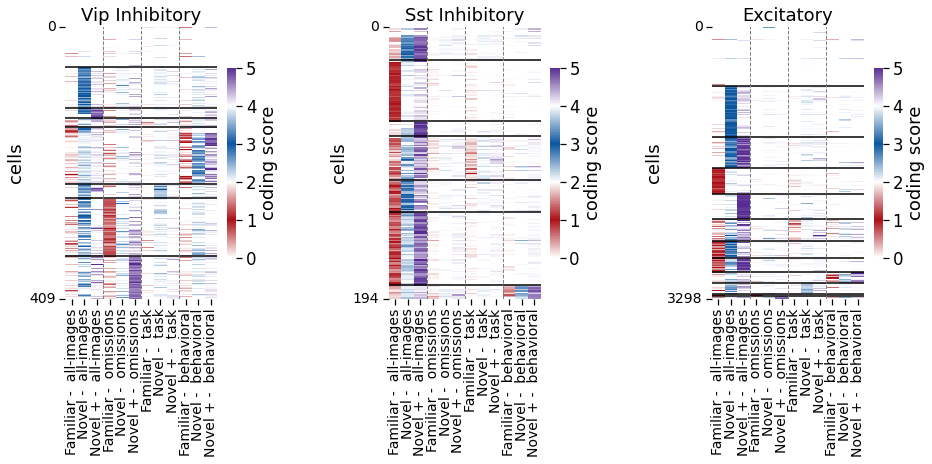

In [ ]:
# plot feature matrix sorted by cluster ID
# plot feature matrix sorted by cluster ID
feature_matrix_remapped, remapped_cmap, vmax = remap_coding_scores_to_session_colors(feature_matrix)

plotting.plot_feature_matrix_sorted(feature_matrix_remapped, cluster_meta, sort_col='cluster_id', resort_by_size=False,
                                    cmap=remapped_cmap, vmax=vmax, save_dir=None, folder=folder)

### average dropouts per cluster - updated colors

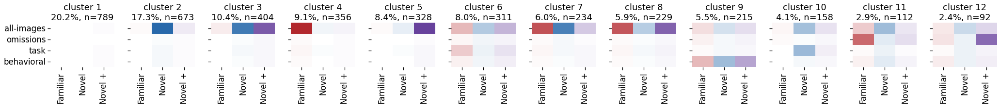

In [ ]:
# plot clusters in order of sort_col
clusters = np.sort(cluster_meta['cluster_id'].unique())
n_clusters_to_plot = len(clusters)


feature_matrix_remapped, remapped_cmap, vmax = remap_coding_scores_to_session_colors(feature_matrix)


figsize = (35, 1.7)
fig, ax = plt.subplots(1, n_clusters_to_plot, figsize=figsize, sharex=True, sharey=True)
ax = ax.ravel()

  
# loop through clusters in sorted order
for i, cluster_id in enumerate(clusters):
    this_cluster_csids = cluster_meta[cluster_meta.cluster_id==cluster_id].index.values
    mean_dropout_df = feature_matrix_remapped.loc[this_cluster_csids].mean().unstack()
    ax[i] = sns.heatmap(mean_dropout_df, cmap=remapped_cmap, vmin=0, vmax=vmax, ax=ax[i], cbar=False, cbar_kws={'label': 'coding score'})
    # fraction is number of cells in this cluster vs all cells in this cre line
    fraction_cluster = len(this_cluster_csids) / float(len(cluster_meta))
    fraction = np.round(fraction_cluster * 100, 1)
    # set title and labels
    ax[i].set_title('cluster ' + str(cluster_id) + '\n' + str(fraction) + '%, n=' + str(len(this_cluster_csids)))
    ax[i].set_xlabel('')
    
plt.subplots_adjust(hspace=0.6, wspace=0.25)
if save_dir:
    utils.save_figure(fig, figsize, save_dir, folder,
                      'mean_cluster_heatmaps_remapped_'+str(n_clusters))

#### averages per cre line 

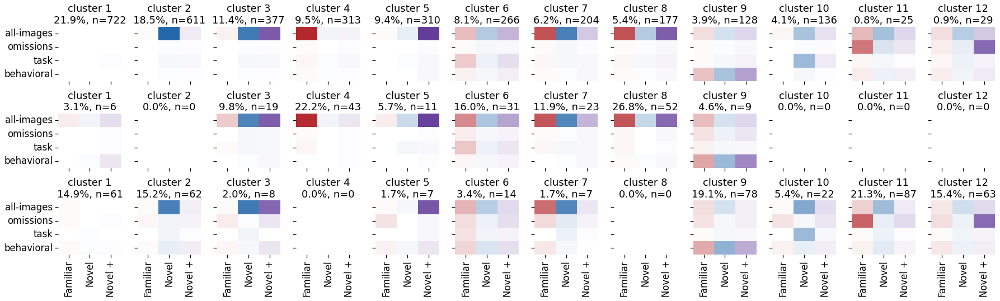

In [ ]:
# all cre lines on one plot

feature_matrix_remapped, remapped_cmap, vmax = remap_coding_scores_to_session_colors(feature_matrix)

clusters = np.sort(cluster_meta['cluster_id'].unique())
n_clusters = len(clusters)

figsize = (2.5*n_clusters, 2.5*3)
fig, ax = plt.subplots(3, n_clusters, figsize=figsize, sharex=True, sharey=True)
ax = ax.ravel()

i=0
for c, cre_line in enumerate(np.sort(cluster_meta.cre_line.unique())):
    cre_cluster_meta = cluster_meta[cluster_meta.cre_line==cre_line].copy()

    # loop through clusters in sorted order
    for x, cluster_id in enumerate(clusters):
        try:
            this_cluster_csids = cre_cluster_meta[cre_cluster_meta.cluster_id==cluster_id].index.values
            mean_dropout_df = feature_matrix_remapped.loc[this_cluster_csids].mean().unstack()
            ax[i] = sns.heatmap(mean_dropout_df, cmap=remapped_cmap, vmin=0, vmax=vmax, ax=ax[i], cbar=False, cbar_kws={'label': 'coding score'})
            # fraction is number of cells in this cluster vs all cells in this cre line
            fraction_cluster = len(this_cluster_csids) / float(len(cre_cluster_meta))
            fraction = np.round(fraction_cluster * 100, 1)
            # set title and labels
            ax[i].set_title('cluster ' + str(cluster_id) + '\n' + str(fraction) + '%, n=' + str(len(this_cluster_csids)))
            ax[i].set_xlabel('')
        except:
            pass
        i+=1
        
    plt.subplots_adjust(hspace=0.6, wspace=0.25)
    # plt.suptitle(cre_line, x=0.46, y=1.)
    if save_dir:
        utils.save_figure(fig, figsize, save_dir, folder,
                      'mean_cluster_heatmaps_remapped')

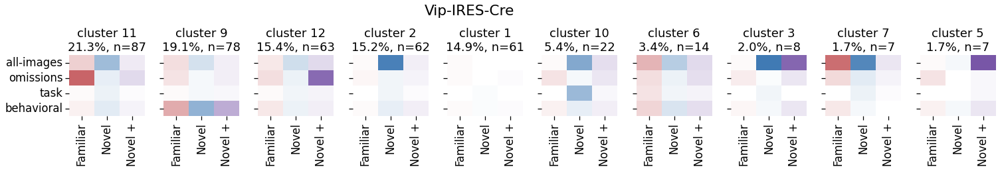

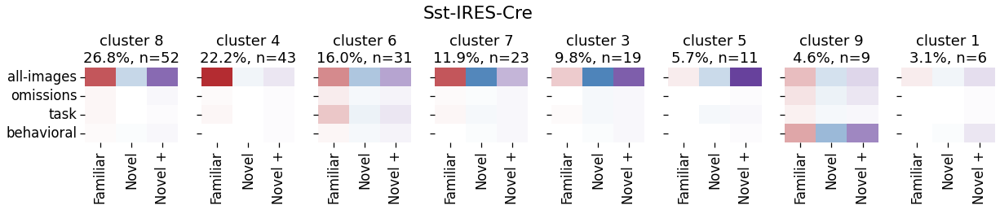

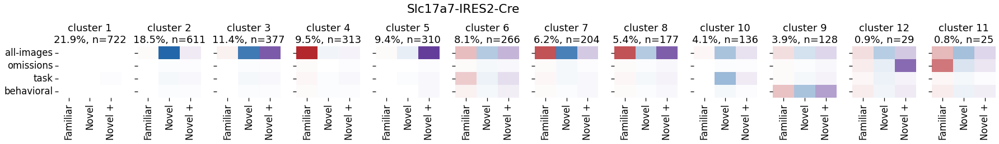

In [ ]:
# plot and sort each cre line separately

feature_matrix_remapped, remapped_cmap, vmax = remap_coding_scores_to_session_colors(feature_matrix)


for cre_line in cluster_meta.cre_line.unique():
    cre_cluster_meta = cluster_meta[cluster_meta.cre_line==cre_line].copy()
    # clusters = np.sort(cre_cluster_meta['cluster_id'].unique())
    # sort by cluster size
    clusters = cre_cluster_meta['cluster_id'].value_counts().index.values
    n_clusters_to_plot = len(clusters)

    figsize = (2.5*n_clusters_to_plot, 1.7)
    fig, ax = plt.subplots(1, n_clusters_to_plot, figsize=figsize, sharex=True, sharey=True)
    ax = ax.ravel()

    
    # loop through clusters in sorted order
    for i, cluster_id in enumerate(clusters):
        this_cluster_csids = cre_cluster_meta[cre_cluster_meta.cluster_id==cluster_id].index.values
        mean_dropout_df = feature_matrix_remapped.loc[this_cluster_csids].mean().unstack()
        ax[i] = sns.heatmap(mean_dropout_df, cmap=remapped_cmap, vmin=0, vmax=vmax, ax=ax[i], cbar=False, cbar_kws={'label': 'coding score'})
        # fraction is number of cells in this cluster vs all cells in this cre line
        fraction_cluster = len(this_cluster_csids) / float(len(cre_cluster_meta))
        fraction = np.round(fraction_cluster * 100, 1)
        # set title and labels
        ax[i].set_title('cluster ' + str(cluster_id) + '\n' + str(fraction) + '%, n=' + str(len(this_cluster_csids)))
        ax[i].set_xlabel('')
        
    plt.subplots_adjust(hspace=0.6, wspace=0.25)
    plt.suptitle(cre_line, x=0.46, y=1.5)
    if save_dir:
        utils.save_figure(fig, figsize, save_dir, folder,
                      'mean_cluster_heatmaps_remapped_'+cre_line.split('-')[0])

#### sort by cluster size within cre, exclude clusters with <10% cells

In [ ]:
cluster_metrics_per_cre = processing.get_cluster_metrics(cluster_meta, feature_matrix, results_pivoted)
cluster_metrics_per_cre[(cluster_metrics_per_cre.cre_line==cre_line)&(cluster_metrics_per_cre.n_cells_cluster>10)]

['Familiar' 'Novel' 'Novel +']
Index(['cluster_id', 'dominant_feature', 'dominant_experience_level',
       'next_highest_conditions', 'feature_selectivity',
       'experience_selectivity', 'experience_modulation', 'exp_mod_direction',
       'exp_mod_persistence', 'feature_sel_within_session',
       'feature_sel_across_sessions', 'fraction_cre', 'cre_line', 'F_max',
       'N1_max', 'N2_max', 'abs_max'],
      dtype='object')


,cluster_id,dominant_feature,dominant_experience_level,next_highest_conditions,feature_selectivity,experience_selectivity,experience_modulation,exp_mod_direction,exp_mod_persistence,feature_sel_within_session,feature_sel_across_sessions,fraction_cre,cre_line,F_max,N1_max,N2_max,abs_max,n_cells_cluster
0,1,all-images,Familiar,"(Novel +, task)",0.309183,0.401407,-0.321158,-0.450314,0.112669,0.048044,0.057148,0.202256,Slc17a7-IRES2-Cre,0.008245,0.006699,0.007353,0.008245,722
1,2,all-images,Novel,"(Novel +, task)",0.922669,0.876256,0.876256,0.942157,-0.814679,0.903212,0.948598,0.172520,Slc17a7-IRES2-Cre,0.026374,0.885535,0.090434,0.885535,611
2,3,all-images,Novel,"(Novel +, task)",0.922338,0.297526,0.297526,0.814709,-0.009751,0.893442,0.912121,0.103563,Slc17a7-IRES2-Cre,0.080408,0.787501,0.772291,0.787501,377
3,4,all-images,Familiar,"(Novel +, task)",0.934836,0.870847,-0.768587,-0.869362,-0.012306,0.913996,0.950799,0.091259,Slc17a7-IRES2-Cre,0.912700,0.063783,0.062232,0.912700,313
4,5,all-images,Novel +,"(Novel, task)",0.938404,0.869475,-0.650395,0.563265,0.803190,0.920379,0.953239,0.084081,Slc17a7-IRES2-Cre,0.027436,0.098206,0.899775,0.899775,310
5,6,all-images,Novel +,"(Familiar, task)",0.612600,0.059930,-0.011936,0.025975,0.047145,0.430699,0.211512,0.079723,Slc17a7-IRES2-Cre,0.304873,0.321134,0.352912,0.352912,266
6,7,all-images,Novel,"(Familiar, task)",0.902890,0.203651,0.203651,0.008134,-0.493250,0.875373,0.859104,0.059985,Slc17a7-IRES2-Cre,0.725841,0.737746,0.250362,0.737746,204
7,8,all-images,Novel +,"(Familiar, task)",0.900313,0.182395,-0.415136,-0.409822,0.420356,0.867179,0.892109,0.058703,Slc17a7-IRES2-Cre,0.722273,0.302357,0.740893,0.740893,177
8,9,behavioral,Novel +,"(Novel, all-images)",0.689675,0.090406,0.039704,0.123465,0.032433,0.486216,0.408422,0.055114,Slc17a7-IRES2-Cre,0.308668,0.395623,0.422146,0.422146,128
9,10,task,Novel,"(Novel +, all-images)",0.476149,0.786964,0.786964,0.917674,-0.672935,0.051055,0.518920,0.040502,Slc17a7-IRES2-Cre,0.044669,0.407519,0.129072,0.407519,136


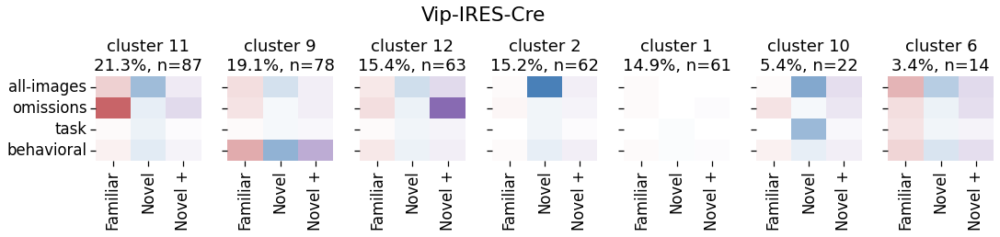

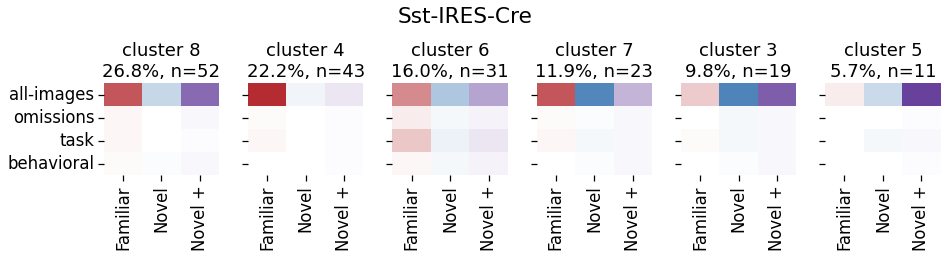

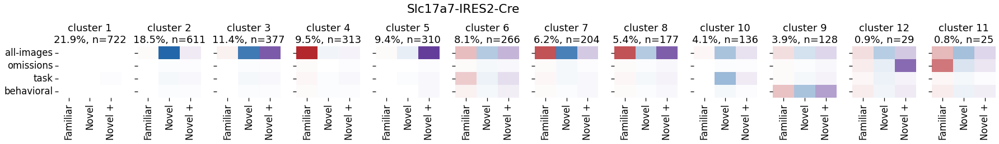

In [ ]:
# plot clusters in order of sort_col

feature_matrix_remapped, remapped_cmap, vmax = remap_coding_scores_to_session_colors(feature_matrix)


for cre_line in cluster_meta.cre_line.unique():
    cre_cluster_meta = cluster_meta[cluster_meta.cre_line==cre_line].copy()

    clusters_to_include = cluster_metrics_per_cre[(cluster_metrics_per_cre.cre_line==cre_line)&(cluster_metrics_per_cre.n_cells_cluster>10)].cluster_id.unique()
    clusters = cre_cluster_meta[cre_cluster_meta.cluster_id.isin(clusters_to_include)]['cluster_id'].value_counts().index.values    
    n_clusters_to_plot = len(clusters)

    figsize = (2.5*n_clusters_to_plot, 1.7)
    fig, ax = plt.subplots(1, n_clusters_to_plot, figsize=figsize, sharex=True, sharey=True)
    ax = ax.ravel()

    
    # loop through clusters in sorted order
    for i, cluster_id in enumerate(clusters):
        this_cluster_csids = cre_cluster_meta[cre_cluster_meta.cluster_id==cluster_id].index.values
        mean_dropout_df = feature_matrix_remapped.loc[this_cluster_csids].mean().unstack()
        ax[i] = sns.heatmap(mean_dropout_df, cmap=remapped_cmap, vmin=0, vmax=vmax, ax=ax[i], cbar=False, cbar_kws={'label': 'coding score'})
        # fraction is number of cells in this cluster vs all cells in this cre line
        fraction_cluster = len(this_cluster_csids) / float(len(cre_cluster_meta))
        fraction = np.round(fraction_cluster * 100, 1)
        # set title and labels
        ax[i].set_title('cluster ' + str(cluster_id) + '\n' + str(fraction) + '%, n=' + str(len(this_cluster_csids)))
        ax[i].set_xlabel('')
        
    plt.subplots_adjust(hspace=0.6, wspace=0.25)
    plt.suptitle(cre_line, x=0.46, y=1.5)
    if save_dir:
        utils.save_figure(fig, figsize, save_dir, folder,
                      'mean_cluster_heatmaps_remapped_sorted_'+cre_line.split('-')[0])

In [ ]:
# plotting.plot_dropout_heatmaps_for_clusters(cluster_meta, feature_matrix, sort_col='cluster_id', 
#                                             save_dir=save_dir, folder=folder)

In [ ]:
# # plot each separately
# clusters = np.sort(cluster_meta['cluster_id'].unique())
# n_clusters_to_plot = len(clusters)

# abbreviate_features = True
# abbreviate_experience = True

# # loop through clusters and plot each one with abbreviated labels
# for i, cluster_id in enumerate(clusters):
#     figsize=(2,1.7)
#     fig, ax = plt.subplots(figsize=figsize)
#     this_cluster_csids = cluster_meta[cluster_meta.cluster_id==cluster_id].index.values
#     mean_dropout_df = feature_matrix.loc[this_cluster_csids].mean().unstack()
#     ax = sns.heatmap(mean_dropout_df, cmap='Blues', vmin=0, vmax=1, ax=ax, cbar=False, cbar_kws={'label': 'coding score'})
#     # fraction is number of cells in this cluster vs all cells in this cre line
#     fraction_cluster = len(this_cluster_csids) / float(len(cluster_meta))
#     fraction = np.round(fraction_cluster * 100, 1)
#     # set title and labels
#     ax.set_title('cluster ' + str(cluster_id))
# #     ax.set_title('cluster ' + str(cluster_id) + '\n' + str(fraction) + '%, n=' + str(len(this_cluster_csids)))
#     ax.set_xlabel('')
#     if abbreviate_features:
#         # set yticks to abbreviated feature labels
#         feature_abbreviations = plotting.get_abbreviated_features(mean_dropout_df.index.values)
#         ax.set_yticklabels(feature_abbreviations, rotation=0)
#     else:
#         ax.set_yticklabels(mean_dropout_df.index.values, rotation=0, fontsize=14)
#     if abbreviate_experience:
#         # set xticks to abbreviated experience level labels
#         exp_level_abbreviations = plotting.get_abbreviated_experience_levels(mean_dropout_df.columns.values)
#         ax.set_xticklabels(exp_level_abbreviations, rotation=90)
#     else:
#         ax.set_xticklabels(mean_dropout_df.columns.values, rotation=90, fontsize=14)
    
#     if test_save_dir:
#         utils.save_figure(fig, figsize, save_dir, 'folder,
#                           'mean_cluster_heatmap_cluster_'+str(i))

### within cluster correlation

In [ ]:
n_clusters_cre = {}
for cre in cre_lines: 
    n_clusters_cre[cre] = len(cluster_meta.cluster_id.unique())
plotting.plot_within_cluster_correlations_all_cre(cluster_meta, n_clusters_cre, sort_order=None, suffix='', save_dir=save_dir, folder=folder)

In [ ]:
figsize = (15,5)
fig, ax = plt.subplots(figsize=figsize)
ax = sns.boxplot(data=cluster_meta, x='cluster_id', y='within_cluster_correlation', 
            hue='cre_line', hue_order=cre_lines, palette=cre_line_colors, width=0.6, showfliers=False, ax=ax)
ax.set_ylabel('within cluster correlation')
ax.legend(bbox_to_anchor=(1,1), fontsize='small', title_fontsize='small')

### cre line proportions per cluster (old version)

In [ ]:
def get_fraction_cells_per_cluster_per_group(cluster_meta, col_to_group='mouse_id'):
    """
    counts the number of cells a given condition, and the number of cells in each cluster for that given ocndition,
    then computes the proportion of cells in each cluster for the given condition
    col_to_group: can be 'cre_line', 'mouse_id', etc
    """
    # get number of cells in each group defined by col_to_group
    n_cells_group = cluster_meta.groupby([col_to_group]).count()[['cluster_id']].reset_index().rename(columns={'cluster_id':'n_cells_group'})
    # get number of cells in each cluster for each group
    n_cells_per_cluster = cluster_meta.groupby([col_to_group, 'cluster_id']).count()[['ophys_experiment_id']].reset_index().rename(columns={'ophys_experiment_id':'n_cells_cluster'})
    # add n cells per cluster per group to total number of cells per group and compute the fraction per cluster in each group
    n_cells_per_cluster = n_cells_per_cluster.merge(n_cells_group, on=col_to_group)
    n_cells_per_cluster['fraction_per_cluster'] = n_cells_per_cluster.n_cells_cluster/n_cells_per_cluster.n_cells_group
    
    return n_cells_per_cluster

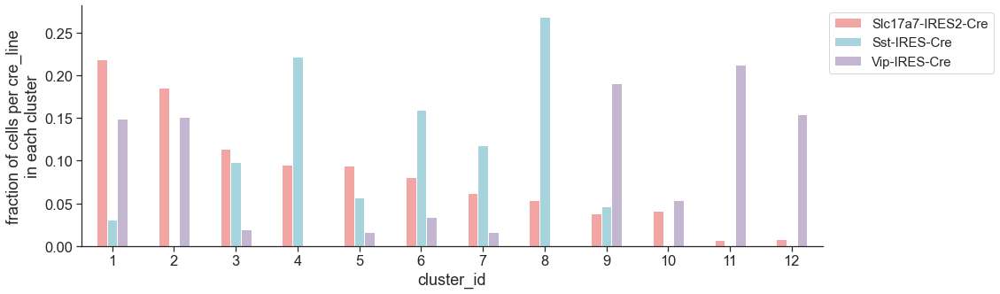

In [ ]:
col_to_group = 'cre_line'
n_cells_per_cluster = get_fraction_cells_per_cluster_per_group(cluster_meta, col_to_group)

figsize = (15,5)
fig, ax = plt.subplots(figsize=figsize)
ax = sns.barplot(data=n_cells_per_cluster, x='cluster_id', y='fraction_per_cluster', 
            hue=col_to_group, hue_order=cre_lines, palette=cre_line_colors, width=0.5, ax=ax)
ax.set_ylabel('fraction of cells per '+col_to_group+'\nin each cluster')
ax.legend(bbox_to_anchor=(1,1), fontsize='small', title_fontsize='small')

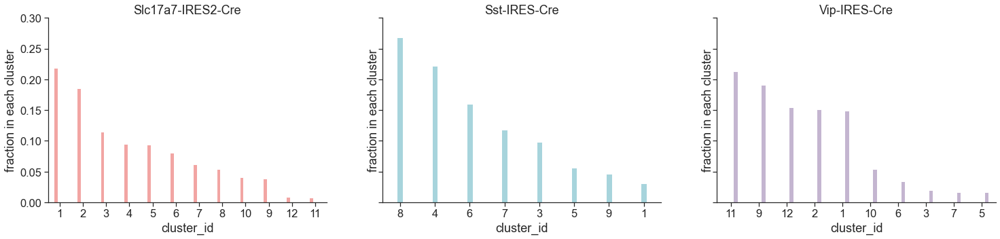

In [ ]:
# sorted within cre
col_to_group = 'cre_line'
n_cells_per_cluster = get_fraction_cells_per_cluster_per_group(cluster_meta, col_to_group)

figsize = (25,5)
fig, ax = plt.subplots(1, 3, figsize=figsize, sharey=True)
for i, cre in enumerate(cre_lines):
    cre_data = n_cells_per_cluster[n_cells_per_cluster.cre_line==cre]
    order = cre_data.sort_values(by='fraction_per_cluster')['cluster_id'][::-1]
    ax[i] = sns.barplot(data=cre_data,  x='cluster_id', order=order, y='fraction_per_cluster', 
                hue='cre_line', hue_order=cre_lines, palette=cre_line_colors, width=0.5, ax=ax[i])
    ax[i].set_ylabel('fraction in each cluster')
    ax[i].get_legend().remove()
    ax[i].set_ylim(0, 0.3)
#     ax[i].legend(bbox_to_anchor=(1,1), fontsize='small', title_fontsize='small')
    ax[i].set_title(cre)

#### per mouse

In [ ]:
col_to_group = 'mouse_id'
n_cells_per_cluster = get_fraction_cells_per_cluster_per_group(cluster_meta, col_to_group)
n_cells_per_cluster = n_cells_per_cluster.merge(experiments_table[['mouse_id', 'cre_line']], on='mouse_id')
n_cells_per_cluster = n_cells_per_cluster.drop_duplicates(subset=['mouse_id', 'cluster_id'])
n_cells_per_cluster

,mouse_id,cluster_id,n_cells_cluster,n_cells_group,fraction_per_cluster,cre_line
0,412036,1,2,28,0.071429,Vip-IRES-Cre
3,412036,2,4,28,0.142857,Vip-IRES-Cre
6,412036,3,1,28,0.035714,Vip-IRES-Cre
9,412036,7,2,28,0.071429,Vip-IRES-Cre
12,412036,9,1,28,0.035714,Vip-IRES-Cre
...,...,...,...,...,...,...
3270,549976,1,2,8,0.250000,Sst-IRES-Cre
3273,549976,4,1,8,0.125000,Sst-IRES-Cre
3276,549976,5,1,8,0.125000,Sst-IRES-Cre
3279,549976,8,3,8,0.375000,Sst-IRES-Cre


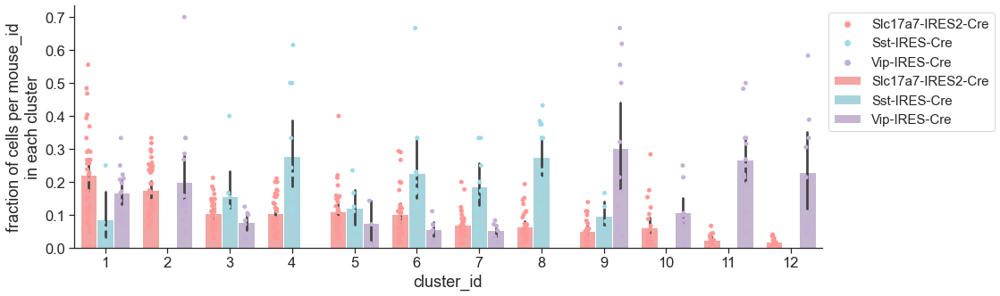

In [ ]:
figsize = (15,5)
fig, ax = plt.subplots(figsize=figsize)
ax = sns.stripplot(data=n_cells_per_cluster, x='cluster_id', y='fraction_per_cluster', 
            hue='cre_line', hue_order=cre_lines, palette=cre_line_colors, dodge=True, ax=ax)
ax = sns.barplot(data=n_cells_per_cluster, x='cluster_id', y='fraction_per_cluster', 
            hue='cre_line', hue_order=cre_lines, palette=cre_line_colors, ax=ax)
ax.set_ylabel('fraction of cells per '+col_to_group+'\nin each cluster')
ax.legend(bbox_to_anchor=(1,1), fontsize='small', title_fontsize='small')

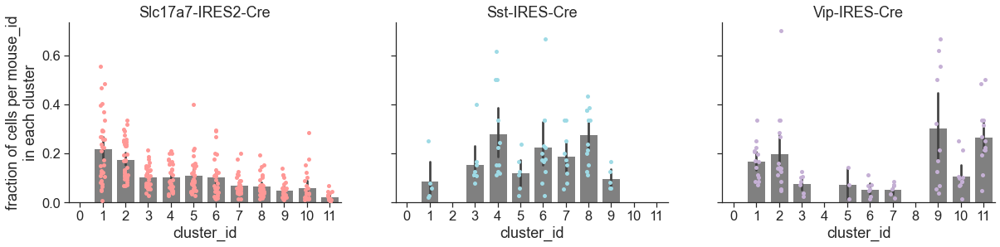

In [ ]:
figsize = (20,4)
fig, ax = plt.subplots(1, 3, figsize=figsize, sharey=True)
for i,cre_line in enumerate(cre_lines): 
    data = n_cells_per_cluster[n_cells_per_cluster.cre_line==cre_line]
    ax[i] = sns.stripplot(data=data, x='cluster_id', y='fraction_per_cluster', 
                          order=np.arange(0, len(n_cells_per_cluster.cluster_id.unique())),
                color=cre_line_colors[i], ax=ax[i])
    ax[i] = sns.barplot(data=data, x='cluster_id', y='fraction_per_cluster', 
                        order=np.arange(0, len(n_cells_per_cluster.cluster_id.unique())),
                color='gray', ax=ax[i])
    ax[i].set_ylabel('fraction of cells per '+col_to_group+'\nin each cluster')
    ax[i].set_title(cre_line)

## graphical abstract figure 

Goal: make figure representing the major clusters for each cre line, with each cluster represented as one point (cell) using the color for experience modulation, shape for cre line, y position for type and strength of coding, x position for area-depth bias

* Use pref exp level (or index) for color of fill
* Pref feature for x position (strength of coding for each as order)
* Get upper v. lower for significant diffs, set as y position; nonsig in middle
* Cre lines as shapes
* Only include clusters with >5% cells

#### get data

In [ ]:
# for each cre
cluster_metrics = processing.get_cluster_metrics(cluster_meta, feature_matrix, results_pivoted)
cluster_metrics.head()

C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1790: RuntimeWarning: invalid value encountered in double_scalars
  exp_mod_persistence = row['Novel >1'] / row['Novel 1'] # make it an index
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1790: RuntimeWarning: divide by zero encountered in double_scalars
  exp_mod_persistence = row['Novel >1'] / row['Novel 1'] # make it an index
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1767: RuntimeWarning: invalid value encountered in double_scalars
  feature_selectivity = (values[0] - (np.mean(values[1:]))) / (values[0] + (np.mean(values[1:])))
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1771: RuntimeWarning: invalid value encountered in double_s

dominant_feature dominant_experience_level  \
cre_line          cluster_id                                              
Slc17a7-IRES2-Cre 1                      task                   Novel +   
                  2                all-images                     Novel   
                  3                all-images                     Novel   
                  4                all-images                  Familiar   
                  5                all-images                   Novel +   

                             next_highest_conditions  max_coding_score  \
cre_line          cluster_id                                             
Slc17a7-IRES2-Cre 1               (Novel, omissions)          0.007872   
                  2                  (Novel +, task)          0.899068   
                  3                  (Novel +, task)          0.790757   
                  4                  (Novel +, task)          0.916090   
                  5                    (Novel, task)          0.902526   

                              max_image_coding_score  image_coding_Familiar  \
cre_line          cluster_id                                                  
Slc17a7-IRES2-Cre 1                         0.003056               0.006467   
                  2                         0.899068               0.026190   
                  3                         0.790757               0.074130   
                  4                         0.916090               0.916090   
                  5                         0.902526               0.024844   

                              image_coding_Novel  image_coding_Novel +  \
cre_line          cluster_id                                             
Slc17a7-IRES2-Cre 1                     0.002046              0.003056   
                  2                     0.899068              0.092013   
                  3                     0.790757              0.773776   
                  4                     0.065449              0.055535   
                  5                     0.095617              0.902526   

                              feature_selectivity  experience_selectivity  \
cre_line          cluster_id                                                
Slc17a7-IRES2-Cre 1                      0.453154                0.328261   
                  2                      0.932713                0.876637   
                  3                      0.923915                0.301968   
                  4                      0.936667                0.876115   
                  5                      0.939104                0.874879   

                              ...  exp_mod_direction  exp_mod_persistence  \
cre_line          cluster_id  ...                                           
Slc17a7-IRES2-Cre 1           ...           0.526326             1.295495   
                  2           ...           0.943390             0.102343   
                  3           ...           0.828579             0.978525   
                  4           ...          -0.866640             0.848519   
                  5           ...           0.587523             9.438923   

                              feature_sel_within_session  \
cre_line          cluster_id                               
Slc17a7-IRES2-Cre 1                             0.413906   
                  2                             0.908952   
                  3                             0.895087   
                  4                             0.917703   
                  5                             0.919207   

                              feature_sel_across_sessions  fraction_cre  \
cre_line          cluster_id                                              
Slc17a7-IRES2-Cre 1                              0.081820      0.218921   
                  2                              0.948108      0.185264   
                  3                              0.911192      0.114312   
                  4                

In [ ]:
location = 'layer'
n_cells_table = processing.get_cluster_proportion_stats_for_locations(cluster_meta, location=location)
n_cells_table.head()

n_cells_location  n_cells_location_total  \
cre_line          cluster_id layer                                             
Slc17a7-IRES2-Cre 1          lower               243                    1863   
                             upper               479                    1435   
                  2          lower               309                    1863   
                             upper               302                    1435   
                  3          lower               206                    1863   

                                    fraction_cells_location  n_cells_cluster  \
cre_line          cluster_id layer                                             
Slc17a7-IRES2-Cre 1          lower                 0.130435              722   
                             upper                 0.333798              722   
                  2          lower                 0.165862              611   
                             upper                 0.210453              611   
                  3          lower                 0.110574              377   

                                    n_cells_cre  fraction_cells_cluster  \
cre_line          cluster_id layer                                        
Slc17a7-IRES2-Cre 1          lower         3298                0.218921   
                             upper         3298                0.218921   
                  2          lower         3298                0.185264   
                             upper         3298                0.185264   
                  3          lower         3298                0.114312   

                                    fraction_of_cluster_size  \
cre_line          cluster_id layer                             
Slc17a7-IRES2-Cre 1          lower                  0.595809   
                             upper                  1.524744   
                  2          lower                  0.895272   
                             upper                  1.135964   
                  3          lower                  0.967306   

                                    n_cells_chance_location        pvalue  \
cre_line          cluster_id layer                                          
Slc17a7-IRES2-Cre 1          lower               407.848999  3.580637e-35   
                             upper               314.151001  3.580637e-35   
                  2          lower               345.146452  3.181840e-03   
                             upper               265.853548  3.181840e-03   
                  3          lower               212.962705  4.694883e-01   

                                   significant       imq bh_significant  
cre_line          cluster_id layer                                       
Slc17a7-IRES2-Cre 1          lower        True  0.000000           True  
                             upper        True  0.000000           True  
                  2          lower        True  0.008333           True  
                             upper        True  0.008333           True  
                  3          lower       False  0.016667          False

In [ ]:
layer_index = n_cells_table[['fraction_cells_location']].unstack()
layer_index.columns = layer_index.columns.droplevel(0)
layer_index['layer_index'] = (layer_index.upper-layer_index.lower)/(layer_index.upper+layer_index.lower)
layer_index = layer_index.merge(n_cells_table[['bh_significant', 'significant']], on=['cre_line', 'cluster_id'])
layer_index = layer_index.reset_index().drop_duplicates(subset=['cre_line', 'cluster_id']).set_index(['cre_line', 'cluster_id'])
layer_index.head()

lower     upper  layer_index bh_significant  \
cre_line          cluster_id                                                   
Slc17a7-IRES2-Cre 1           0.130435  0.333798     0.438063           True   
                  2           0.165862  0.210453     0.118495           True   
                  3           0.110574  0.119164     0.037388          False   
                  4           0.119699  0.062718    -0.312370           True   
                  5           0.095545  0.091986    -0.018977          False   

                             significant  
cre_line          cluster_id              
Slc17a7-IRES2-Cre 1                 True  
                  2                 True  
                  3                False  
                  4                 True  
                  5                False

#### seaborn plot

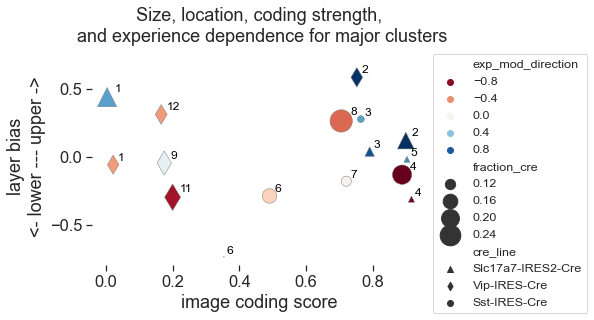

In [ ]:
# get data to plot
df = cluster_metrics.merge(layer_index, on=['cre_line', 'cluster_id']).sort_values(by='max_coding_score')
df = df[df.fraction_cre>0.07]

# color by experience mod index, which ranges from -1, 1 
# can round values to 0.1 to index into cmap binned into 20 colors
colors = sns.color_palette('RdBu', 20)
value_order = np.arange(-1, 1, 0.1)
value_order = [np.round(value, 1) for value in value_order]
# markers for cre lines 
marker_dict = {'Slc17a7-IRES2-Cre': '^', 
                'Sst-IRES-Cre': 'o', 
                'Vip-IRES-Cre': 'd'}

# make plot
figsize = (6,4)
fig, ax = plt.subplots(figsize=figsize)
ax = sns.scatterplot(data=df.reset_index(), x='max_image_coding_score', y='layer_index', 
                hue='exp_mod_direction', palette='RdBu', size='fraction_cre', sizes=(1,500),
                markers=marker_dict, style='cre_line', edgecolor='gray', ax=ax)
ax.legend(bbox_to_anchor=(1,1), fontsize='x-small', title_fontsize='x-small')
# ax.hlines(y=0, xmin=0, xmax=1, linestyle='--', color='gray', linewidth=1)
ax.set_title('Size, location, coding strength,\n and experience dependence for major clusters')
ax.set_ylabel('layer bias\n<- lower --- upper ->')
ax.set_xlabel('image coding score')
ax.set_ylim(-0.8, 0.8)
sns.despine(left=True, bottom=True)
for index in df.index.values:  
    cluster_id = index[1]
    x_pos = df.loc[index, 'max_image_coding_score']
    y_pos = df.loc[index, 'layer_index']
    size = df.loc[index, 'fraction_cre']
    ax.text(x=x_pos+size*0.1, y=y_pos+size*0.1, s=str(cluster_id), fontsize=12, color='k', ha='left', va='bottom')

posx and posy should be finite values
posx and posy should be finite values


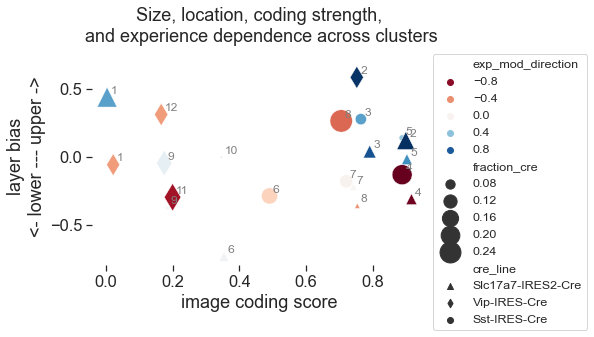

In [ ]:
# get data to plot
df = cluster_metrics.merge(layer_index, on=['cre_line', 'cluster_id']).sort_values(by='max_coding_score')
df = df[df.fraction_cre>0.04]

# color by experience mod index, which ranges from -1, 1 
# can round values to 0.1 to index into cmap binned into 20 colors
colors = sns.color_palette('RdBu', 20)
value_order = np.arange(-1, 1, 0.1)
value_order = [np.round(value, 1) for value in value_order]
# markers for cre lines 
marker_dict = {'Slc17a7-IRES2-Cre': '^', 
                'Sst-IRES-Cre': 'o', 
                'Vip-IRES-Cre': 'd'}

# make plot
figsize = (6,4)
fig, ax = plt.subplots(figsize=figsize)
ax = sns.scatterplot(data=df.reset_index(), x='max_image_coding_score', y='layer_index', 
                hue='exp_mod_direction', palette='RdBu', size='fraction_cre', sizes=(1,500),
                markers=marker_dict, style='cre_line', ax=ax)
ax.legend(bbox_to_anchor=(1,1), fontsize='x-small', title_fontsize='x-small')
# ax.hlines(y=0, xmin=0, xmax=1, linestyle='--', color='gray', linewidth=1)
ax.set_title('Size, location, coding strength,\n and experience dependence across clusters')
ax.set_ylabel('layer bias\n<- lower --- upper ->')
ax.set_xlabel('image coding score')
ax.set_ylim(-0.8, 0.8)
sns.despine(left=True, bottom=True)
for index in df.index.values:  
    cluster_id = index[1]
    x_pos = df.loc[index, 'max_image_coding_score']
    y_pos = df.loc[index, 'layer_index']
    ax.text(x=x_pos+0.01, y=y_pos+0.01, s=str(cluster_id), fontsize=12, color='gray', ha='left', va='bottom')

#### matplotlib version

In [ ]:
colors = sns.color_palette('RdBu', 20)
value_order = np.arange(-1, 1, 0.1)

exp_mod_value = np.round(df.exp_mod_direction.values[3], 1)
color_index = np.where(value_order==exp_mod_value)[0][0]
c = colors[color_index]

(0.6807381776239907, 0.08858131487889273, 0.16585928489042678)

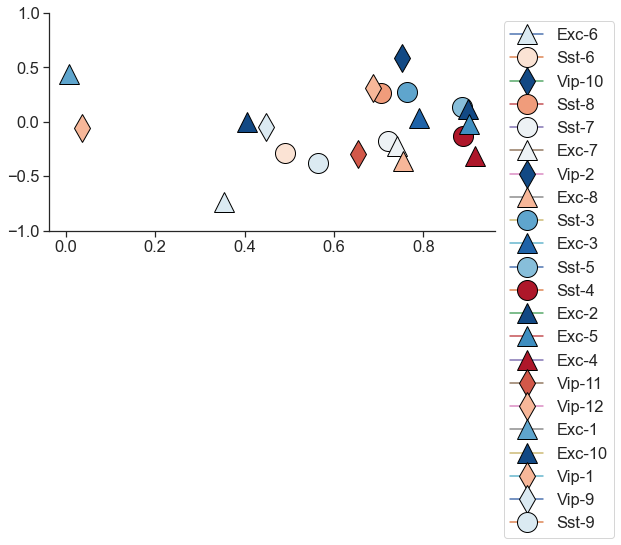

In [ ]:
features = ['all-images', 'omissions', 'task', 'behavioral',]

marker_dict = {'Slc17a7-IRES2-Cre': '^', 
                'Sst-IRES-Cre': 'o', 
                'Vip-IRES-Cre': 'd'}

# color by experience mod index, which ranges from -1, 1 
# can round values to 0.1 to index into cmap binned into 20 colors
colors = sns.color_palette('RdBu', 20)
value_order = np.arange(-1, 1, 0.1)
value_order = [np.round(value, 1) for value in value_order]

figsize = (8,4)
fig, ax = plt.subplots(figsize=figsize)

# plot in order of features
for f, feature in enumerate(features): 
    # get clusters with specific preferred feature
    feature_data = df[(df.dominant_feature==feature) & (df.fraction_cre>0.04)] # only consider clusters with >4% cells
    # sort clusters by max coding score for pref feature
    feature_data = feature_data.sort_values(by='max_coding_score')
    # loop through clusters
    for index in feature_data.index.values: 
        cluster_data = feature_data.loc[index]
        # x position determined by strength of max coding score (which corresponds to the pref feature)
        x_pos = cluster_data.max_coding_score
        # y position is the upper v lower index value (i.e. layer bias of cluster)
        y_pos = cluster_data.layer_index
        # get color for exp mod index by rounding and indexing into discritized color map
        exp_mod_value = np.round(cluster_data.exp_mod_direction, 1)
        color_index = np.where(value_order==exp_mod_value)[0][0]
        color = colors[color_index]
        # get marker for cre line
        cre_line = index[0] # zero index is cre line, get maker for cre line
        marker = marker_dict[cre_line] 
        cluster_id = index[1] # get cluster Id for label
        ax.plot(x_pos, y_pos, marker=marker, ms=20, label=utils.get_abbreviated_cell_type(cre_line)+'-'+str(cluster_id),
                markerfacecolor=color, markeredgecolor='black')

ax.set_ylim(-1, 1)
ax.legend(bbox_to_anchor=(1,1))

#### which clusters form the top 3 in each cre line?

In [ ]:
.21+.19+.15 # Vip - 11, 9, 12

0.55

In [ ]:
.27+.22 # Sst - 8, 4

0.49

In [ ]:
.22+.18+.11 # Slc - 1, 2, 3, 

0.51

In [ ]:
cluster_metrics.reset_index().sort_values(by=['cre_line', 'fraction_cre'], ascending=False)[['cre_line', 'cluster_id', 'fraction_cre']]

,cre_line,cluster_id,fraction_cre
28,Vip-IRES-Cre,11,0.212714
26,Vip-IRES-Cre,9,0.190709
29,Vip-IRES-Cre,12,0.154034
21,Vip-IRES-Cre,2,0.151589
20,Vip-IRES-Cre,1,0.149144
27,Vip-IRES-Cre,10,0.053790
24,Vip-IRES-Cre,6,0.034230
22,Vip-IRES-Cre,3,0.019560
23,Vip-IRES-Cre,5,0.017115
25,Vip-IRES-Cre,7,0.017115


## selecting # k

### is 15 clusters reasonable?

### eigengap

In [ ]:
# k_max=25
# X = feature_matrix.values
# sc = SpectralClustering(n_clusters)  # N of clusters does not impact affinity matrix
# # but you can obtain affinity matrix only after fitting, thus some N of clusters must be provided.
# sc.fit(X)
# A = sc.affinity_matrix_
# eigenvalues, eigenvectors, nb_clusters = processing.get_eigenDecomposition(A, max_n_clusters=k_max)

In [ ]:
# figsize = (10, 4)
# fig, ax = plt.subplots(figsize=figsize)
# # ax.plot(np.arange(1, len(eigenvalues) + 1), eigenvalues, '-o')
# # ax.set_ylabel('Eigen values \n(sorted)')
# # ax.set_xlabel('Eigen number')
# # ax.set_xlim([0, 20])
# # ax.axvline(x=n_clusters, ymin=0, ymax=1, linestyle='--', color='gray')

# ax.plot(np.arange(2, len(eigenvalues) + 1), np.diff(eigenvalues), '-o')
# ax.set_ylabel('Eigengap value \n(difference)')
# ax.set_xlabel('Eigen number')
# ax.set_xlim([0, 20])
# # ax.set_ylim([0, 0.20])
# ax.axvline(x=n_clusters, ymin=0, ymax=1, linestyle='--', color='gray')
# plt.tight_layout()

# if test_save_dir:
#     utils.save_figure(fig, figsize, test_save_dir, 'figs', 'eigengap')

### gap statistic

In [ ]:
# X = feature_matrix.values
# feature_matrix_shuffled = processing.shuffle_dropout_score(feature_matrix, shuffle_type='all')
# reference = feature_matrix_shuffled.values
# sc = SpectralClustering()
# gap_statistic, reference_inertia, ondata_inertia = processing.compute_gap(sc, X, k_max=25, reference_shuffle=reference, 
#                                                                 metric='euclidean', n_boots=20)

In [ ]:
# figsize = (10, 4)
# fig, ax = plt.subplots(figsize=figsize)

# ax.plot(np.arange(1, x + 1), gap_statistic['reference_inertia'], 'o-')
# ax.plot(np.arange(1, x + 1), gap_statistic['ondata_inertia'], 'o-')
# ax.legend(['reference inertia', 'ondata intertia'])
# ax.set_ylabel('Natural log of euclidean \ndistance values')
# ax.set_xlabel('Number of clusters')
# ax.axvline(x=n_clusters, ymin=0, ymax=1, linestyle='--', color='gray')

# ax.plot(np.arange(1, x + 1), gap_statistic['gap'], 'o-')
# ax.set_ylabel('Gap statistic')
# ax.set_xlabel('Number of clusters')
# ax.axvline(x=n_clusters, ymin=0, ymax=1, linestyle='--', color='gray')

## coding score metrics

### compute metrics on dropout scores for each cell

In [ ]:
coding_score_metrics = processing.get_cell_metrics(cluster_meta, results_pivoted)

C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1442: RuntimeWarning: invalid value encountered in double_scalars
  # persistence of exp mod is whether coding stays similar after repetition of novel session
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1420: RuntimeWarning: invalid value encountered in double_scalars
  values = index_dropouts.loc[dominant_experience_level].values[order[::-1]]
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1424: RuntimeWarning: invalid value encountered in double_scalars
  values = index_dropouts[dominant_feature].values[order[::-1]]
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1435: RuntimeWarning: invalid value encountered in double_scalars
  novel_pl

metrics: 
* exp_mod_direction = N - F / N + F
* exp_mod_persistence = N+ - N / N+ + N

In [ ]:
print(len(coding_score_metrics.mouse_id.unique()), 'mice')
print(len(coding_score_metrics.ophys_experiment_id.unique()), 'experiments')
print(len(coding_score_metrics.index.unique()), 'cells')

65 mice
131 experiments
3901 cells


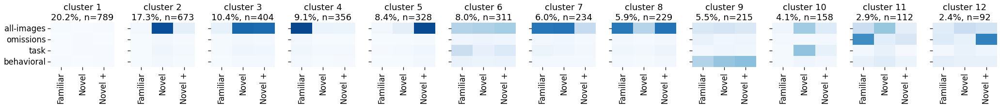

In [ ]:
# plot clusters in order of sort_col
clusters = np.sort(cluster_meta['cluster_id'].unique())
n_clusters_to_plot = len(clusters)

figsize = (35, 1.7)
fig, ax = plt.subplots(1, n_clusters_to_plot, figsize=figsize, sharex=True, sharey=True)
ax = ax.ravel()

  
# loop through clusters in sorted order
for i, cluster_id in enumerate(clusters):
    this_cluster_csids = cluster_meta[cluster_meta.cluster_id==cluster_id].index.values
    mean_dropout_df = feature_matrix.loc[this_cluster_csids].mean().unstack()
    ax[i] = sns.heatmap(mean_dropout_df, cmap='Blues', vmin=0, vmax=1, ax=ax[i], cbar=False, cbar_kws={'label': 'coding score'})
    # fraction is number of cells in this cluster vs all cells in this cre line
    fraction_cluster = len(this_cluster_csids) / float(len(cluster_meta))
    fraction = np.round(fraction_cluster * 100, 1)
    # set title and labels
    ax[i].set_title('cluster ' + str(cluster_id) + '\n' + str(fraction) + '%, n=' + str(len(this_cluster_csids)))
    ax[i].set_xlabel('')
    
plt.subplots_adjust(hspace=0.6, wspace=0.25)
# if save_dir:
#     utils.save_figure(fig, figsize, save_dir, folder,
#                       'mean_cluster_heatmaps_'+str(n_clusters))

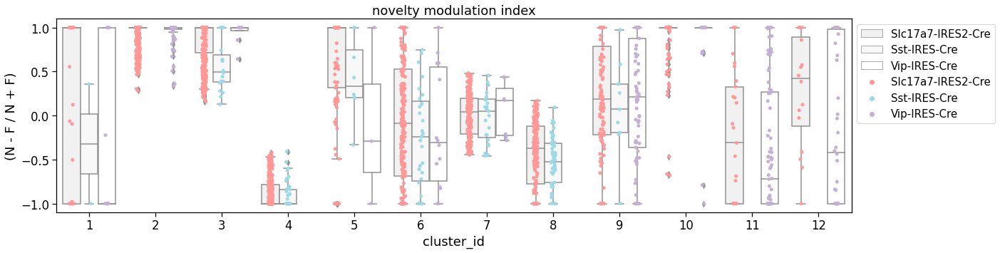

In [ ]:
metric = 'exp_mod_direction'

figsize = (20,5)
fig, ax = plt.subplots(figsize=figsize)
ax = sns.stripplot(data=coding_score_metrics, x='cluster_id', y=metric, 
            hue='cre_line', hue_order=cre_lines, palette=cre_line_colors, dodge=True, ax=ax)
ax = sns.boxplot(data=coding_score_metrics, x='cluster_id', y=metric, 
            hue='cre_line', hue_order=cre_lines, color='white', ax=ax)
ax.set_ylabel('(N - F / N + F)')
ax.set_title('novelty modulation index')
ax.legend(bbox_to_anchor=(1,1), fontsize='small', title_fontsize='small')

In [ ]:
n_clusters = len(coding_score_metrics.cluster_id.unique())

c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\seaborn\algorithms.py:98: RuntimeWarning: Mean of empty slice
  boot_dist.append(f(*sample, **func_kwargs))


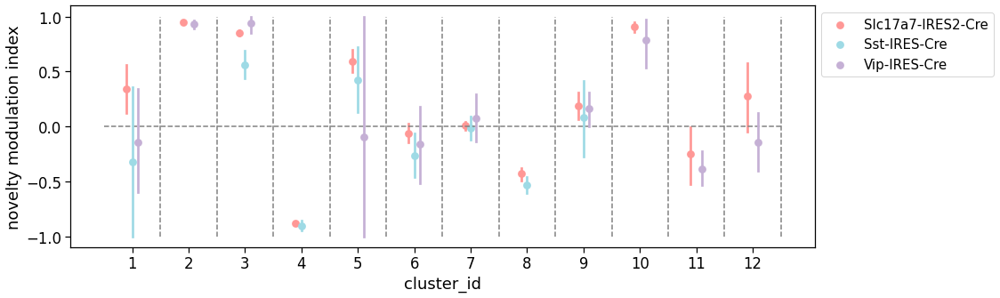

In [ ]:
metric = 'exp_mod_direction'

figsize = (15,5)
fig, ax = plt.subplots(figsize=figsize)
ax = sns.pointplot(data=coding_score_metrics, x='cluster_id', y=metric, 
            hue='cre_line', hue_order=cre_lines, palette=cre_line_colors, join=False, dodge=0.2, ax=ax)
# ax = sns.boxplot(data=coding_score_metrics, x='cluster_id', y=metric, 
#             hue='cre_line', hue_order=cre_lines, color='white', ax=ax)
ax.set_ylabel('novelty modulation index')
ax.legend(bbox_to_anchor=(1,1), fontsize='small', title_fontsize='small')

for x in np.arange(0.5, n_clusters, 1):
    ax.vlines(x=x, ymin=-1, ymax=1, color='gray', linestyle='--')
ax.hlines(y=0, xmin=-0.5, xmax=n_clusters-0.5, color='gray', linestyle='--')

#### persistence of coding

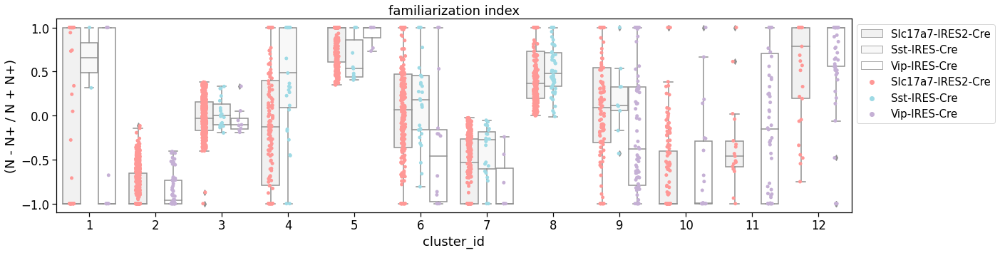

In [ ]:
metric = 'exp_mod_persistence'

figsize = (20,5)
fig, ax = plt.subplots(figsize=figsize)
ax = sns.stripplot(data=coding_score_metrics, x='cluster_id', y=metric, 
            hue='cre_line', hue_order=cre_lines, palette=cre_line_colors, dodge=True, ax=ax)
ax = sns.boxplot(data=coding_score_metrics, x='cluster_id', y=metric, 
            hue='cre_line', hue_order=cre_lines, color='white', ax=ax)
ax.set_ylabel('(N - N+ / N + N+)')
ax.set_title('familiarization index')
ax.legend(bbox_to_anchor=(1,1), fontsize='small', title_fontsize='small')

In [ ]:
# take absolute value so its just whether it is transient or not, regardless of direction
coding_score_metrics['transience'] = 1-np.abs(coding_score_metrics.exp_mod_persistence.values)

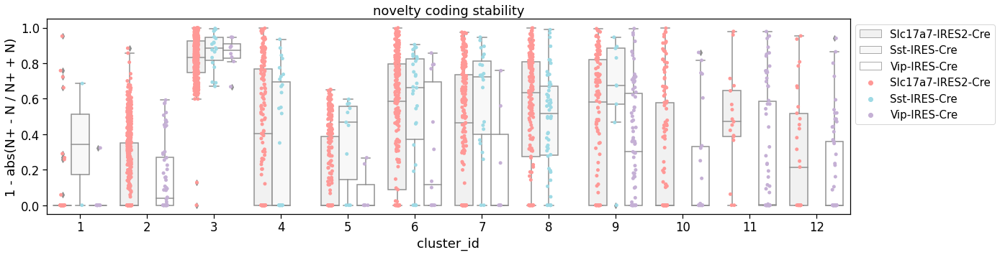

In [ ]:
metric = 'transience'

figsize = (20,5)
fig, ax = plt.subplots(figsize=figsize)
ax = sns.stripplot(data=coding_score_metrics, x='cluster_id', y=metric, 
            hue='cre_line', hue_order=cre_lines, palette=cre_line_colors, dodge=True, ax=ax)
ax = sns.boxplot(data=coding_score_metrics, x='cluster_id', y=metric, 
            hue='cre_line', hue_order=cre_lines, color='white', ax=ax)
ax.set_ylabel('1 - abs(N+ - N / N+ + N)')
ax.set_title('novelty coding stability')
ax.legend(bbox_to_anchor=(1,1), fontsize='small', title_fontsize='small')

In [ ]:
# metric = 'transience'

# figsize = (15,5)
# fig, ax = plt.subplots(figsize=figsize)
# ax = sns.pointplot(data=coding_score_metrics, x='cluster_id', y=metric, 
#             hue='cre_line', hue_order=cre_lines, palette=cre_line_colors, join=False, dodge=0.2, ax=ax)
# # ax = sns.boxplot(data=coding_score_metrics, x='cluster_id', y=metric, 
# #             hue='cre_line', hue_order=cre_lines, color='white', ax=ax)
# ax.set_ylabel(metric)
# ax.legend(bbox_to_anchor=(1,1), fontsize='small', title_fontsize='small')

# for x in np.arange(0.5, n_clusters, 1):
#     ax.vlines(x=x, ymin=0, ymax=1, color='gray', linestyle='--')

In [ ]:
# # vertical plot
# metric = 'persistence'

# figsize = (5, 10)
# fig, ax = plt.subplots(figsize=figsize)
# ax = sns.pointplot(data=coding_score_metrics, y='cluster_id', x=metric, orient='h',
#             hue='cre_line', hue_order=cre_lines, palette=cre_line_colors, join=False, dodge=0.3, ax=ax)
# # ax = sns.boxplot(data=coding_score_metrics, x='cluster_id', y=metric, 
# #             hue='cre_line', hue_order=cre_lines, color='white', ax=ax)
# ax.set_xlabel(metric)
# ax.legend(bbox_to_anchor=(1,1), fontsize='small', title_fontsize='small')

# for y in np.arange(0.5, len(coding_score_metrics.cluster_id.unique()), 1):
#     ax.hlines(y=y, xmin=0, xmax=1, color='gray', linestyle='--')

### correlate coding score metrics with area / depth distributions

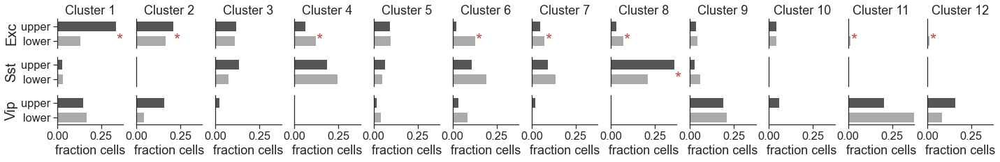

In [ ]:
location = 'layer'
order = ['upper', 'lower']
n_cells_table = processing.get_cluster_proportion_stats_for_locations(cluster_meta, location=location)

metric = 'fraction_cells_location'
xlabel = 'fraction cells'
significance_col = 'bh_significant'

plotting.plot_location_distribution_across_clusters_for_cre_lines(n_cells_table, location=location, order=order,
                                                             metric=metric, xlabel=xlabel,
                                                             significance_col=significance_col,
                                                             ax=None, save_dir=save_dir, folder=folder);

In [ ]:
coding_score_metrics.head()

,dominant_feature,dominant_experience_level,next_highest_conditions,max_coding_score,max_image_coding_score,image_coding_Familiar,image_coding_Novel,image_coding_Novel +,feature_selectivity,experience_selectivity,...,layer,area_layer,date,first_novel,n_relative_to_first_novel,last_familiar,last_familiar_active,second_novel,second_novel_active,experience_exposure
cell_specimen_id,,,,,,,,,,,,,,,,,,,,,
1086489847,behavioral,Novel +,"(Novel, all-images)",0.971563,0.017832,0.000000,0.060457,0.017832,0.981199,0.916276,...,upper,VISp_upper,20200129,False,-2.0,False,True,False,False,Familiar > 3
1086489860,all-images,Novel,"(Familiar, omissions)",0.910349,0.910349,0.000000,0.910349,0.000000,0.922958,1.000000,...,upper,VISp_upper,20200129,False,-2.0,False,True,False,False,Familiar > 3
1086489891,behavioral,Novel +,"(Familiar, omissions)",1.000000,0.000000,0.000000,0.279929,0.000000,1.000000,0.837370,...,upper,VISp_upper,20200129,False,-2.0,False,True,False,False,Familiar > 3
1086489976,all-images,Familiar,"(Novel, omissions)",0.817370,0.817370,0.817370,0.000000,0.000000,1.000000,1.000000,...,lower,VISp_lower,20191007,False,-1.0,True,True,False,False,Familiar 3
1086490002,all-images,Familiar,"(Novel, omissions)",0.852927,0.852927,0.852927,0.000000,0.355870,0.983050,0.654784,...,lower,VISp_lower,20191007,False,-1.0,True,True,False,False,Familiar 3


## model free metrics

In [ ]:
import visual_behavior.ophys.response_analysis.cell_metrics as cm

### all images

Response metrics table contains one row per cell per experiment

In [ ]:
data_type = 'filtered_events'

condition = 'images'
stimuli = 'all_images'
session_subset = 'full_session'

# set inclusion criteria
# options: ['active_only', 'closest_familiar_and_novel', 'containers_with_all_levels', 'platform_experiment_table']
inclusion_criteria = 'platform_experiment_table'
    
response_metrics = cm.get_cell_metrics_for_conditions(data_type, condition, stimuli, session_subset, inclusion_criteria)

# convert experience level
response_metrics['experience_level'] = [utils.convert_experience_level(experience_level) for experience_level in response_metrics.experience_level.values]

# limit to matched cells
response_metrics = response_metrics[response_metrics.cell_specimen_id.isin(matched_cells)]
len(response_metrics)

C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


removing 1 problematic experiments
there are 402 experiments after filtering for inclusion criteria -  platform_experiment_table


  9%|▊         | 35/402 [00:06<00:54,  6.72it/s]

problem for experiment 891994418


 12%|█▏        | 50/402 [00:09<00:51,  6.81it/s]

problem for experiment 948507789


 23%|██▎       | 92/402 [00:17<00:49,  6.29it/s]

problem for experiment 994790561


 34%|███▍      | 138/402 [00:26<00:55,  4.78it/s]

problem for experiment 993369859


 35%|███▌      | 142/402 [00:27<00:43,  5.94it/s]

problem for experiment 993891845


 38%|███▊      | 154/402 [00:29<00:36,  6.73it/s]

problem for experiment 994082680


 45%|████▌     | 182/402 [00:35<00:45,  4.83it/s]

problem for experiment 851085100


 47%|████▋     | 188/402 [00:36<00:38,  5.51it/s]

problem for experiment 851085109


 48%|████▊     | 191/402 [00:36<00:35,  5.89it/s]

problem for experiment 851085105


 50%|█████     | 203/402 [00:38<00:42,  4.71it/s]

problem for experiment 991852002


 52%|█████▏    | 211/402 [00:40<00:28,  6.69it/s]

problem for experiment 991852001


 54%|█████▍    | 218/402 [00:41<00:38,  4.81it/s]

problem for experiment 991852004


 55%|█████▌    | 223/402 [00:42<00:25,  6.99it/s]

problem for experiment 991852005


 64%|██████▍   | 258/402 [00:49<00:28,  4.98it/s]

problem for experiment 977978321


 68%|██████▊   | 272/402 [00:52<00:27,  4.80it/s]

problem for experiment 981178537


 70%|██████▉   | 281/402 [00:53<00:19,  6.29it/s]

problem for experiment 882551935


 71%|███████   | 285/402 [00:54<00:23,  5.00it/s]

problem for experiment 882551937


 72%|███████▏  | 288/402 [00:55<00:18,  6.05it/s]

problem for experiment 882551947


 73%|███████▎  | 293/402 [00:55<00:18,  6.03it/s]

problem for experiment 951213203


 80%|████████  | 322/402 [01:01<00:17,  4.63it/s]

problem for experiment 1050762972


 82%|████████▏ | 328/402 [01:02<00:10,  7.04it/s]

problem for experiment 1051249031
problem for experiment 1051423446


 87%|████████▋ | 348/402 [01:05<00:08,  6.17it/s]

problem for experiment 1076776838


 90%|█████████ | 362/402 [01:08<00:08,  4.77it/s]

problem for experiment 1078904675


 92%|█████████▏| 371/402 [01:10<00:05,  5.34it/s]

problem for experiment 1077597082


 94%|█████████▎| 376/402 [01:11<00:03,  7.11it/s]

problem for experiment 1082841182


100%|██████████| 402/402 [01:16<00:00,  5.23it/s]
c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\pandas\core\generic.py:2718: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed,key->block1_values] [items->Index(['condition', 'data_type', 'exception', 'filter_events', 'interpolate',
       'ophys_experiment_id', 'session_subset', 'stimuli', 'use_events'],
      dtype='object')]

  encoding=encoding,


there are 376 experiments in the returned cell_metrics table


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)
C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To s

removing 1 problematic experiments


11019

In [ ]:
print(len(response_metrics.mouse_id.unique()), 'mice')
print(len(response_metrics.ophys_experiment_id.unique()), 'experiments')
print(len(response_metrics.cell_specimen_id.unique()), 'cells')

65 mice
368 experiments
3901 cells


In [ ]:
print(len(cluster_meta.mouse_id.unique()), 'mice')
print(len(cluster_meta.index.unique()), 'cells')

65 mice
3901 cells


In [ ]:
# merge in cluster IDs
response_metrics = response_metrics.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')

In [ ]:
response_metrics.head()

,cell_specimen_id,pref_image,non_pref_image,image_selectivity_index,image_selectivity_index_one_vs_all,lifetime_sparseness,mean_response,fraction_significant_p_value_gray_screen,fano_factor,reliability,...,area_layer,date,first_novel,n_relative_to_first_novel,last_familiar,last_familiar_active,second_novel,second_novel_active,experience_exposure,cluster_id
0,1086490397,im085,im066,0.872306,0.584549,0.422220,0.000399,0.000000,14.370119,0.338260,...,VISp_upper,20181213,False,-1.0,True,True,False,False,Familiar 3,11
1,1086490397,im045,im031,0.994846,0.537192,0.425819,0.002755,0.119577,6.551801,0.184142,...,VISp_upper,20181214,True,0.0,False,False,False,False,Novel 0,11
2,1086490397,im045,im031,0.877561,0.556740,0.406456,0.000146,0.017382,17.587489,0.212663,...,VISp_upper,20181216,False,2.0,False,False,False,True,Novel 2,11
3,1086490441,im062,im069,0.967695,0.827179,0.805567,0.003111,0.081462,9.315433,0.115776,...,VISp_upper,20181213,False,-1.0,True,True,False,False,Familiar 3,2
4,1086490441,im000,im106,0.986095,0.677209,0.618872,0.010835,0.224261,4.737115,0.169347,...,VISp_upper,20181214,True,0.0,False,False,False,False,Novel 0,2


In [ ]:
metrics = ['image_selectivity_index', 'image_selectivity_index_one_vs_all',
       'lifetime_sparseness', 'mean_response',
       'fraction_significant_p_value_gray_screen', 'fano_factor',
       'reliability', 'running_modulation_index',]

In [ ]:
cluster_ids = cluster_meta.cluster_id.unique()
n_clusters = len(cluster_ids)
n_clusters


12

In [ ]:
np.arange(0, n_clusters, 1)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11])

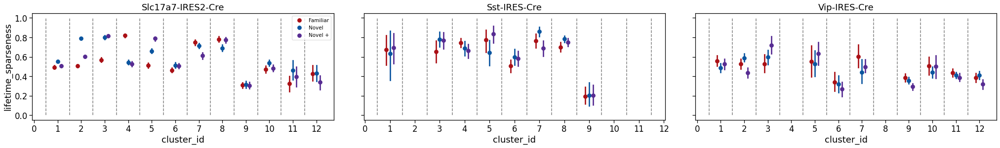

In [ ]:
metric = 'lifetime_sparseness'

order = np.arange(0, n_clusters+1, 1)

figsize = (35,4)
fig, ax = plt.subplots(1, 3, figsize=figsize, sharey=True)
for i, cre_line in enumerate(cre_lines):
    data = response_metrics[response_metrics.cre_line==cre_line]
    ax[i] = sns.pointplot(data=data, x='cluster_id', y=metric, order=order,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                          join=False, dodge=0.3, ax=ax[i])
    ax[i].set_title(cre_line)
    ax[i].get_legend().remove()
    ax[i].set_ylabel('')
    for x in np.arange(0.5, n_clusters, 1):
        ax[i].vlines(x=x, ymin=0, ymax=1, color='gray', linestyle='--')
    
ax[0].set_ylabel(metric)
ax[0].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.subplots_adjust(wspace=0.1)

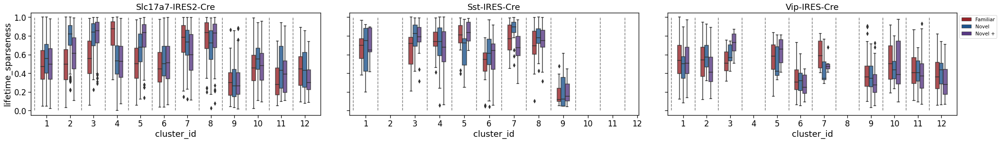

In [ ]:
metric = 'lifetime_sparseness'

order = np.arange(0, n_clusters+1, 1)

figsize = (35,4)
fig, ax = plt.subplots(1, 3, figsize=figsize, sharey=True)
for i, cre_line in enumerate(cre_lines):
    data = response_metrics[response_metrics.cre_line==cre_line]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                width=0.5, boxprops=dict(alpha=.8), ax=ax[i])
    ax[i].set_title(cre_line)
    ax[i].get_legend().remove()
    ax[i].set_ylabel('')
    for x in np.arange(0.5, n_clusters, 1):
        ax[i].vlines(x=x, ymin=0, ymax=1, color='gray', linestyle='--')
    
ax[0].set_ylabel(metric)
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.subplots_adjust(wspace=0.1)

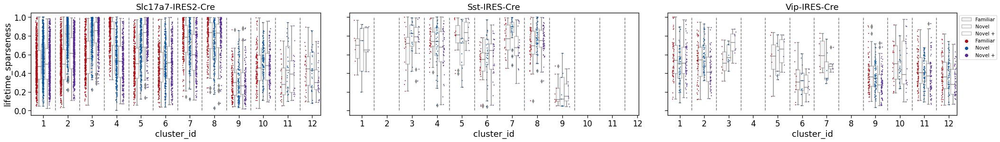

In [ ]:
metric = 'lifetime_sparseness'

order = np.arange(0, n_clusters+1, 1)

figsize = (35,4)
fig, ax = plt.subplots(1, 3, figsize=figsize, sharey=True)
for i, cre_line in enumerate(cre_lines):
    data = response_metrics[response_metrics.cre_line==cre_line]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order,
                hue='experience_level', hue_order=experience_levels, color='white', #palette=experience_level_colors,
                width=0.5, boxprops=dict(alpha=.6), ax=ax[i])
    ax[i] = sns.stripplot(data=data, x='cluster_id', y=metric, order=order, size=2,
                          hue='experience_level', hue_order=experience_levels, palette=experience_level_colors,
                          edgecolor=experience_level_colors, facecolors="none", dodge=True, ax=ax[i])
    ax[i].set_title(cre_line)
    ax[i].get_legend().remove()
    ax[i].set_ylabel('')
    for x in np.arange(0.5, n_clusters, 1):
        ax[i].vlines(x=x, ymin=0, ymax=1, color='gray', linestyle='--')
    
ax[0].set_ylabel(metric)
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.subplots_adjust(wspace=0.1)

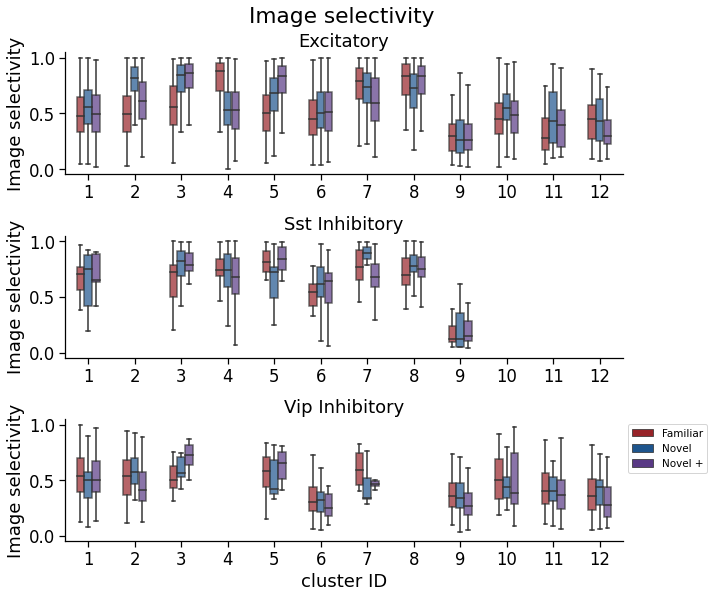

In [ ]:
metric = 'lifetime_sparseness'

order = np.arange(0, n_clusters+1, 1)

figsize = (10, 9)
fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=True, sharex=False)
for i, cre_line in enumerate(cre_lines):
    data = response_metrics[response_metrics.cre_line==cre_line]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order, showfliers=False,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                width=0.5, boxprops=dict(alpha=.7), ax=ax[i])
    ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
    ax[i].get_legend().remove()
    ax[i].set_xlabel('')
    ax[i].set_ylabel('Image selectivity')
    ax[i].set_xticks(order+1)
    ax[i].set_xlim((0.5, n_clusters+0.5))
    ax[i].spines[['right', 'top']].set_visible(False)
ax[i].set_xlabel('cluster ID')  
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.suptitle('Image selectivity', x=0.51, y=0.95)
plt.subplots_adjust(hspace=0.5)

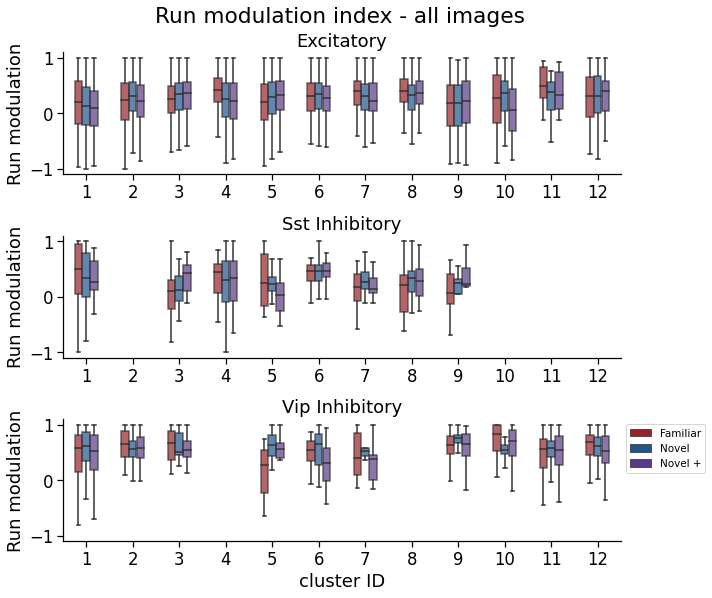

In [ ]:
metric = 'running_modulation_index'

order = np.arange(0, n_clusters+1, 1)

figsize = (10, 9)
fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=True, sharex=False)
for i, cre_line in enumerate(cre_lines):
    data = response_metrics[response_metrics.cre_line==cre_line]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order, showfliers=False,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                width=0.5, boxprops=dict(alpha=.7), ax=ax[i])
    ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
    ax[i].get_legend().remove()
    ax[i].set_xlabel('')
    ax[i].set_ylabel('Run modulation')
    ax[i].set_xticks(order+1)
    ax[i].set_xlim((0.5, n_clusters+0.5))
    ax[i].spines[['right', 'top']].set_visible(False)
ax[i].set_xlabel('cluster ID')  
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.suptitle('Run modulation index - all images', x=0.51, y=0.95)
plt.subplots_adjust(hspace=0.5)

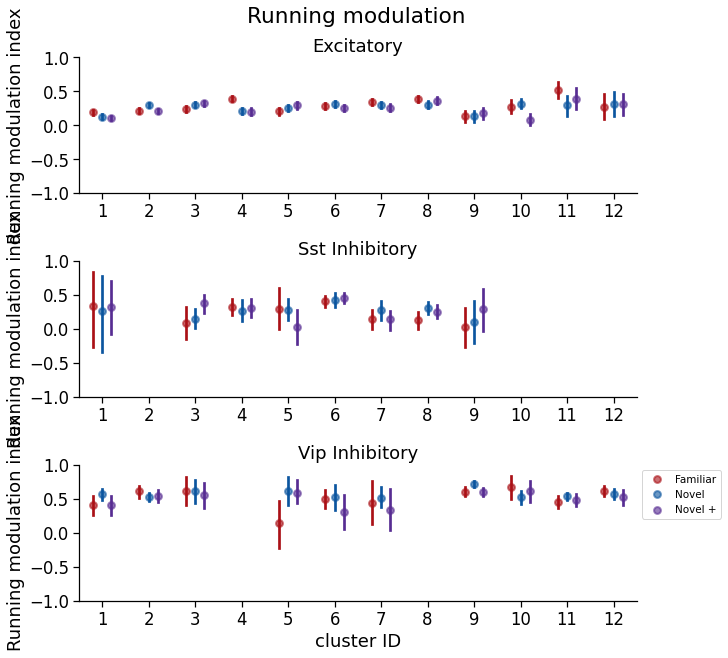

In [ ]:
metric = 'running_modulation_index'

order = np.arange(0, n_clusters+1, 1)

figsize = (10, 10)
fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=True, sharex=False)
for i, cre_line in enumerate(cre_lines):
    data = response_metrics[response_metrics.cre_line==cre_line]
    # ax[i] = sns.violinplot(data=data, x='cluster_id', y=metric, order=order, showfliers=False,
    #             hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
    #             width=0.6,  inner=None, ax=ax[i])
    ax[i] = sns.pointplot(data=data, x='cluster_id', y=metric, order=order, 
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                join=False, dodge=0.4, ax=ax[i])
    ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
    ax[i].get_legend().remove()
    ax[i].set_xlabel('')
    ax[i].set_ylabel('Running modulation index')
    ax[i].set_xticks(order+1)
    ax[i].set_xlim((0.5, n_clusters+0.5))
    ax[i].set_ylim(-1, 1)
    ax[i].spines[['right', 'top']].set_visible(False)
    plt.setp(ax[i].collections, alpha=.6)

ax[i].set_xlabel('cluster ID')  
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.suptitle('Running modulation', x=0.51, y=0.95)
plt.subplots_adjust(hspace=0.5)

In [ ]:
# metric = 'reliability'

# order = np.arange(0, n_clusters, 1)

# figsize = (35,5)
# fig, ax = plt.subplots(1, 3, figsize=figsize, sharey=True)
# for i, cre_line in enumerate(cre_lines):
#     data = response_metrics[response_metrics.cre_line==cre_line]
#     ax[i] = sns.pointplot(data=data, x='cluster_id', y=metric, order=order,
#                 hue='experience_level', hue_order=experience_levels, palette=palette_experience, 
#                           join=False, dodge=0.3, ax=ax[i])
#     ax[i].set_title(cre_line)
#     ax[i].get_legend().remove()
#     ax[i].set_ylabel('')
#     for x in np.arange(0.5, n_clusters, 1):
#         ax[i].vlines(x=x, ymin=0, ymax=0.5, color='gray', linestyle='--')
    
# ax[0].set_ylabel(metric)
# ax[0].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

# plt.subplots_adjust(wspace=0.1)

### preferred stimulus response reliability

In [ ]:
data_type = 'filtered_events'

condition = 'images'
stimuli = 'pref_image'
session_subset = 'full_session'

# set inclusion criteria
# options: ['active_only', 'closest_familiar_and_novel', 'containers_with_all_levels', 'platform_experiment_table']
inclusion_criteria = 'platform_experiment_table'
    
pref_stim_response_metrics = cm.get_cell_metrics_for_conditions(data_type, condition, stimuli, session_subset, inclusion_criteria)


# convert experience level
pref_stim_response_metrics['experience_level'] = [utils.convert_experience_level(experience_level) for experience_level in pref_stim_response_metrics.experience_level.values]
# limit to matched cells
pref_stim_response_metrics = pref_stim_response_metrics[pref_stim_response_metrics.cell_specimen_id.isin(matched_cells)]
# add cluster ID
pref_stim_response_metrics = pref_stim_response_metrics.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')

C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


removing 1 problematic experiments
there are 402 experiments after filtering for inclusion criteria -  platform_experiment_table


100%|██████████| 402/402 [01:19<00:00,  5.06it/s]
c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\pandas\core\generic.py:2718: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed,key->block1_values] [items->Index(['condition', 'data_type', 'exception', 'filter_events', 'interpolate',
       'ophys_experiment_id', 'session_subset', 'stimuli', 'use_events'],
      dtype='object')]

  encoding=encoding,


there are 402 experiments in the returned cell_metrics table


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)
C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To s

removing 1 problematic experiments


In [ ]:
pref_stim_response_metrics.columns

Index(['cell_specimen_id', 'pref_image', 'non_pref_image',
       'image_selectivity_index', 'image_selectivity_index_one_vs_all',
       'lifetime_sparseness', 'mean_response',
       'fraction_significant_p_value_gray_screen', 'fano_factor',
       'reliability', 'running_modulation_index', 'ophys_experiment_id',
       'condition', 'session_subset', 'stimuli', 'data_type', 'interpolate',
       'output_sampling_rate', 'response_window', 'equipment_name',
       'full_genotype', 'mouse_id', 'reporter_line', 'driver_line', 'sex',
       'age_in_days', 'cre_line', 'indicator', 'session_number',
       'prior_exposures_to_session_type', 'prior_exposures_to_image_set',
       'prior_exposures_to_omissions', 'ophys_session_id',
       'behavior_session_id', 'ophys_container_id', 'project_code',
       'imaging_depth', 'targeted_structure', 'date_of_acquisition',
       'session_type', 'experience_level', 'passive', 'image_set', 'file_id',
       'cell_type', 'depth', 'binned_depth', 'area

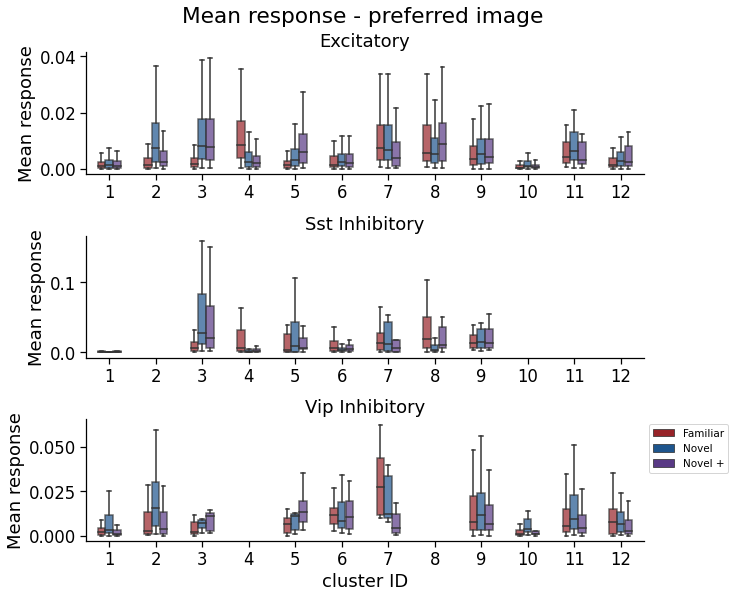

In [ ]:
metric = 'mean_response'

order = np.arange(0, n_clusters+1, 1)

figsize = (10, 9)
fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=False, sharex=False)
for i, cre_line in enumerate(cre_lines):
    data = pref_stim_response_metrics[pref_stim_response_metrics.cre_line==cre_line]
    data = data[data.mean_response<np.percentile(data.mean_response.values, 95)]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order, showfliers=False,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                width=0.5, boxprops=dict(alpha=.7), ax=ax[i])
    ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
    ax[i].get_legend().remove()
    ax[i].set_xlabel('')
    ax[i].set_ylabel('Mean response')
    ax[i].set_xticks(order+1)
    ax[i].set_xlim((0.5, n_clusters+0.5))
    ax[i].spines[['right', 'top']].set_visible(False)
ax[i].set_xlabel('cluster ID')  
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.suptitle('Mean response - preferred image', x=0.51, y=0.95)
plt.subplots_adjust(hspace=0.5)

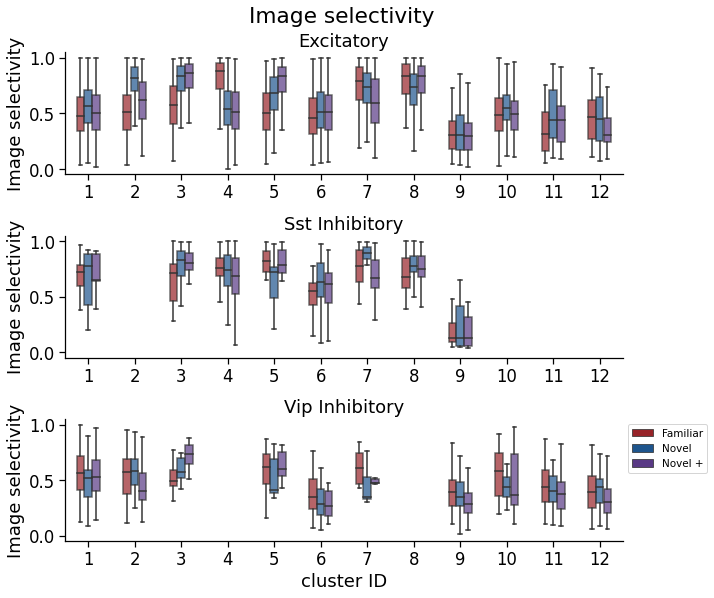

In [ ]:
metric = 'lifetime_sparseness'

order = np.arange(0, n_clusters+1, 1)

figsize = (10, 9)
fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=True, sharex=False)
for i, cre_line in enumerate(cre_lines):
    data = pref_stim_response_metrics[pref_stim_response_metrics.cre_line==cre_line]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order, showfliers=False,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                width=0.5, boxprops=dict(alpha=.7), ax=ax[i])
    ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
    ax[i].get_legend().remove()
    ax[i].set_xlabel('')
    ax[i].set_ylabel('Image selectivity')
    ax[i].set_xticks(order+1)
    ax[i].set_xlim((0.5, n_clusters+0.5))
    ax[i].spines[['right', 'top']].set_visible(False)
ax[i].set_xlabel('cluster ID')  
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.suptitle('Image selectivity', x=0.51, y=0.95)
plt.subplots_adjust(hspace=0.5)

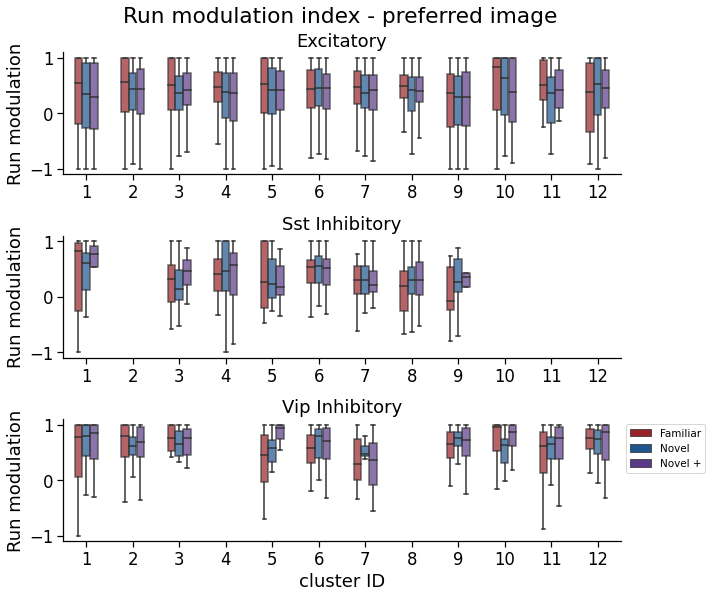

In [ ]:
metric = 'running_modulation_index'

order = np.arange(0, n_clusters+1, 1)

figsize = (10, 9)
fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=True, sharex=False)
for i, cre_line in enumerate(cre_lines):
    data = pref_stim_response_metrics[pref_stim_response_metrics.cre_line==cre_line]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order, showfliers=False,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                width=0.5, boxprops=dict(alpha=.7), ax=ax[i])
    ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
    ax[i].get_legend().remove()
    ax[i].set_xlabel('')
    ax[i].set_ylabel('Run modulation')
    ax[i].set_xticks(order+1)
    ax[i].set_xlim((0.5, n_clusters+0.5))
    ax[i].spines[['right', 'top']].set_visible(False)
ax[i].set_xlabel('cluster ID')  
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.suptitle('Run modulation index - preferred image', x=0.51, y=0.95)
plt.subplots_adjust(hspace=0.5)

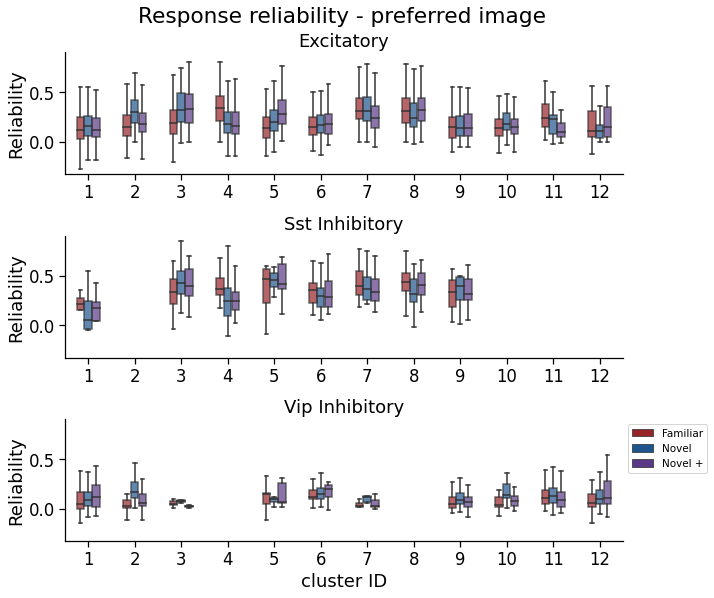

In [ ]:
metric = 'reliability'

order = np.arange(0, n_clusters+1, 1)

figsize = (10, 9)
fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=True, sharex=False)
for i, cre_line in enumerate(cre_lines):
    data = pref_stim_response_metrics[pref_stim_response_metrics.cre_line==cre_line]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order, showfliers=False,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                width=0.5, boxprops=dict(alpha=.7), ax=ax[i])
    ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
    ax[i].get_legend().remove()
    ax[i].set_xlabel('')
    ax[i].set_ylabel('Reliability')
    ax[i].set_xticks(order+1)
    ax[i].set_xlim((0.5, n_clusters+0.5))
    ax[i].spines[['right', 'top']].set_visible(False)
ax[i].set_xlabel('cluster ID')  
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.suptitle('Response reliability - preferred image', x=0.51, y=0.95)
plt.subplots_adjust(hspace=0.5)

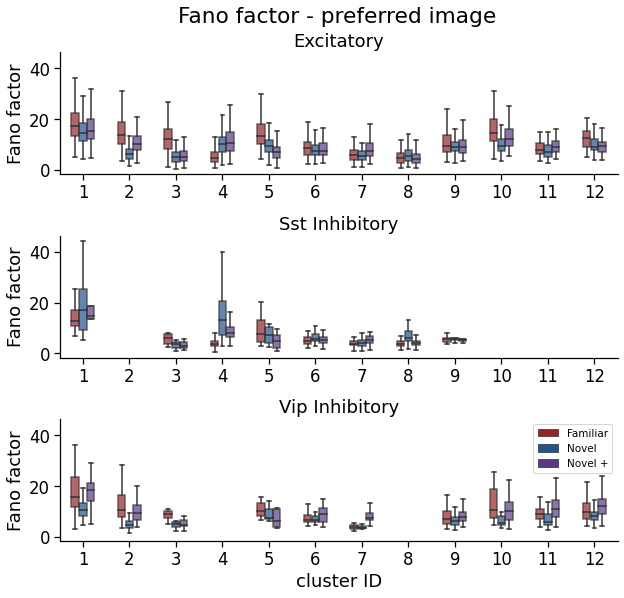

In [ ]:
metric = 'fano_factor'

order = np.arange(0, n_clusters+1, 1)

figsize = (10, 9)
fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=True, sharex=False)
for i, cre_line in enumerate(cre_lines):
    data = pref_stim_response_metrics[pref_stim_response_metrics.cre_line==cre_line]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order, showfliers=False,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                width=0.5, boxprops=dict(alpha=.7), ax=ax[i])
    ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
    ax[i].get_legend().remove()
    ax[i].set_xlabel('')
    ax[i].set_ylabel('Fano factor')
    ax[i].set_xticks(order+1)
    ax[i].set_xlim((0.5, n_clusters+0.5))
    ax[i].spines[['right', 'top']].set_visible(False)
ax[i].set_xlabel('cluster ID')  
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.suptitle('Fano factor - preferred image', x=0.51, y=0.95)
plt.subplots_adjust(hspace=0.5)

### omission responses per cluster 

In [ ]:
data_type = 'filtered_events'

condition = 'omissions'
stimuli = 'all_images'
session_subset = 'full_session'

# set inclusion criteria
# options: ['active_only', 'closest_familiar_and_novel', 'containers_with_all_levels', 'platform_experiment_table']
inclusion_criteria = 'platform_experiment_table'
    
omission_response_metrics = cm.get_cell_metrics_for_conditions(data_type, condition, stimuli, session_subset, inclusion_criteria)
# convert expereience level
omission_response_metrics['experience_level'] = [utils.convert_experience_level(experience_level) for experience_level in omission_response_metrics.experience_level.values]
# limit to matched cells
omission_response_metrics = omission_response_metrics[omission_response_metrics.cell_specimen_id.isin(matched_cells)]


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


removing 1 problematic experiments
there are 402 experiments after filtering for inclusion criteria -  platform_experiment_table


100%|██████████| 402/402 [01:27<00:00,  4.59it/s]
c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\pandas\core\generic.py:2718: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed,key->block1_values] [items->Index(['condition', 'data_type', 'exception', 'filter_events', 'interpolate',
       'ophys_experiment_id', 'session_subset', 'stimuli', 'use_events'],
      dtype='object')]

  encoding=encoding,


there are 402 experiments in the returned cell_metrics table


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)
C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To s

removing 1 problematic experiments


In [ ]:
print(len(omission_response_metrics.mouse_id.unique()), 'mice')
print(len(omission_response_metrics.ophys_experiment_id.unique()), 'experiments')
print(len(omission_response_metrics.cell_specimen_id.unique()), 'cells')


65 mice
393 experiments
3921 cells


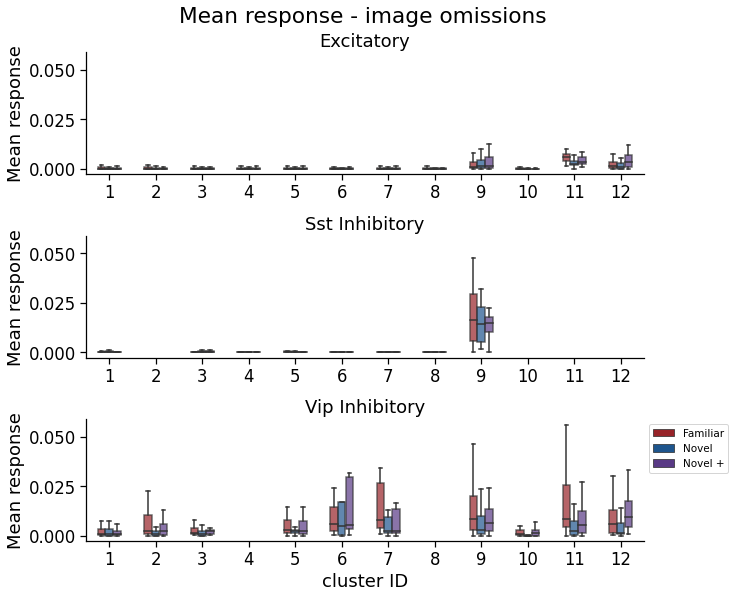

In [ ]:
metric = 'mean_response'

order = np.arange(0, n_clusters+1, 1)

figsize = (10, 9)
fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=True, sharex=False)
for i, cre_line in enumerate(cre_lines):
    data = omission_response_metrics[omission_response_metrics.cre_line==cre_line]
    data = data[data.mean_response<np.percentile(data.mean_response.values, 97)]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order, showfliers=False,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                width=0.5, boxprops=dict(alpha=.7), ax=ax[i])
    ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
    ax[i].get_legend().remove()
    ax[i].set_xlabel('')
    ax[i].set_ylabel('Mean response')
    ax[i].set_xticks(order+1)
    ax[i].set_xlim((0.5, n_clusters+0.5))
    ax[i].spines[['right', 'top']].set_visible(False)
ax[i].set_xlabel('cluster ID')  
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.suptitle('Mean response - image omissions', x=0.51, y=0.95)
plt.subplots_adjust(hspace=0.5)

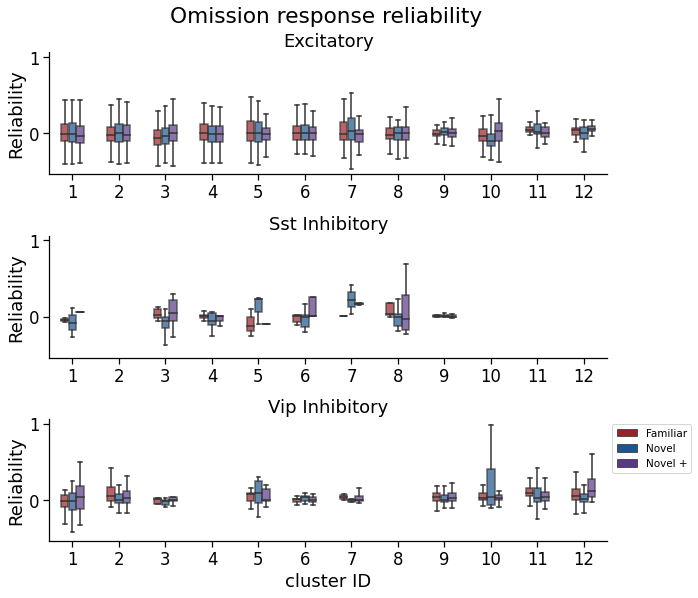

In [ ]:
metric = 'reliability'

order = np.arange(0, n_clusters+1, 1)

figsize = (10, 9)
fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=True, sharex=False)
for i, cre_line in enumerate(cre_lines):
    data = omission_response_metrics[omission_response_metrics.cre_line==cre_line]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order, showfliers=False,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                width=0.5, boxprops=dict(alpha=.7), ax=ax[i])
    ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
    ax[i].get_legend().remove()
    ax[i].set_xlabel('')
    ax[i].set_ylabel('Reliability')
    ax[i].set_xticks(order+1)
    ax[i].set_xlim((0.5, n_clusters+0.5))
    ax[i].spines[['right', 'top']].set_visible(False)
ax[i].set_xlabel('cluster ID')  
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.suptitle('Omission response reliability', x=0.51, y=0.95)
plt.subplots_adjust(hspace=0.5)

### change response metrics

In [ ]:
data_type = 'filtered_events'

condition = 'changes'
stimuli = 'all_images'
session_subset = 'full_session'

# set inclusion criteria
# options: ['active_only', 'closest_familiar_and_novel', 'containers_with_all_levels', 'platform_experiment_table']
inclusion_criteria = 'platform_experiment_table'
    
change_response_metrics = cm.get_cell_metrics_for_conditions(data_type, condition, stimuli, session_subset, inclusion_criteria)

# convert experience level 
change_response_metrics['experience_level'] = [utils.convert_experience_level(experience_level) for experience_level in change_response_metrics.experience_level.values]

# limit to matched cells
change_response_metrics = change_response_metrics[change_response_metrics.cell_specimen_id.isin(matched_cells)]

C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


removing 1 problematic experiments
there are 402 experiments after filtering for inclusion criteria -  platform_experiment_table


100%|██████████| 402/402 [01:18<00:00,  5.14it/s]
c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\pandas\core\generic.py:2718: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed,key->block1_values] [items->Index(['condition', 'data_type', 'exception', 'filter_events', 'interpolate',
       'ophys_experiment_id', 'session_subset', 'stimuli', 'use_events'],
      dtype='object')]

  encoding=encoding,


there are 402 experiments in the returned cell_metrics table


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)
C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To s

removing 1 problematic experiments


In [ ]:
print(len(change_response_metrics.mouse_id.unique()), 'mice')
print(len(change_response_metrics.ophys_experiment_id.unique()), 'experiments')
print(len(change_response_metrics.cell_specimen_id.unique()), 'cells')

# merge with cluster ID
change_response_metrics = change_response_metrics.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cluster_id']], on='cell_specimen_id')

65 mice
393 experiments
3921 cells


In [ ]:
change_response_metrics.keys()

Index(['cell_specimen_id', 'pref_image', 'non_pref_image',
       'image_selectivity_index', 'image_selectivity_index_one_vs_all',
       'lifetime_sparseness', 'mean_response',
       'fraction_significant_p_value_gray_screen', 'fano_factor',
       'reliability', 'running_modulation_index', 'hit_miss_index',
       'is_change', 'change_response', 'pre_change', 'pre_change_response',
       'change_modulation_index', 'ophys_experiment_id', 'condition',
       'session_subset', 'stimuli', 'data_type', 'interpolate',
       'output_sampling_rate', 'response_window', 'equipment_name',
       'full_genotype', 'mouse_id', 'reporter_line', 'driver_line', 'sex',
       'age_in_days', 'cre_line', 'indicator', 'session_number',
       'prior_exposures_to_session_type', 'prior_exposures_to_image_set',
       'prior_exposures_to_omissions', 'ophys_session_id',
       'behavior_session_id', 'ophys_container_id', 'project_code',
       'imaging_depth', 'targeted_structure', 'date_of_acquisition',


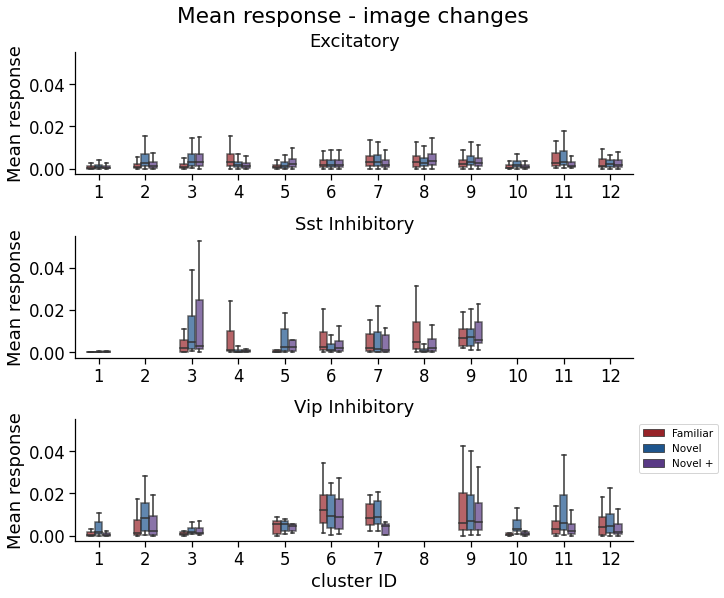

In [ ]:
metric = 'mean_response'

order = np.arange(0, n_clusters+1, 1)

figsize = (10, 9)
fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=True, sharex=False)
for i, cre_line in enumerate(cre_lines):
    data = change_response_metrics[change_response_metrics.cre_line==cre_line]
    data = data[data.mean_response<np.percentile(data.mean_response.values, 97)]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order, showfliers=False,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                width=0.5, boxprops=dict(alpha=.7), ax=ax[i])
    ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
    ax[i].get_legend().remove()
    ax[i].set_xlabel('')
    ax[i].set_ylabel('Mean response')
    ax[i].set_xticks(order+1)
    ax[i].set_xlim((0.5, n_clusters+0.5))
    ax[i].spines[['right', 'top']].set_visible(False)
ax[i].set_xlabel('cluster ID')  
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.suptitle('Mean response - image changes', x=0.51, y=0.95)
plt.subplots_adjust(hspace=0.5)

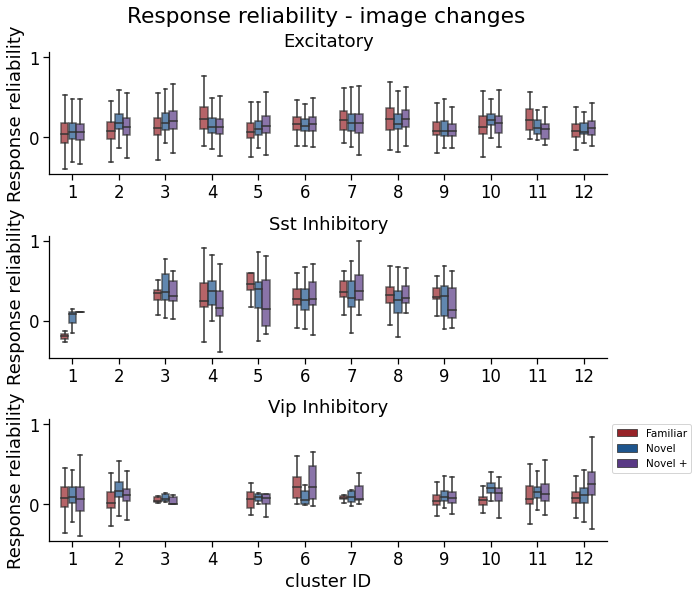

In [ ]:
metric = 'reliability'

order = np.arange(0, n_clusters+1, 1)

figsize = (10, 9)
fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=True, sharex=False)
for i, cre_line in enumerate(cre_lines):
    data = change_response_metrics[change_response_metrics.cre_line==cre_line]
    data = data[data.mean_response<np.percentile(data.mean_response.values, 97)]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order, showfliers=False,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                width=0.5, boxprops=dict(alpha=.7), ax=ax[i])
    ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
    ax[i].get_legend().remove()
    ax[i].set_xlabel('')
    ax[i].set_ylabel('Response reliability')
    ax[i].set_xticks(order+1)
    ax[i].set_xlim((0.5, n_clusters+0.5))
    ax[i].spines[['right', 'top']].set_visible(False)
ax[i].set_xlabel('cluster ID')  
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.suptitle('Response reliability - image changes', x=0.51, y=0.95)
plt.subplots_adjust(hspace=0.5)

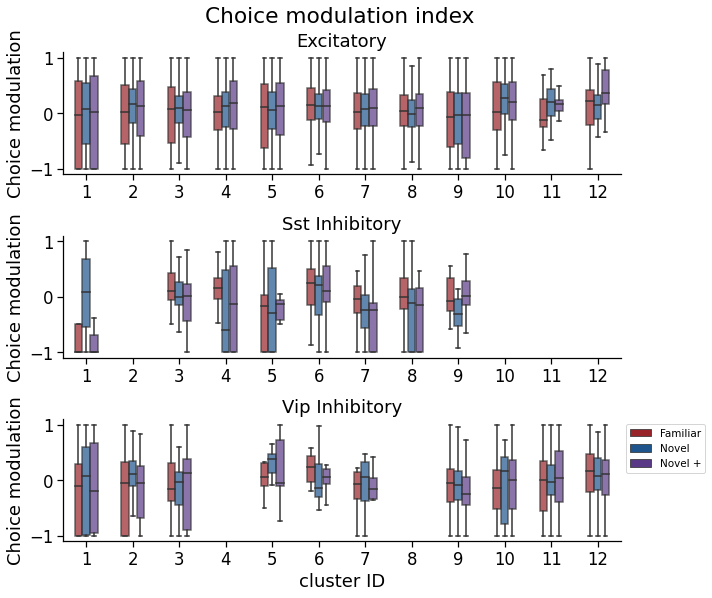

In [ ]:
metric = 'hit_miss_index'

order = np.arange(0, n_clusters+1, 1)

figsize = (10, 9)
fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=True, sharex=False)
for i, cre_line in enumerate(cre_lines):
    data = change_response_metrics[change_response_metrics.cre_line==cre_line]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order, showfliers=False,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                width=0.5, boxprops=dict(alpha=.7), ax=ax[i])
    ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
    ax[i].get_legend().remove()
    ax[i].set_xlabel('')
    ax[i].set_ylabel('Choice modulation')
    ax[i].set_xticks(order+1)
    ax[i].set_xlim((0.5, n_clusters+0.5))
    ax[i].spines[['right', 'top']].set_visible(False)
ax[i].set_xlabel('cluster ID')  
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.suptitle('Choice modulation index', x=0.51, y=0.95)
plt.subplots_adjust(hspace=0.5)

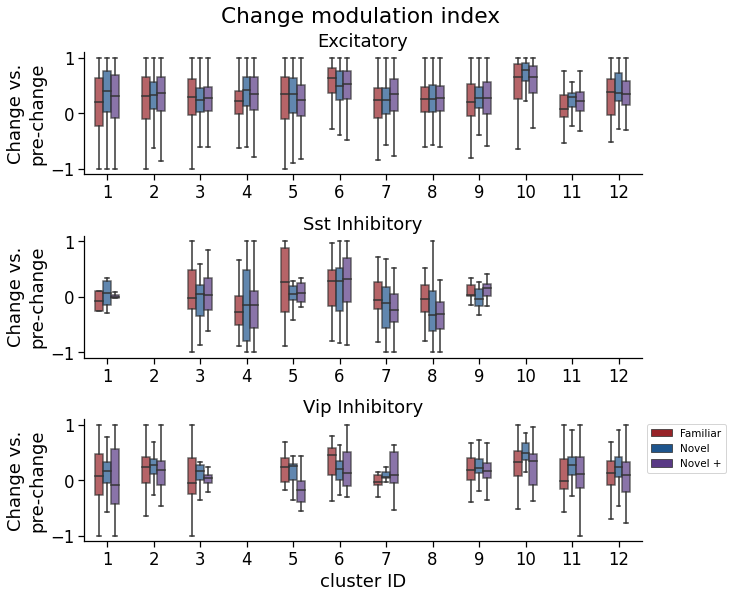

In [ ]:
metric = 'change_modulation_index'

order = np.arange(0, n_clusters+1, 1)

figsize = (10, 9)
fig, ax = plt.subplots(3, 1, figsize=figsize, sharey=True, sharex=False)
for i, cre_line in enumerate(cre_lines):
    data = change_response_metrics[change_response_metrics.cre_line==cre_line]
    ax[i] = sns.boxplot(data=data, x='cluster_id', y=metric, order=order, showfliers=False,
                hue='experience_level', hue_order=experience_levels, palette=experience_level_colors, 
                width=0.5, boxprops=dict(alpha=.7), ax=ax[i])
    ax[i].set_title(utils.convert_cre_line_to_cell_type(cre_line))
    ax[i].get_legend().remove()
    ax[i].set_xlabel('')
    ax[i].set_ylabel('Change vs.\npre-change')
    ax[i].set_xticks(order+1)
    ax[i].set_xlim((0.5, n_clusters+0.5))
    ax[i].spines[['right', 'top']].set_visible(False)
ax[i].set_xlabel('cluster ID')  
ax[i].legend(bbox_to_anchor=(1,1), fontsize='xx-small', title_fontsize='xx-small')

plt.suptitle('Change modulation index', x=0.51, y=0.95)
plt.subplots_adjust(hspace=0.5)

## Correlate model free metrics with coding score metrics

### get coding score metrics per experience level

In [ ]:

def get_coding_score_metrics_per_experience_level(cluster_meta, results_pivoted):
    ''' 
    Takes coding scores from results_pivoted and computes a few additional pieces of information for each cell, 
    including which experience level and feature have the max coding score, a column for the max coding score, and 
    a boolean for rows where the experience level is the preferred experience level

    Returns
        coding_scores: dataframe with one row per cell per experience level, and columns for the coding scores for each feature, 
                        plus information about the preferred feature and experience level for that cell
    '''
    coding_scores = pd.DataFrame()
    for i, cell_specimen_id in enumerate(cluster_meta.index.values):
        cell_scores = results_pivoted[results_pivoted.cell_specimen_id == cell_specimen_id].reset_index().drop(columns='identifier')
        cell_scores_grid = cell_scores.groupby('experience_level').mean()[processing.get_features_for_clustering()]
        # determine which experience level & feature gives largest coding score
        dominant_feature = cell_scores_grid.stack().idxmax()[1]
        dominant_experience_level = cell_scores_grid.stack().idxmax()[0]
        # create column listing the preferred coding score for this cell 
        cell_scores['max_coding_score'] = cell_scores_grid.loc[dominant_experience_level, dominant_feature]
        # create columns listing preferred feature & exp level
        cell_scores['dominant_feature'] = dominant_feature
        cell_scores['dominant_experience_level'] = dominant_experience_level
        # create boolean column for rows where the experience level is the one that has the max coding score
        indices = cell_scores[(cell_scores.experience_level==dominant_experience_level)].index.values
        cell_scores['pref_experience_level'] = False
        cell_scores.at[indices, 'pref_experience_level'] = True
        # move cell specimen id and exp level to front of df
        cell_scores.insert(0, 'cell_specimen_id', cell_scores.pop('cell_specimen_id'))
        cell_scores.insert(1, 'experience_level', cell_scores.pop('experience_level'))
        coding_scores = pd.concat([coding_scores, cell_scores])
    return coding_scores

In [ ]:

def generate_coding_score_metrics_per_experience_level_table(cluster_meta, results_pivoted, save_dir=None):
    '''
    compute metrics on coding scores for each experience level, and across experience levels, per cell, then merge tables
    metrics include things like 'dominant_feature' and 'max_image_coding_score', 'experience_modulation_direction' etc

    output is a table with one row per cell / experience level, limited to cells matched across experience levels
    table includes cluster_id from cluster_meta input table

    cluster_meta: dataframe containing one row per cell_specimen_id with the cluster_id assigned by clustering
    results_pivoted: dataframe containing GLM coding scores for features used in clustering
    '''

    # if metrics table already exists, load it, if not, generate and save it
    if save_dir is not None: 
        coding_score_metrics_per_exp_level_filepath = os.path.join(save_dir, 'merged_metrics_table.csv')
    if (save_dir is not None) and (os.path.exists(coding_score_metrics_per_exp_level_filepath)):
        print('loading coding score metrics per experience level table')
        metrics = pd.read_csv(coding_score_metrics_per_exp_level_filepath)
    else:
        # get coding scores per exp level from results_pivoted
        coding_scores_per_exp_level = get_coding_score_metrics_per_experience_level(cluster_meta, results_pivoted)
        print(coding_scores_per_exp_level.experience_level.unique())

        # get coding score metrics for each cell (metrics computed across experience levels, one row per cell)
        coding_score_metrics = processing.get_cell_metrics(cluster_meta, results_pivoted)
        coding_score_metrics['experience_level'] = coding_score_metrics.dominant_experience_level

        # merge coding score metrics per experience level with select coding score metrics per cell

        # add columns with the dominant feature and exp level determined based on the cluster each cell belongs to
        # get cluster based dominant feature & exp from coding score metrics table
        coding_score_metrics['dominant_feature_cluster'] = coding_score_metrics.dominant_feature
        coding_score_metrics['dominant_experience_level_cluster'] = coding_score_metrics.dominant_experience_level

        # merge coding scores tables
        metrics = coding_scores_per_exp_level.merge(coding_score_metrics.reset_index()[['cell_specimen_id', 'dominant_feature_cluster',
                                                                'dominant_experience_level_cluster']], on='cell_specimen_id', how='left')
        print(metrics.experience_level.unique())
        # merge in metadata for each cell
        metrics = metrics.merge(cluster_meta.reset_index()[['cell_specimen_id', 'cre_line', 'cluster_id', 'targeted_structure', 
                                                'imaging_depth', 'binned_depth', 'area_binned_depth', 'project_code', 
                                                'mouse_id' ]], on='cell_specimen_id', how='left')

        print(len(metrics.cell_specimen_id.unique()), 'cells in merged coding score metrics per exp level table')
        if save_dir is not None:
            metrics.to_csv(coding_score_metrics_per_exp_level_filepath)
            print('metrics table saved')

    return metrics


In [ ]:

def generate_merged_table_of_model_free_metrics(data_type='filtered_events', session_subset='full_session', inclusion_criteria='platform_experiment_table',
                                                save_dir=None):
    '''
    Load table of cell metrics computed on average image, omission, and change responses,
    rename columns to indicate which type of response the metric is for (ex: 'mean_response_omissions'),
    then merge together all types of table to create a unified table of cell response (i.e. model free) metrics

    if file already exists in save_dir, load it, if not, generate and save it

    input variables are as described in visual_behavior.ophys.response_analysis.cell_metrics.get_cell_metrics_for_conditions()
    '''
    import visual_behavior.ophys.response_analysis.cell_metrics as cm

    merged_model_free_metrics_table_filepath = os.path.join(save_dir, 'merged_coding_score_and_model_free_metrics_table.csv')
    if os.path.exists(merged_model_free_metrics_table_filepath):
        print('loading model free metrics table')
        model_free_metrics = pd.read_csv(merged_model_free_metrics_table_filepath)
    else:
        ### load model free metrics (one row per cell / experience level)

        # all images
        condition = 'images'
        stimuli = 'all_images'   
        response_metrics = cm.get_cell_metrics_for_conditions(data_type, condition, stimuli, session_subset, inclusion_criteria)

        # pref image
        condition = 'images'
        stimuli = 'pref_image'
        pref_stim_response_metrics = cm.get_cell_metrics_for_conditions(data_type, condition, stimuli, session_subset, inclusion_criteria)

        # omissions
        condition = 'omissions'
        stimuli = 'all_images'    
        omission_response_metrics = cm.get_cell_metrics_for_conditions(data_type, condition, stimuli, session_subset, inclusion_criteria)

        # changes
        condition = 'changes'
        stimuli = 'all_images'
        change_response_metrics = cm.get_cell_metrics_for_conditions(data_type, condition, stimuli, session_subset, inclusion_criteria)

        ### merge all tables together

        # rename metrics so its clear what they were computed on (i.e. images vs. omissions vs. changes)
        model_free_metrics = pref_stim_response_metrics.rename(columns={'mean_response':'mean_response_pref_image', 
                                                        'reliability': 'reliability_pref_image', 
                                                        'fano_factor': 'fano_factor_pref_image',
                                                        'running_modulation_index': 'running_modulation_pref_image'})

        # select columns to keep
        model_free_metrics = model_free_metrics[['cell_specimen_id', 'experience_level', 'lifetime_sparseness',
                                    'mean_response_pref_image', 'reliability_pref_image',
                                    'fano_factor_pref_image', 'running_modulation_pref_image']]

        # rename and merge in all image metrics 
        tmp = response_metrics.rename(columns={'mean_response':'mean_response_all_images', 
                                                    'reliability': 'reliability_all_images', 
                                                    'fano_factor': 'fano_factor_all_images', 
                                                    'running_modulation_index': 'running_modulation_all_images'})
        model_free_metrics = model_free_metrics.merge(tmp[['cell_specimen_id', 'experience_level',
                                    'mean_response_all_images', 'reliability_all_images',
                                    'fano_factor_all_images', 'running_modulation_all_images']], on=['cell_specimen_id', 'experience_level'])

        # merge in omission metrics for each exp level
        tmp = omission_response_metrics.rename(columns={'mean_response':'mean_response_omissions', 
                                                        'reliability': 'reliability_omissions',
                                                        'fano_factor': 'fano_factor_omissions',
                                                        'running_modulation_index': 'running_modulation_omissions'})
        model_free_metrics = model_free_metrics.merge(tmp[['cell_specimen_id', 'experience_level',
                                    'mean_response_omissions', 'reliability_omissions',
                                    'fano_factor_omissions', 'running_modulation_omissions',
                                    'omission_modulation_index']], on=['cell_specimen_id', 'experience_level'])
        # merge in change metrics for each exp level
        tmp = change_response_metrics.rename(columns={'mean_response':'mean_response_changes', 
                                                        'reliability': 'reliability_changes',
                                                        'fano_factor': 'fano_factor_changes',
                                                        'running_modulation_index': 'running_modulation_changes'})
        model_free_metrics = model_free_metrics.merge(tmp[['cell_specimen_id', 'experience_level',
                                    'mean_response_changes', 'reliability_changes', 
                                    'fano_factor_changes', 'running_modulation_changes',
                                    'change_modulation_index', 'hit_miss_index']], on=['cell_specimen_id', 'experience_level'])

        # convert experience level
        model_free_metrics['experience_level'] = [utils.convert_experience_level(experience_level) for experience_level in model_free_metrics.experience_level.values]

        # save it 
        print(len(model_free_metrics.cell_specimen_id.unique()), 'cells in merged response metrics table')
        model_free_metrics.to_csv(merged_model_free_metrics_table_filepath)
        print('response metrics table saved')

    return model_free_metrics

Index(['cell_specimen_id', 'experience_level', 'all-images', 'omissions',
       'task', 'behavioral', 'max_coding_score', 'dominant_feature',
       'dominant_experience_level', 'pref_experience_level',
       'dominant_feature_cluster', 'dominant_experience_level_cluster',
       'lifetime_sparseness', 'mean_response_pref_image',
       'reliability_pref_image', 'fano_factor_pref_image',
       'running_modulation_pref_image', 'mean_response_all_images',
       'reliability_all_images', 'fano_factor_all_images',
       'running_modulation_all_images', 'mean_response_omissions',
       'reliability_omissions', 'fano_factor_omissions',
       'running_modulation_omissions', 'omission_modulation_index',
       'mean_response_changes', 'reliability_changes', 'fano_factor_changes',
       'running_modulation_changes', 'change_modulation_index',
       'hit_miss_index'],
      dtype='object')

In [ ]:
# model_free_metrics = generate_merged_table_of_model_free_metrics(data_type='filtered_events', 
#                                                                  session_subset='full_session', 
#                                                                  inclusion_criteria='platform_experiment_table',
#                                                                  save_dir=save_dir)

# cs_metrics = generate_coding_score_metrics_per_experience_level_table(cluster_meta, results_pivoted, save_dir=save_dir)

# m = cs_metrics.merge(model_free_metrics, on=['cell_specimen_id', 'experience_level'], how='left')
# m.head()

#### use function to create or load merged metrics table

In [244]:
metrics = processing.generate_merged_table_of_coding_score_and_model_free_metrics(cluster_meta, results_pivoted,
                                                                 data_type='filtered_events',
                                                                 session_subset='full_session',
                                                                 inclusion_criteria='platform_experiment_table',
                                                                 save_dir=save_dir)

C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


removing 1 problematic experiments
there are 402 experiments after filtering for inclusion criteria -  platform_experiment_table


  8%|▊         | 33/402 [00:08<01:54,  3.24it/s]

problem for experiment 891994418


 12%|█▏        | 50/402 [00:11<01:03,  5.56it/s]

problem for experiment 948507789


 22%|██▏       | 90/402 [00:21<01:03,  4.93it/s]

problem for experiment 994790561


 34%|███▍      | 138/402 [00:34<00:59,  4.41it/s]

problem for experiment 993369859


 36%|███▌      | 144/402 [00:35<00:40,  6.40it/s]

problem for experiment 993891845


 38%|███▊      | 154/402 [00:37<00:42,  5.86it/s]

problem for experiment 994082680


 45%|████▌     | 182/402 [00:43<00:51,  4.28it/s]

problem for experiment 851085100


 47%|████▋     | 190/402 [00:45<00:31,  6.70it/s]

problem for experiment 851085109


 48%|████▊     | 191/402 [00:45<00:34,  6.03it/s]

problem for experiment 851085105


 50%|█████     | 203/402 [00:47<00:43,  4.56it/s]

problem for experiment 991852002


 52%|█████▏    | 209/402 [00:49<00:52,  3.65it/s]

problem for experiment 991852001


 54%|█████▍    | 218/402 [00:51<00:39,  4.69it/s]

problem for experiment 991852004


 55%|█████▍    | 221/402 [00:51<00:32,  5.60it/s]

problem for experiment 991852005


 65%|██████▍   | 260/402 [01:01<00:29,  4.77it/s]

problem for experiment 977978321


 68%|██████▊   | 272/402 [01:04<00:28,  4.60it/s]

problem for experiment 981178537


 69%|██████▉   | 279/402 [01:05<00:26,  4.58it/s]

problem for experiment 882551935


 71%|███████   | 285/402 [01:07<00:28,  4.14it/s]

problem for experiment 882551937


 72%|███████▏  | 290/402 [01:07<00:18,  6.12it/s]

problem for experiment 882551947


 73%|███████▎  | 295/402 [01:08<00:16,  6.48it/s]

problem for experiment 951213203


 81%|████████  | 324/402 [01:15<00:19,  3.92it/s]

problem for experiment 1050762972


 82%|████████▏ | 328/402 [01:16<00:15,  4.78it/s]

problem for experiment 1051249031
problem for experiment 1051423446


 87%|████████▋ | 348/402 [01:32<00:15,  3.55it/s]

problem for experiment 1076776838


 90%|█████████ | 362/402 [01:36<00:09,  4.33it/s]

problem for experiment 1078904675


 92%|█████████▏| 371/402 [01:38<00:07,  4.25it/s]

problem for experiment 1077597082


 94%|█████████▎| 376/402 [01:38<00:04,  6.32it/s]

problem for experiment 1082841182


100%|██████████| 402/402 [01:46<00:00,  3.79it/s]
c:\Users\marinag\Anaconda3\envs\visual_behavior_sdk\lib\site-packages\pandas\core\generic.py:2718: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed,key->block1_values] [items->Index(['condition', 'data_type', 'exception', 'filter_events', 'interpolate',
       'ophys_experiment_id', 'session_subset', 'stimuli', 'use_events'],
      dtype='object')]

  encoding=encoding,


there are 376 experiments in the returned cell_metrics table


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)
C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To s

removing 1 problematic experiments


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


removing 1 problematic experiments
there are 402 experiments after filtering for inclusion criteria -  platform_experiment_table


  9%|▊         | 35/402 [00:06<01:02,  5.83it/s]

problem for experiment 891994418


 12%|█▏        | 50/402 [00:09<01:08,  5.14it/s]

problem for experiment 948507789


 23%|██▎       | 92/402 [00:19<00:48,  6.41it/s]

problem for experiment 994790561


 35%|███▍      | 140/402 [00:29<00:43,  6.05it/s]

problem for experiment 993369859


 36%|███▌      | 144/402 [00:30<00:37,  6.87it/s]

problem for experiment 993891845


 38%|███▊      | 152/402 [00:32<00:45,  5.48it/s]

problem for experiment 993369863


 38%|███▊      | 154/402 [00:32<00:36,  6.88it/s]

problem for experiment 994082680


 45%|████▌     | 182/402 [00:38<00:50,  4.33it/s]

problem for experiment 851085100


 47%|████▋     | 188/402 [00:39<00:44,  4.79it/s]

problem for experiment 851085109


 48%|████▊     | 191/402 [00:41<01:12,  2.90it/s]

problem for experiment 851085105


 51%|█████     | 205/402 [00:44<00:34,  5.70it/s]

problem for experiment 991852002


 52%|█████▏    | 211/402 [00:45<00:32,  5.94it/s]

problem for experiment 991852001


 54%|█████▍    | 218/402 [00:47<00:38,  4.73it/s]

problem for experiment 991852004


 55%|█████▍    | 221/402 [00:47<00:33,  5.47it/s]

problem for experiment 991852005


 64%|██████▍   | 258/402 [00:57<00:32,  4.41it/s]

problem for experiment 977978321


 68%|██████▊   | 274/402 [01:00<00:20,  6.28it/s]

problem for experiment 981178537


 70%|██████▉   | 281/402 [01:01<00:18,  6.49it/s]

problem for experiment 882551935


 71%|███████▏  | 287/402 [01:02<00:16,  7.12it/s]

problem for experiment 882551937


 72%|███████▏  | 288/402 [01:03<00:18,  6.26it/s]

problem for experiment 882551947


 73%|███████▎  | 295/402 [01:04<00:15,  6.72it/s]

problem for experiment 951213203


 80%|████████  | 322/402 [01:10<00:16,  4.72it/s]

problem for experiment 1050762972


 81%|████████  | 326/402 [01:11<00:14,  5.17it/s]

problem for experiment 1051249031


 82%|████████▏ | 330/402 [01:11<00:10,  7.06it/s]

problem for experiment 1051423446


 86%|████████▌ | 346/402 [01:15<00:12,  4.45it/s]

problem for experiment 1076776838


 90%|█████████ | 362/402 [01:19<00:09,  4.30it/s]

problem for experiment 1078904675


 93%|█████████▎| 373/402 [01:20<00:04,  6.13it/s]

problem for experiment 1077597082


 93%|█████████▎| 374/402 [01:21<00:06,  4.63it/s]

problem for experiment 1082841182


100%|██████████| 402/402 [01:27<00:00,  4.60it/s]


there are 375 experiments in the returned cell_metrics table


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)
C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To s

removing 1 problematic experiments


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


removing 1 problematic experiments
there are 402 experiments after filtering for inclusion criteria -  platform_experiment_table


 20%|██        | 82/402 [00:16<00:42,  7.56it/s]

problem for experiment 988542529
problem for experiment 989191384


 23%|██▎       | 92/402 [00:18<00:47,  6.49it/s]

problem for experiment 994790561


 29%|██▉       | 117/402 [00:24<00:50,  5.69it/s]

problem for experiment 877669822


 38%|███▊      | 154/402 [00:33<00:45,  5.39it/s]

problem for experiment 994082680


 51%|█████     | 205/402 [00:45<00:35,  5.47it/s]

problem for experiment 991852002


 52%|█████▏    | 211/402 [00:46<00:33,  5.70it/s]

problem for experiment 991852001


 55%|█████▍    | 220/402 [00:48<00:30,  5.95it/s]

problem for experiment 991852004


 55%|█████▌    | 223/402 [00:48<00:26,  6.74it/s]

problem for experiment 991852005


 64%|██████▍   | 258/402 [00:58<00:30,  4.75it/s]

problem for experiment 977978321


 68%|██████▊   | 272/402 [01:01<00:28,  4.56it/s]

problem for experiment 981178537


 72%|███████▏  | 288/402 [01:04<00:15,  7.23it/s]

problem for experiment 882551937
problem for experiment 882968566


 72%|███████▏  | 290/402 [01:04<00:14,  7.80it/s]

problem for experiment 882551947


 77%|███████▋  | 309/402 [01:09<00:23,  4.04it/s]

problem for experiment 1043831389


 82%|████████▏ | 328/402 [01:13<00:13,  5.69it/s]

problem for experiment 1051249031
problem for experiment 1051423446


 91%|█████████ | 364/402 [01:21<00:07,  4.97it/s]

problem for experiment 1078904675


100%|██████████| 402/402 [01:32<00:00,  4.37it/s]


there are 384 experiments in the returned cell_metrics table


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)
C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To s

removing 1 problematic experiments


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)


removing 1 problematic experiments
there are 402 experiments after filtering for inclusion criteria -  platform_experiment_table


  9%|▊         | 35/402 [00:06<01:05,  5.60it/s]

problem for experiment 891994418


 12%|█▏        | 48/402 [00:09<01:10,  5.02it/s]

problem for experiment 948507789


 22%|██▏       | 90/402 [00:19<01:24,  3.71it/s]

problem for experiment 994790561


 35%|███▍      | 140/402 [00:30<00:47,  5.56it/s]

problem for experiment 993369859


 35%|███▌      | 142/402 [00:31<00:53,  4.86it/s]

problem for experiment 993891845


 38%|███▊      | 152/402 [00:33<00:52,  4.75it/s]

problem for experiment 994082680


 46%|████▌     | 184/402 [00:40<00:39,  5.59it/s]

problem for experiment 851085100


 47%|████▋     | 188/402 [00:41<00:52,  4.07it/s]

problem for experiment 851085109


 48%|████▊     | 193/402 [00:42<00:34,  6.10it/s]

problem for experiment 851085105


 51%|█████     | 205/402 [00:44<00:30,  6.49it/s]

problem for experiment 991852002


 52%|█████▏    | 211/402 [00:45<00:32,  5.84it/s]

problem for experiment 991852001


 54%|█████▍    | 218/402 [00:47<00:36,  5.08it/s]

problem for experiment 991852004


 55%|█████▌    | 223/402 [00:48<00:26,  6.84it/s]

problem for experiment 991852005


 65%|██████▍   | 260/402 [00:55<00:22,  6.33it/s]

problem for experiment 977978321


 68%|██████▊   | 274/402 [00:58<00:20,  6.23it/s]

problem for experiment 981178537


 69%|██████▉   | 279/402 [00:59<00:24,  5.02it/s]

problem for experiment 882551935


 71%|███████▏  | 287/402 [01:00<00:20,  5.50it/s]

problem for experiment 882551937


 72%|███████▏  | 290/402 [01:01<00:18,  6.00it/s]

problem for experiment 882551947


 73%|███████▎  | 293/402 [01:02<00:21,  5.11it/s]

problem for experiment 951213203


 80%|████████  | 322/402 [01:09<00:17,  4.45it/s]

problem for experiment 1050762972


 81%|████████  | 326/402 [01:09<00:14,  5.20it/s]

problem for experiment 1051249031


 82%|████████▏ | 328/402 [01:10<00:11,  6.18it/s]

problem for experiment 1051423446


 87%|████████▋ | 348/402 [01:14<00:11,  4.89it/s]

problem for experiment 1076776838


 90%|█████████ | 362/402 [01:18<00:10,  3.94it/s]

problem for experiment 1078904675


 92%|█████████▏| 371/402 [01:20<00:08,  3.64it/s]

problem for experiment 1077597082


 94%|█████████▎| 376/402 [01:21<00:04,  5.45it/s]

problem for experiment 1082841182


100%|██████████| 402/402 [01:28<00:00,  4.54it/s]


there are 376 experiments in the returned cell_metrics table


C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To see the changes between the two versions of the dataset, run
VisualBehaviorOphysProjectCache.compare_manifests('visual-behavior-ophys_project_manifest_v1.0.1.json', 'visual-behavior-ophys_project_manifest_v1.1.0.json')
To load another version of the dataset, run
VisualBehaviorOphysProjectCache.load_manifest('visual-behavior-ophys_project_manifest_v1.1.0.json')
  warnings.warn(msg, OutdatedManifestWarning)
C:\Users\marinag\Documents\Code\AllenSDK\allensdk\api\cloud_cache\cloud_cache.py:521: OutdatedManifestWarning: You are loading visual-behavior-ophys_project_manifest_v1.0.1.json. A more up to date version of the dataset -- visual-behavior-ophys_project_manifest_v1.1.0.json -- exists online. To s

removing 1 problematic experiments
14035 cells in merged response metrics table
response metrics table saved
['Familiar' 'Novel' 'Novel +']


C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1879: RuntimeWarning: invalid value encountered in double_scalars
  stats.loc[index_value, 'exp_mod_direction'] = exp_mod_direction
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1879: RuntimeWarning: divide by zero encountered in double_scalars
  stats.loc[index_value, 'exp_mod_direction'] = exp_mod_direction
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1856: RuntimeWarning: invalid value encountered in double_scalars
  # experience selectivity is ratio of largest and average of all other dropouts for the dominant feature
C:\Users\marinag\Documents\Code\visual_behavior_analysis\visual_behavior\dimensionality_reduction\clustering\processing.py:1860: RuntimeWarning: invalid value encountered in double_scalars
  sta

['Familiar' 'Novel' 'Novel +']
3901 cells in merged coding score metrics per exp level table
metrics table saved
3901 cells in merged coding score and model free metrics table
merged metrics table saved


In [241]:
metrics.head()

,cell_specimen_id,experience_level,all-images,omissions,task,behavioral,max_coding_score,dominant_feature,dominant_experience_level,pref_experience_level,...,reliability_omissions,fano_factor_omissions,running_modulation_omissions,omission_modulation_index,mean_response_changes,reliability_changes,fano_factor_changes,running_modulation_changes,change_modulation_index,hit_miss_index
0,1086489847,Familiar,0.000000,0.000000,0.000000,0.000000,0.971563,behavioral,Novel +,False,...,0.207706,0.005503,1.000000,0.236083,0.000409,0.059171,11.873009,0.966062,0.158500,-1.000000
1,1086489847,Novel,0.060457,0.000000,0.004045,0.084897,0.971563,behavioral,Novel +,False,...,0.138590,0.004321,0.809736,-0.437343,0.000919,0.040111,6.571821,1.000000,0.553210,-0.487474
2,1086489847,Novel +,0.017832,0.000000,0.009827,0.971563,0.971563,behavioral,Novel +,True,...,0.370170,14.642192,1.000000,NaN,0.000717,0.055535,9.922126,0.999194,0.114330,-0.770604
3,1086489860,Familiar,0.000000,0.000000,0.000000,0.000000,0.910349,all-images,Novel,False,...,-0.096350,0.021461,-0.999056,0.758859,0.000367,0.236166,12.894412,0.520983,0.198686,0.030793
4,1086489860,Novel,0.910349,0.109417,0.000000,0.000000,0.910349,all-images,Novel,True,...,0.984905,0.000219,-1.000000,-0.995171,0.000850,0.109113,8.109726,0.100698,0.570924,0.384290


In [242]:
metrics.experience_level.unique()

array(['Familiar', 'Novel', 'Novel +'], dtype=object)

In [243]:
len(metrics.cell_specimen_id.unique())

3901

#### plot metric distributions for cluster types - boxplot

In [245]:
def get_feature_colors_and_labels(): 
    c = sns.color_palette()
    feature_colors = [c[2], c[9], c[1], c[8]]

    feature_labels_dict = {'all-images': 'images', 
                         'omissions': 'omissions', 
                         'behavioral': 'behavior', 
                         'task': 'task'}
    return feature_colors, feature_labels_dict

cell_type_labels = [utils.get_abbreviated_cell_type(cre_line) for cre_line in cre_lines]

In [246]:
feature_colors, feature_labels_dict = get_feature_colors_and_labels()
features = feature_labels_dict.keys()
feature_labels = feature_labels_dict.values()

In [247]:
feature_labels

dict_values(['images', 'omissions', 'behavior', 'task'])

#### running modulation

In [271]:
def plot_barplot_of_metric_value_for_pref_feature(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None):
    ''' 
    Plots mean and CI of metric distribution with preferred feature on y axis and metric value on x
    values averaged across cre lines

    metrics is a merged table of coding score metrics & model free metrics, computed using 
     processing.generate_merged_table_of_coding_score_and_model_free_metrics()

    x is a column in metrics table
    xlabel is the string used for plotting 
    '''
    feature_colors, feature_labels_dict = get_feature_colors_and_labels()
    features = list(feature_labels_dict.keys())
    feature_labels = list(feature_labels_dict.values())
    

    # limit metrics to the preferred experience level for each cell so each cell only counts once
    data = metrics[metrics.pref_experience_level==True].copy()
    # data = metrics.copy()

    if ax is None: 
        figsize = (3,2.5)
        fig, ax = plt.subplots(figsize=figsize)
    ax = sns.barplot(data=data, y='dominant_feature_cluster', x=x, 
                    orient='h', order=features, palette=feature_colors, width=0.8, alpha=0.8, ax=ax,)
    ax.legend(fontsize='x-small', bbox_to_anchor=(1,1))
    if xlabel is None: 
        xlabel = x
    ax.set_xlabel(xlabel)
    ax.set_ylabel('preferred feature')
    ax.set_yticklabels(feature_labels, rotation=0);

    if save_dir: 
        filename = 'metric_dist_for_pref_feature_barplot_'+x
        utils.save_figure(fig, figsize, os.path.join(save_dir, folder), 'metric_distributions', filename)
    return ax


In [273]:

### each cre
def plot_boxplot_of_metric_value_for_pref_feature_by_cre(metrics, x, xlabel=None,
                                                  save_dir=None, folder=None, ax=None):
    ''' 
    Plots mean and CI of metric distribution with cre lines on y axis, metric value on x, 
    and preferred feature indicated via hues
    
    metrics is a merged table of coding score metrics & model free metrics, computed using 
     processing.generate_merged_table_of_coding_score_and_model_free_metrics()

    x is a column in metrics table
    xlabel is the string used for plotting 
    '''
    feature_colors, feature_labels_dict = get_feature_colors_and_labels()
    features = list(feature_labels_dict.keys())
    feature_labels = list(feature_labels_dict.values())
    cell_type_labels = [utils.get_abbreviated_cell_type(cre_line) for cre_line in cre_lines]

    # limit metrics to the preferred experience level for each cell so each cell only counts once
    data = metrics[metrics.pref_experience_level==True]

    if ax is None: 
        figsize = (4,2.5)
        fig, ax = plt.subplots(figsize=figsize)
    ax = sns.boxplot(data=data, y='cre_line', x=x, 
                    orient='h', order=cre_lines, width=0.8, ax=ax, boxprops=dict(alpha=.7),
                    hue='dominant_feature_cluster', hue_order=features, palette=feature_colors)
    ax.legend(fontsize='x-small', bbox_to_anchor=(1,1))
    if xlabel is None: 
        xlabel = x
    ax.set_xlabel(xlabel)
    ax.set_ylabel('')
    ax.set_yticklabels(cell_type_labels, rotation=0);

    if save_dir: 
        filename = 'metric_dist_for_pref_feature_boxplot_split_by_cre_'+x
        utils.save_figure(fig, figsize, os.path.join(save_dir, folder), 'metric_distributions', filename)
    return ax

No handles with labels found to put in legend.


<AxesSubplot:xlabel='running modulation index'>

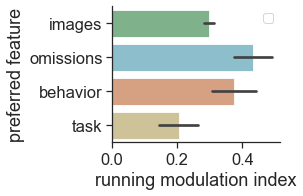

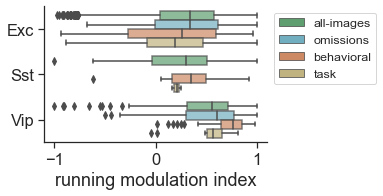

In [293]:
x = 'running_modulation_all_images'
xlabel = 'running modulation index'

plotting.plot_barplot_of_metric_value_for_pref_feature(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)


plotting.plot_boxplot_of_metric_value_for_pref_feature_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)


In [286]:
utils.get_new_experience_levels()

['Familiar', 'Novel', 'Novel +']

In [289]:
def plot_barplot_of_metric_value_for_pref_exp_level(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None):
    ''' 
    Plots mean and CI of metric distribution with preferred feature on y axis and metric value on x
    values averaged across cre lines

    metrics is a merged table of coding score metrics & model free metrics, computed using 
     processing.generate_merged_table_of_coding_score_and_model_free_metrics()

    x is a column in metrics table
    xlabel is the string used for plotting 
    '''
    experience_levels = utils.get_new_experience_levels()
    experience_level_colors = utils.get_experience_level_colors()

    # only look at metric values for max exp level & pref feature
    data = metrics.copy()
    data = data[(data.dominant_experience_level_cluster==data.experience_level)]
    
    if ax is None: 
        figsize = (3,2.5)
        fig, ax = plt.subplots(figsize=figsize)
    ax = sns.barplot(data=data, y='dominant_experience_level_cluster', x=x, 
                    orient='h', order=experience_levels, palette=experience_level_colors, width=0.8, alpha=0.8, ax=ax,)
    ax.legend(fontsize='x-small', bbox_to_anchor=(1,1))
    if xlabel is None: 
        xlabel = x
    ax.set_xlabel(xlabel)
    ax.set_ylabel('max experience level')
    ax.set_yticklabels(experience_levels, rotation=0);

    if save_dir: 
        filename = 'metric_dist_for_max_exp_level_barplot_'+x
        utils.save_figure(fig, figsize, os.path.join(save_dir, folder), 'metric_distributions', filename)
    return ax


### each cre
def plot_boxplot_of_metric_value_for_pref_exp_level_by_cre(metrics, x, xlabel=None,
                                                  save_dir=None, folder=None, ax=None):
    ''' 
    Plots mean and CI of metric distribution with cre lines on y axis, metric value on x, 
    and preferred feature indicated via hues
    
    metrics is a merged table of coding score metrics & model free metrics, computed using 
     processing.generate_merged_table_of_coding_score_and_model_free_metrics()

    x is a column in metrics table
    xlabel is the string used for plotting 
    '''
    experience_levels = utils.get_new_experience_levels()
    experience_level_colors = utils.get_experience_level_colors()
    cell_type_labels = [utils.get_abbreviated_cell_type(cre_line) for cre_line in cre_lines]

    # only look at metric values for max exp level & pref feature
    data = metrics.copy()
    data = data[(data.dominant_experience_level_cluster==data.experience_level)]

    if ax is None: 
        figsize = (4,2.5)
        fig, ax = plt.subplots(figsize=figsize)
    ax = sns.boxplot(data=data, y='cre_line', x=x, 
                    orient='h', order=cre_lines, width=0.8, ax=ax, boxprops=dict(alpha=.7),
                    hue='dominant_experience_level_cluster', hue_order=experience_levels, palette=experience_level_colors)
    ax.legend(fontsize='x-small', bbox_to_anchor=(1,1))
    if xlabel is None: 
        xlabel = x
    ax.set_xlabel(xlabel)
    ax.set_ylabel('')
    ax.set_yticklabels(cell_type_labels, rotation=0);

    if save_dir: 
        filename = 'metric_dist_for_pref_exp_level_boxplot_split_by_cre_'+x
        utils.save_figure(fig, figsize, os.path.join(save_dir, folder), 'metric_distributions', filename)
    return ax

No handles with labels found to put in legend.


<AxesSubplot:xlabel='running modulation index'>

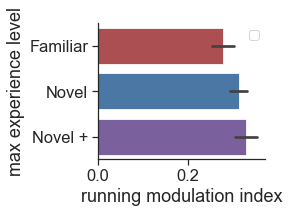

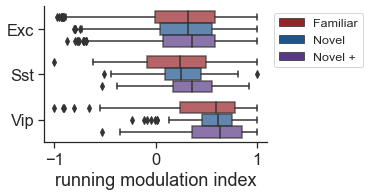

In [294]:
x = 'running_modulation_all_images'
xlabel = 'running modulation index'

plotting.plot_barplot_of_metric_value_for_pref_feature(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)

plotting.plot_boxplot_of_metric_value_for_pref_feature_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)


plotting.plot_barplot_of_metric_value_for_pref_exp_level(metrics, x, xlabel,
                                                  save_dir=None, folder=None)

plotting.plot_boxplot_of_metric_value_for_pref_exp_level_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None)


No handles with labels found to put in legend.


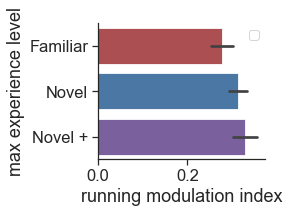

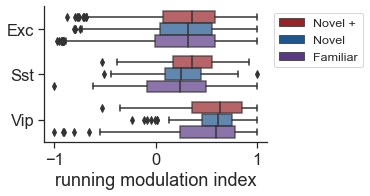

In [279]:
data = metrics.copy()

# only look at metric values for max exp level & pref feature
data = data[(data.dominant_experience_level_cluster==data.experience_level)]

### all cre 
figsize = (3,2.5)
fig, ax = plt.subplots(figsize=figsize)
ax = sns.barplot(data=data, y='dominant_experience_level_cluster', x='running_modulation_all_images', 
                 orient='h', order=experience_levels, palette=experience_level_colors, width=0.8, alpha=0.8, ax=ax,)
ax.legend(fontsize='x-small', bbox_to_anchor=(1,1))
ax.set_xlabel('running modulation index')
ax.set_ylabel('max experience level')
# ax.set_yticklabels(xticklabels, rotation=0);


### each cre
figsize = (4,2.5)
fig, ax = plt.subplots(figsize=figsize)
ax = sns.boxplot(data=data, y='cre_line', x=x, 
                 orient='h', order=cre_lines, width=0.8, ax=ax, boxprops=dict(alpha=.7),
                 hue='dominant_experience_level_cluster', palette=experience_level_colors)
ax.legend(fontsize='x-small', bbox_to_anchor=(1,1))
ax.set_xlabel(xlabel)
ax.set_ylabel('')
ax.set_yticklabels(cell_type_labels, rotation=0);

#### lifetime sparseness

No handles with labels found to put in legend.
No handles with labels found to put in legend.


<AxesSubplot:xlabel='image selectivity'>

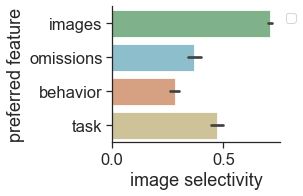

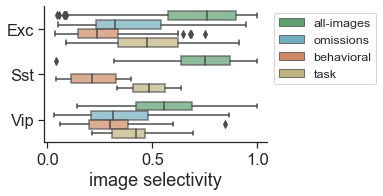

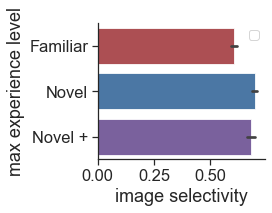

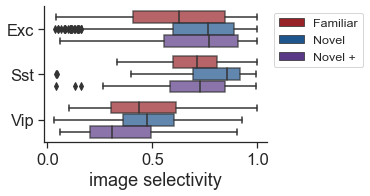

In [295]:
x = 'lifetime_sparseness'
xlabel = 'image selectivity'


plotting.plot_barplot_of_metric_value_for_pref_feature(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)

plotting.plot_boxplot_of_metric_value_for_pref_feature_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)


plotting.plot_barplot_of_metric_value_for_pref_exp_level(metrics, x, xlabel,
                                                  save_dir=None, folder=None)

plotting.plot_boxplot_of_metric_value_for_pref_exp_level_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None)

#### reliability

No handles with labels found to put in legend.
No handles with labels found to put in legend.


<AxesSubplot:xlabel='image response reliability'>

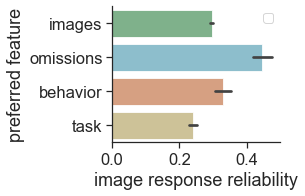

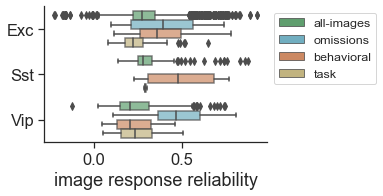

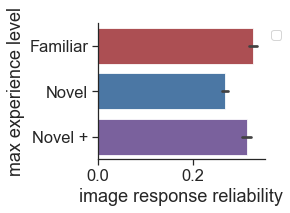

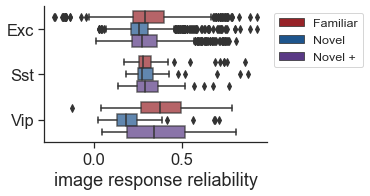

In [296]:
x = 'reliability_pref_image'
xlabel = 'image response reliability'

plotting.plot_barplot_of_metric_value_for_pref_feature(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)

plotting.plot_boxplot_of_metric_value_for_pref_feature_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)


plotting.plot_barplot_of_metric_value_for_pref_exp_level(metrics, x, xlabel,
                                                  save_dir=None, folder=None)

plotting.plot_boxplot_of_metric_value_for_pref_exp_level_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None)

#### change modulation & hit modulation

No handles with labels found to put in legend.
No handles with labels found to put in legend.


<AxesSubplot:xlabel='change modulation'>

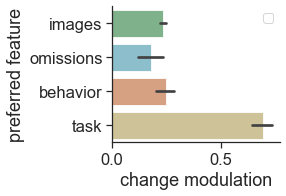

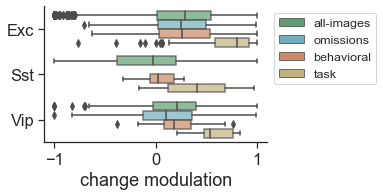

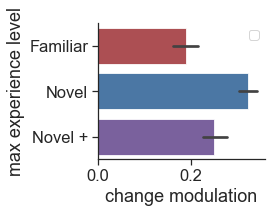

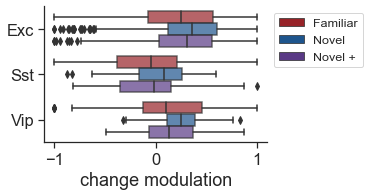

In [297]:
x = 'change_modulation_index'
xlabel = 'change modulation'

plotting.plot_barplot_of_metric_value_for_pref_feature(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)

plotting.plot_boxplot_of_metric_value_for_pref_feature_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)


plotting.plot_barplot_of_metric_value_for_pref_exp_level(metrics, x, xlabel,
                                                  save_dir=None, folder=None)

plotting.plot_boxplot_of_metric_value_for_pref_exp_level_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None)

No handles with labels found to put in legend.
No handles with labels found to put in legend.


<AxesSubplot:xlabel='choice modulation'>

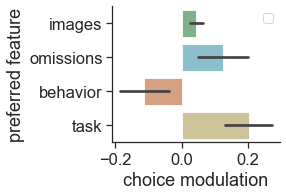

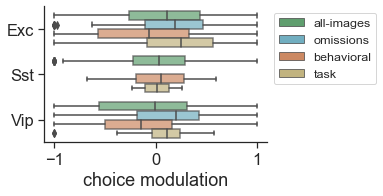

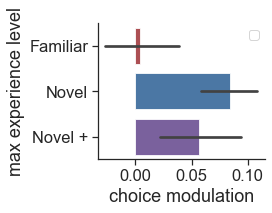

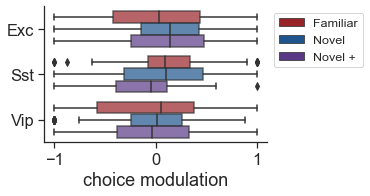

In [298]:
x = 'hit_miss_index'
xlabel = 'choice modulation'

plotting.plot_barplot_of_metric_value_for_pref_feature(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)

plotting.plot_boxplot_of_metric_value_for_pref_feature_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)


plotting.plot_barplot_of_metric_value_for_pref_exp_level(metrics, x, xlabel,
                                                  save_dir=None, folder=None)

plotting.plot_boxplot_of_metric_value_for_pref_exp_level_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None)

#### omission response

No handles with labels found to put in legend.
No handles with labels found to put in legend.


<AxesSubplot:xlabel='omission modulation'>

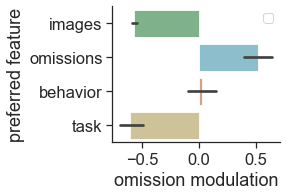

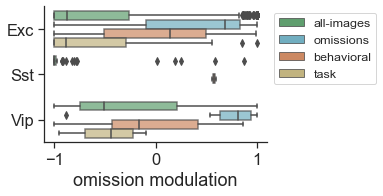

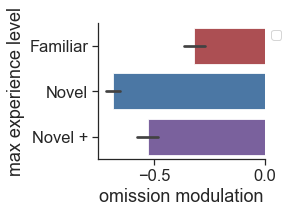

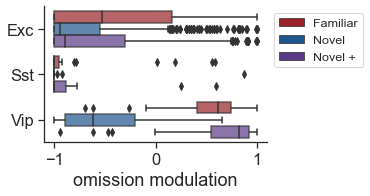

In [299]:
x = 'omission_modulation_index'
xlabel = 'omission modulation'

plotting.plot_barplot_of_metric_value_for_pref_feature(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)

plotting.plot_boxplot_of_metric_value_for_pref_feature_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)


plotting.plot_barplot_of_metric_value_for_pref_exp_level(metrics, x, xlabel,
                                                  save_dir=None, folder=None)

plotting.plot_boxplot_of_metric_value_for_pref_exp_level_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None)

In [ ]:
metrics.columns

Index(['cell_specimen_id', 'experience_level', 'all-images', 'omissions',
       'task', 'behavioral', 'max_coding_score', 'dominant_feature',
       'dominant_experience_level', 'pref_experience_level',
       'dominant_feature_cluster', 'dominant_experience_level_cluster',
       'lifetime_sparseness', 'mean_response_pref_image',
       'reliability_pref_image', 'fano_factor_pref_image',
       'running_modulation_pref_image', 'mean_response_all_images',
       'reliability_all_images', 'fano_factor_all_images',
       'running_modulation_all_images', 'mean_response_omissions',
       'reliability_omissions', 'fano_factor_omissions',
       'running_modulation_omissions', 'omission_modulation_index',
       'mean_response_changes', 'reliability_changes', 'fano_factor_changes',
       'running_modulation_changes', 'change_modulation_index',
       'hit_miss_index', 'cre_line', 'cluster_id', 'targeted_structure',
       'imaging_depth', 'binned_depth', 'area_binned_depth', 'project_cod

No handles with labels found to put in legend.
No handles with labels found to put in legend.


<AxesSubplot:xlabel='omission response'>

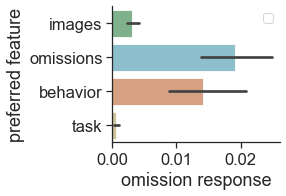

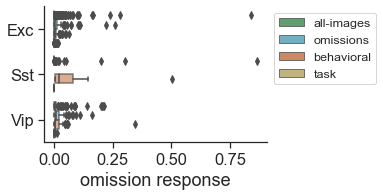

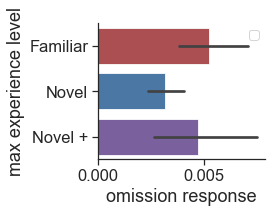

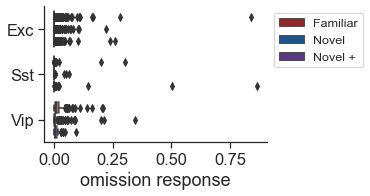

In [300]:
x = 'mean_response_omissions'
xlabel = 'omission response'

plotting.plot_barplot_of_metric_value_for_pref_feature(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)

plotting.plot_boxplot_of_metric_value_for_pref_feature_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None, ax=None)


plotting.plot_barplot_of_metric_value_for_pref_exp_level(metrics, x, xlabel,
                                                  save_dir=None, folder=None)

plotting.plot_boxplot_of_metric_value_for_pref_exp_level_by_cre(metrics, x, xlabel,
                                                  save_dir=None, folder=None)

#### plot metric distributions for cluster types - histplot

In [ ]:
metrics.keys()

Index(['cell_specimen_id', 'experience_level', 'all-images', 'omissions',
       'task', 'behavioral', 'max_coding_score', 'dominant_feature',
       'dominant_experience_level', 'pref_experience_level',
       'dominant_feature_cluster', 'dominant_experience_level_cluster',
       'lifetime_sparseness', 'mean_response_pref_image',
       'reliability_pref_image', 'fano_factor_pref_image',
       'running_modulation_pref_image', 'mean_response_all_images',
       'reliability_all_images', 'fano_factor_all_images',
       'running_modulation_all_images', 'mean_response_omissions',
       'reliability_omissions', 'fano_factor_omissions',
       'running_modulation_omissions', 'omission_modulation_index',
       'mean_response_changes', 'reliability_changes', 'fano_factor_changes',
       'running_modulation_changes', 'change_modulation_index',
       'hit_miss_index', 'cre_line', 'cluster_id', 'targeted_structure',
       'imaging_depth', 'binned_depth', 'area_binned_depth', 'project_cod

In [ ]:
metric='running_modulation_all_images'
xlabel = 'Running modulation index'
title = 'Running modulation by cluster type'
cumulative=True
step = 0.05

# limit metrics to the preferred experience level for each cell so each cell only counts once
data = metrics[metrics.pref_experience_level==True]


def plot_metric_distribution_for_dominant_feature_cluster_types(metrics, metric, cre_line=None, 
                                                                xlabel='', title='', legend=True,
                                                                cumulative=True, step=0.05, linewidth=1,
                                                                save_dir=save_dir, folder=folder, ax=None):
    ''' 
    Plots a distribution of values of a given metric for cells belonging to clusters of each of the 4 types,
    defined by having a dominant feature of (images, omissions, behavioral, task). 
    cluster will be cumulative if cumulative =True, otherwise standard distribution. 
    Also shows rugplot for each feature type under the distribution

    metrics: dataframe where each row is one cell in one experience level, with columns for various metric values computed on each session
                plot will include the metric values for all experience levels for each cell, unless you
                limit metrics table to preferred experience level for each cell prior to passing into the function
    metric: str, column value in metrics to plot distribution of
    cre_line: str or None, if None, plot includes all cre lines, if cre line is provided, distribution will be limited
                to that cre line and the cell type will be added to the plot title and figure handle 
    
    '''
 
    data = metrics.copy()
    # if cre line is provided, limit data to that cre line
    if cre_line is not None: 
        data = data[data.cre_line==cre_line]
        title = title+'\n'+utils.convert_cre_line_to_cell_type(cre_line)

    if ax is None: 
        figsize=(5,5)
        fig, ax = plt.subplots(figsize=figsize)

    c = sns.color_palette('dark')
    colors = [c[6], c[8], c[2], c[9]]
    # colors = sns.color_palette('Spectral', 4)
    n_hues = 4 # there are 4 feature categories

    # y loc values for rugplot
    y_shifts = np.arange(-step, -(step*n_hues+1), -step)

    for i,dominant_feature in enumerate(np.sort(metrics.dominant_feature.unique())):
        ax = sns.histplot(data=data[data.dominant_feature==dominant_feature], x=metric, bins=25,
                    color=colors[i], fill=False, element='step', multiple='stack', label=dominant_feature,
                    common_norm=False, common_bins=True, kde=True, cumulative=cumulative, stat='proportion', 
                    linewidth=linewidth, ax=ax)
        rug_data = data[data.dominant_feature==dominant_feature][metric].values
        # manualy create rugplot
        ax.plot(rug_data, [y_shifts[i]]*len(rug_data), '|', color=colors[i])
    ax.set_ylim(ymin=-(n_hues*step)-step)
    if legend: 
        ax.legend()
        sns.move_legend(ax, "upper left", title='preferred feature', fontsize='x-small', title_fontsize='x-small')
    ax.set_xlabel(xlabel)
    ax.set_title(title)

    if save_dir: 
        filename = metric+'_distribution_for_cluster_types'
        if cre_line is not None: 
            filename = filename+'_'+utils.convert_cre_line_to_cell_type(cre_line).split(' ')[0]
        utils.save_figure(fig, figsize, os.path.join(save_dir, folder), 'metric_distributions', filename)
    return ax


def plot_metric_distribution_for_dominant_feature_cluster_types_per_cre(metrics, metric, 
                                                                        xlabel=xlabel, title=title, linewidth=0.3, 
                                                                        cumulative=cumulative, step=step, legend=False,
                                                                        save_dir=save_dir, folder=folder):
    ''' 
    runs the plotting function plot_metric_distribution_for_dominant_feature_cluster_types 
    on each cre line and places them in a single figure
    '''
    # limit metrics to the preferred experience level for each cell so each cell only counts once
    data = metrics[metrics.pref_experience_level==True]
    
    figsize = (15,5)
    fig, ax = plt.subplots(1, 3, figsize=figsize)
    for i,cre_line in enumerate(cre_lines): 
        cre_data = data[data.cre_line==cre_line]
        ax[i] = plot_metric_distribution_for_dominant_feature_cluster_types(cre_data, metric, cre_line=cre_line, 
                                                                    xlabel=xlabel, title=title, linewidth=linewidth, 
                                                                    cumulative=cumulative, step=step, legend=legend,
                                                                    save_dir=None, folder=folder, ax=ax[i])
    fig.tight_layout()
    filename = metric+'_distribution_for_cluster_types_per_cre_line'
    utils.save_figure(fig, figsize, os.path.join(save_dir, folder), 'metric_distributions', filename)

<AxesSubplot:title={'center':'Running modulation by cluster type'}, xlabel='Running modulation index', ylabel='Proportion'>

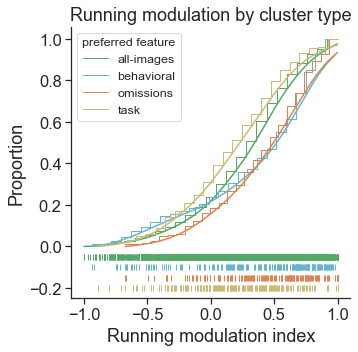

In [304]:
metric='running_modulation_all_images'
xlabel = 'Running modulation index'
title = 'Running modulation by cluster type'
cumulative=True
step = 0.05

# limit metrics to the preferred experience level for each cell so each cell only counts once
data = metrics[metrics.pref_experience_level==True]

plotting.plot_metric_distribution_for_dominant_feature_cluster_types(data, metric, cre_line=None, 
                                                                xlabel=xlabel, title=title, 
                                                                cumulative=cumulative, step=step, 
                                                                save_dir=save_dir, folder=folder, ax=None)

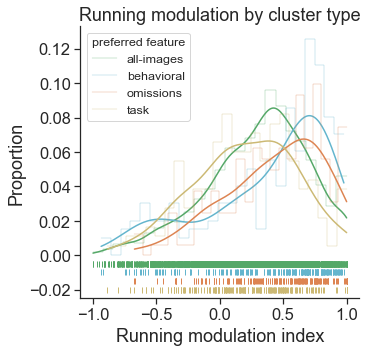

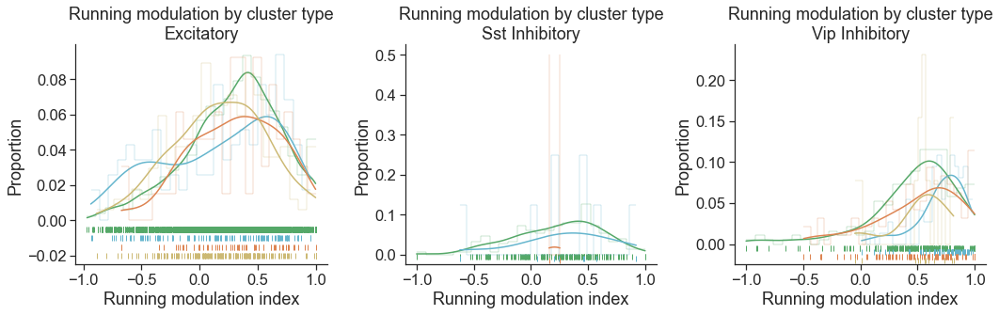

In [307]:
metric='running_modulation_all_images'
xlabel = 'Running modulation index'
title = 'Running modulation by cluster type'
cumulative=False
step = 0.005

# limit metrics to the preferred experience level for each cell so each cell only counts once
data = metrics[metrics.pref_experience_level==True]

plotting.plot_metric_distribution_for_dominant_feature_cluster_types(data, metric, cre_line=None, 
                                                                xlabel=xlabel, title=title, linewidth=0.3, 
                                                                cumulative=cumulative, step=step, 
                                                                save_dir=save_dir, folder=folder, ax=None)

plotting.plot_metric_distribution_for_dominant_feature_cluster_types_per_cre(metrics, metric, 
                                                                    xlabel=xlabel, title=title, linewidth=0.3, 
                                                                    cumulative=cumulative, step=step, legend=False,
                                                                    save_dir=save_dir, folder=folder)

In [312]:
data = metrics[metrics.pref_experience_level==True]
data[data[metric]<np.percentile(data[metric].values, 98)]

,cell_specimen_id,experience_level,all-images,omissions,task,behavioral,max_coding_score,dominant_feature,dominant_experience_level,pref_experience_level,...,reliability_omissions,fano_factor_omissions,running_modulation_omissions,omission_modulation_index,mean_response_changes,reliability_changes,fano_factor_changes,running_modulation_changes,change_modulation_index,hit_miss_index


In [313]:
np.percentile(data[metric].values, 98)

nan

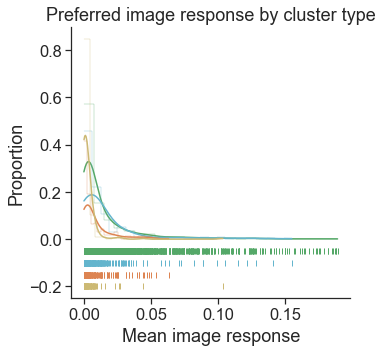

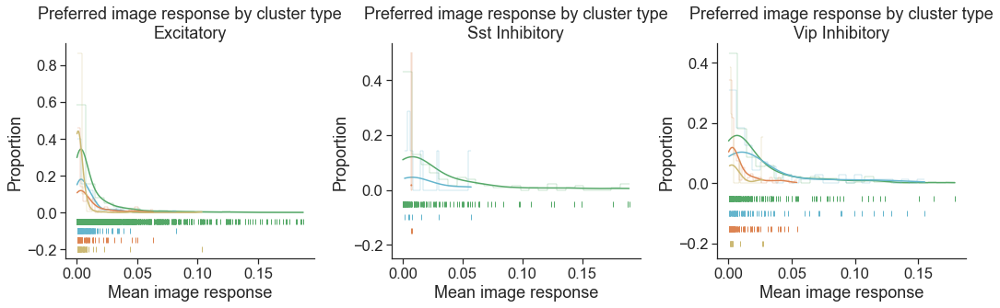

In [315]:
metric='mean_response_pref_image'
xlabel = 'Mean image response'
title = 'Preferred image response by cluster type'
cumulative=False
step = 0.05

# limit metrics to the preferred experience level for each cell so each cell only counts once
data = metrics[metrics.pref_experience_level==True]
# remove outliers
data = data[data[metric].isnull()==False]
data = data[data[metric]<np.percentile(data[metric].values, 98)]


plotting.plot_metric_distribution_for_dominant_feature_cluster_types(data, metric, cre_line=None, 
                                                                xlabel=xlabel, title=title, linewidth=0.3, 
                                                                cumulative=cumulative, step=step, legend=False,
                                                                save_dir=save_dir, folder=folder, ax=None)

plotting.plot_metric_distribution_for_dominant_feature_cluster_types_per_cre(data, metric, 
                                                                    xlabel=xlabel, title=title, linewidth=0.3, 
                                                                    cumulative=cumulative, step=step, legend=False,
                                                                    save_dir=save_dir, folder=folder)

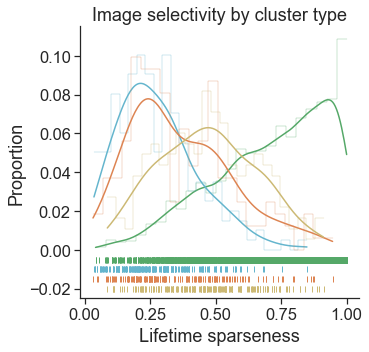

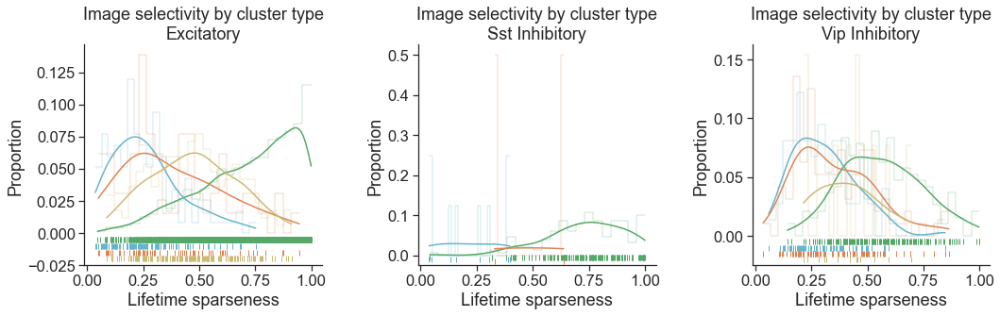

In [316]:
metric='lifetime_sparseness'
xlabel = 'Lifetime sparseness'
title = 'Image selectivity by cluster type'
cumulative=False
step = 0.005

# limit metrics to the preferred experience level for each cell so each cell only counts once
data = metrics[metrics.pref_experience_level==True]

plotting.plot_metric_distribution_for_dominant_feature_cluster_types(data, metric, cre_line=None, 
                                                                xlabel=xlabel, title=title, linewidth=0.3, 
                                                                cumulative=cumulative, step=step, legend=False,
                                                                save_dir=save_dir, folder=folder, ax=None)

plotting.plot_metric_distribution_for_dominant_feature_cluster_types_per_cre(data, metric, 
                                                                    xlabel=xlabel, title=title, linewidth=0.3, 
                                                                    cumulative=cumulative, step=step, legend=False,
                                                                    save_dir=save_dir, folder=folder)

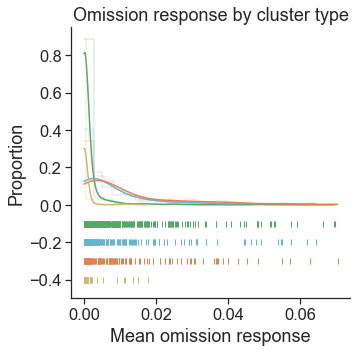

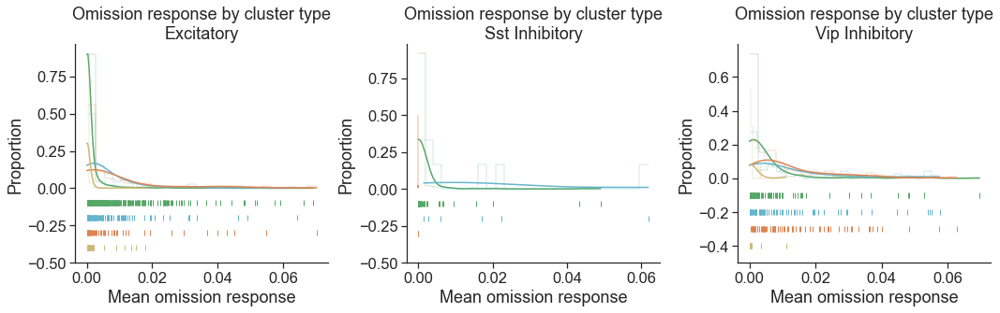

In [317]:
metric='mean_response_omissions'
xlabel = 'Mean omission response'
title = 'Omission response by cluster type'
cumulative=False
step = 0.1

# limit metrics to the preferred experience level for each cell so each cell only counts once
data = metrics[metrics.pref_experience_level==True]
# remove outliers
data = data[data[metric].isnull()==False]
data = data[data.mean_response_omissions<np.percentile(data.mean_response_omissions.values, 99)]

plotting.plot_metric_distribution_for_dominant_feature_cluster_types(data, metric, cre_line=None, 
                                                                xlabel=xlabel, title=title, linewidth=0.3, 
                                                                cumulative=cumulative, step=step, legend=False,
                                                                save_dir=None, folder=folder, ax=None)

plotting.plot_metric_distribution_for_dominant_feature_cluster_types_per_cre(data, metric, 
                                                                    xlabel=xlabel, title=title, linewidth=0.3, 
                                                                    cumulative=cumulative, step=step, legend=False,
                                                                    save_dir=save_dir, folder=folder)

(-0.001, 0.02)

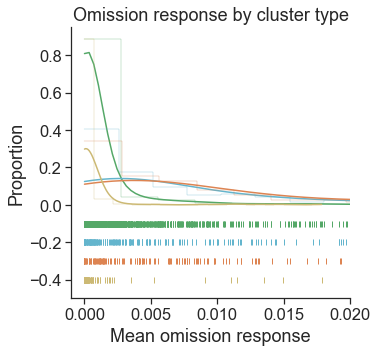

In [318]:
# try zooming in on x axis
metric='mean_response_omissions'
xlabel = 'Mean omission response'
title = 'Omission response by cluster type'
cumulative=False
step = 0.1

# limit metrics to the preferred experience level for each cell so each cell only counts once
data = metrics[metrics.pref_experience_level==True]
# remove outliers
data = data[data[metric].isnull()==False]
data = data[data.mean_response_omissions<np.percentile(data.mean_response_omissions.values, 99)]

fig, ax = plt.subplots(figsize=(5,5))
ax = plotting.plot_metric_distribution_for_dominant_feature_cluster_types(data, metric, cre_line=None, 
                                                                xlabel=xlabel, title=title, linewidth=0.3, 
                                                                cumulative=cumulative, step=step, legend=False,
                                                                save_dir=None, folder=folder, ax=ax)
ax.set_xlim(-0.001, 0.02)

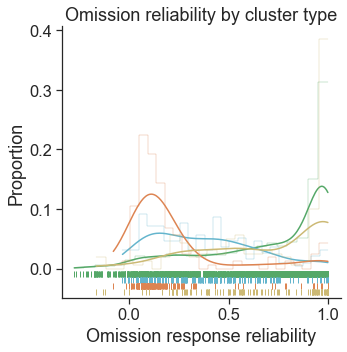

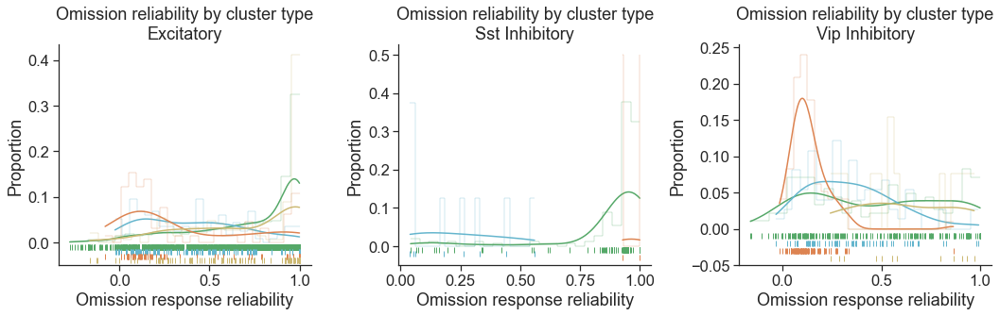

In [319]:
metric='reliability_omissions'
xlabel = 'Omission response reliability'
title = 'Omission reliability by cluster type'
cumulative=False
step = 0.01

# limit metrics to the preferred experience level for each cell so each cell only counts once
data = metrics[metrics.pref_experience_level==True]

plotting.plot_metric_distribution_for_dominant_feature_cluster_types(data, metric, cre_line=None, 
                                                                xlabel=xlabel, title=title, linewidth=0.3, 
                                                                cumulative=cumulative, step=step, legend=False,
                                                                save_dir=save_dir, folder=folder, ax=None)

plotting.plot_metric_distribution_for_dominant_feature_cluster_types_per_cre(data, metric, 
                                                                    xlabel=xlabel, title=title, linewidth=0.3, 
                                                                    cumulative=cumulative, step=step, legend=False,
                                                                    save_dir=save_dir, folder=folder)

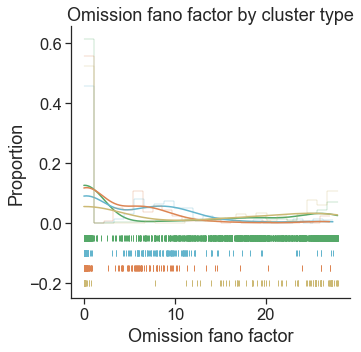

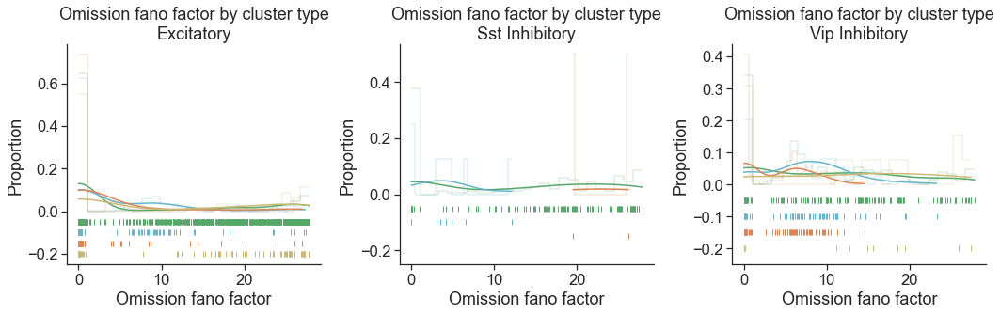

In [320]:
metric='fano_factor_omissions'
xlabel = 'Omission fano factor'
title = 'Omission fano factor by cluster type'
cumulative = False
step = 0.05

# limit metrics to the preferred experience level for each cell so each cell only counts once
data = metrics[metrics.pref_experience_level==True]
# remove NaNs
data = data[data.fano_factor_omissions.isnull()==False]
# remove outliers
data = data[data.fano_factor_omissions<np.percentile(data.fano_factor_omissions.values, 99)]


plotting.plot_metric_distribution_for_dominant_feature_cluster_types(data, metric, cre_line=None, 
                                                                xlabel=xlabel, title=title, linewidth=0.3, 
                                                                cumulative=cumulative, step=step, legend=False,
                                                                save_dir=save_dir, folder=folder, ax=None)

plotting.plot_metric_distribution_for_dominant_feature_cluster_types_per_cre(data, metric, 
                                                                    xlabel=xlabel, title=title, linewidth=0.3, 
                                                                    cumulative=cumulative, step=step, legend=False,
                                                                    save_dir=save_dir, folder=folder)

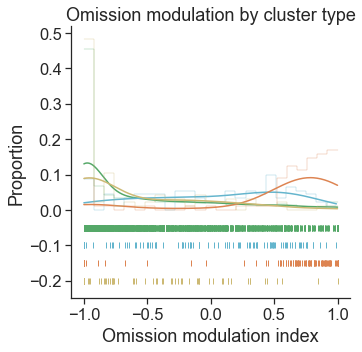

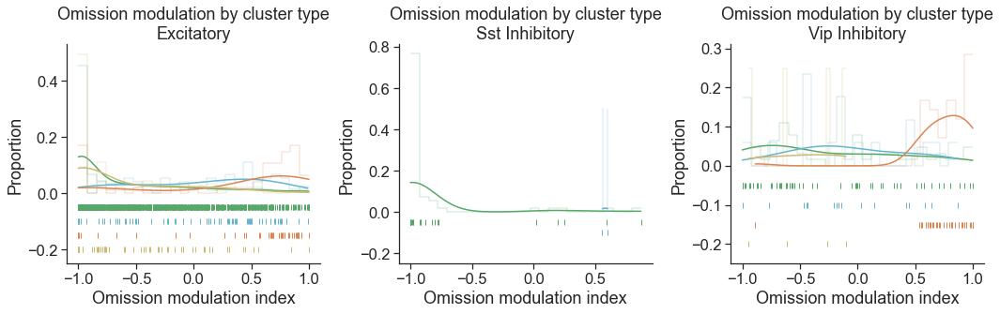

In [321]:
metric='omission_modulation_index'
xlabel = 'Omission modulation index'
title = 'Omission modulation by cluster type'
cumulative=False
step = 0.05

# limit metrics to the preferred experience level for each cell so each cell only counts once
data = metrics[metrics.pref_experience_level==True]

plotting.plot_metric_distribution_for_dominant_feature_cluster_types(data, metric, cre_line=None, 
                                                                xlabel=xlabel, title=title, linewidth=0.3, 
                                                                cumulative=cumulative, step=step, legend=False,
                                                                save_dir=save_dir, folder=folder, ax=None)

plotting.plot_metric_distribution_for_dominant_feature_cluster_types_per_cre(data, metric, 
                                                                    xlabel=xlabel, title=title, linewidth=0.3, 
                                                                    cumulative=cumulative, step=step, legend=False,
                                                                    save_dir=save_dir, folder=folder)

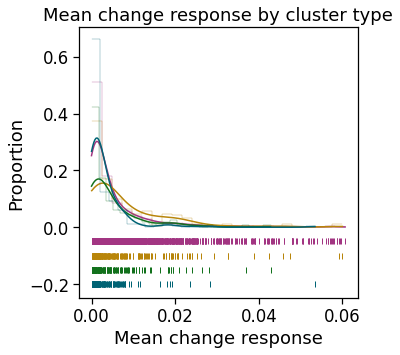

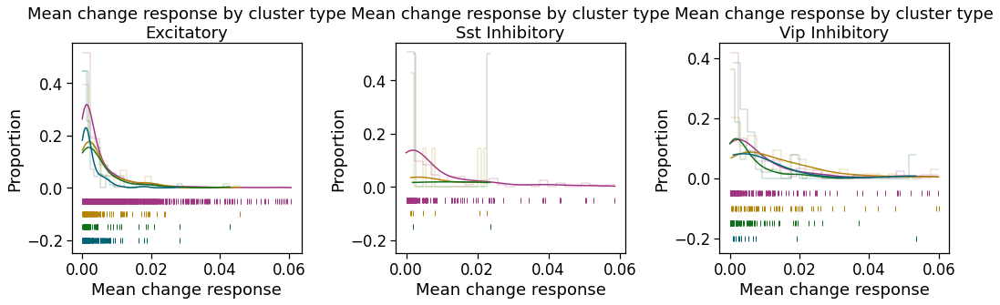

In [ ]:
metric='mean_response_changes'
xlabel = 'Mean change response'
title = 'Mean change response by cluster type'
cumulative=False
step = 0.05

# limit metrics to the preferred experience level for each cell so each cell only counts once
data = metrics[metrics.pref_experience_level==True]
# remove outliers
data = data[data[metric].isnull()==False]
data = data[data[metric]<np.percentile(data[metric].values, 98)]


plotting.plot_metric_distribution_for_dominant_feature_cluster_types(data, metric, cre_line=None, 
                                                                xlabel=xlabel, title=title, linewidth=0.3, 
                                                                cumulative=cumulative, step=step, legend=False,
                                                                save_dir=save_dir, folder=folder, ax=None)

plotting.plot_metric_distribution_for_dominant_feature_cluster_types_per_cre(data, metric, 
                                                                    xlabel=xlabel, title=title, linewidth=0.3, 
                                                                    cumulative=cumulative, step=step, legend=False,
                                                                    save_dir=save_dir, folder=folder)

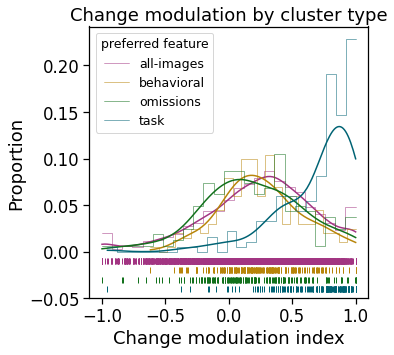

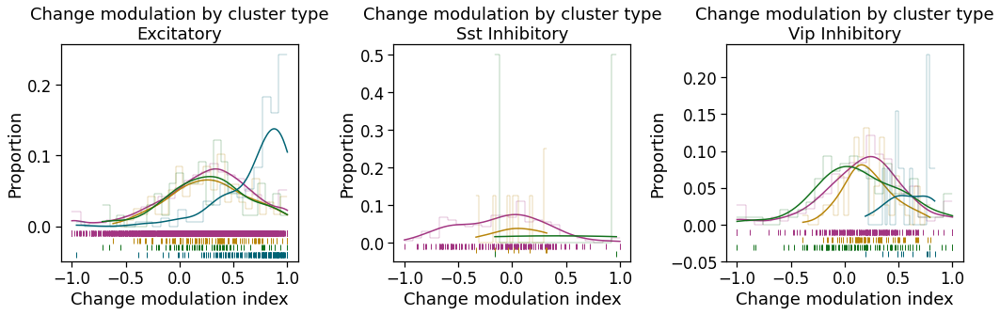

In [ ]:
metric='change_modulation_index'
xlabel = 'Change modulation index'
title = 'Change modulation by cluster type'
cumulative=False
step = 0.01

# limit metrics to the preferred experience level for each cell so each cell only counts once
data = metrics[metrics.pref_experience_level==True]

plotting.plot_metric_distribution_for_dominant_feature_cluster_types(data, metric, cre_line=None, 
                                                                xlabel=xlabel, title=title, linewidth=0.5, 
                                                                cumulative=cumulative, step=step, 
                                                                save_dir=save_dir, folder=folder, ax=None)

plotting.plot_metric_distribution_for_dominant_feature_cluster_types_per_cre(data, metric, 
                                                                    xlabel=xlabel, title=title, linewidth=0.3, 
                                                                    cumulative=cumulative, step=step, legend=False,
                                                                    save_dir=save_dir, folder=folder)

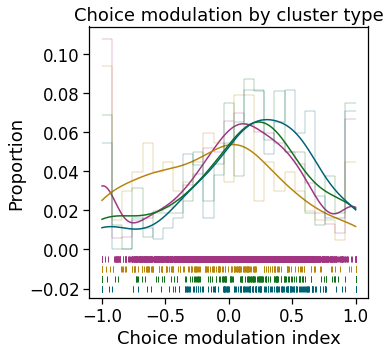

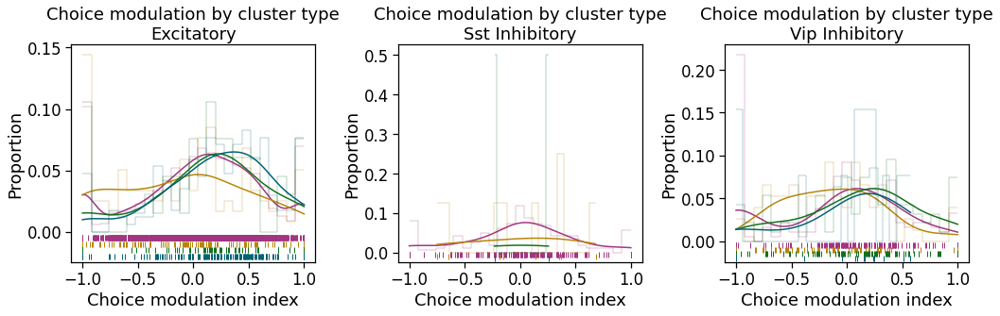

In [ ]:
metric='hit_miss_index'
xlabel = 'Choice modulation index'
title = 'Choice modulation by cluster type'
cumulative=False
step = 0.005

# limit metrics to the preferred experience level for each cell so each cell only counts once
data = metrics[metrics.pref_experience_level==True]

plotting.plot_metric_distribution_for_dominant_feature_cluster_types(data, metric, cre_line=None, 
                                                                xlabel=xlabel, title=title, linewidth=0.3, 
                                                                cumulative=cumulative, step=step, legend=False,
                                                                save_dir=save_dir, folder=folder, ax=None)

plotting.plot_metric_distribution_for_dominant_feature_cluster_types_per_cre(data, metric, 
                                                                    xlabel=xlabel, title=title, linewidth=0.3, 
                                                                    cumulative=cumulative, step=step, legend=False,
                                                                    save_dir=save_dir, folder=folder)

## plot clusters individually with metric values

What is available?
* coding_score_metrics
* response_metrics
* omission_response_metrics
* change_response_metrics
* fraction cells per cluster

In [ ]:
col_to_group = 'cre_line'
n_cells_per_cluster = get_fraction_cells_per_cluster_per_group(cluster_meta, col_to_group)


### dropout heatmaps

In [ ]:
cluster_id = 1

plotting.plot_dropout_heatmap(cluster_meta, feature_matrix, cluster_id, cre_line=None, 
                            abbreviate_features=True, abbreviate_experience=True, small_fontsize=False, ax=None)

### pie chart fraction cells per cluster

In [ ]:

def plot_fraction_per_cluster_pie(n_cells_per_cluster, cluster_id, cre_line=None, ax=None):
       if cre_line is not None: 
              fractions_this_cre = n_cells_per_cluster[(n_cells_per_cluster.cre_line==cre_line)].fraction_per_cluster.values
              fractions_this_cluster = n_cells_per_cluster[(n_cells_per_cluster.cre_line==cre_line)&(n_cells_per_cluster.cluster_id==cluster_id)].fraction_per_cluster.values[0]
              fraction = np.round(fractions_this_cluster*100, 2)
       else: 
              fractions_this_cluster = n_cells_per_cluster[(n_cells_per_cluster.cluster_id==cluster_id)].fraction_per_cluster.values[0]
              fraction = np.round(fractions_this_cluster*100, 2)   

       colors = utils.get_cre_line_color_dict()
       colors = [colors[cre_line], [0.8, 0.8, 0.8]]

       if ax is None:
              fig, ax = plt.subplots(figsize=(2,2.5))
       ax.pie(x=[fraction, 100 - fraction], colors=colors, wedgeprops=dict(edgecolor='w'),
              startangle=90, radius=1, center=(-1, 0), labels=[str(fraction) + '%', ''])
       ax.set_title(utils.get_abbreviated_cell_type(cre_line))

       return ax

In [ ]:
cluster_id = 1
cre_line = 'Vip-IRES-Cre'

col_to_group = 'cre_line'
n_cells_per_cluster = get_fraction_cells_per_cluster_per_group(cluster_meta, col_to_group)

plot_fraction_per_cluster_pie(n_cells_per_cluster, cluster_id, cre_line, ax=None)


In [ ]:

def plot_cluster_proportion_per_cre(n_cells_per_cluster, cluster_id, ax=None):
    """
    Plots a stacked barplot of the proportion of cells in each cluster, split by each cre line
    x axis is cre line, y axis is proportion
    each cre line is sorted by its own fraction per cluster in ascending order
    the cluster_id provided will be colored according to the cre line and the size of that cluster will be plotted
    at the top of the stacked barplot
    """
    this_cluster = cluster_id
    if ax is None: 
        fig, ax = plt.subplots(figsize=(3,3))
    for x_pos, cre_line in enumerate(cre_lines):
        data = n_cells_per_cluster[(n_cells_per_cluster.cre_line == cre_line)]
        data['fraction'] = data.fraction_per_cluster
        data = data.sort_values(by=['fraction'], ascending=True)
        cluster_ids = data.cluster_id.values
        len_this_cluster = len(data[data.cluster_id == this_cluster])
        if len_this_cluster>0:
            cluster_is_present = True
        next_bar_start = 0
        for c, cluster_id in enumerate(cluster_ids):
            this_value = data[data.cluster_id == cluster_id].fraction.values[0]
            if (cluster_id == this_cluster) and (cluster_is_present==True): # only plot a color and label if its the cluster of interest
                color = cre_line_colors[x_pos]
                label = str(np.round(this_value*100, 1))+'%'
                ax.text(x_pos-0.4, 1.05, label, fontsize='x-small')
            else:
                color = 'gray'
            if c == 0:
                ax.bar(x_pos, this_value, bottom=next_bar_start, color=color, edgecolor='w')
            else:
                ax.bar(x_pos, this_value, bottom=next_bar_start, color=color, edgecolor='w')
            next_bar_start = next_bar_start + this_value
            # ax.axis('off')
            sns.despine(left=True, bottom=True)
            ax.tick_params(left=False, bottom=False)
    ax.set_xticks(np.arange(0,3))
    ax.set_xticklabels([utils.get_abbreviated_cell_type(cre_line) for cre_line in cre_lines])
    ax.set_yticklabels('')
    ax.set_ylabel('cluster proportion\nper cell type')
    return ax

In [ ]:
cluster_id = 0
plot_cluster_proportion_per_cre(n_cells_per_cluster, cluster_id, ax=None)


### coding score metrics per cluster

In [ ]:
coding_score_metrics.keys()

In [ ]:
def plot_coding_score_metric_for_cluster(coding_score_metrics, cluster_id, metric, ymin=-1, ymax=1, ylabel=None, ax=None):
    """
    plots distribution of a given coding score metric for a given cluster, for each cre line
    shows boxplot and individual data points
    cre line is on x axis, metric value on y axis
    """
    cluster_data = coding_score_metrics[coding_score_metrics.cluster_id==cluster_id]

    if ax is None: 
        figsize=(2,2.5)
        fig, ax = plt.subplots(figsize=figsize)

    # ax = sns.boxplot(data=cluster_data, x='cre_line', order=cre_lines, y=metric, 
    #                     palette=cre_line_colors, ax=ax)

    ax = sns.boxplot(data=cluster_data, x='cre_line', order=cre_lines, y=metric, 
                color='white', width=0.5, ax=ax)
    ax = sns.stripplot(data=cluster_data, x='cre_line', order=cre_lines, y=metric, 
                palette=cre_line_colors, size=3, alpha=0.5, ax=ax)

    # ax.legend([utils.get_abbreviated_cell_type(cre_line) for cre_line in cre_lines], fontsize='xx-small')
    # ax.get_legend().remove()
    ax.set_xticklabels([utils.get_abbreviated_cell_type(cre_line) for cre_line in cre_lines])
    ax.set_xlabel('')
    if ylabel is not None:
        ax.set_title(ylabel)
        ax.set_ylabel('')
    # ax.set_ylabel('')
    # ax.set_title(metric)
    ax.set_ylim(ymin, ymax)
    ax.set_xlim(-0.5, len(cre_lines)-0.5)
    ax.hlines(y=0, xmin=-0.5, xmax=len(cre_lines)-0.5, color='gray', linestyle='--')

    return ax


In [ ]:
cluster_id = 1
metric = 'experience_selectivity'

plot_coding_score_metric_for_cluster(coding_score_metrics, cluster_id, metric, ax=None)


In [ ]:
# take absolute value so its just whether it is transient or not, regardless of direction
coding_score_metrics['persistence'] = 1-np.abs(coding_score_metrics.exp_mod_persistence.values)

In [ ]:
cluster_id = 1
metric = 'persistence'

plot_coding_score_metric_for_cluster(coding_score_metrics, cluster_id, metric, ymin=0, ax=None)


### response metrics per cluster

In [ ]:
def plot_response_metric_for_cluster(response_metrics, cluster_id, metric, ymin=-1, ymax=1, ylabel=None, ax=None):
    """
    plots distribution of a given response metric (computed on cell traces directly) for a given cluster, for each cre line
    shows boxplot and individual data points
    cre line is on x axis, metric value on y axis
    """
    cluster_data = response_metrics[response_metrics.cluster_id==cluster_id]

    if ax is None: 
        figsize=(2,2.5)
        fig, ax = plt.subplots(figsize=figsize)

    # ax = sns.boxplot(data=cluster_data, x='cre_line', order=cre_lines, y=metric, 
    #                     palette=cre_line_colors, ax=ax)

    ax = sns.boxplot(data=cluster_data, x='cre_line', order=cre_lines, y=metric, width=0.7,
                    hue='experience_level',hue_order=experience_levels, boxprops=dict(alpha=.6), 
                    palette=experience_level_colors, ax=ax)

    # ax = sns.pointplot(data=cluster_data, x='cre_line', order=cre_lines, y=metric, 
    #                 hue='experience_level',hue_order=experience_levels, join=False, dodge=True, 
    #                 palette=experience_level_colors, ax=ax)
                    
    # ax = sns.boxplot(data=cluster_data, x='cre_line', order=cre_lines, y=metric, 
    #                 hue='experience_level',hue_order=experience_levels, dodge=True,
    #                 color='white', width=0.5, ax=ax)
    # ax = sns.stripplot(data=cluster_data, x='cre_line', order=cre_lines, y=metric, 
    #                 hue='experience_level',  hue_order=experience_levels,
    #                 palette=experience_level_colors, dodge=True, size=3, alpha=0.5, ax=ax)

    # ax.legend([utils.get_abbreviated_cell_type(cre_line) for cre_line in cre_lines], fontsize='xx-small')
    ax.get_legend().remove()
    ax.set_xticklabels([utils.get_abbreviated_cell_type(cre_line) for cre_line in cre_lines])
    ax.set_xlabel('')
    if ylabel is not None: 
        ax.set_title(ylabel)
        ax.set_ylabel('')
    # ax.set_ylabel('')
    # ax.set_title(metric)
    ax.set_ylim(ymin, ymax)
    ax.set_xlim(-0.5, len(cre_lines)-0.5)
    if ymin < -0.05: 
        ax.hlines(y=0, xmin=-0.5, xmax=len(cre_lines)-0.5, color='gray', linestyle='--')

    return ax


In [ ]:
cluster_id = 1
metric = 'lifetime_sparseness'
plot_response_metric_for_cluster(response_metrics, cluster_id, metric, ymin=-0.1, ymax=1.1, ax=None)

In [ ]:
cluster_id = 1
metric = 'running_modulation_index'
plot_response_metric_for_cluster(response_metrics, cluster_id, metric, ymin=-1.1, ymax=1.1, ax=None)

In [ ]:
cluster_id = 0
metric = 'reliability'

plot_response_metric_for_cluster(pref_stim_response_metrics, cluster_id, metric, ymin=-0.6, ymax=1.1, ax=None)

In [ ]:
cluster_id = 1

def plot_cluster_properties(cluster_id): 
    figsize = (25,2.5)
    width_ratios = [1.5] + [int(x) for x in list(np.ones(7))]
    fig, ax = plt.subplots(1, 8, figsize=figsize, gridspec_kw={'width_ratios':width_ratios})

    i = 0
    ax[i] = plotting.plot_dropout_heatmap(cluster_meta, feature_matrix, cluster_id, cre_line=None, 
                                abbreviate_features=True, abbreviate_experience=True, small_fontsize=False, ax=ax[i])
    i+=1
    ax[i] = plot_cluster_proportion_per_cre(n_cells_per_cluster, cluster_id, ax=ax[i])
    i+=1
    metric = 'experience_selectivity'
    ax[i] = plot_coding_score_metric_for_cluster(coding_score_metrics, cluster_id, metric, ymin=-1.1, ymax=1.1, ylabel='novelty index', ax=ax[i])
    i+=1
    metric = 'persistence'
    ax[i] = plot_coding_score_metric_for_cluster(coding_score_metrics, cluster_id, metric, ymin=-0.1, ymax=1.1, ylabel='persistence', ax=ax[i])
    i+=1
    metric = 'lifetime_sparseness'
    ax[i] = plot_response_metric_for_cluster(response_metrics, cluster_id, metric, ymin=-0.1, ymax=1.1, ylabel='image selectivity', ax=ax[i])
    i+=1
    metric = 'reliability'
    ax[i] = plot_response_metric_for_cluster(pref_stim_response_metrics, cluster_id, metric, ymin=-0.6, ymax=1.1, ylabel='image \nreliability', ax=ax[i])
    i+=1
    metric = 'reliability'
    ax[i] = plot_response_metric_for_cluster(omission_response_metrics, cluster_id, metric, ymin=-0.6, ymax=1.1, ylabel='omission \nreliability', ax=ax[i])
    i+=1
    metric = 'running_modulation_index'
    ax[i] = plot_response_metric_for_cluster(response_metrics, cluster_id, metric, ymin=-1.1, ymax=1.1, ylabel='running\nmodulation', ax=ax[i])

    plt.subplots_adjust(wspace=0.7)
    # plt.tight_layout()

    utils.save_figure(fig, figsize, save_dir, folder, 'cluster_properties_cluster_'+str(cluster_id))

plot_cluster_properties(cluster_id)

In [ ]:
for cluster_id in np.sort(cluster_meta.cluster_id.unique()):
    plot_cluster_properties(cluster_id)